In [1]:
%matplotlib notebook
import os, sys, inspect, warnings
curr_dir = os.path.dirname(os.path.abspath(inspect.getfile(inspect.currentframe()))) # script directory
main_dir = '/'.join(curr_dir.split('/')[:-1])
sub_dir = os.path.join(main_dir, 'RGCPD/')
# core_pp = os.path.join(main_dir, 'RGCPD/core')
if main_dir not in sys.path:
    sys.path.append(main_dir)
    sys.path.append(sub_dir)
import numpy as np
import math
from collections import Counter
# import statsmodels.api as sm 
import pandas as pd 
import math
import matplotlib.pyplot as plt 
plt.rcParams['figure.figsize'] = (15.0, 8.0)
import itertools as it
import pywt as wv
from scipy.fftpack import fft
from copy import deepcopy
# from statsmodels.tsa.arima_process import  arma_generate_sample, ArmaProcess
from pprint import pprint as pp 
from pandas.plotting import register_matplotlib_converters
from RGCPD import RGCPD
from RGCPD import BivariateMI
from df_ana_class import DataFrameAnalysis, VisualizeAnalysis
import core_pp
from plot_signal_decomp import *
from plot_coeffs import * 
import wave_ana as wa 
register_matplotlib_converters()
plt.style.use('seaborn')

Could not import rpy package
Could not import r-package RCIT


# Preparing RGCPD 

In [2]:
path_data = os.path.join(main_dir, 'data')
current_analysis_path = os.path.join(main_dir, 'Jier_analysis')
target= 3
target_path = os.path.join(path_data, 'tf5_nc5_dendo_80d77.nc')
precursor_path = os.path.join(path_data,'sst_1979-2018_2.5deg_Pacific.nc')
list_of_name_path = [(target, target_path), 
                    ('sst', precursor_path )]
list_for_MI = [BivariateMI(name='sst', func=BivariateMI.corr_map, 
                          kwrgs_func={'alpha':.0001, 'FDR_control':True}, 
                          distance_eps=700, min_area_in_degrees2=5)]
rg = RGCPD(list_of_name_path=list_of_name_path,
           list_for_MI=list_for_MI,
           start_end_TVdate=('06-01', '08-31'),
           path_outmain=os.path.join(current_analysis_path,'tigramite_output'),
           append_pathsub='baseline')

## Setting up sampling frequency

In [3]:
rg.pp_precursors(detrend=True, anomaly=True, selbox=None)
rg.pp_TV()
rg.traintest(method='no_train_test_split')
rg.calc_corr_maps()
rg.cluster_list_MI()
rg.get_ts_prec(precur_aggr=1)

Loaded pre-processed data of sst

original tfreq of imported response variable is converted to desired tfreq 10
Daily input freq
No train test split

sst - calculating correlation maps
Progress traintest set 100%, trainsize=(400dp, 100%)

redefine target variable on 1 day means
Selecting subset as defined by start_end_date
Daily input freq
No train test split

Getting MI timeseries
There are [2] regions in total (list of different splits)


## Defining alpha and tau_max

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


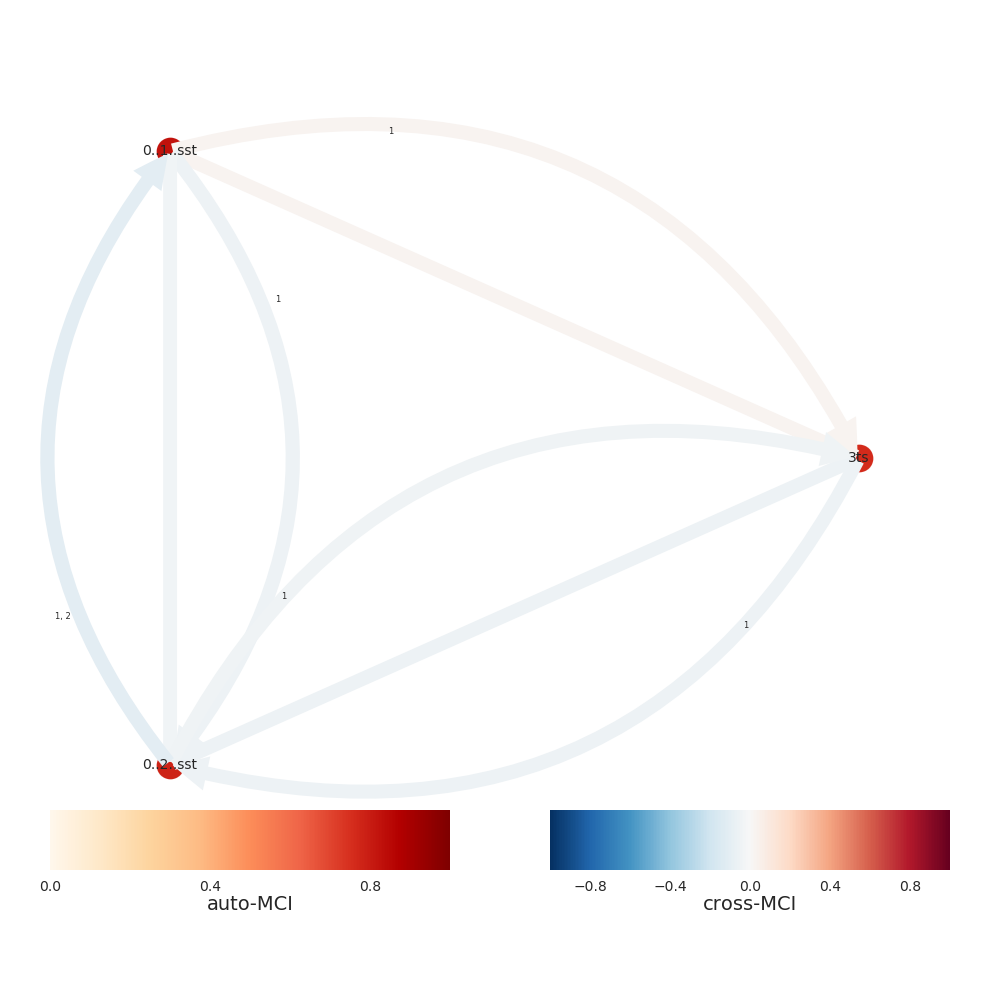

In [4]:
rg.PCMCI_df_data(tau_max=2, pc_alpha=0.05)
rg.PCMCI_get_links()
rg.df_MCIc
rg.PCMCI_plot_graph()

## Extracting data from RGCPD

In [5]:
rg_data  = rg.df_data.loc[:,rg.df_data.columns[rg.df_data.dtypes != bool]]
rg_index = rg_data.index.levels[1]
prec1_arr, prec2_arr = None, None
prec_list_arr = None
if len(rg_data.columns[1:].tolist()) == 2:    
    prec1_arr = rg_data.iloc[:,1].values
    prec2_arr = rg_data.iloc[:,2].values
more_precursors = False 
if len(rg_data.columns[1:].tolist()) > 2:
    more_precursors = True
    prec_list_arr = [rg_data.iloc[:,i].values
      for i in range(1, len(rg_data.columns[1:].tolist())+1)
      if len(rg_data.columns[1:].tolist()) > 2 ]

target_arr = rg_data.iloc[:,0].values
target_df = rg_data.iloc[:,0]

# Wavelet

## Choice wavelet

In [6]:
la8 = wa.create_least_asymmetric_filter(mode='dwt')
waves = ['sym2', 'sym4', 'sym8', la8]
def plot_dwt_default(data, w, title, level, mode, method='wavedec'):

    assert isinstance(w, wv.Wavelet)
    a = data
    level_ = wv.dwt_max_level(len(data), w.dec_len)
    if level > level_:
        level = level_
        print(f"Appropriate level is changed to {level}")
    else:
        level_ = None
        
    if method == 'coeff':
        plot_coeffs(data, w, mode, title, level)
        return
    elif method =='recon':
        plot_signal_decomp(data, w, mode, title, level)
        return
    elif method =='modwt':
        plot_modwt(data, w, title, level)
        return
    else:
        coeffs =  wv.wavedec(a, w, level=level, mode=mode)

        ylim = [a.min(), a.max()]

        fig, axes = plt.subplots(len(coeffs) + 1, figsize=(10, 8), constrained_layout=True)
        axes[0].set_title(title)
        axes[0].plot(a, 'k', label='Original signal')
        axes[0].set_ylabel(r'C$^{\circ}$')
        axes[0].set_xlim(0, len(a) - 1)
        axes[0].set_ylim(ylim[0], ylim[1])
        axes[0].legend(loc=0)

        for i, _ in enumerate(coeffs):
            ax = axes[-i - 1]
            if i == 0:
                ax.set_ylabel("A%d" % (len(coeffs) - 1))
                ax.plot( coeffs[i], 'r')
            else:
                ax.set_ylabel("D%d" % (len(coeffs) - i))
                ax.plot( coeffs[i], 'g')

In [7]:
# plot_dwt_default(target_arr, w=la8, title=f'Target {rg_data.iloc[:,0].name} decomposition all levels', level=15, mode=wv.Modes.periodic)

In [8]:
# plot_dwt_default(target_arr, w=la8, title=f'Target {rg_data.iloc[:,0].name} decomposition all levels', level=15, mode=wv.Modes.periodic, method="coeff")

In [9]:
# plot_dwt_default(target_arr, w=la8, title=f'Target {rg_data.iloc[:,0].name} decomposition all levels', level=15, mode=wv.Modes.periodic, method="recon")

In [10]:
# plot_dwt_default(target_arr, w=la8, title=f'Target {rg_data.iloc[:,0].name} decomposition all levels', level=7, mode=wv.Modes.periodic, method="modwt")

## Decompose and reconstruct signal

In [11]:
def get_pad_width(data):
    x  = np.log2(len(data))
    x = math.ceil(x) 
    diff = 2**x - len(data)
    return diff//2

def get_pad_level(data):
    return math.ceil(np.log2(len(data)))

def get_pad_data(data):
    pad_width = get_pad_width(data)
    return np.pad(data, pad_width=pad_width, mode='reflect')

def unpad_data(data, pad_width):
    return data[pad_width:-pad_width]

In [12]:
def decompose_signal(data, w, mode, level, debug=False):
    assert isinstance(w, wv.Wavelet)
    cA, cD = [] , []
    s_prec  = data 
    level_ = wv.dwt_max_level(len(data), w.dec_len)
    if level > level_:
        level = level_
        print(f"Appropriate level is changed to {level}")
    else:
        level_ = None
    for i in range(level):
        s_prec, det  = wv.dwt(s_prec, w, mode=mode)
        cA.append(s_prec)
        cD.append(det)
    if debug:
        print(f'[DEBUG]')
        for i, value in enumerate(cD):
            print(f' Level {i} decomposition Length coefficient {value}')
    return cA, cD, level 
def decompose_signal_modwt(data, w, mode, level, unpad=True,  debug=True):
    assert isinstance(w, wv.Wavelet)
    pad_width = get_pad_width(data)
    a = get_pad_data(data=data)
    level_ = get_pad_level(data)
    if level > level_:
        level = level_
        print("[INFO] Appropriate level is changed to ", level)
    else:
        level_ = None

    coeffs =  wv.swt(a, w, level=level, trim_approx=True, norm=True) #[(cAn, (cDn, ...,cDn-1, cD1)]
    if unpad:
        temp = []
        for i, coeff in enumerate(coeffs):
            if debug:
                print(f'Length unpadded coeffs {len(coeff)}\n')
            temp.append(unpad_data(coeff, pad_width))
            if debug:
                print(f'Length after padding {len(temp[i])}\n')
        return temp
    else:
        return coeffs
def reconstruct_signal(data, w, mode, level, debug=False):
    """Decompose and reconstruct S.
    S = An + Dn + Dn-1 + ... + D1
    """
    assert isinstance(w, wv.Wavelet)
    a = data
    ca = []
    cd = []
    level_ = wv.dwt_max_level(len(data), w.dec_len)
    if level > level_:
        level = level_
        print("Appropriate level is changed to ", level)
    else:
        level_ = None 
    for i in range(level):
        (a, d) = wv.dwt(a, w, mode)
        ca.append(a)
        cd.append(d)

    rec_a = []
    rec_d = []

    for i, coeff in enumerate(ca):
        coeff_list = [coeff, None] + [None] * i
        rec_a.append(wv.waverec(coeff_list, w, mode=mode))
        if debug:
            print(f'[DEBUG] Length reconstruction approx  index {len(coeff_list)} length coeffs {len(coeff)} length recon {len(rec_a[i])}')

    for i, coeff in enumerate(cd):
        coeff_list = [None, coeff] + [None] * i
        rec_d.append(wv.waverec(coeff_list, w, mode=mode))
    return rec_a, rec_d, ca, cd

In [13]:
def extract_signal_at_level(original_signal, signal, level):
#     print(f"[INFO] Level to extract {level} and length signal coeffs {len(signal)}")
    assert len(signal[level]) <= len(original_signal), f"[ERROR] Wavelet introduce longer signal length at given level {len(signal[level])} vs data length {len(original_signal)} "
    return signal[level] if level <= len(signal) else None

In [14]:
def check_correct_level_extracted(ex_signal, signal, level, modwt=True):
    assert level != len(signal), f"[ERROR] Array start at 0, so do not confuse level {level} decomp and length of signal {len(signal)}\n"
    if not modwt == True:
        return np.array_equiv(ex_signal, signal[level])
    else:
        return np.allclose(ex_signal, signal[level])

In [15]:
def build_up_to_level(data, w, mode, level, to_omit_level, debug=False):
    if debug == True:
        print('[INFO] Know that to_omit_level needs to be 1 indexed instead of 0 indexed')
    
    level_ = wv.dwt_max_level(len(data), w.dec_len)
    if level > level_:
        level = level_
        if debug == True:
            print("[INFO] Appropriate level is changed to ", level)
    else:
        level_ = None 
        
    coeffs  = wv.wavedec(data, w, mode, level)
    if debug == True:
        print(f'[INFO] Length decomposed coefficients is {len(coeffs)} to omit level size {to_omit_level+1} + 1')
    
    assert to_omit_level+1 <= len(coeffs), f"[ERROR] To omit level need to be  strictly one less than decomposition {level} and length coeffs {len(coeffs)}"
    coeffs[-to_omit_level+1] = np.zeros_like(coeffs[-to_omit_level+1])
    return wv.waverec(coeffs, w, mode)

In [16]:
a = np.arange(1, 7)
print(a)
print(np.pad(a, 2, 'symmetric'), np.pad(a, 2, 'symmetric')[2:-2])
print(np.pad(a, 2, 'reflect'), np.pad(a, 2, 'reflect')[2:-2])

[1 2 3 4 5 6]
[2 1 1 2 3 4 5 6 6 5] [1 2 3 4 5 6]
[3 2 1 2 3 4 5 6 5 4] [1 2 3 4 5 6]


In [17]:
mod_coeffs = decompose_signal_modwt(target_arr, w=la8, mode=wv.Modes.periodic, level=12, debug=False)

In [18]:
print(len(mod_coeffs), len(mod_coeffs[1:]))

13 12


In [19]:
print(list(range(11)), list(range(12)) )

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]


In [20]:
temp = mod_coeffs[1:]
print(np.array_equal(temp[-12], temp[0]))

True


In [21]:
def plot_unpad_modwt(coeffs, title, data):
    _, axes = plt.subplots(len(coeffs) + 1, figsize=(10, 8), constrained_layout=True, dpi=120)
    axes[0].set_title(title)
    axes[0].plot(data, 'k', label='Original signal')
    axes[0].set_ylabel(r'C$^{\circ}$')
#     axes[0].set_xlim(0, len(coeffs[0]) - 1)

    axes[0].legend(loc=0)
    for i, _ in enumerate(coeffs):
        ax = axes[-i - 1]
        if i == 0:
            ax.set_ylabel("A%d" % (len(coeffs) - 1))
            ax.plot( coeffs[i], 'r')
        else:
            ax.set_ylabel("D%d" % (len(coeffs) - i))
            ax.plot( coeffs[i], 'g')

In [22]:
# plot_unpad_modwt(mod_coeffs, data=target_arr, title=f'unppaded signal')

In [23]:
def build_up_modwt_level(data, w, mode, level, to_omit_level, debug=False):
    assert isinstance(w, wv.Wavelet)
    if debug == True:
        print('\n[INFO] Know that to_omit_level needs to be 1 indexed instead of 0 indexed')
    a = get_pad_data(data=data)
    pd_width = get_pad_width(data)
    level_ = get_pad_level(data)
    if level > level_:
        level = level_
        if debug == True:
            print(f"\n[INFO] Appropriate level is changed to  {level}")
    else:
        level_ = None

    coeffs =  wv.swt(a, w, level=level, trim_approx=True, norm=True) #[(cAn, (cDn, ...,cDn-1, cD1)]
    if debug:
        print(f'[INFO] Length decomposed coefficients is {len(coeffs)} to omit level size {to_omit_level+1} + 1')

    assert to_omit_level+1 <= len(coeffs), f"\n[ERROR] To omit level need to be strictly one less than decomposition {level} and len coeffs {len(coeffs)}"
    coeffs[-to_omit_level+1] = np.zeros_like(coeffs[-to_omit_level+1])
    return unpad_data(wv.iswt(coeffs, w, mode), pad_width=pd_width)

In [24]:
def get_precursor_from_target_decomposition(low_freq_signal, high_freq_signal, original_signal, extract_at, wave, mode, modwt=False, debug=False):
    if debug == True:
        print(f'\n[INFO] Give modwt as high_freq_signal and set low_freg_signal to None' )
    if not modwt == True:
        ex_td = extract_signal_at_level(signal=high_freq_signal, level=extract_at, original_signal=original_signal)
        ex_ta = extract_signal_at_level(signal=low_freq_signal, level=extract_at, original_signal=original_signal)
        if check_correct_level_extracted(ex_signal=ex_td, signal=high_freq_signal, level=extract_at) and \
        check_correct_level_extracted(ex_signal=ex_ta, signal=low_freq_signal, level=extract_at):
            return wv.waverec([ex_ta, ex_td], wave, mode)
    else:
        ex_mod = extract_signal_at_level(signal=high_freq_signal, original_signal=get_pad_data(original_signal), level=extract_at)
        if check_correct_level_extracted(ex_signal=ex_mod, signal=high_freq_signal, level=extract_at, modwt=modwt):
 
            pd_width = get_pad_width(original_signal)
            padded_signal = unpad_data(data=ex_mod, pad_width=pd_width)
            return padded_signal

In [25]:
def get_difference_recon_signal_from_target(target, recon_target):
    return target-recon_target

# Polynome

In [26]:
import synthetic_data as sd 
from statsmodels.regression.linear_model import yule_walker

target_col = '3ts'
prec_col = 'precursor'
def preprocess_ts(serie, col, threshold=0.05, to_serie=True,  debug=False):
    from scipy.stats import normaltest
    print(f'\n[INFO] Preprocessing Time serie \'{col}\' with first standardising and checking for gaussian like p-value ')
    normalize = lambda x : (x - x.mean())/ x.std()
    serie = serie.apply(normalize, axis=0)
    p_value = normaltest(serie)[1][0]
    print(f'\n[INFO] Time serie p_value  {p_value}  ')
    if p_value < threshold :
        print('\n[INFO] Time serie is gaussian like \n')
        if to_serie:
            return serie[col]
        else:
            return serie[col].values

In [27]:
def evaluate_data_ar(data, order=2, method='mle'):
    return yule_walker(data, order, method)

In [28]:
def construct_polynoom(ar, const, data, sigma, yule_walker= True):
    N =  len(data)
    epsilon = np.random.normal(loc=0, scale= sigma, size=N)
    simul_data = np.zeros(N)
    simul_data[0] = const + epsilon[0]
    ar_0, ar_1 = ar[0], ar[1]
    simul_data[1] =  const + ar_0 * simul_data[0] + epsilon[1]
    for i in range(2, N):
        simul_data[i] = const + (ar_0 * simul_data[i -1]) + (ar_1 * simul_data[i - 2]) + epsilon[i]
    print('\n[INFO] Polynomial fit done without dependance.')
    if yule_walker == True:
        print('\n[INFO] Yule walker standardisation')
        simul = np.array([(i - np.mean(simul_data))/(np.std(simul_data)) for i in simul_data])    
        return simul 
    else:
        return simul_data

In [29]:
def construct_polynoom_dependance(ar, const, data, sigma, gamma, X, yule_walker=True):
    pass

In [30]:
def construct_polynoom_precursor(ar, const, data, sigma, nu, yule_walker=True):
    N =  len(data)
    epsilon = np.random.normal(loc=0, scale= sigma, size=N)
    simul_data = np.zeros(N)
    simul_data[0] = const + epsilon[0]
    ar_0, ar_1 = ar[0], ar[1]
    simul_data[1] =  const + (nu *ar_0 * simul_data[0] ) + epsilon[1]
    for i in range(2, N):
        simul_data[i] = const + (nu *(ar_0 * simul_data[i -1])) + (nu *(ar_1 * simul_data[i - 2])) + epsilon[i]
    print('\n[INFO] Polynomial fit done for precursor.')
    if yule_walker == True:
        print('\n[INFO] Yule walker standardisation')
        simul = np.array([(i - np.mean(simul_data))/(np.std(simul_data)) for i in simul_data])    
        return simul 
    else:
        return simul_data

# Create Causal effect network

## Setup RGCPD format

In [31]:
def set_up_rgcpd_format(precursor, target, col=['mod_3ts', '3ts'], period=('06-01', '08-31'), index=rg_index):
    mod_target_df  = pd.DataFrame(data=precursor, index=pd.MultiIndex.from_product(([0], index)), columns=[col[0]])
    mod_target_df = preprocess_ts(mod_target_df, col[0])
    poly_target_df = pd.DataFrame(data=target, index= pd.MultiIndex.from_product(([0], index)), columns=[col[1]])
    poly_target_df = preprocess_ts(poly_target_df, col[1])
    dates = core_pp.get_subdates(dates=index, start_end_date=period, start_end_year=None, lpyr=False)
    RV_mask = pd.Series(np.array([True if d in dates else False for d in rg_index]), index=pd.MultiIndex.from_product(([0], index)), name='RV_mask')
    trainIsTrue = pd.Series(np.array([True for _ in range(len(target))]), index=pd.MultiIndex.from_product(([0], index)), name='TrainIsTrue')
    return pd.concat([poly_target_df, mod_target_df, trainIsTrue, RV_mask], axis=1)

## Create MCI

In [32]:
def mci_default(dFrame, tau_max=2, pc_alpha=0.05, debug=False):
    obj_rgcpd = []
    obj_pmatrix = []
    rg.df_data = dFrame
    rg.PCMCI_df_data(tau_max=tau_max, pc_alpha=pc_alpha)
    rg.PCMCI_get_links()
    rg.df_MCIc
    obj_rgcpd.append(deepcopy(rg.df_MCIc))
    obj_pmatrix.append(deepcopy(rg.pcmci_results_dict[0]['p_matrix']))
    if debug == True:
        rg.PCMCI_plot_graph()
        plt.show()
    return obj_rgcpd, obj_pmatrix

In [33]:
date = pd.to_datetime("4th of July, 2015")
date

Timestamp('2015-07-04 00:00:00')

In [34]:
date.strftime('%A')

'Saturday'

In [35]:
date + pd.to_timedelta(np.arange(12), 'D')

DatetimeIndex(['2015-07-04', '2015-07-05', '2015-07-06', '2015-07-07',
               '2015-07-08', '2015-07-09', '2015-07-10', '2015-07-11',
               '2015-07-12', '2015-07-13', '2015-07-14', '2015-07-15'],
              dtype='datetime64[ns]', freq=None)

In [36]:
pd.offsets.Day(4)

<4 * Days>

In [37]:
# pd.to_timedelta(np.arange(12), pd.offsets.Day(2))

In [38]:
def per_level_mci(cA, cA_t, rg, rg_index, level_test=True, tau_min=0,  tau_max=2, pc_alpha=0.05, debug=False):
    obj_rgcpd = []
    obj_pmatrix = []
    for i in range(0,len(cA_t)):
        idx_lvl_t = pd.DatetimeIndex(pd.date_range(rg_index[0] ,end=rg_index[-1], periods=len(cA_t[i]) ).strftime('%Y-%m-%d') )
        idx_prec = pd.DatetimeIndex(pd.date_range(rg_index[0], rg_index[-1], periods=len(cA) ).strftime('%Y-%m-%d') )
   
        dates = core_pp.get_subdates(dates=idx_lvl_t, start_end_date=('06-01', '08-31'), start_end_year=None, lpyr=False)
        full_time  = idx_lvl_t
        RV_time  = dates
        RV_mask = pd.Series(np.array([True if d in RV_time else False for d in full_time]), index=pd.MultiIndex.from_product(([0], idx_lvl_t)), name='RV_mask')
        trainIsTrue = pd.Series(np.array([True for _ in range(len(cA_t[i]))]), index=pd.MultiIndex.from_product(([0], idx_lvl_t)), name='TrainIsTrue')
        if level_test:
            ts_ca1 = pd.Series(cA, index=pd.MultiIndex.from_product(([0], idx_prec)),name='p_1_lvl_'+ str(i)+'_dec')
            ts_ca_shift = pd.Series(cA, index=pd.MultiIndex.from_product(([0], idx_prec)),name='p_shift_lvl_'+ str(i)+'_dec')
            ts_tca1 = pd.Series(cA_t[i], index=pd.MultiIndex.from_product(([0],idx_lvl_t)), name='3ts')
            df = pd.concat([ts_tca1, ts_ca1, ts_ca_shift, trainIsTrue, RV_mask], axis=1)
            
            if i == 0 or i == 1:
                shift = 2**(i+1)
                new_index = pd.MultiIndex.from_product(([0], pd.DatetimeIndex(pd.date_range(rg_index[0] , periods=len(cA_t[i])+shift, freq='D' ).strftime('%Y-%m-%d'))))
                df.reindex(new_index)
                df.iloc[:,2] = df.iloc[:,2].shift(periods=shift)
            else:
                shift_ = 2**(i)
                new_index = pd.MultiIndex.from_product(([0], pd.DatetimeIndex(pd.date_range(rg_index[0] , periods=len(cA_t[i])+shift_, freq='D' ).strftime('%Y-%m-%d'))))
                df.reindex(new_index)
                df.iloc[:,2] = df.iloc[:,2].shift(periods=shift_)

        else:
            ts_ca1 = pd.Series(cA, index=pd.MultiIndex.from_product(([0], idx_prec)),name='p_1_lvl_'+ str(i)+'_dec')
            ts_tca1 = pd.Series(cA_t[i], index=pd.MultiIndex.from_product(([0],idx_lvl_t)), name='3ts')
            df = pd.concat([ts_tca1, ts_ca1, trainIsTrue, RV_mask], axis=1)

        if any(df.isnull().sum() > 0) :
            df.dropna(inplace=True)

        rg.df_data = df
        rg.PCMCI_df_data(tau_min= tau_min, tau_max=tau_max, pc_alpha=pc_alpha)
        rg.PCMCI_get_links()
        rg.df_MCIc
        obj_rgcpd.append(deepcopy(rg.df_MCIc))
        obj_pmatrix.append(deepcopy(rg.pcmci_results_dict[0]['p_matrix']))
        if debug == True:
#             if i in [0, 2, 5, len(cA_t)-1]:
            if i in list(range(5)):
                rg.PCMCI_plot_graph()
                plt.show()
    return obj_rgcpd, obj_pmatrix

In [39]:
def extract_mci_lags(to_clean_mci_df, lag=0):
    lag_target = [lags.values[:,lag][1] for _, lags in enumerate(to_clean_mci_df)]
    lag_precurs = [lags.values[:,lag][1] for _, lags in enumerate(to_clean_mci_df)]
    return lag_target, lag_precurs

## Visualize MCI

In [40]:
def plot_mci_pred_relation(cA, prec_lag, path, title, show_level=False,  savefig=False):
    if show_level:
        x_as = np.arange(0, len(cA))
    else:
        x_as = np.arange(1, len(cA)+1)
        x_as = np.exp2(x_as)
    plt.figure(dpi=120)
    plt.plot(x_as, prec_lag, label='precrursor ')
    plt.vlines(x_as[np.argmax(prec_lag)], ymin=plt.ylim()[0], ymax=plt.ylim()[1],linestyles='dashed', label='MCI peak')
    
    if not show_level:
        plt.xscale('log', basex=2)
        plt.xticks(x_as, [str(2**i)+' days' for i in range(1, len(prec_lag)+1)], rotation=45) 
        plt.xlabel('Scales in daily means')
    else:
        plt.xticks(x_as,[str(i) for i in range(0, len(prec_lag)+1)] ) 
        plt.xlabel('Decomposition per level')
    plt.title(title)
    
    plt.ylabel('MCI')
    plt.legend(loc=0)
    if savefig ==True:
        Path('Wavelet/Mci/'+path).mkdir(parents=True, exist_ok=True)
        plt.savefig('Wavelet/Mci/'+path+'/MCI on scale wavelet on lag 0 of '+str(title)+' iteration.pdf', dpi=120)
        # plt.savefig('Wavelet/Mci/'+path+'/MCI on scale wavelet on lag 0 of '+str(title)+' iteration.png', dpi=120)
        plt.clf()
        plt.close()
    else:
        plt.show()

In [41]:
def box_plot_reesult_experiments(result, level, theta, depth=0, show_level=True,all_levels=True, title=r'Evaluation of sensitivity $\theta$ on modified target baseline'):
    
    dfs = [pd.DataFrame(result[i]) for i in result.keys()]
    
    kwargs ={ 'meanline':True, 'showmeans':True}
    if all_levels == True:
        fig, ax = plt.subplots(len(dfs), figsize=(10, 8), constrained_layout=True)
        fig.suptitle("All levels noise experiments")
        for i, df in enumerate(dfs):
            df = df.T
            df.columns = [str(round(theta[i], 1)) for i in range(0, len(theta))]
            df.boxplot( ax=ax[i], **kwargs)
            ax[i].set_title(f'Sensitivity for level {str(i)} with noise variation ')
            ax[i].set_xlabel(r'Variation $\theta$')


            if show_level == True:
                ax[i].set_ylabel(r'Level of decomposition ')
                ax[i].set_yticks(np.arange(0, len(level)) )
                ax[i].set_yticklabels([str(i)  for i in range(0, len(level))])
            else:
                ax[i].set_ylabel(r'Level of decomposition in timescale ')
                ax[i].set_yscale('log',basey=2) 
                ax[i].set_yticks(np.exp2(np.arange(1, len(level)+1)))
                ax[i].set_yticklabels([str(2**i)+' days' for i in range(1, len(level)+1)])
            
    else:
        assert depth < len(dfs), f"[ERROR] Strictly need value less than {len(dfs)}"
        df = dfs[depth].T
        df.columns = [str(round(theta[i], 1)) for i in range(0, len(theta))]
        df.boxplot(**kwargs)
    
        plt.title(title)
        plt.xlabel(r'Variation $\theta$')

        if show_level == True:
            plt.ylabel(r'Level of decomposition ')
            plt.yticks(np.arange(0, len(level), 1), [str(i) for i in range(0, len(level))], rotation=45)
        else:
            plt.ylabel(r'Level of decomposition in timescale ')
            plt.yscale('log',basey=2) 
            plt.yticks(np.exp2(np.arange(1, len(level)+1)), [str(2**i) for i in range(1, len(level)+1)], rotation=45)

    
    plt.show()

# Experiment baseline

## Set up experiment procedures

In [42]:
import multiprocessing as mp

In [43]:
prepro_target = preprocess_ts(serie=rg_data, to_serie=False, col=target_col)
# mod_target = build_up_to_level(data=target_arr, w=la8, mode=wv.Modes.periodic, level=15, to_omit_level=11)


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  7.183345924181194e-98  

[INFO] Time serie is gaussian like 



In [44]:
def modify_target(prepro_target, tar_arr, w, mode, level, to_omit_level, modwt=False):
    modified, X= None, None
    if modwt:
        modified = build_up_modwt_level(data=prepro_target, w=w, mode=mode,level=level, to_omit_level=to_omit_level)
        coeffs = decompose_signal_modwt(prepro_target, w, mode, level=level, unpad=False,  debug=False)
        X = get_precursor_from_target_decomposition(high_freq_signal=coeffs[1:], low_freq_signal=coeffs[0], original_signal=prepro_target, extract_at=to_omit_level, wave=w, mode=mode, modwt=True)
    else:
        modified = build_up_to_level(data=prepro_target, w=w, mode=mode,level=level, to_omit_level=to_omit_level)
        t_ca, t_cd, level = decompose_signal(prepro_target, w, mode, level)
        X = get_precursor_from_target_decomposition(t_ca, t_cd, prepro_target, to_omit_level , w, mode)
    return modified, X

In [45]:
def setup_equation(mod_target, x_diff, nu=1.0, gamma=1.0, eps=1.0, noise_test=False, lag=0):
    yprime = None
    if not noise_test:
        if lag > 0:
            yprime = nu * mod_target[lag:] + gamma * x_diff[:-lag] 
        else:
            yprime = nu * mod_target + gamma * x_diff
    else:
        if lag > 0:
            yprime = nu * mod_target[lag:] + gamma * x_diff[:-lag] + eps 
        else:
            yprime = nu * mod_target + gamma * x_diff + eps 
    return yprime, x_diff

In [46]:
def extract_mci_pmatrix(yprime, x_diff, rg_index):
    dFrame = set_up_rgcpd_format(precursor=x_diff, target=yprime, col=['precursor', '3ts'], period=('06-01', '08-31'), index=rg_index)
    obj_rgcpd, obj_pmatrix = mci_default(dFrame)
    _, lag_precursor = extract_mci_lags(obj_rgcpd, lag=0)
    return lag_precursor, obj_pmatrix
    

In [47]:
# mod, x =  modify_target(prepro_target, target_arr, la8, wv.Modes.periodic,level=11,  to_omit_level=10, modwt=True)
# yprime, xdiff = setup_equation(mod, x)
# obj_r, _ = extract_mci_pmatrix(yprime, xdiff, rg_index=rg_index)

In [48]:
#  yprime, xdiff = setup_equation(mod, x)
#  epsilon = np.random.normal(loc=0, scale=np.std(prepro_target), size=len(prepro_target))

In [49]:
# print(yprime, xdiff, xdiff*epsilon, np.array_equiv(xdiff, (xdiff+epsilon)), sep='\n')

### Values for experiments

In [50]:
gammas = np.arange(0.1, 1.1, 0.1)
theta = np.arange(0.1, 1.1, 0.1)
nus = np.arange(0.1, 1.1, 0.1)
levels = np.arange(0, 12, 1)
experiments = gammas
iteration = 100
p = mp.Pool(mp.cpu_count()-1)

Process ForkPoolWorker-5:
Process ForkPoolWorker-6:
Process ForkPoolWorker-1:
Process ForkPoolWorker-7:
Process ForkPoolWorker-2:
Process ForkPoolWorker-4:
Process ForkPoolWorker-3:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/jier/miniconda3/envs/RGCPD/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/home/jier/miniconda3/envs/RGCPD/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/home/jier/miniconda3/envs/RGCPD/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/home/jier/miniconda3/envs/RGCPD/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/home/jier/miniconda3/envs/RGCPD/lib/python3.7/multiprocessing/process.py

In [51]:
print(levels, len(levels))

[ 0  1  2  3  4  5  6  7  8  9 10 11] 12


In [52]:
print(levels[7:], levels[:7], levels[:-7], levels[-7:])

[ 7  8  9 10 11] [0 1 2 3 4 5 6] [0 1 2 3 4] [ 5  6  7  8  9 10 11]


In [53]:
def shift(seq, shift=1):
    return seq[-shift:] + seq[:-shift]

In [54]:
shift(list(levels), shift=3)

[9, 10, 11, 0, 1, 2, 3, 4, 5, 6, 7, 8]

Frequency band associated with level decomposition

In [55]:
[1/(2**(L + 1)) for L in levels]

[0.5,
 0.25,
 0.125,
 0.0625,
 0.03125,
 0.015625,
 0.0078125,
 0.00390625,
 0.001953125,
 0.0009765625,
 0.00048828125,
 0.000244140625]

Filtering signal frequency band per level decomposition

In [56]:
[[1/(2**(k +1)), 1/(2**k)] for k in levels]

[[0.5, 1.0],
 [0.25, 0.5],
 [0.125, 0.25],
 [0.0625, 0.125],
 [0.03125, 0.0625],
 [0.015625, 0.03125],
 [0.0078125, 0.015625],
 [0.00390625, 0.0078125],
 [0.001953125, 0.00390625],
 [0.0009765625, 0.001953125],
 [0.00048828125, 0.0009765625],
 [0.000244140625, 0.00048828125]]

### Functions for experiments

In [59]:
def run_experiment_levels(pre_target, tar_arr, rg, rg_index, w=la8, peak_test=True, modwt=True, mode=wv.Modes.periodic, total_levels=levels):
    obj_rg, obj_p = [], []
    for depth in total_levels:
        print(f'\n[INFO] Extracting level {depth}')
        if peak_test:
            mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
            Yprime, X = setup_equation(mod, X, lag=0)
            coeffs = decompose_signal_modwt(Yprime, w, mode, level=len(total_levels), unpad=True,  debug=False)

                     
            obj_rgcpd, obj_pmatrix = per_level_mci(X, coeffs[1:], rg,  rg_index, debug=True, tau_min= 0, tau_max=0)
            _, lag_precursor = extract_mci_lags(obj_rgcpd, lag=0)
            obj_rg.append(lag_precursor)
            obj_p.append(obj_pmatrix)
        else:
            if modwt:
                mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
                
            else:
                mod, X = modify_target(pre_target, tar_arr, w, mode, level=len(total_levels), to_omit_level=depth)
            Yprime, X = setup_equation(mod, X)
            obj_rgcpd, obj_pmatrix = extract_mci_pmatrix(Yprime, X, rg_index)
            obj_rg.append(obj_rgcpd)
            obj_p.append(obj_pmatrix)
    return obj_rg, obj_p

In [60]:
def run_experiment_levels_default_lag(pre_target, tar_arr, rg, rg_index, w=la8, peak_test=True, modwt=True, mode=wv.Modes.periodic, total_levels=levels, tau_min=0, tau_max=2):
    obj_rg, obj_p = [], []
    for depth in total_levels:
        print(f'\n[INFO] Extracting level {depth}')
        if peak_test:

            mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
               
            Yprime, X = setup_equation(mod, X, lag=0)
            coeffs = decompose_signal_modwt(Yprime, w, mode, level=len(total_levels), unpad=True,  debug=False)
            obj_rgcpd, obj_pmatrix = per_level_mci(X, coeffs[1:], rg,  rg_index, debug=True, level_test=False, tau_min= tau_min, tau_max= tau_max )
            _, lag_precursor = extract_mci_lags(obj_rgcpd, lag=0)
            obj_rg.append(lag_precursor)
            obj_p.append(obj_pmatrix)
        else:
            if modwt:
                mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
            else:
                mod, X = modify_target(pre_target, tar_arr, w, mode, level=len(total_levels), to_omit_level=depth)
            Yprime, X = setup_equation(mod, X)
            obj_rgcpd, obj_pmatrix = extract_mci_pmatrix(Yprime, X, rg_index)
            obj_rg.append(obj_rgcpd)
            obj_p.append(obj_pmatrix)
    return obj_rg, obj_p

In [61]:
def run_experiment_levels_full_lag(pre_target, tar_arr, rg, rg_index, w=la8, peak_test=True, modwt=True, mode=wv.Modes.periodic, total_levels=levels):
    obj_rg, obj_p = [], []
    for depth in total_levels:
        print(f'\n[INFO] Extracting level {depth}')
        if peak_test:
            mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
            
            if depth != 0:
                Yprime, X = setup_equation(mod, X, lag=2**depth)
            else:
                Yprime, X = setup_equation(mod, X, lag=0)
            coeffs = decompose_signal_modwt(Yprime, w, mode, level=len(total_levels), unpad=True,  debug=False)
        
            if depth != 0:
             
                obj_rgcpd, obj_pmatrix = per_level_mci(X[:-2**depth], coeffs[1:], rg,  rg_index, debug=True, tau_min= 0, tau_max=0)
            else:
                obj_rgcpd, obj_pmatrix = per_level_mci(X, coeffs[1:], rg,  rg_index, debug=True, tau_min= 0, tau_max= 0 )
            _, lag_precursor = extract_mci_lags(obj_rgcpd, lag=0)
            obj_rg.append(lag_precursor)
            obj_p.append(obj_pmatrix)
        else:
            if modwt:
                mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
            else:
                mod, X = modify_target(pre_target, tar_arr, w, mode, level=len(total_levels), to_omit_level=depth)
            Yprime, X = setup_equation(mod, X)
            obj_rgcpd, obj_pmatrix = extract_mci_pmatrix(Yprime, X, rg_index)
            obj_rg.append(obj_rgcpd)
            obj_p.append(obj_pmatrix)
    return obj_rg, obj_p

In [62]:
def run_experiment_levels_noise(pre_target, tar_arr,rg, rg_index, thetas=theta, w=la8, peak_test=True, modwt=True, mode=wv.Modes.periodic, total_levels=levels[:5], iterations=iteration):
    

    exper_result = {str(level):None for level in total_levels}

    for i, depth in enumerate(total_levels):
        print(f'\n[INFO] Extracting level {depth}')
        mean_peak = np.zeros((len(thetas), iterations))
        for noise_strength in thetas:
            print(f'\n[INFO] Running with noise {noise_strength}')
            for it in np.arange(0, iterations):
                if peak_test:

                    mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
                        
                    epsilon = np.random.normal(loc=0, scale=noise_strength, size=len(pre_target))
                    Yprime, X = setup_equation(mod, X, eps=epsilon, noise_test=True)

                    coeffs = decompose_signal_modwt(Yprime, w, mode, level=len(total_levels), unpad=True,  debug=False)
                    obj_rgcpd, _ = per_level_mci(X, coeffs[1:],rg, rg_index, debug=False, tau_min=0,  tau_max=0)
                    _, lag_precursor = extract_mci_lags(obj_rgcpd, lag=0)
                    
                    
#                     print(f'\n[DEBUG] right index from levels peak? {total_levels[np.argmax(lag_precursor)]} level {depth} iteration {it}\n')
#                     print(f'\n[DEBUG] Before filling mean_peak {mean_peak[np.argwhere(noise_strength == thetas)[0][0], it]}\n')
                    mean_peak[np.argwhere(noise_strength == thetas)[0][0], it] = np.argmax(lag_precursor) 
                    
                    exper_result[str(depth)] = mean_peak
#                     print(f'\n[DEBUG] After filling mean_peak {mean_peak[np.argwhere(noise_strength == thetas)[0][0], it]}\n')
#                     print(f'\n[DEBUG] new value exper result {exper_result}')
                  
                else:

                    if modwt:
                        mod, X = modify_target(pre_target, tar_arr, w, mode, modwt=modwt, level=len(total_levels), to_omit_level=depth)
                    else:
                        mod, X = modify_target(pre_target, tar_arr, w, mode, level=len(total_levels), to_omit_level=depth)

                    epsilon = np.random.normal(loc=0, scale=noise_strength, size=len(pre_target))
                    Yprime, X = setup_equation(mod, X, eps=epsilon, noise_test=True)
                    lag_precursor, _ = extract_mci_pmatrix(Yprime, X, rg_index)
                    mean_peak[np.argwhere(noise_strength == thetas)[0][0], it] = np.argmax(lag_precursor) 
                    exper_result[str(depth)] = mean_peak
                
    return exper_result

## Run experiment level

### Run on all levels without wavelet decomposition on yprime

In [63]:
res = run_experiment_levels(prepro_target, target_arr, rg, rg_index, peak_test=False)


[INFO] Extracting level 0

[INFO] Preprocessing Time serie 'precursor' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  6.3446045085281845e-09  

[INFO] Time serie is gaussian like 


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  1.8527709763219668e-97  

[INFO] Time serie is gaussian like 

Progress causal inference - traintest set 100%

/home/jier/miniconda3/envs/RGCPD/lib/python3.7/site-packages/pandas/core/ops/__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)



[INFO] Extracting level 1

[INFO] Preprocessing Time serie 'precursor' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  8.234845576783789e-284  

[INFO] Time serie is gaussian like 


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  1.9195366932800007e-102  

[INFO] Time serie is gaussian like 

Progress causal inference - traintest set 100%
[INFO] Extracting level 2

[INFO] Preprocessing Time serie 'precursor' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  7.21085290606538e-26  

[INFO] Time serie is gaussian like 


[INFO] Preprocessing Time serie '3ts' with first standardising and checking for gaussian like p-value 

[INFO] Time serie p_value  5.715229956724075e-70  

[INFO] Time serie is gaussian like 

Progress causal inference - traintest set 100%
[INFO] Extracting level 3

[INFO] Preprocessing Time serie 'pre

In [64]:
mcis, _  = res

<IPython.core.display.Javascript object>


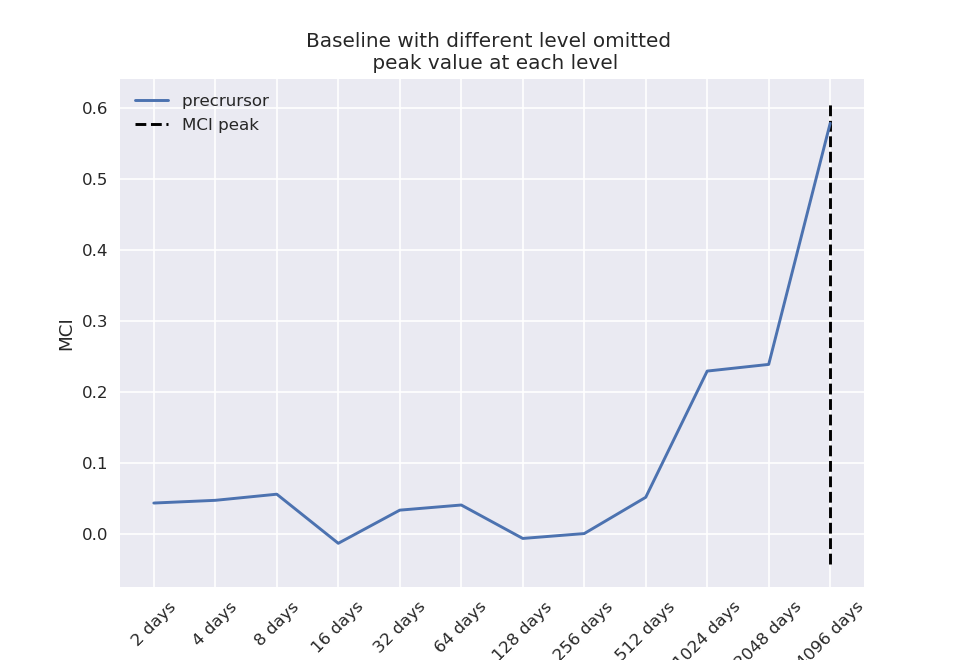

In [130]:
plot_mci_pred_relation(cA=np.arange(len(mcis)), prec_lag=mcis, path=' ', title=f'Baseline with different level omitted \n peak value at each level', show_level=False, savefig=False)

### Run experiment with wavelet decomposition on yprime  with default Tau(0,2)


[INFO] Extracting level 0
Progress causal inference - traintest set 100%

/home/jier/miniconda3/envs/RGCPD/lib/python3.7/site-packages/pandas/core/ops/__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)


<IPython.core.display.Javascript object>


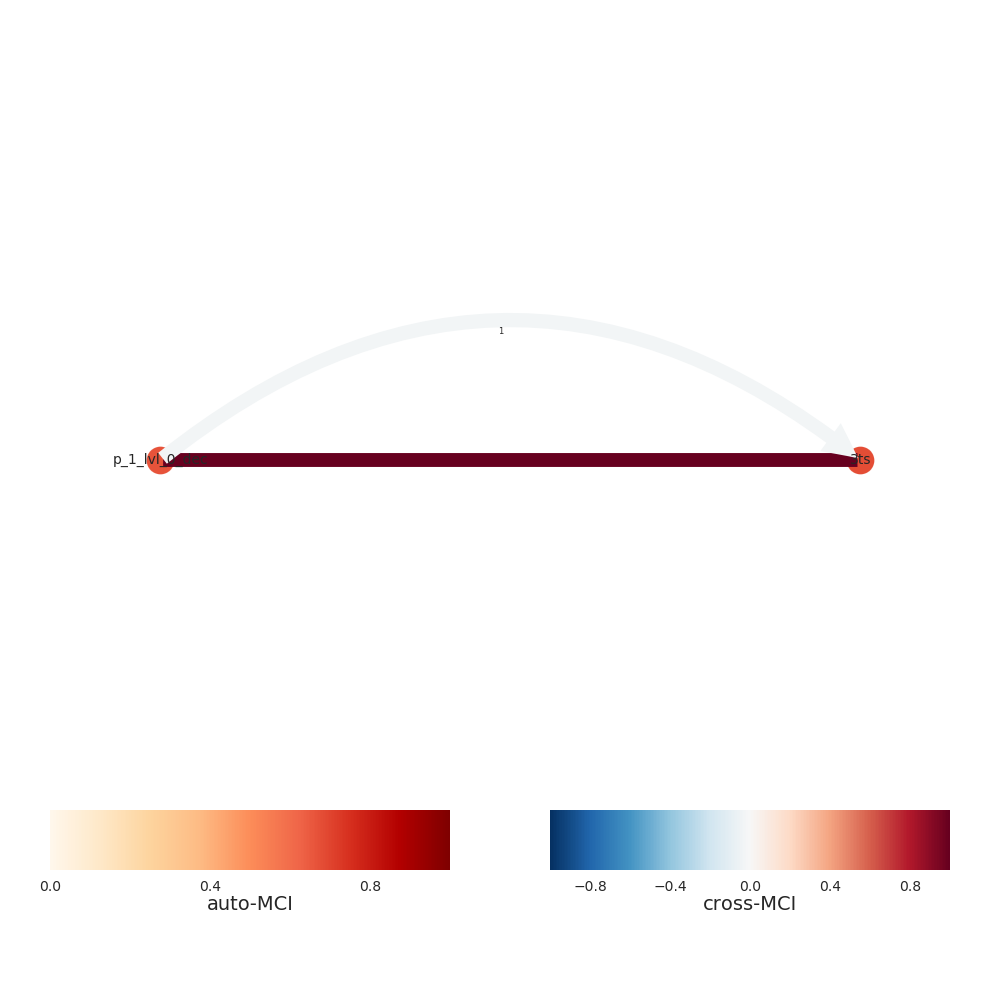

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


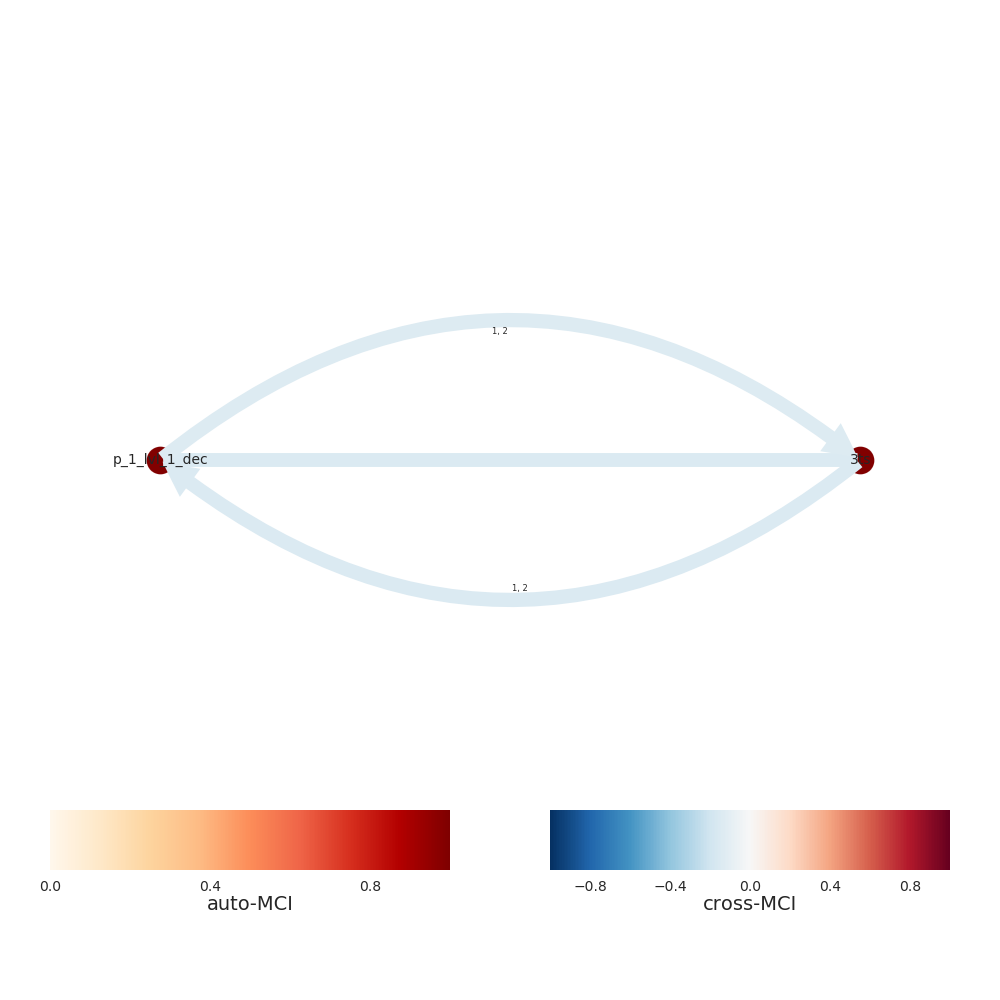

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


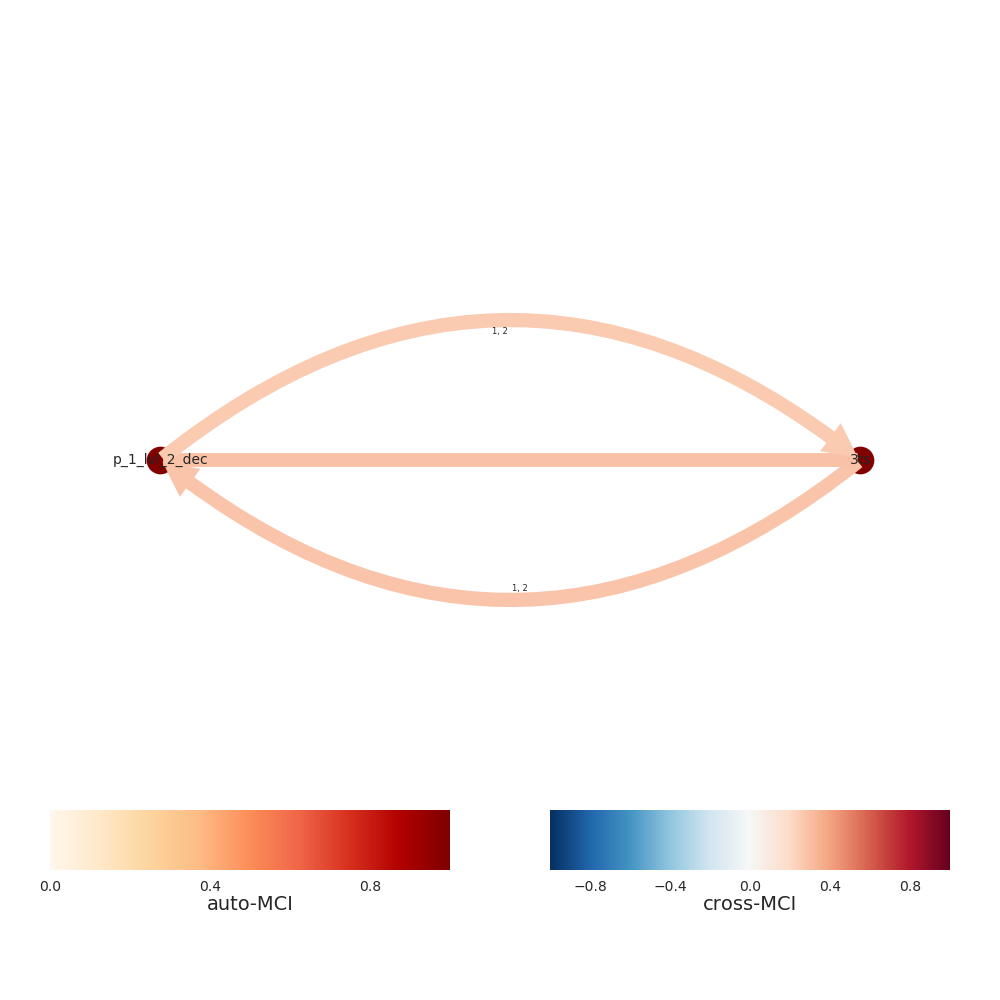

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


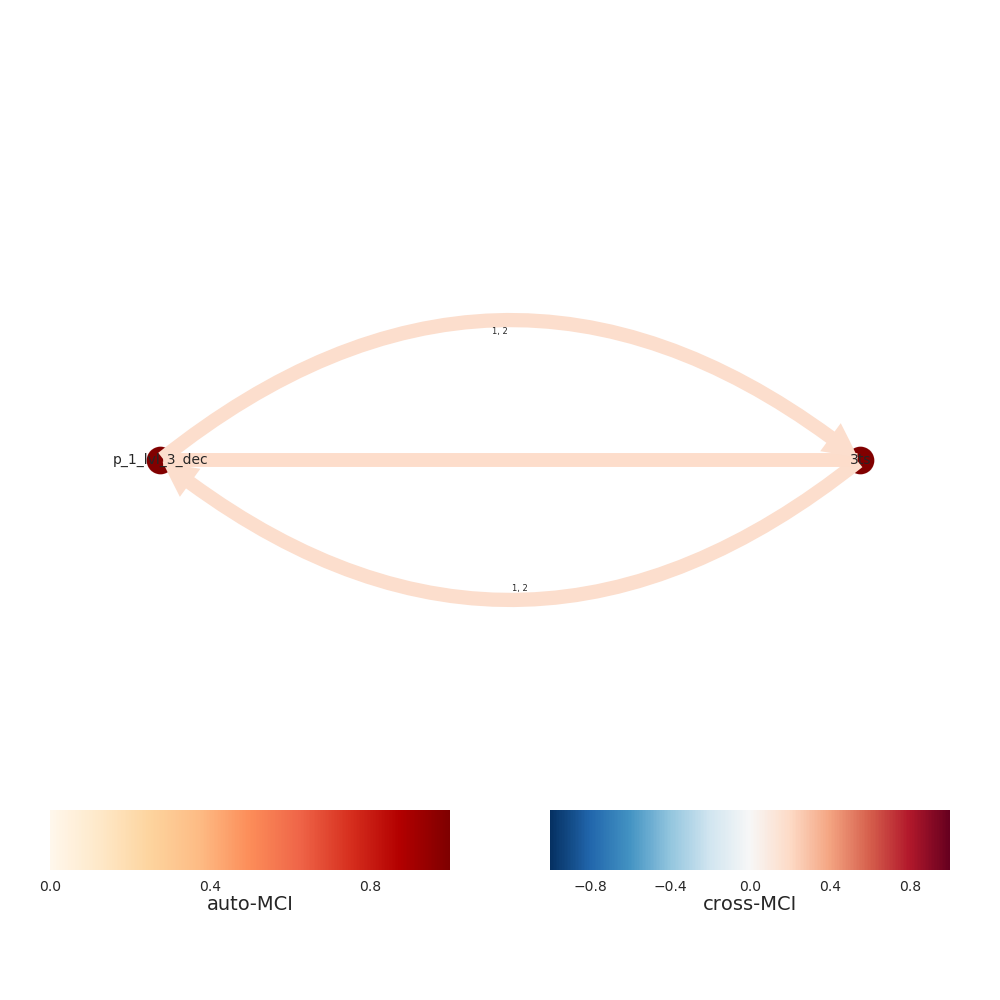

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


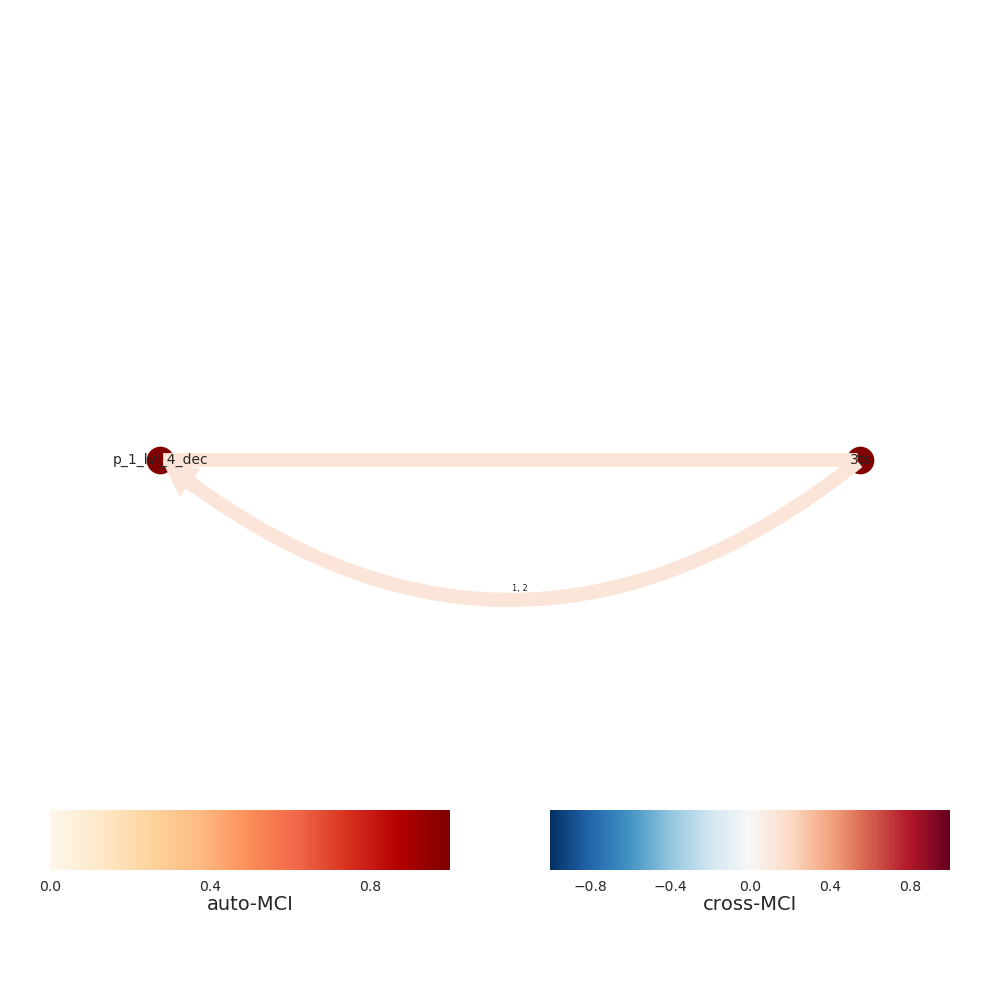

Progress causal inference - traintest set 100%
[INFO] Extracting level 1
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


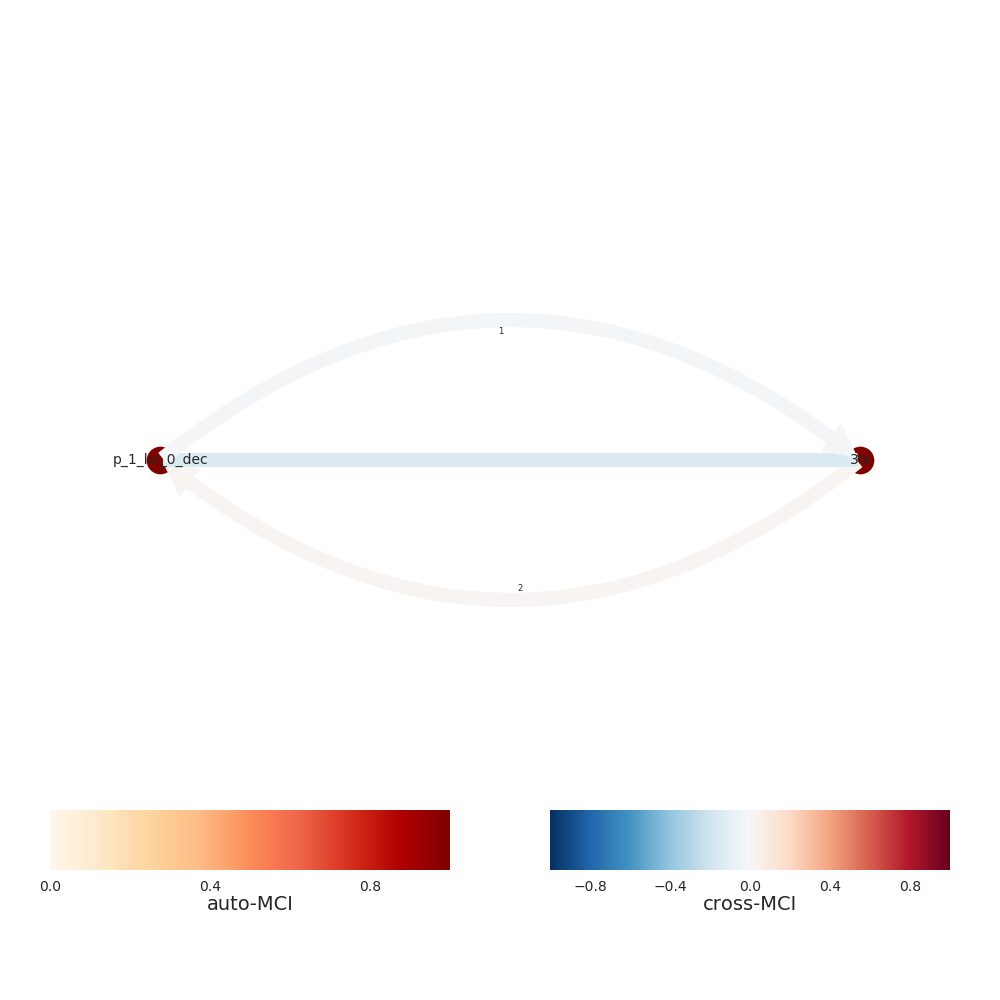

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


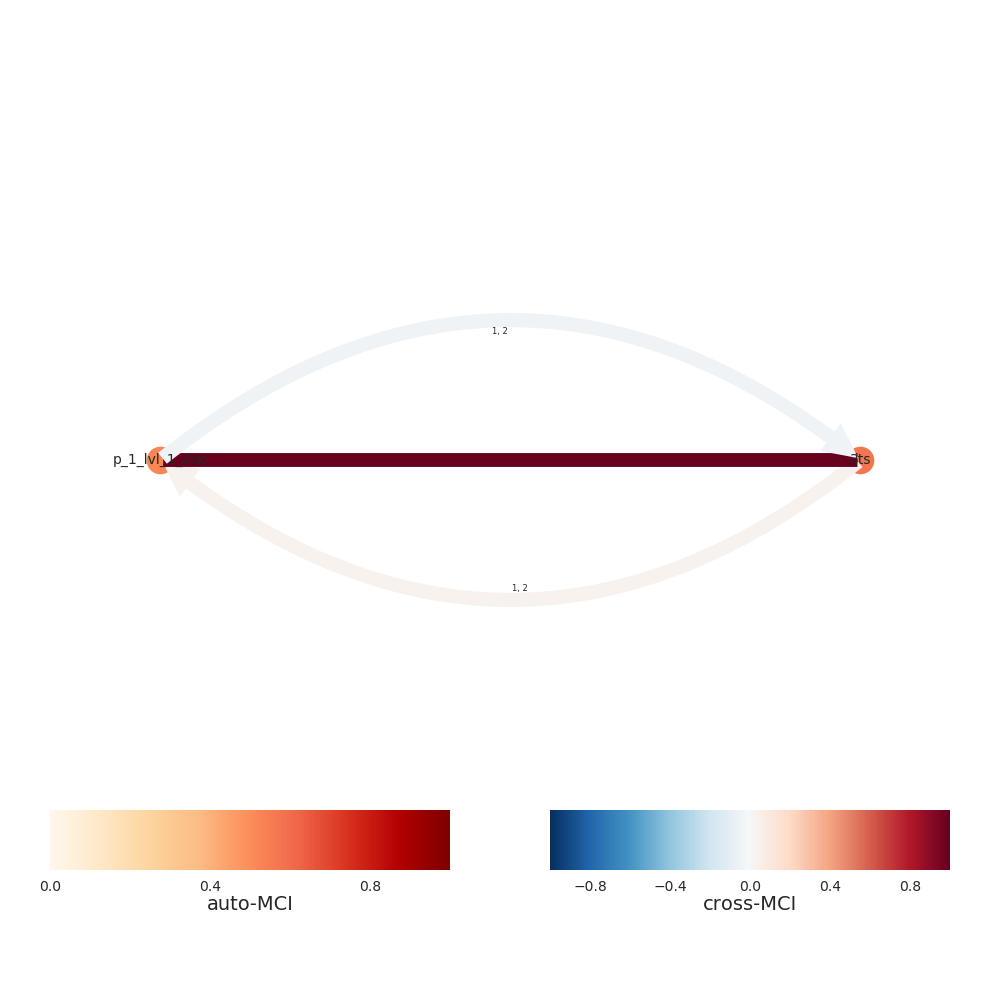

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


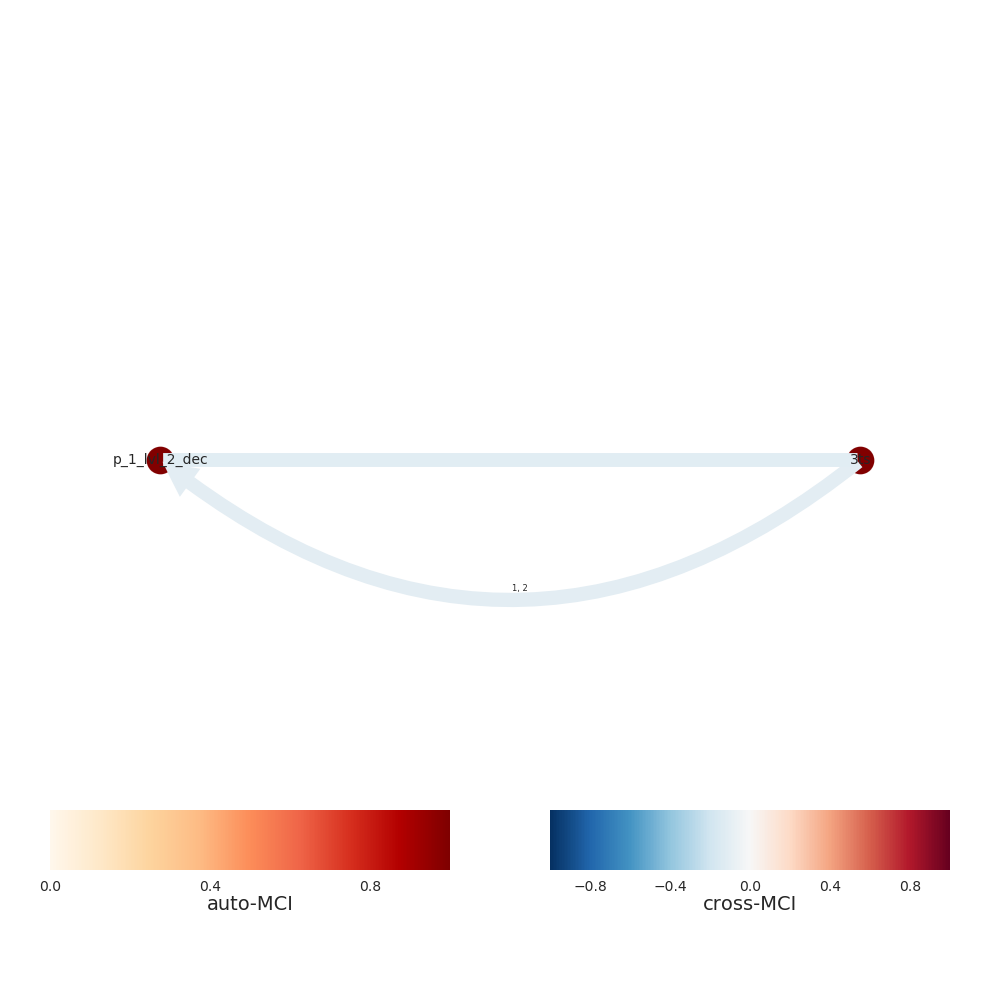

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


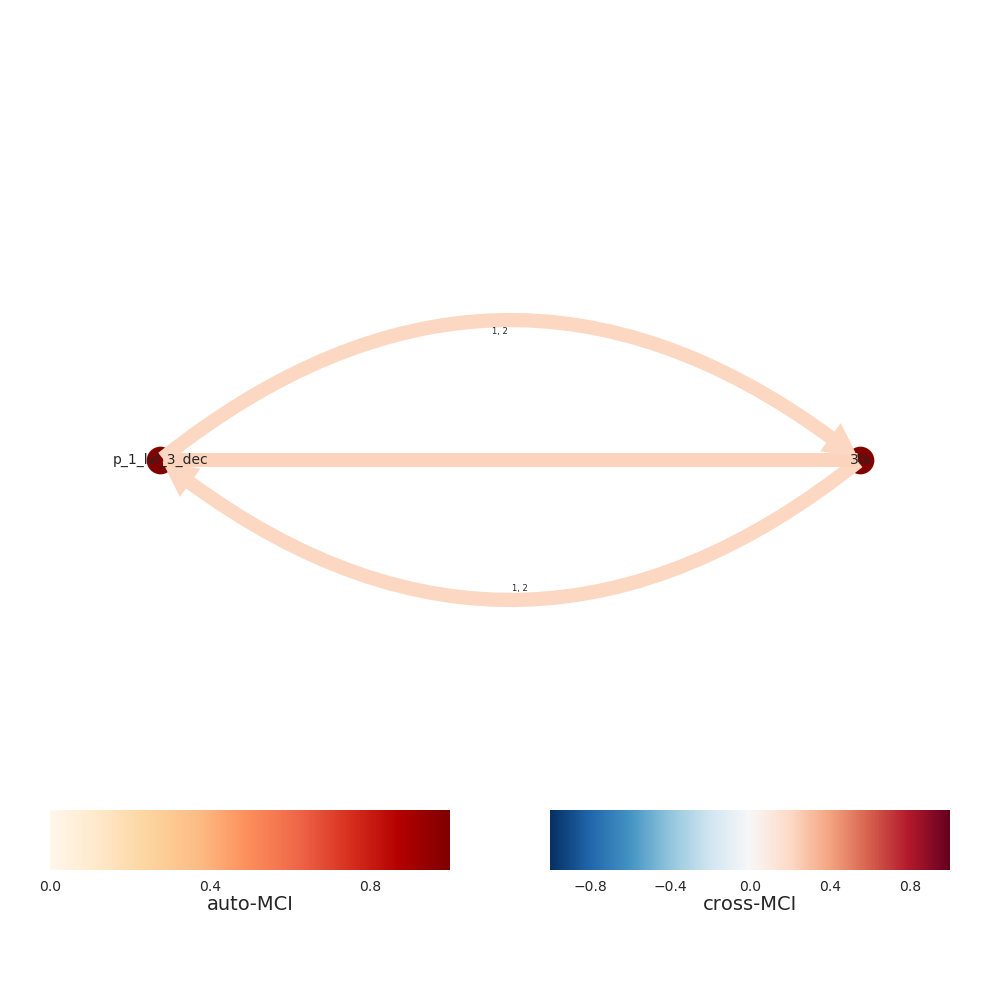

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


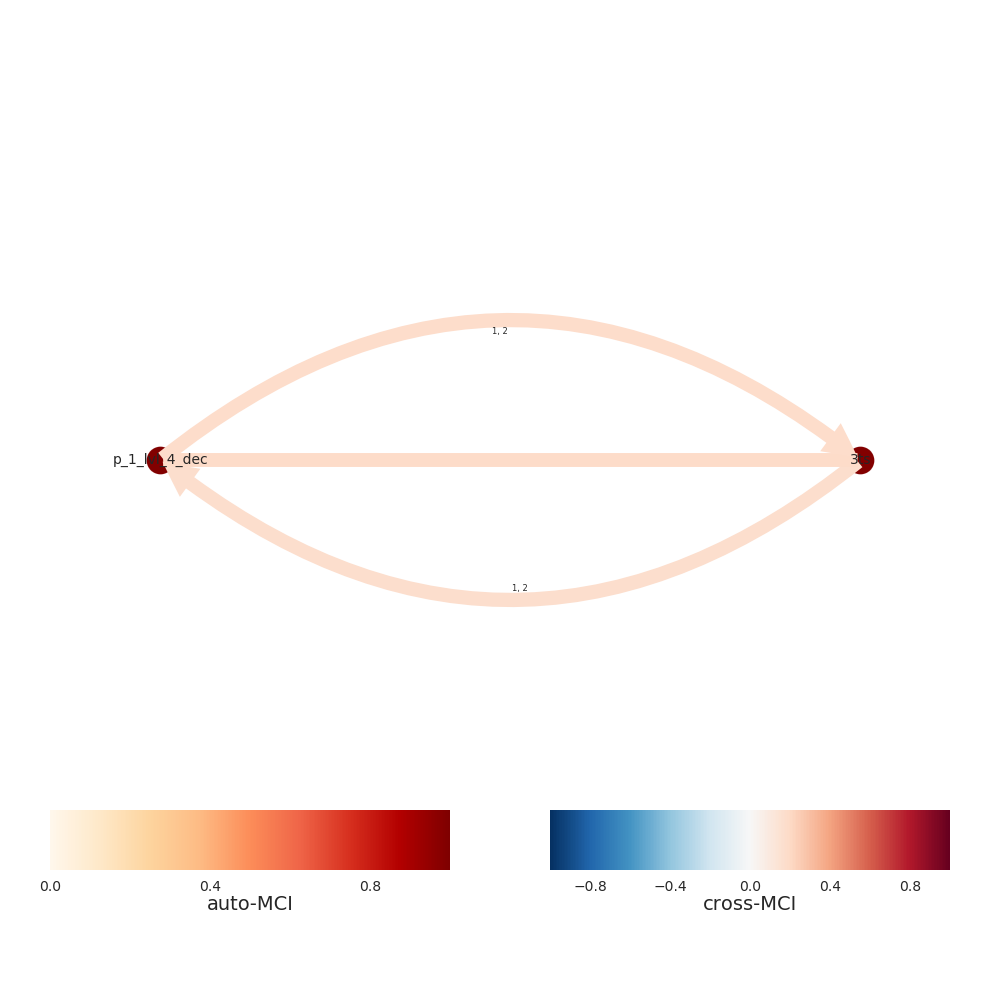

Progress causal inference - traintest set 100%
[INFO] Extracting level 2
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


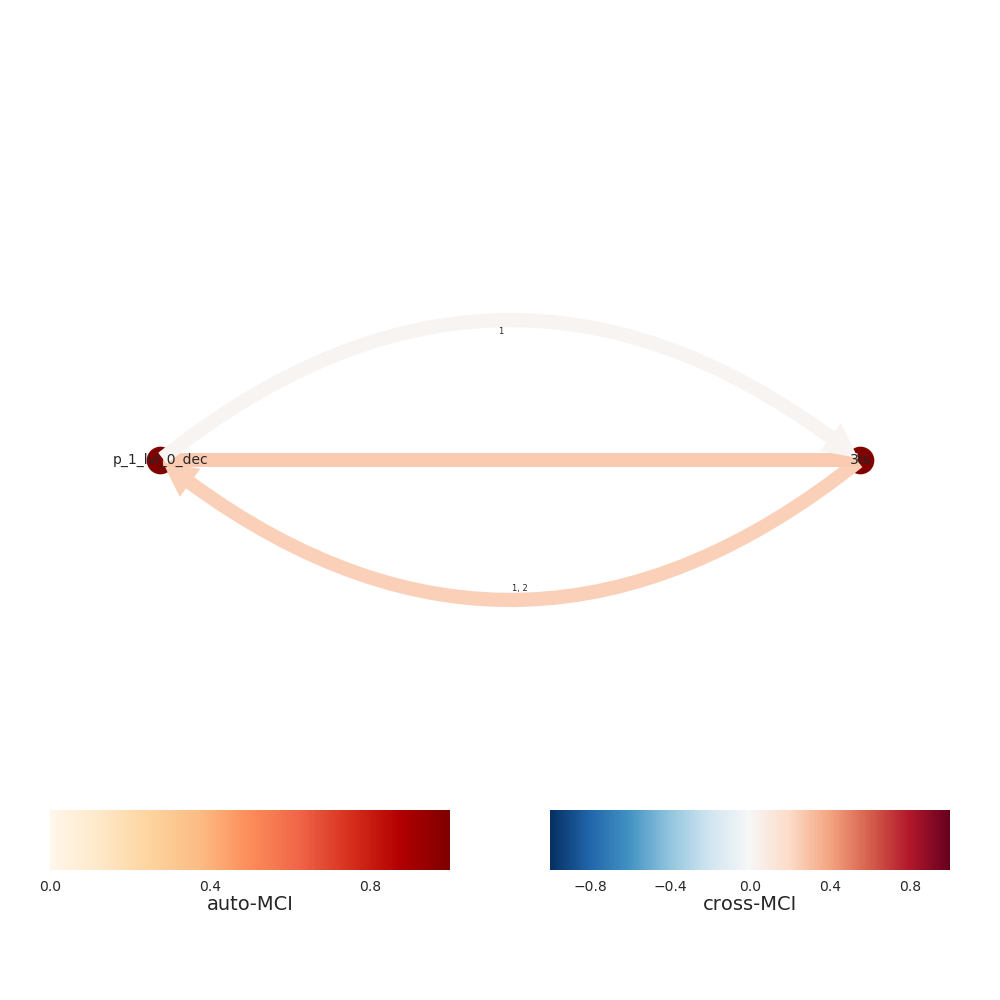

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


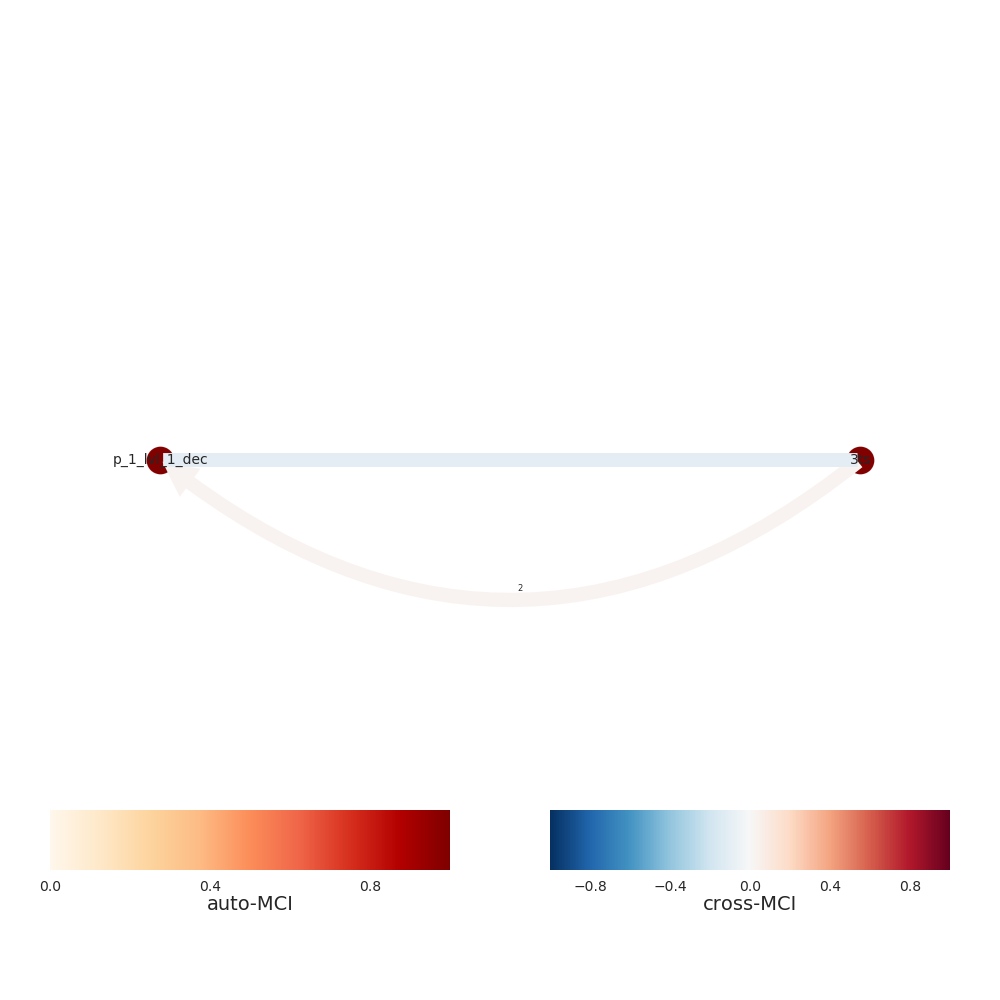

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


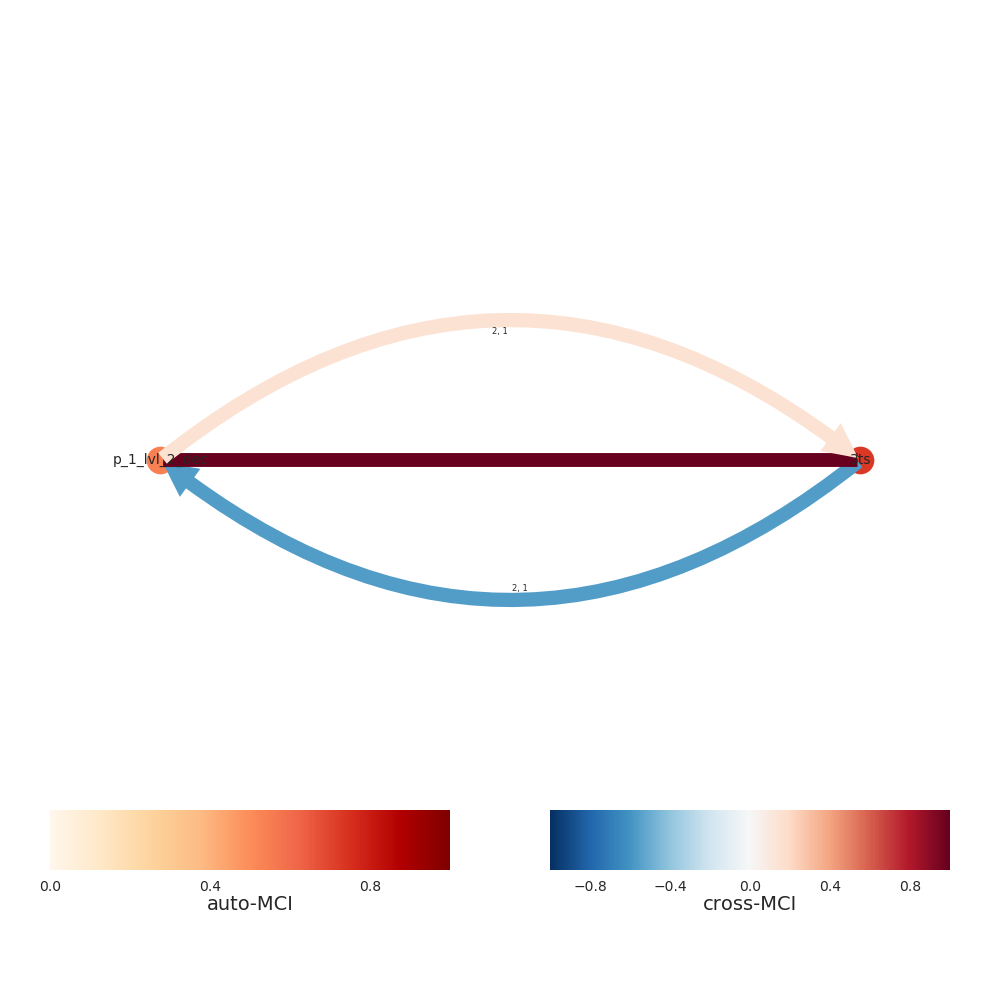

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


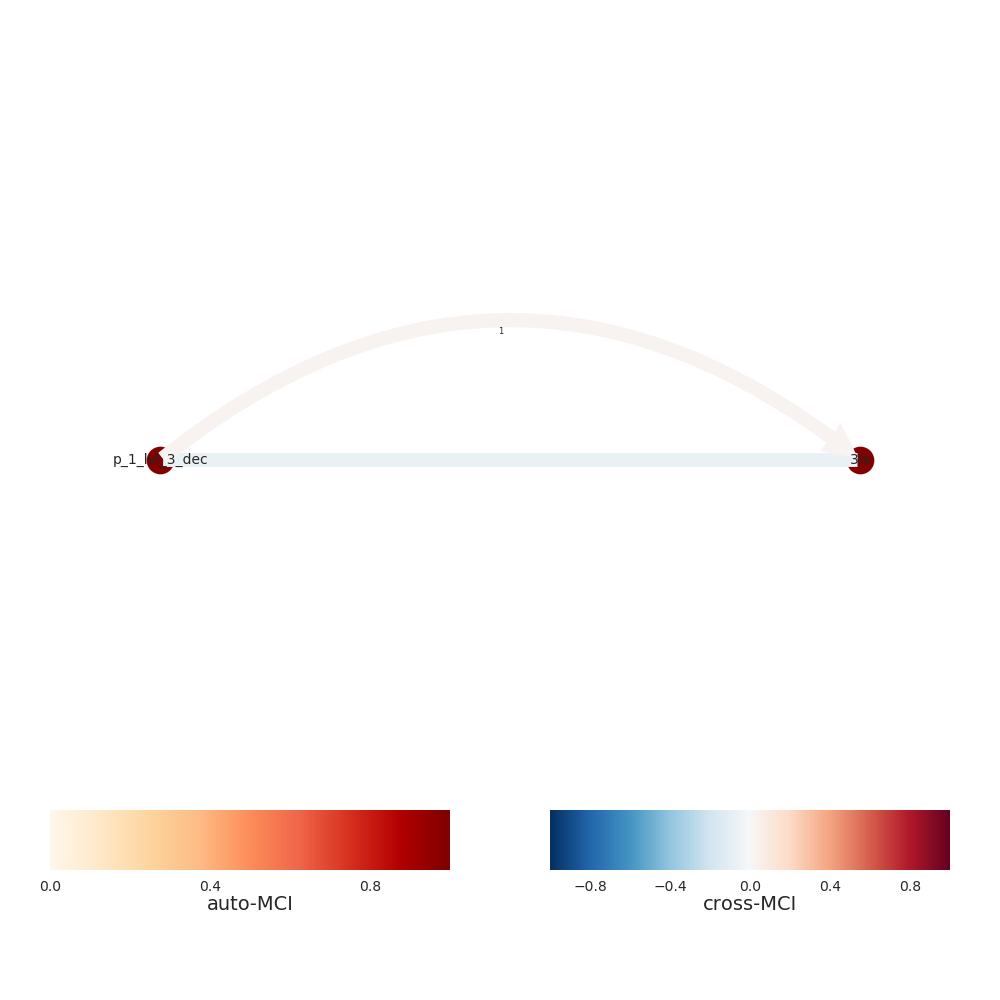

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


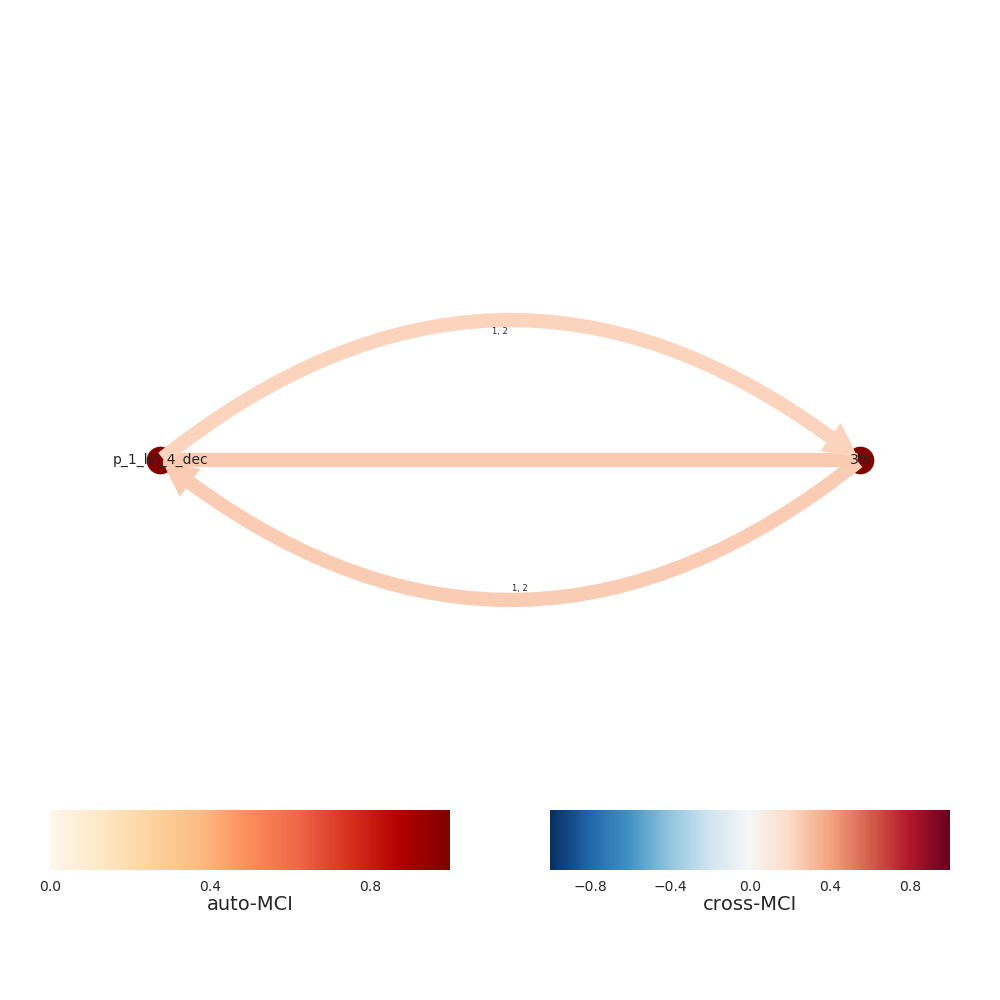

Progress causal inference - traintest set 100%
[INFO] Extracting level 3
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


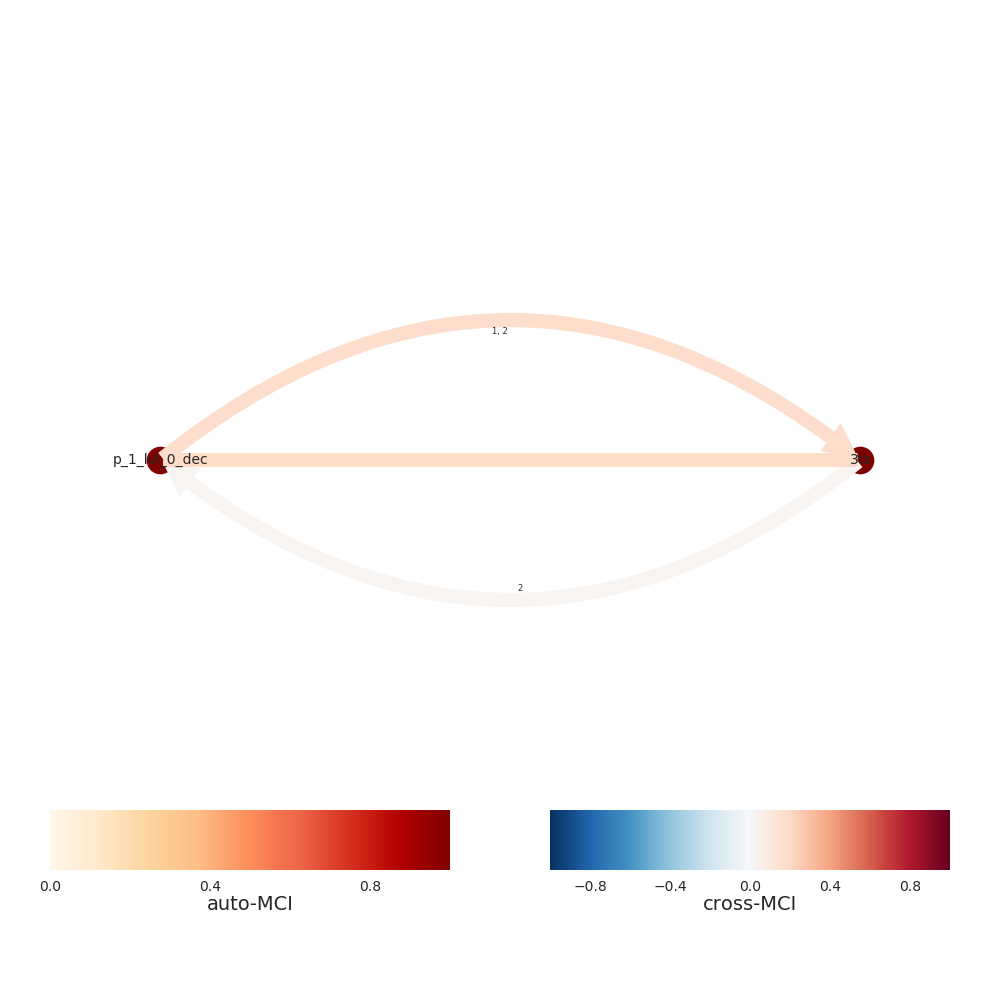

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


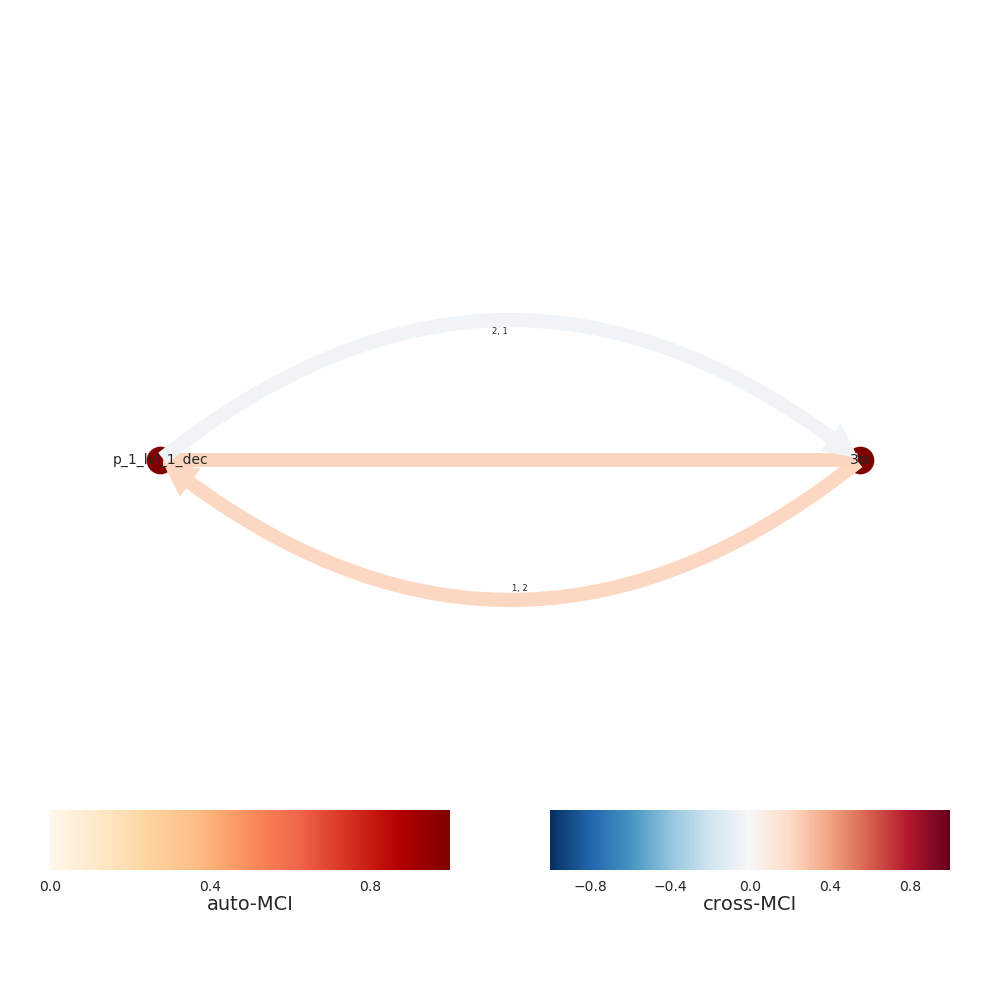

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


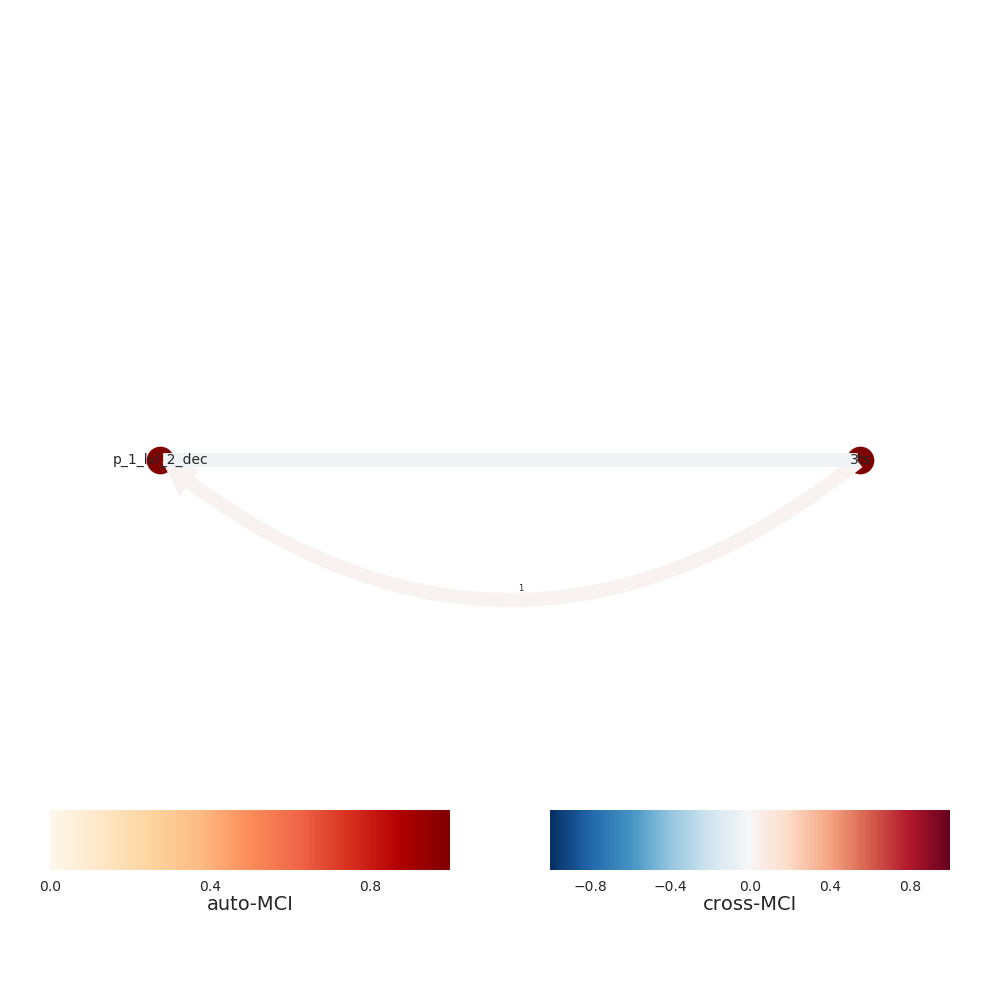

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


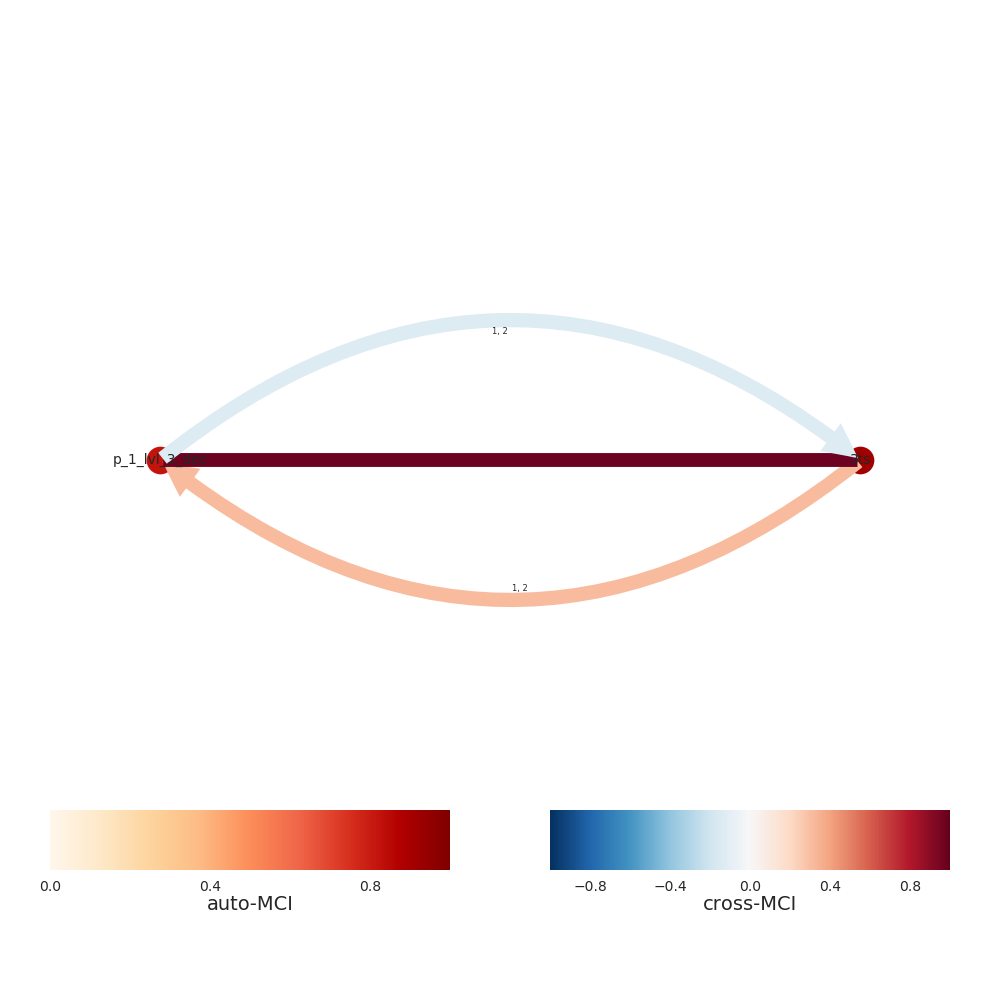

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


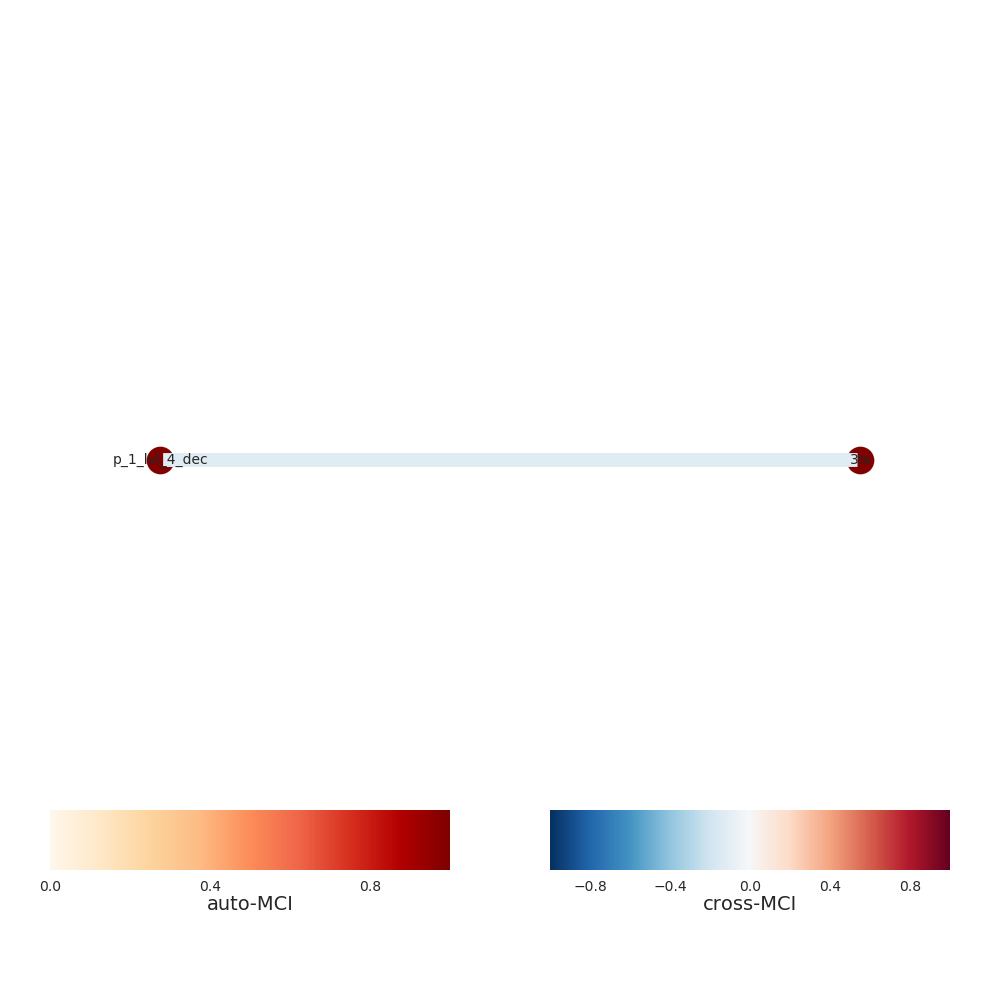

Progress causal inference - traintest set 100%
[INFO] Extracting level 4
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


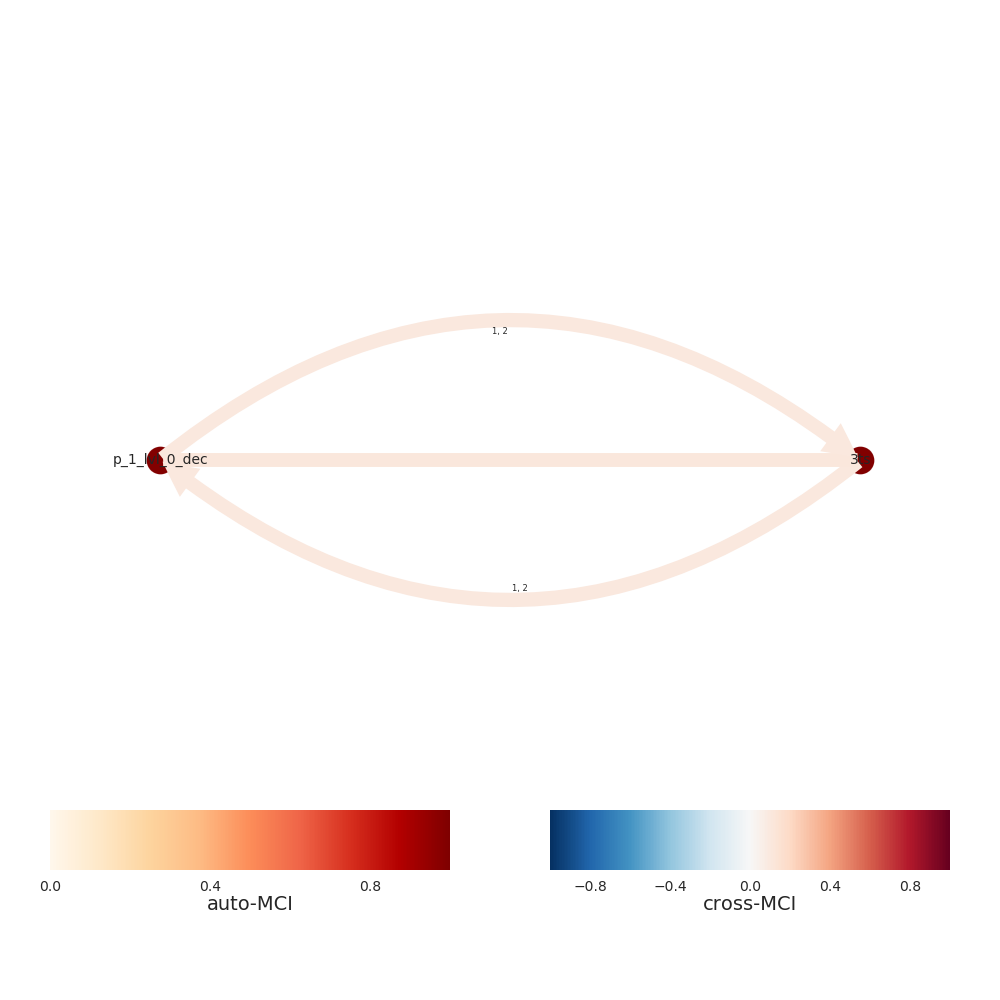

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


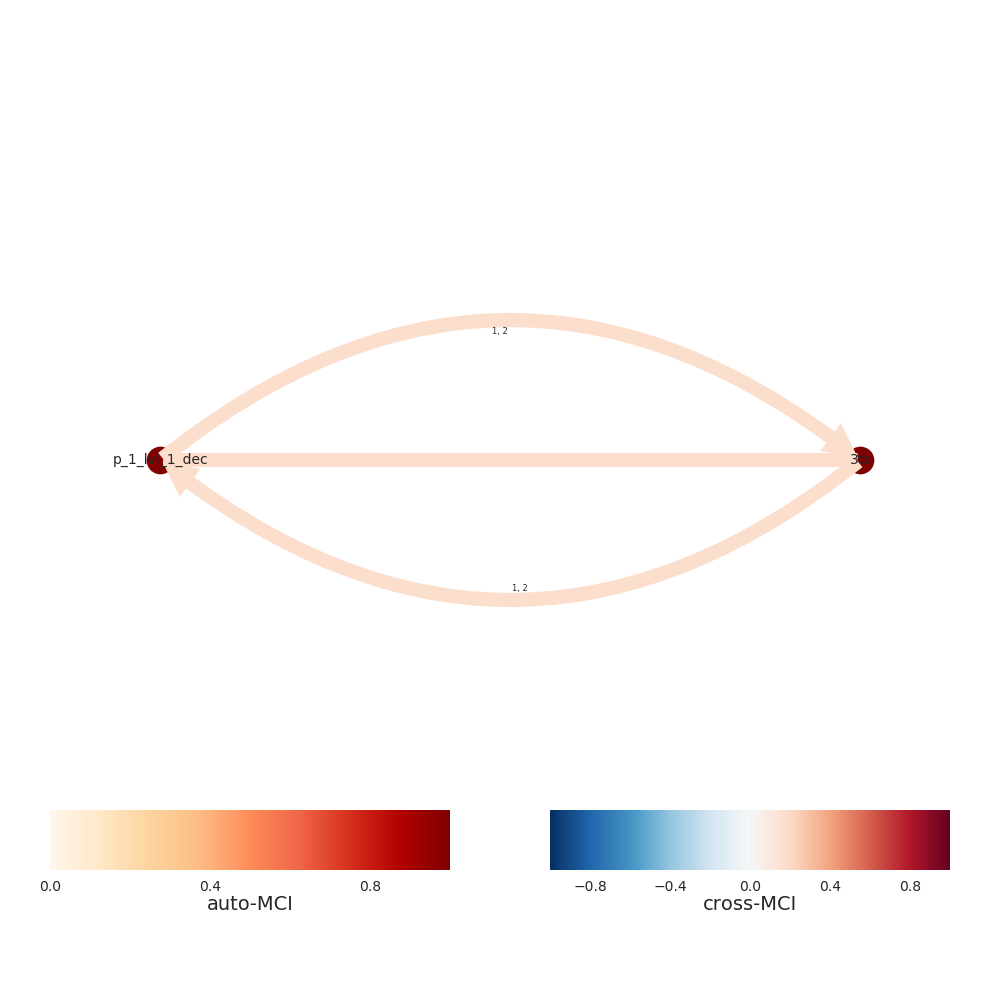

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


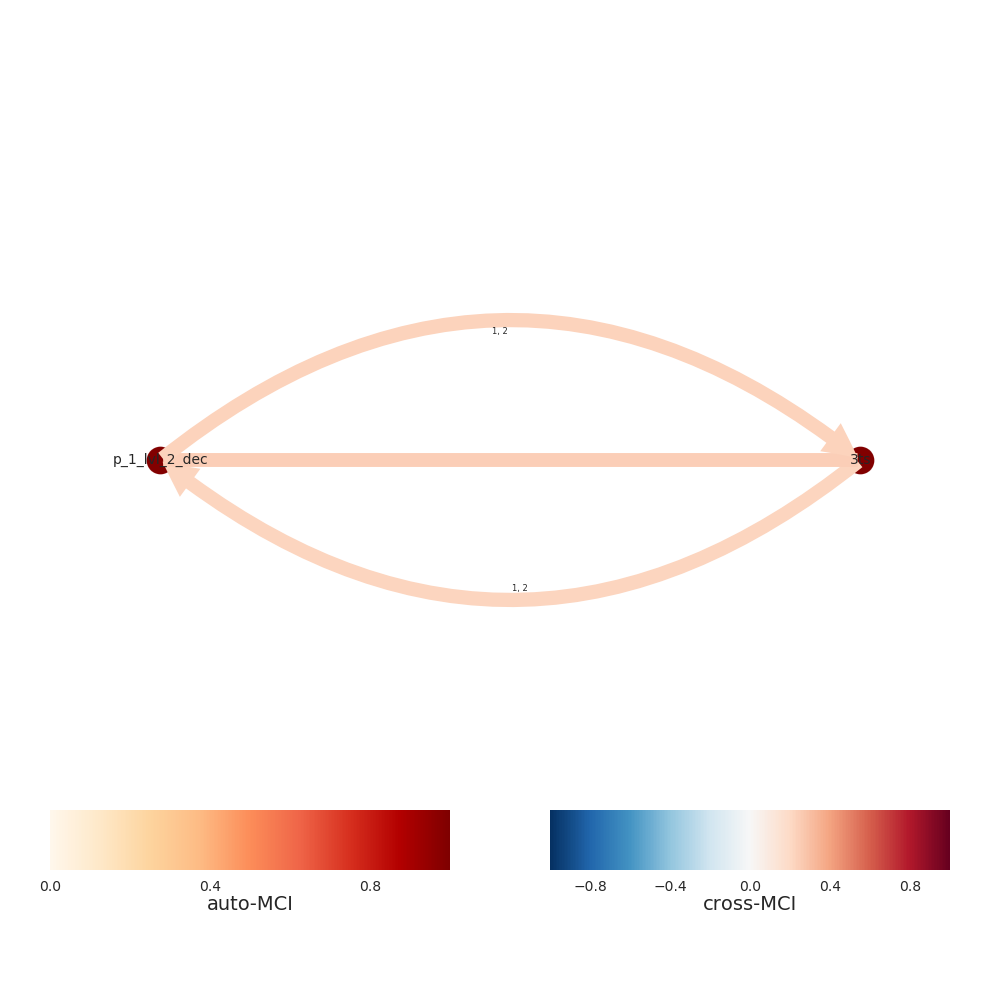

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


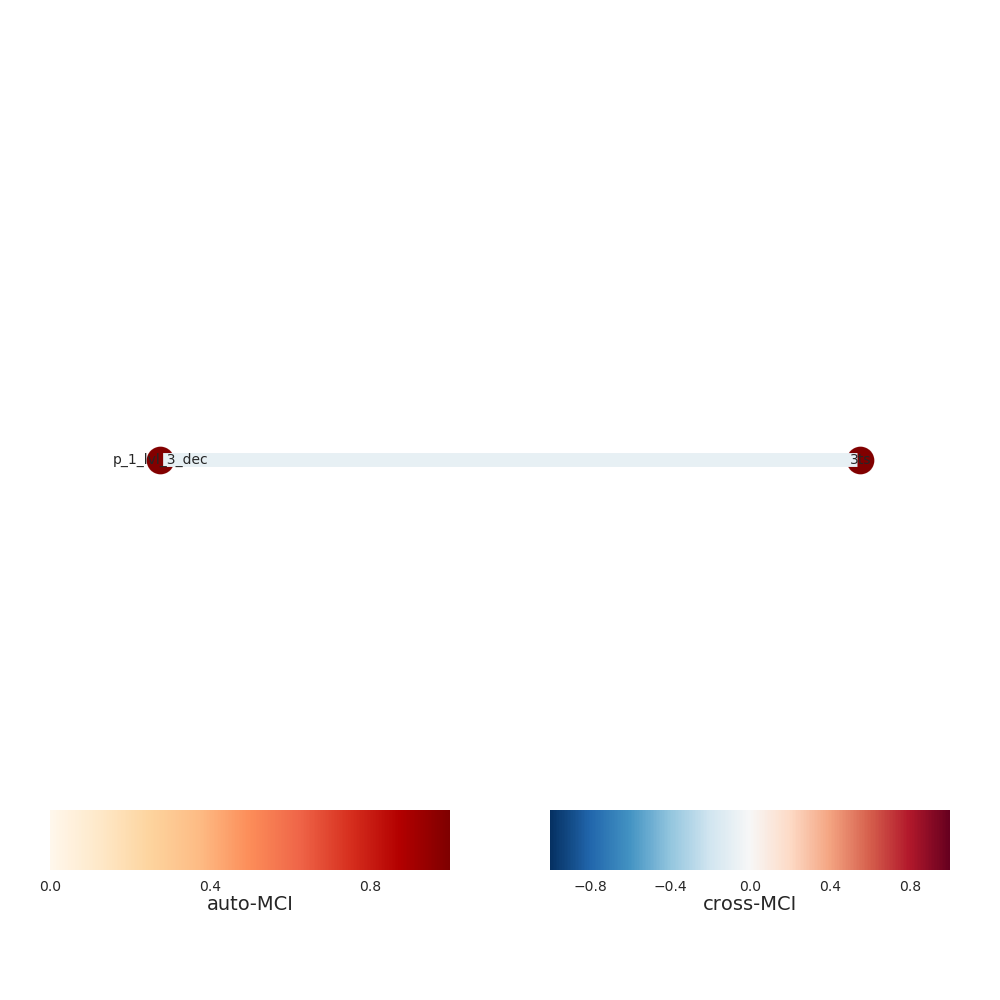

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


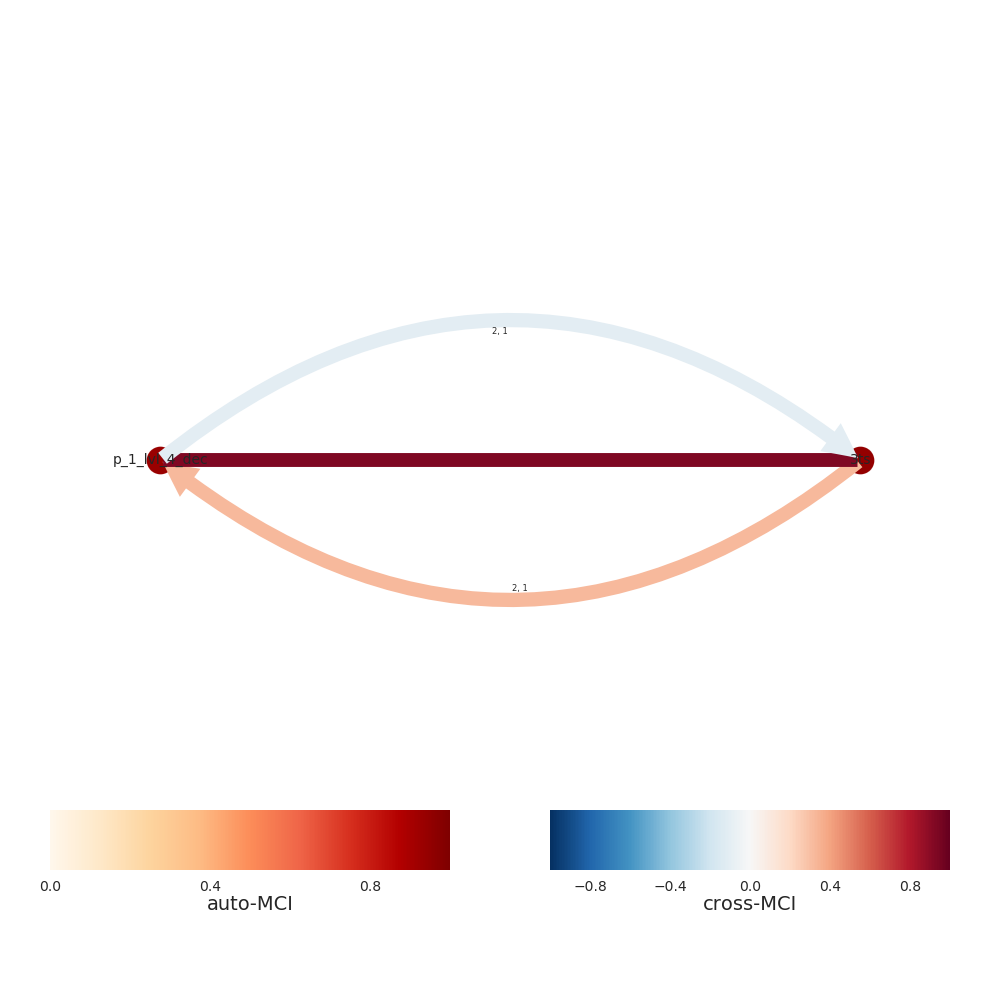

Progress causal inference - traintest set 100%
[INFO] Extracting level 5
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


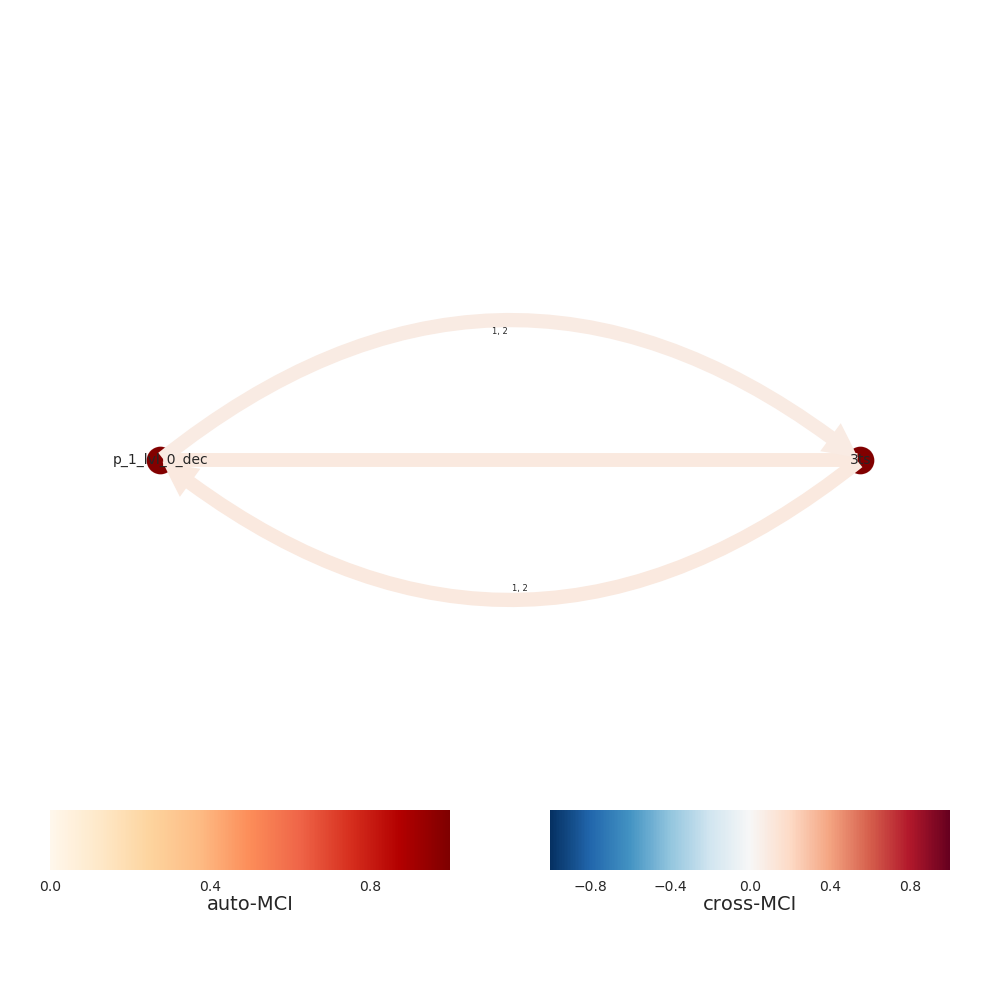

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


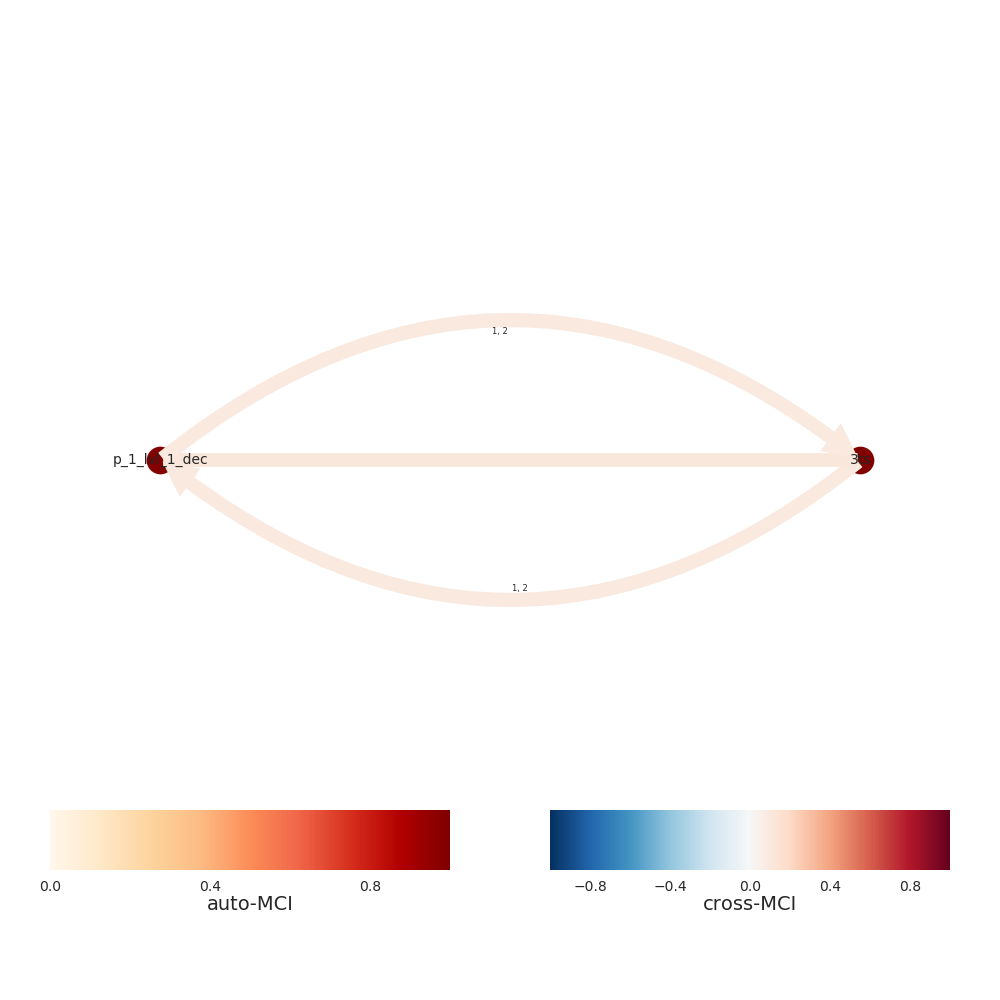

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


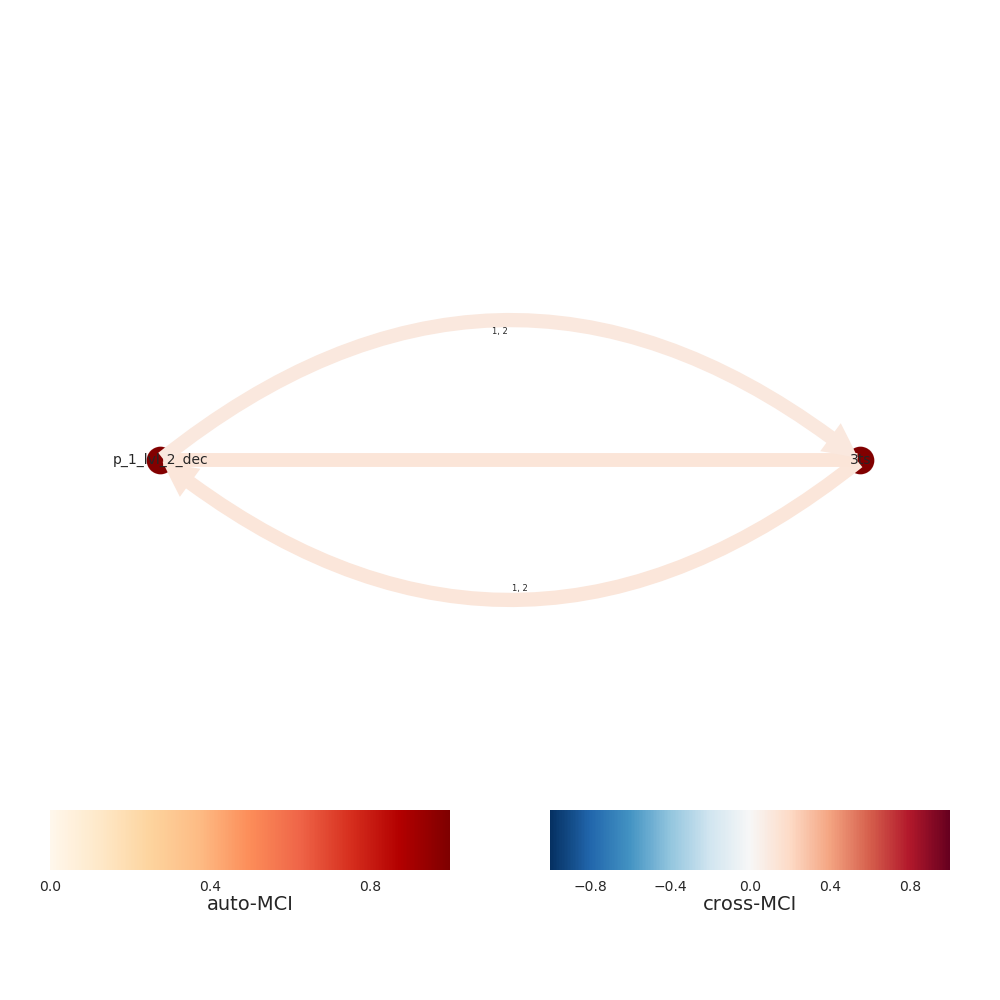

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


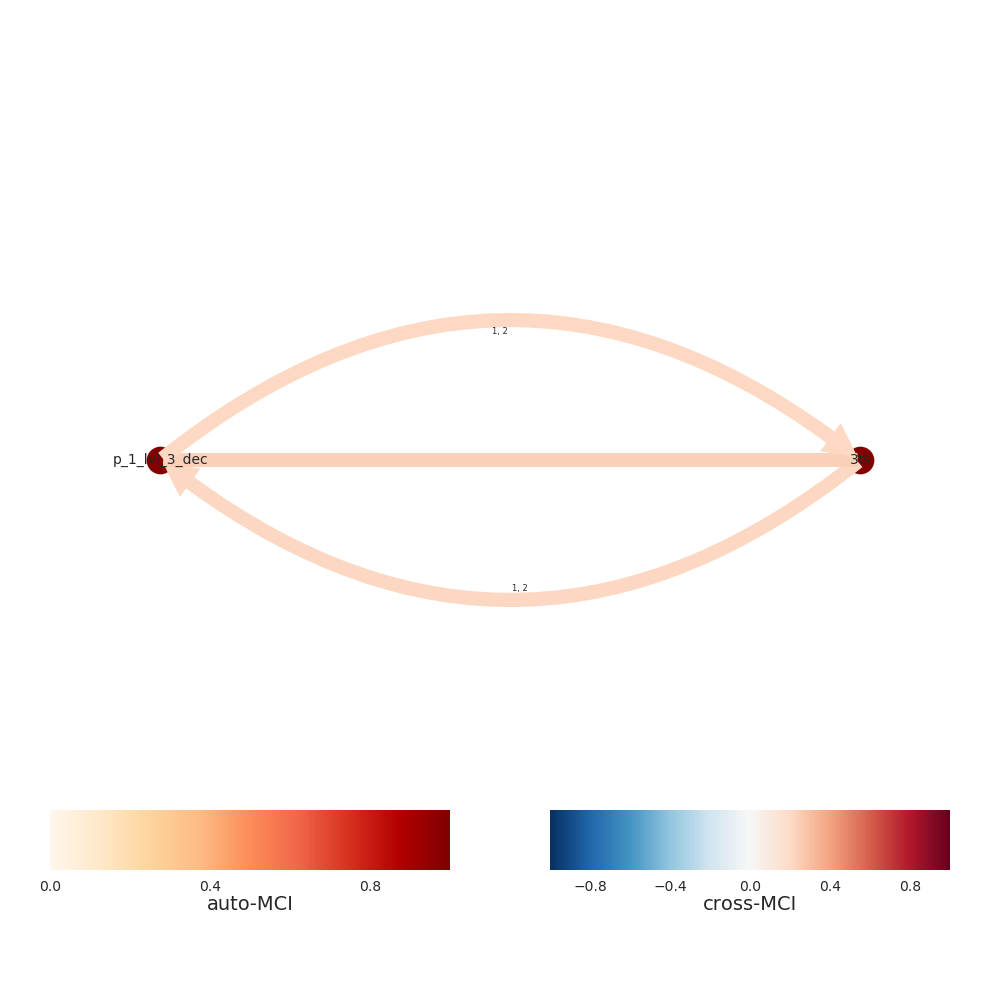

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


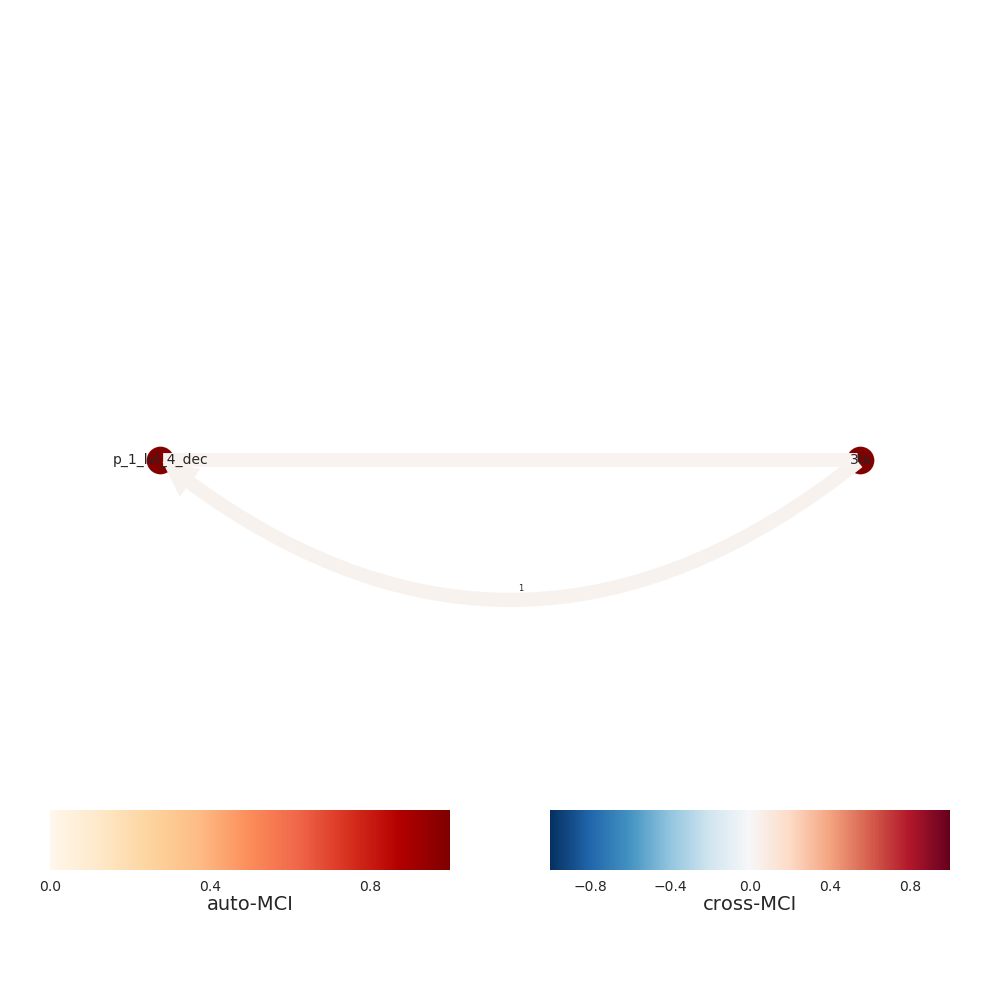

Progress causal inference - traintest set 100%
[INFO] Extracting level 6
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


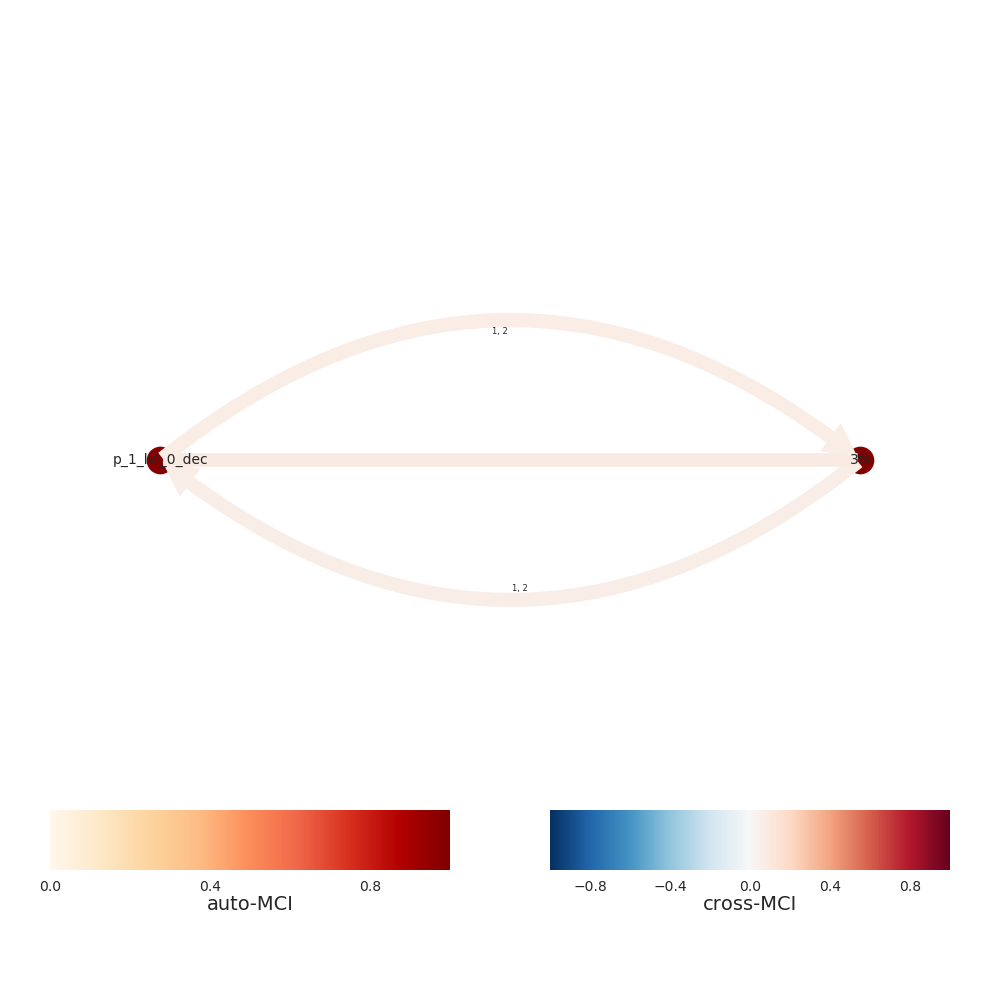

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


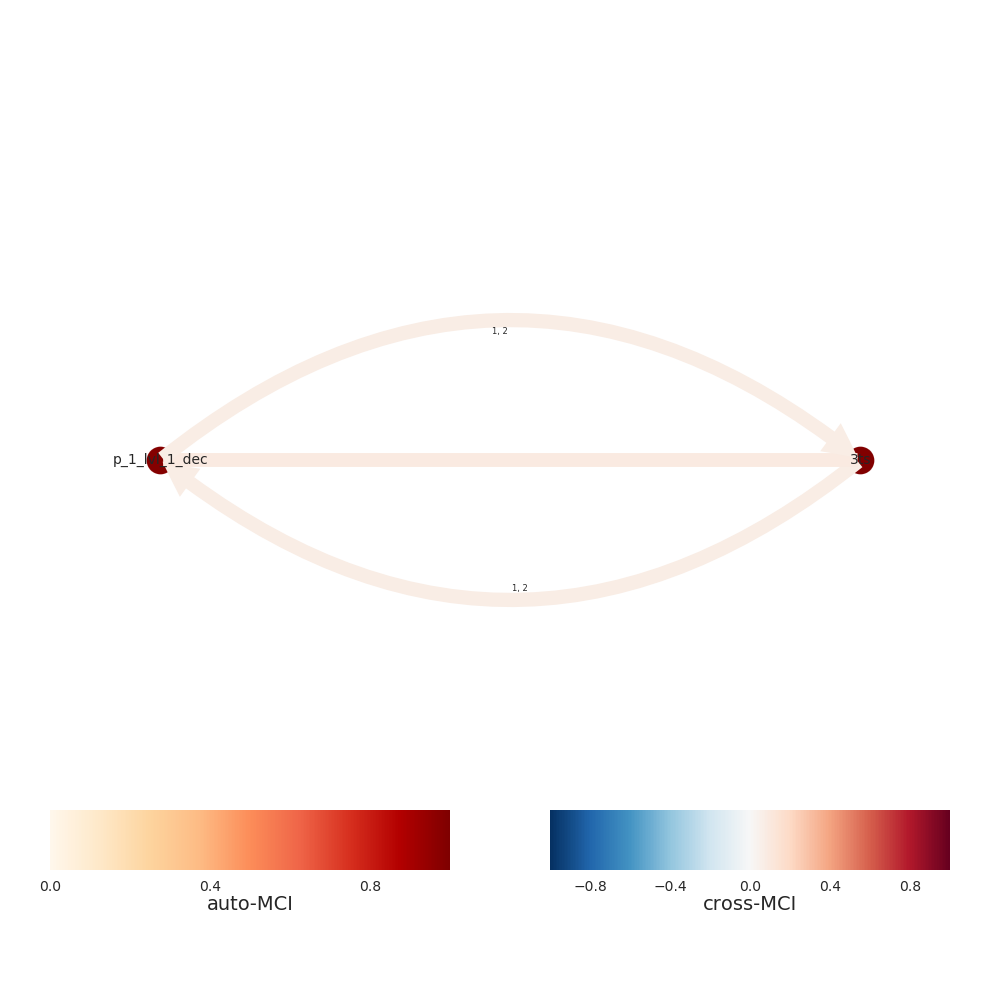

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


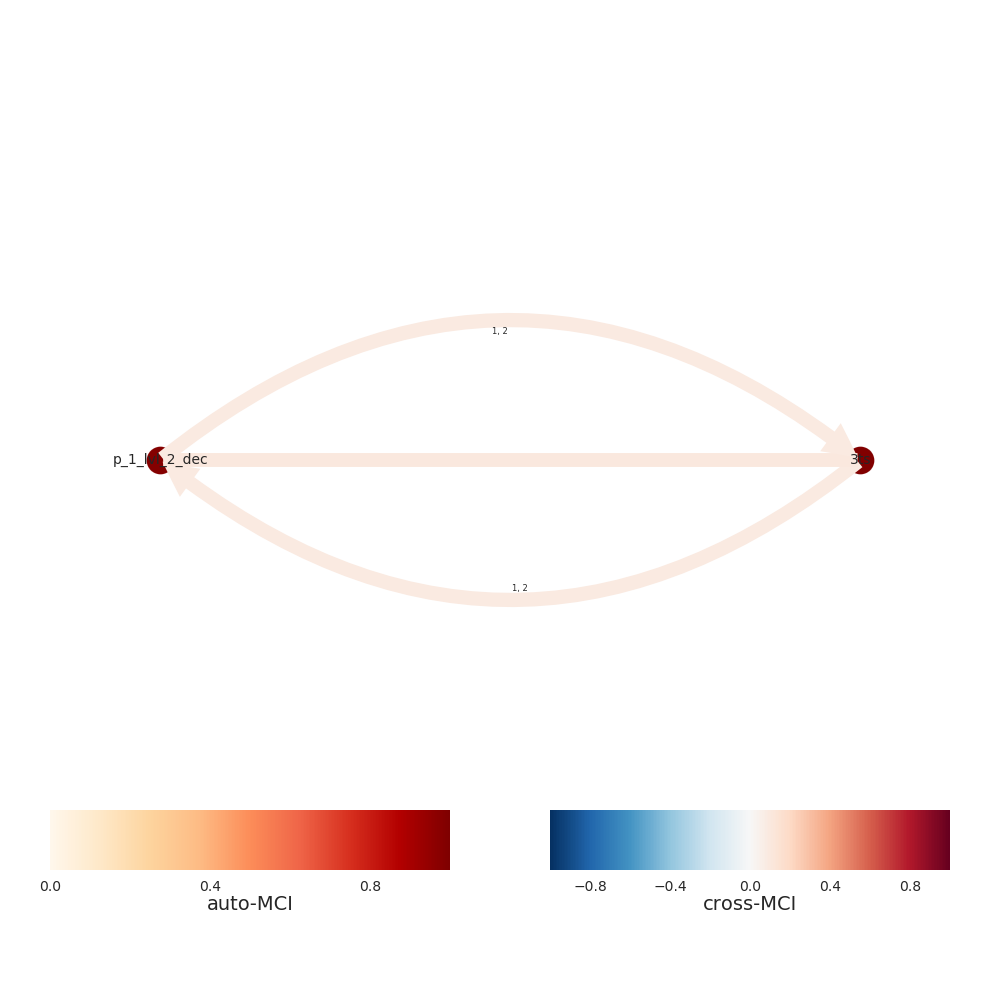

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


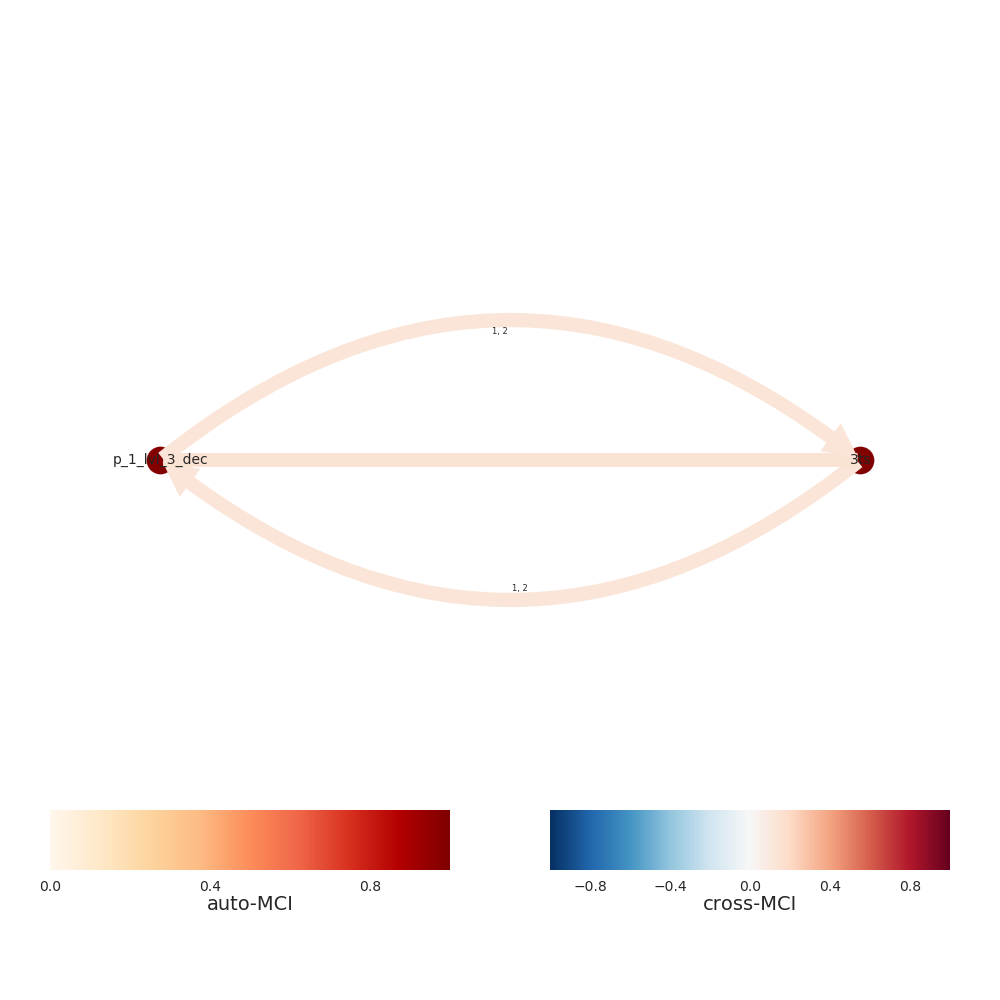

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


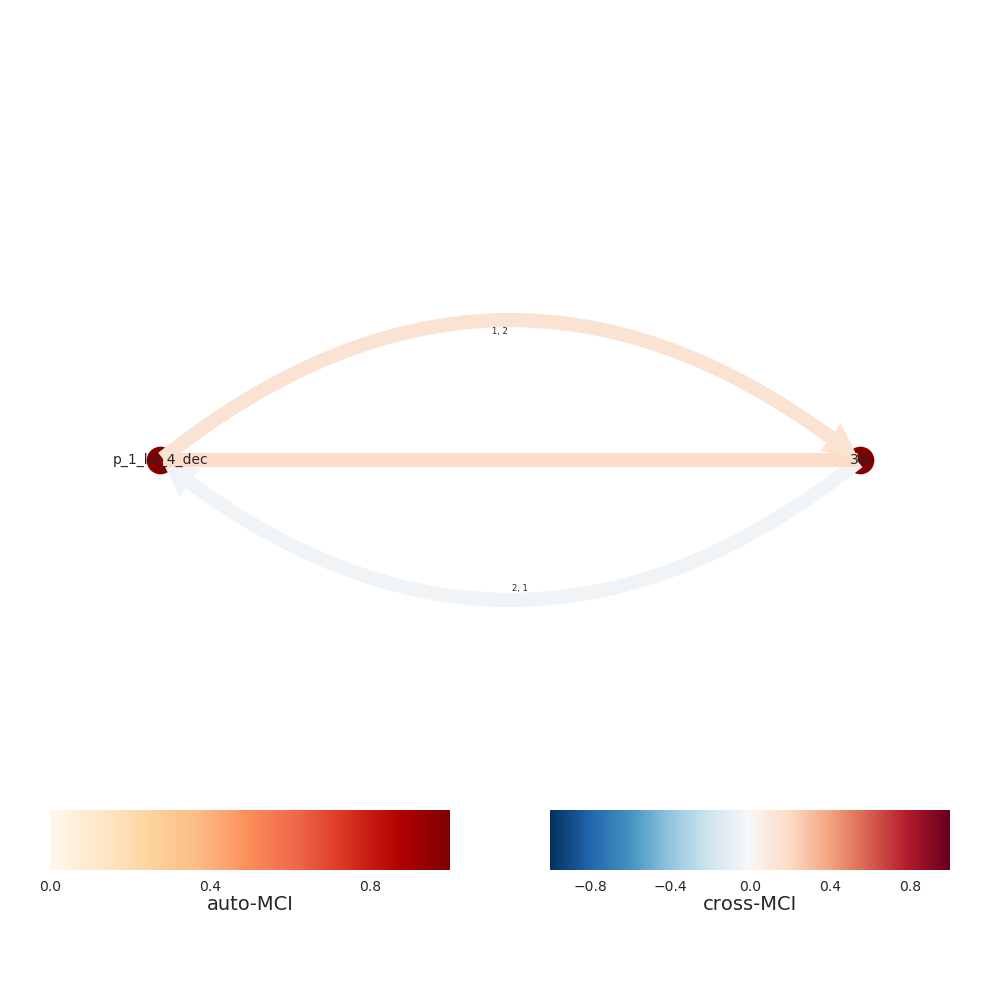

Progress causal inference - traintest set 100%
[INFO] Extracting level 7
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


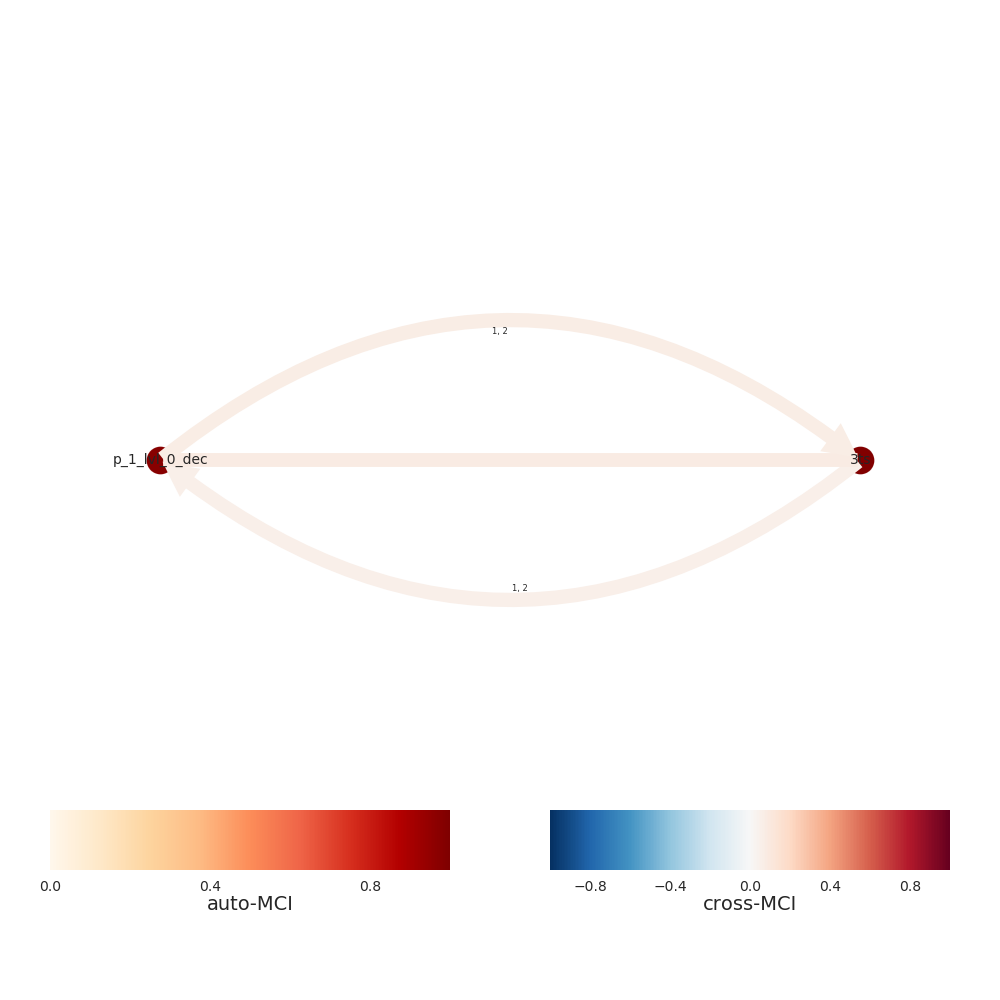

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


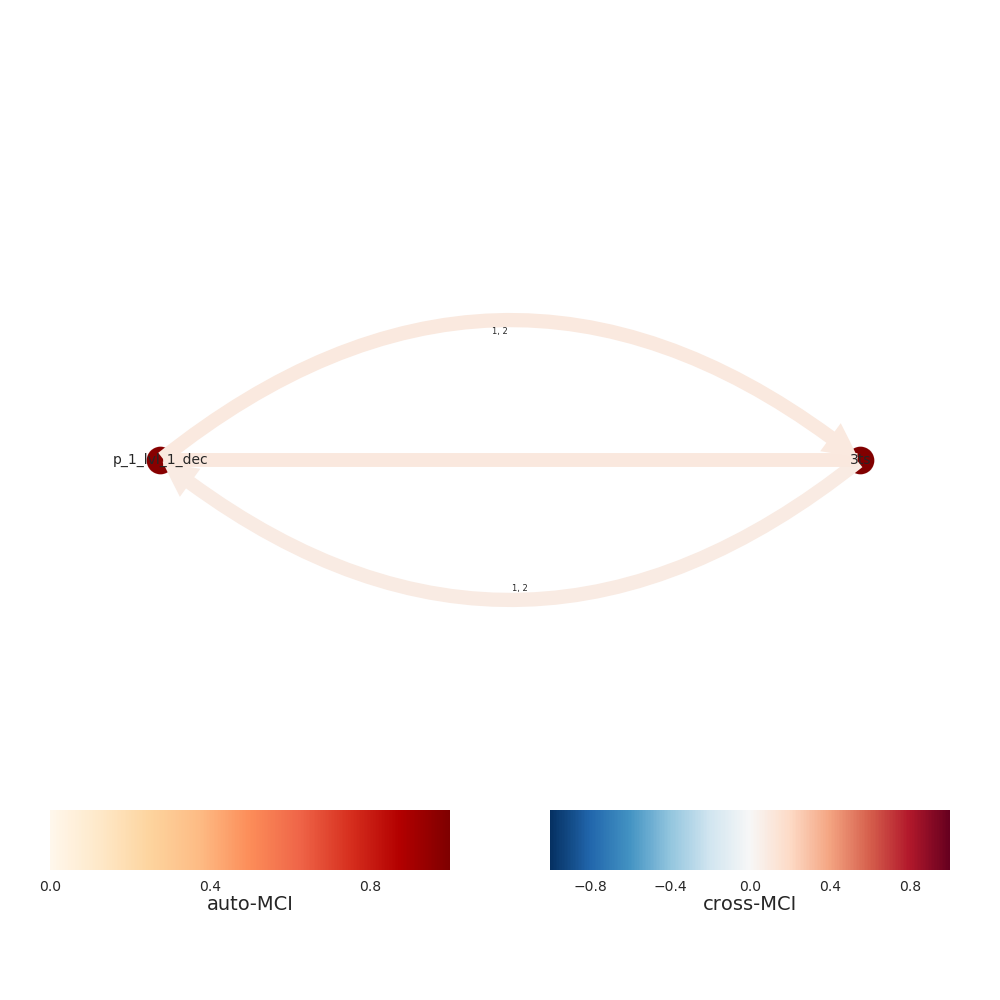

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


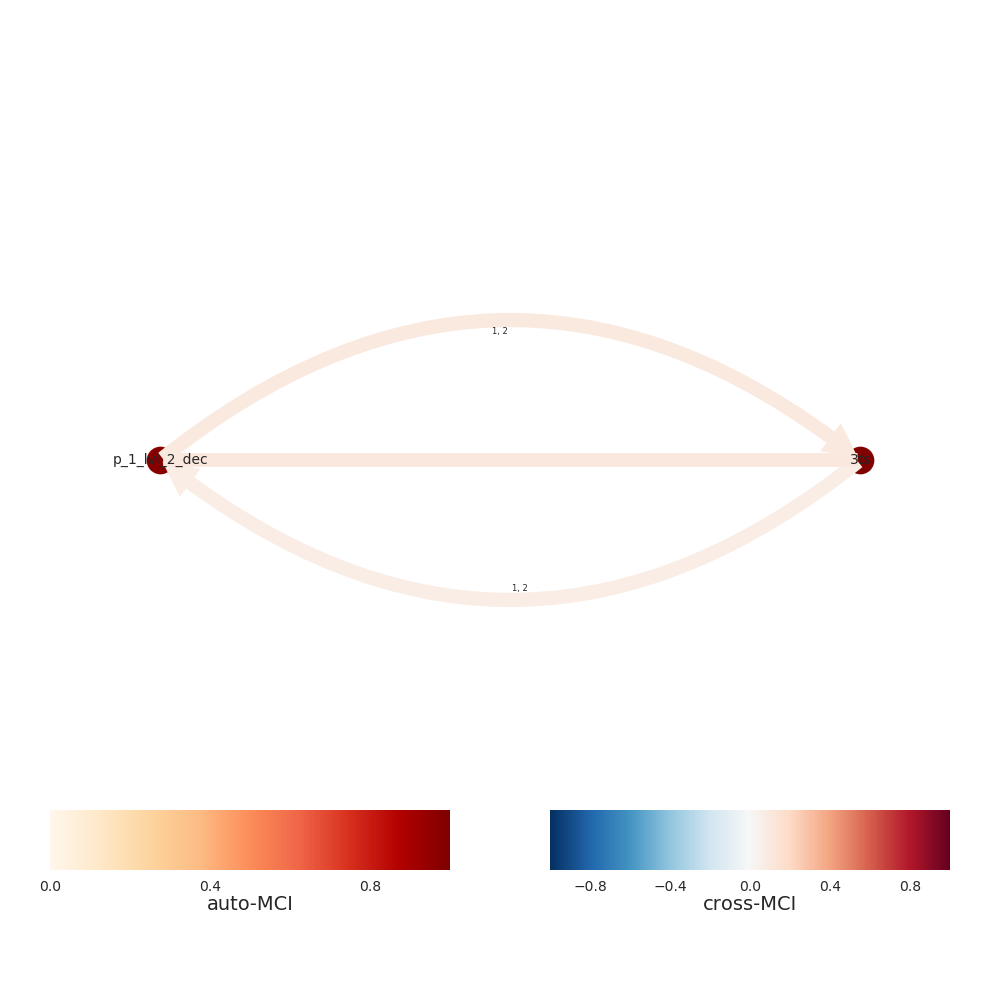

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


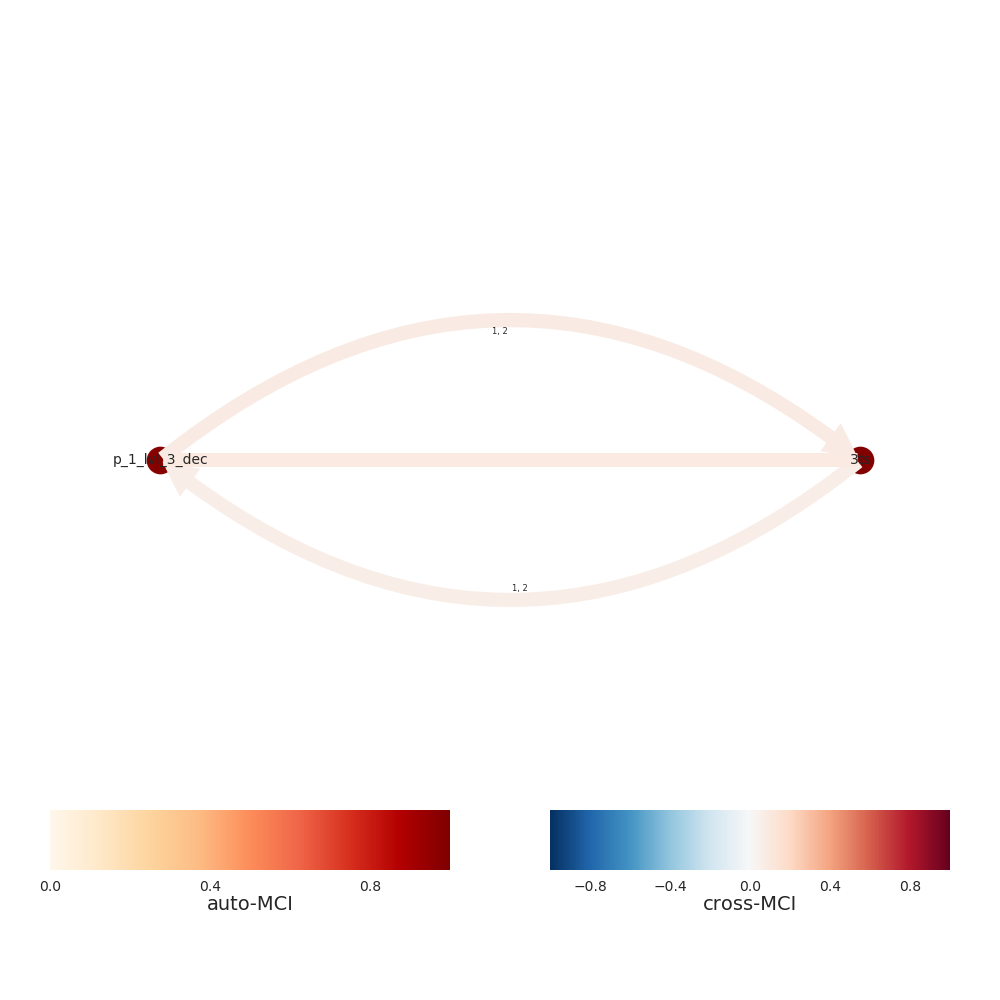

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


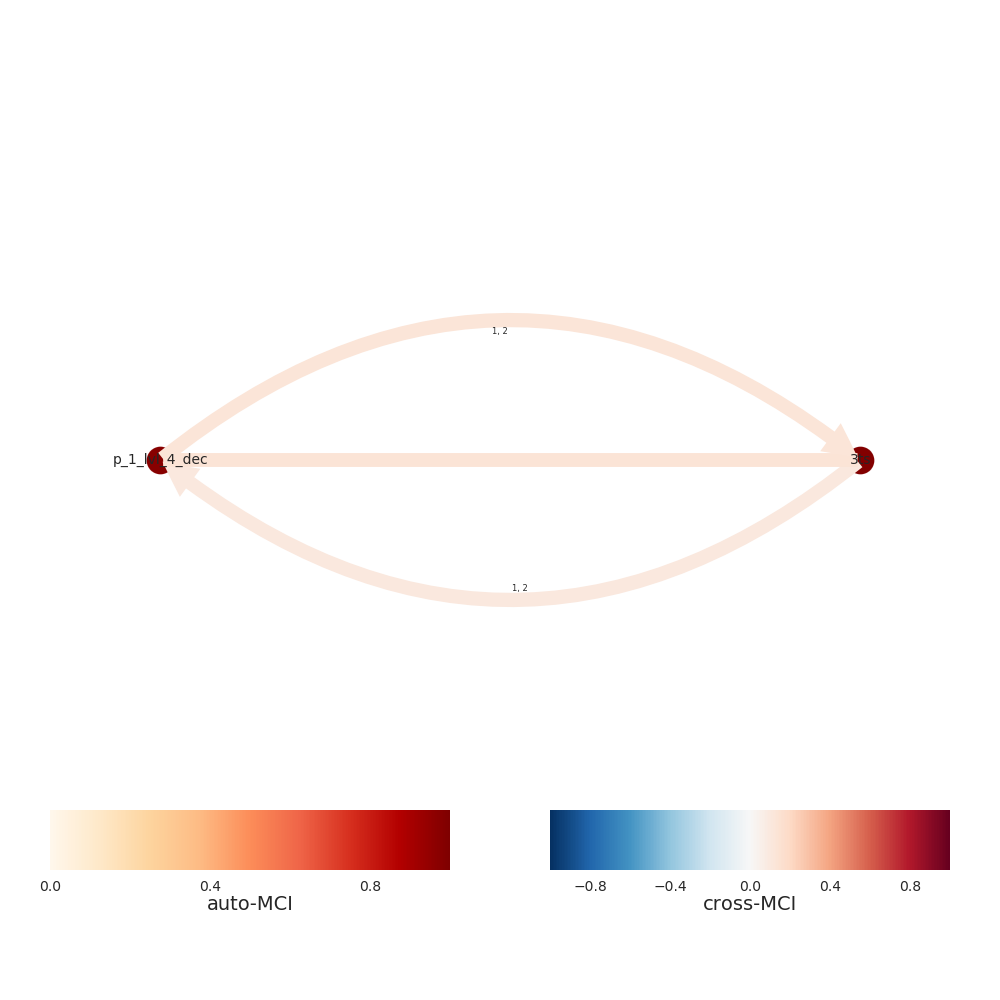

Progress causal inference - traintest set 100%
[INFO] Extracting level 8
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


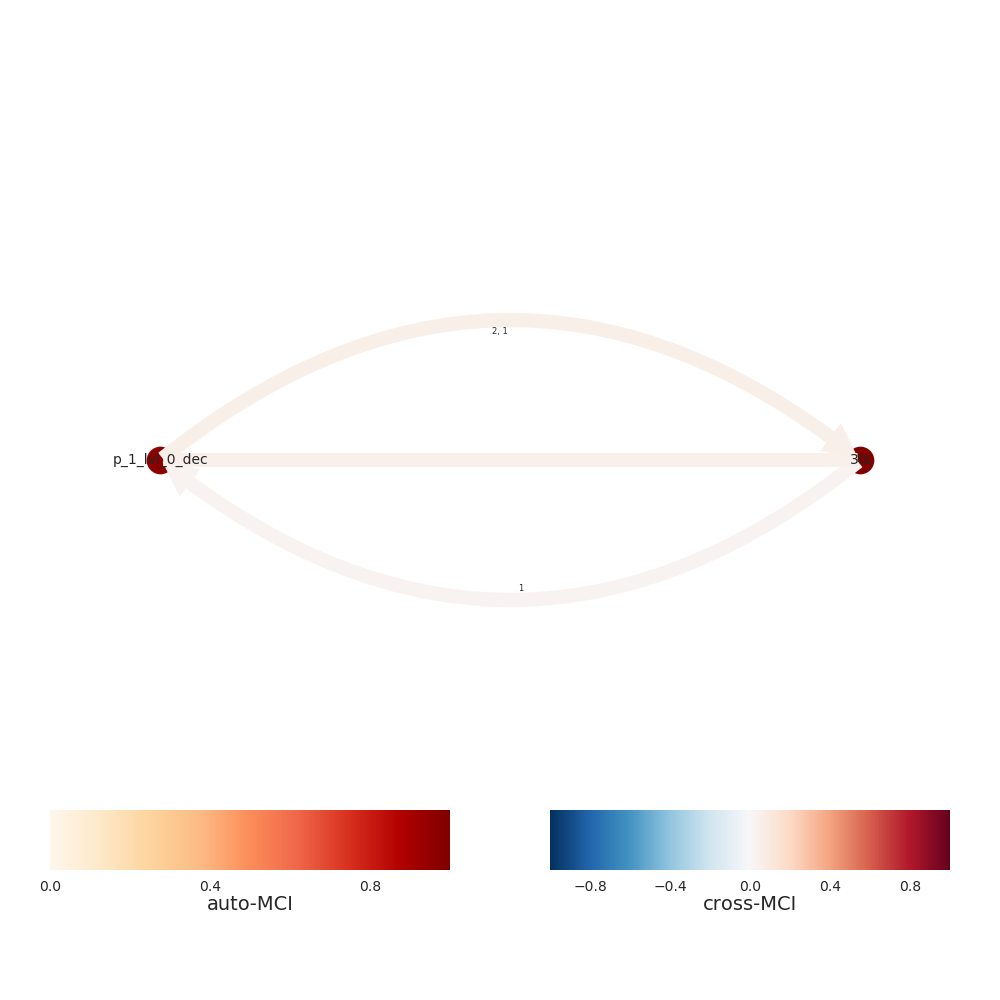

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


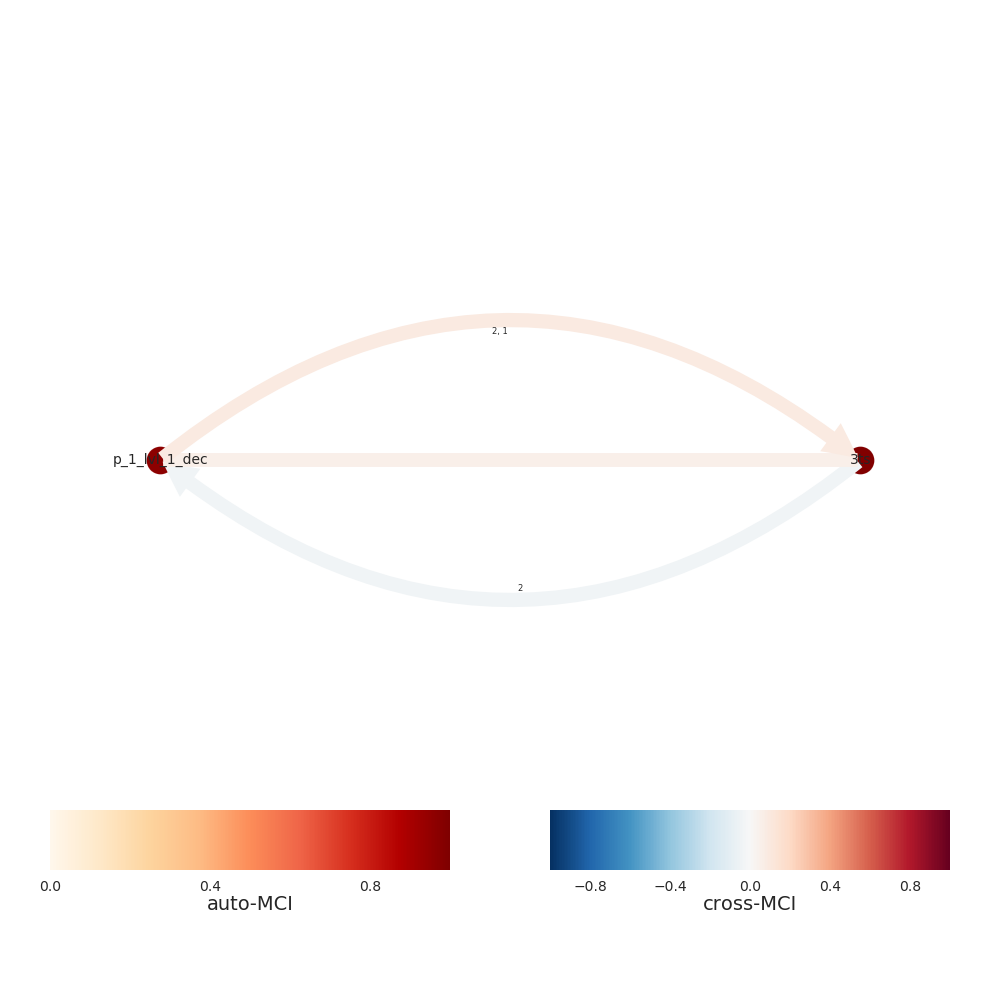

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


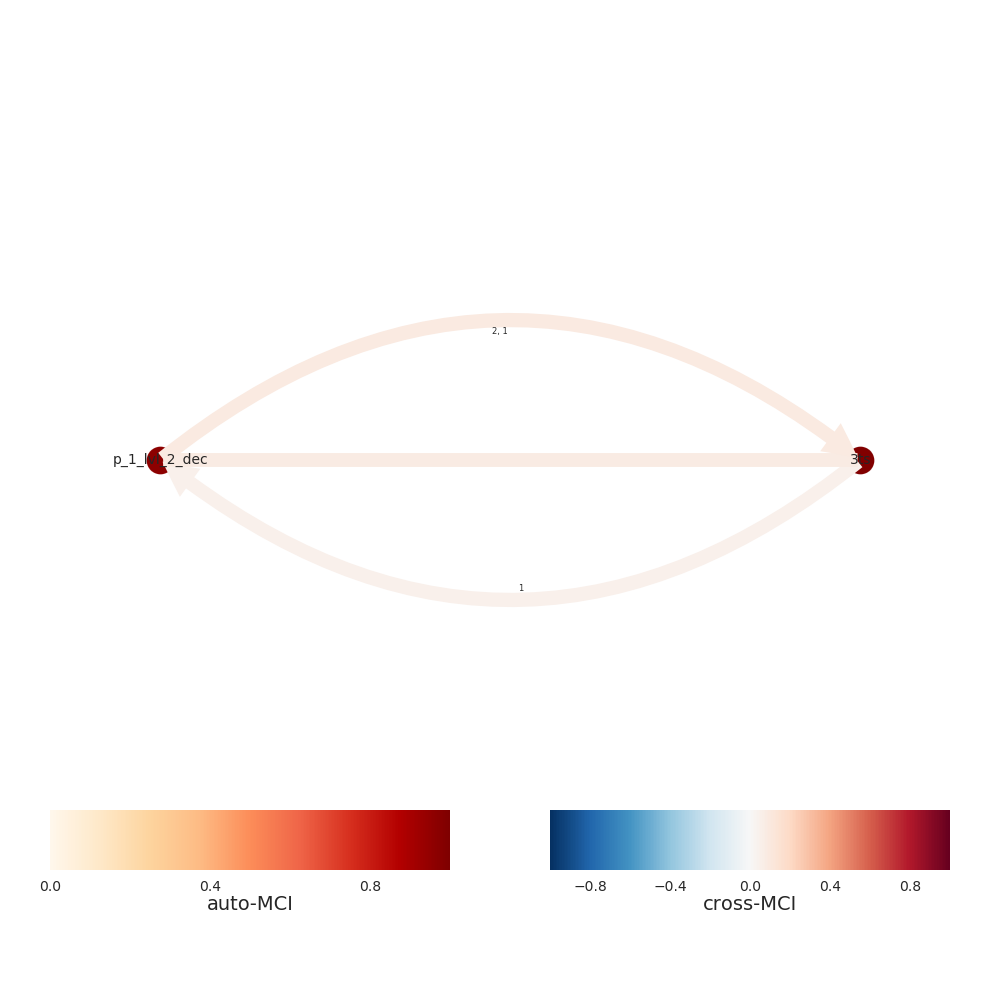

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


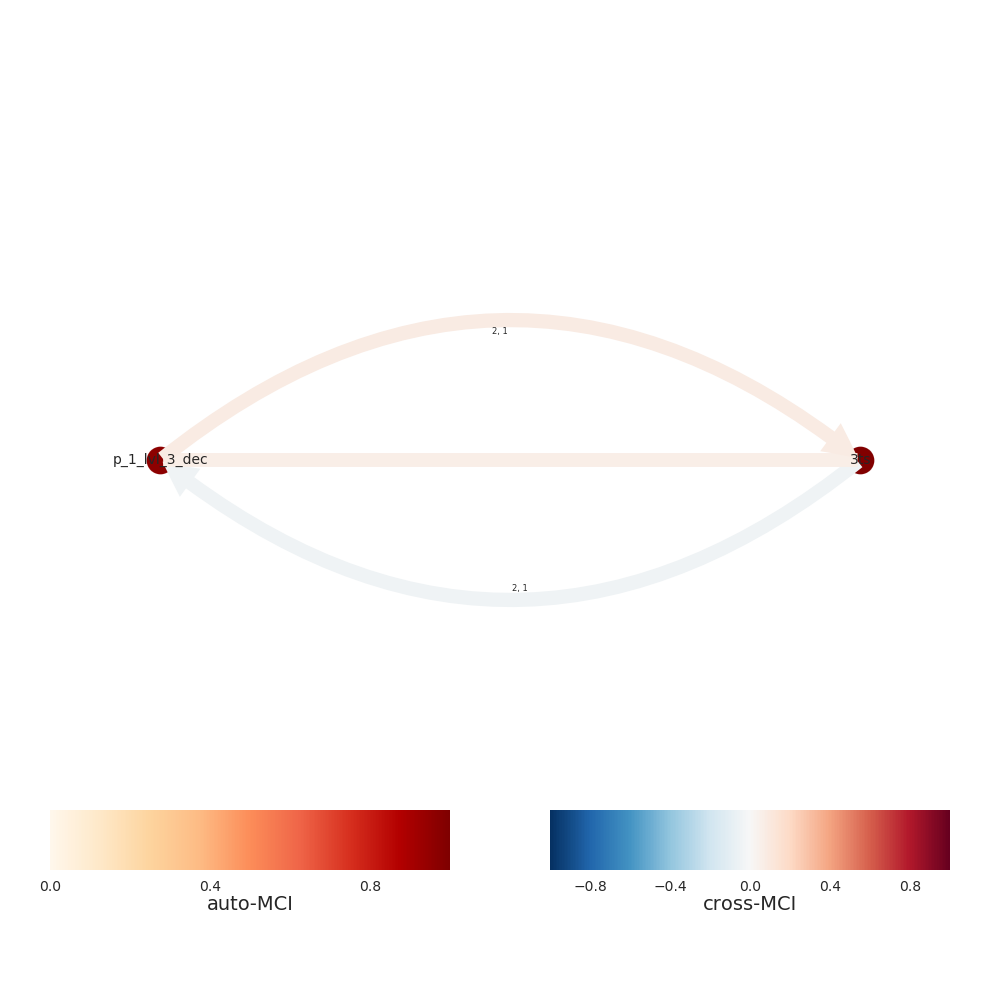

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


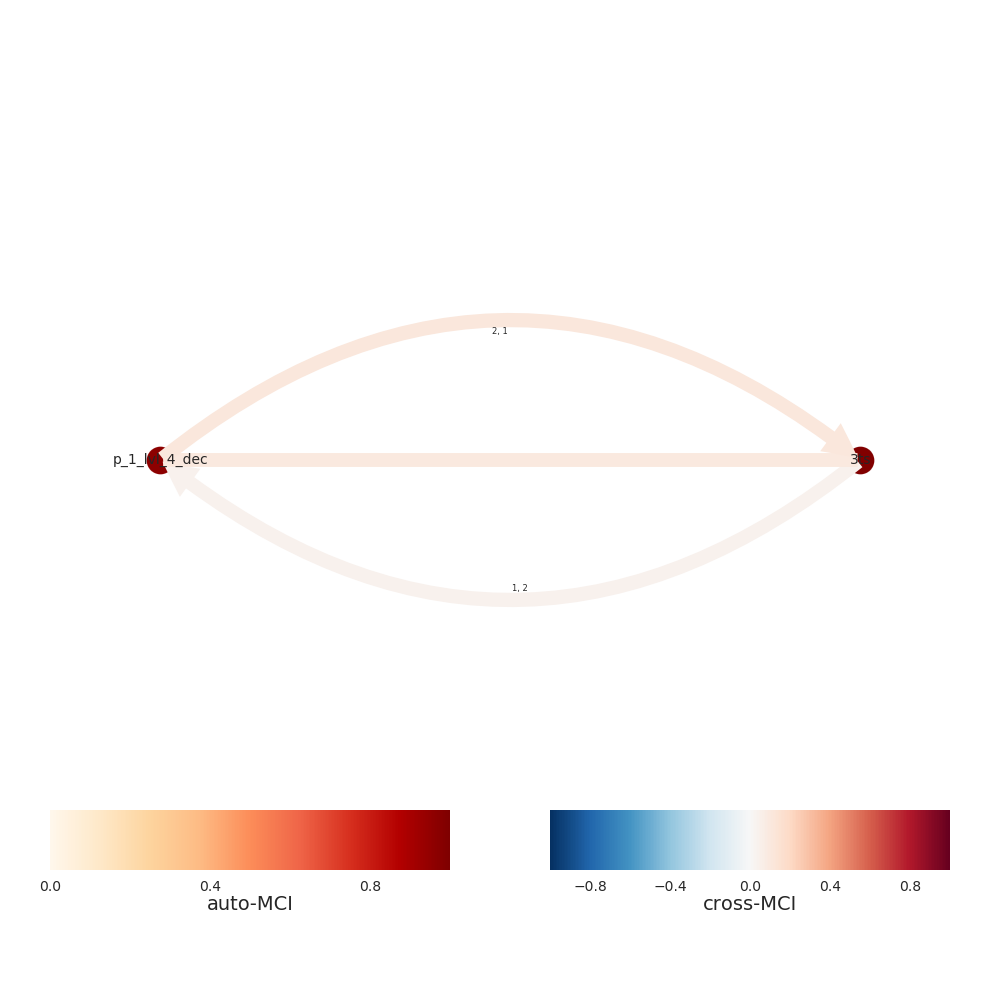

Progress causal inference - traintest set 100%
[INFO] Extracting level 9
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


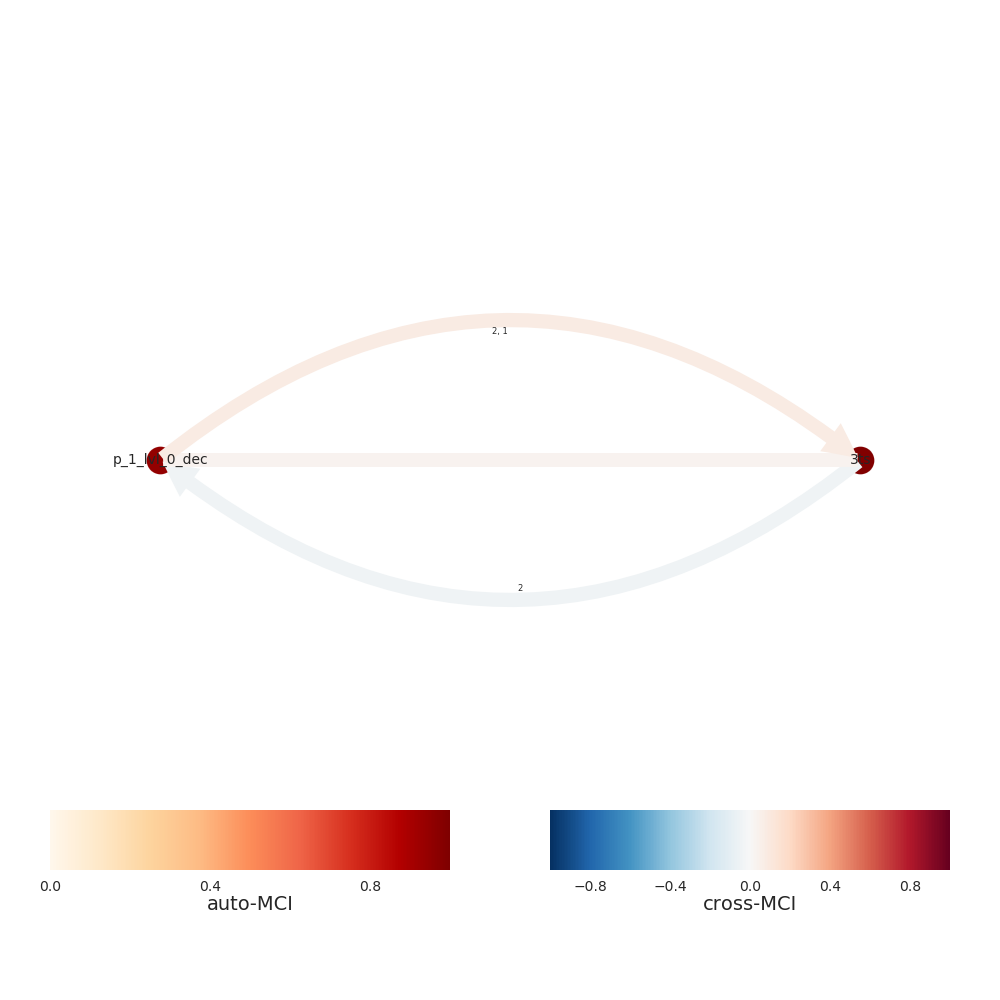

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


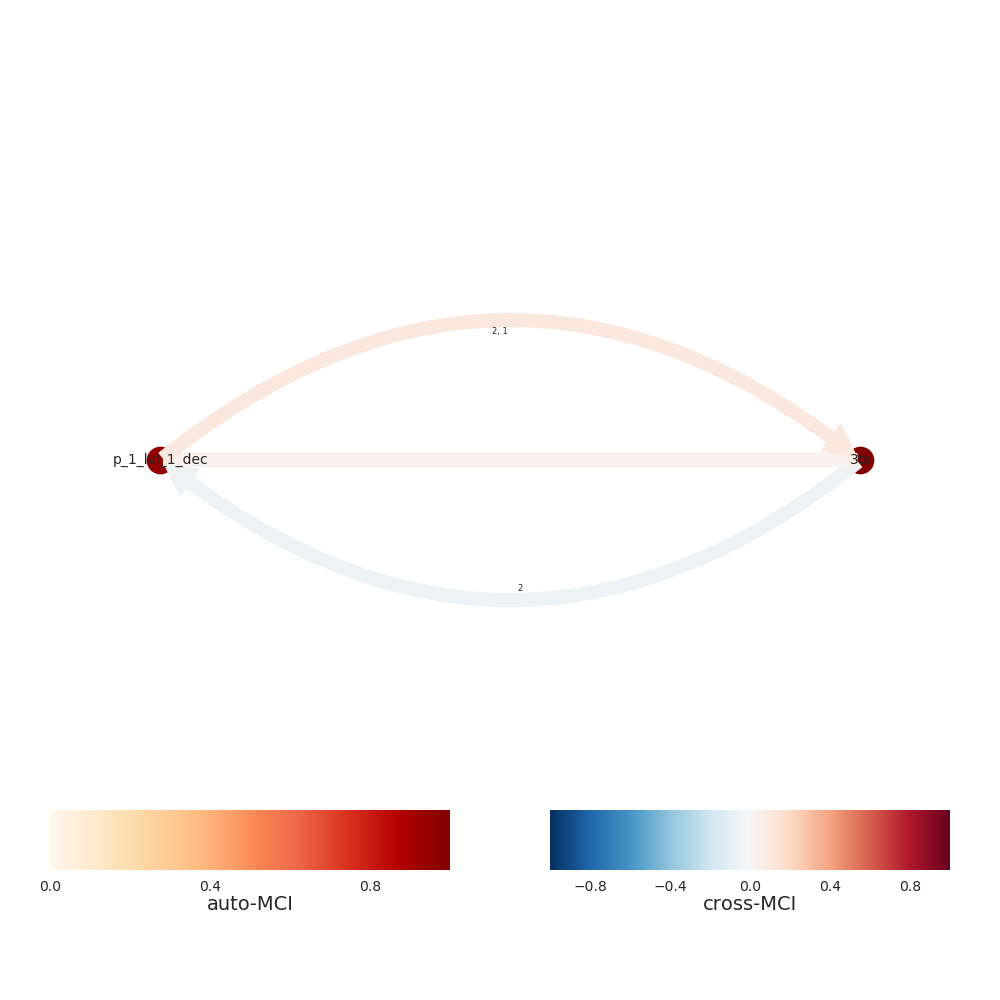

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


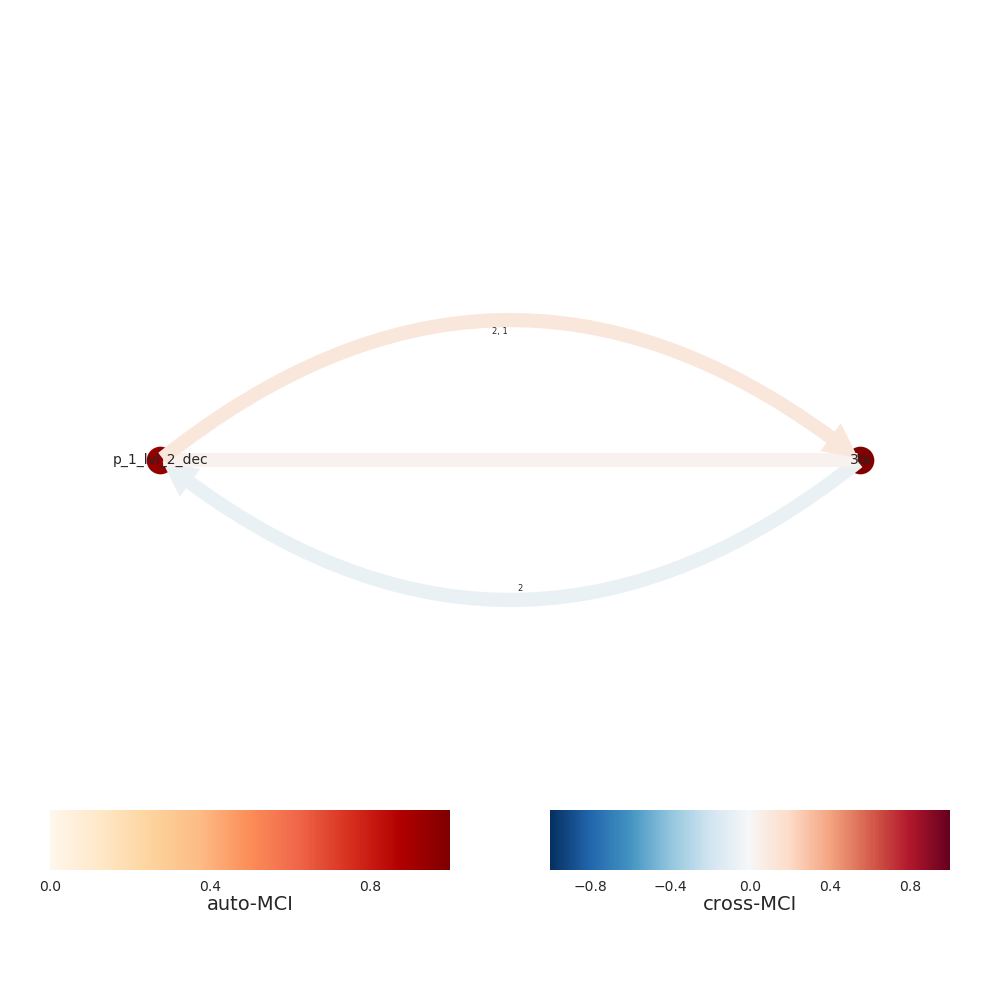

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


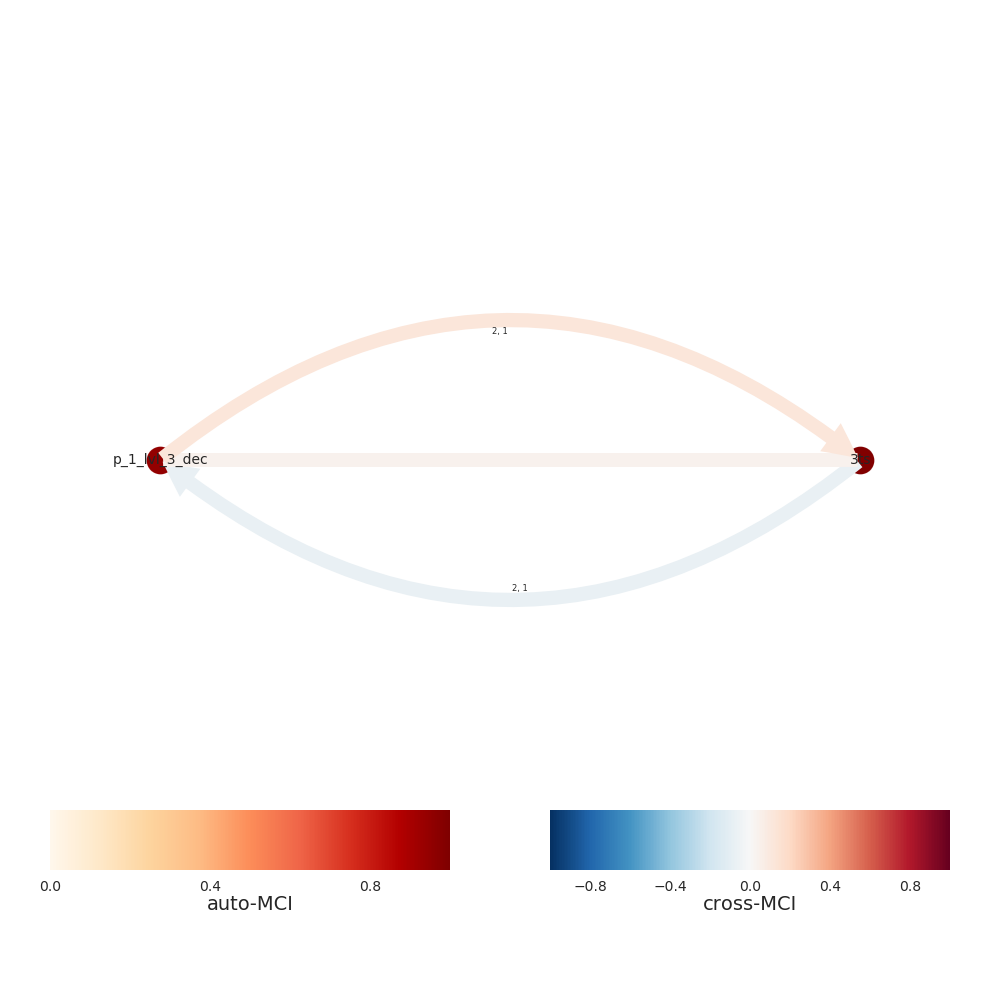

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


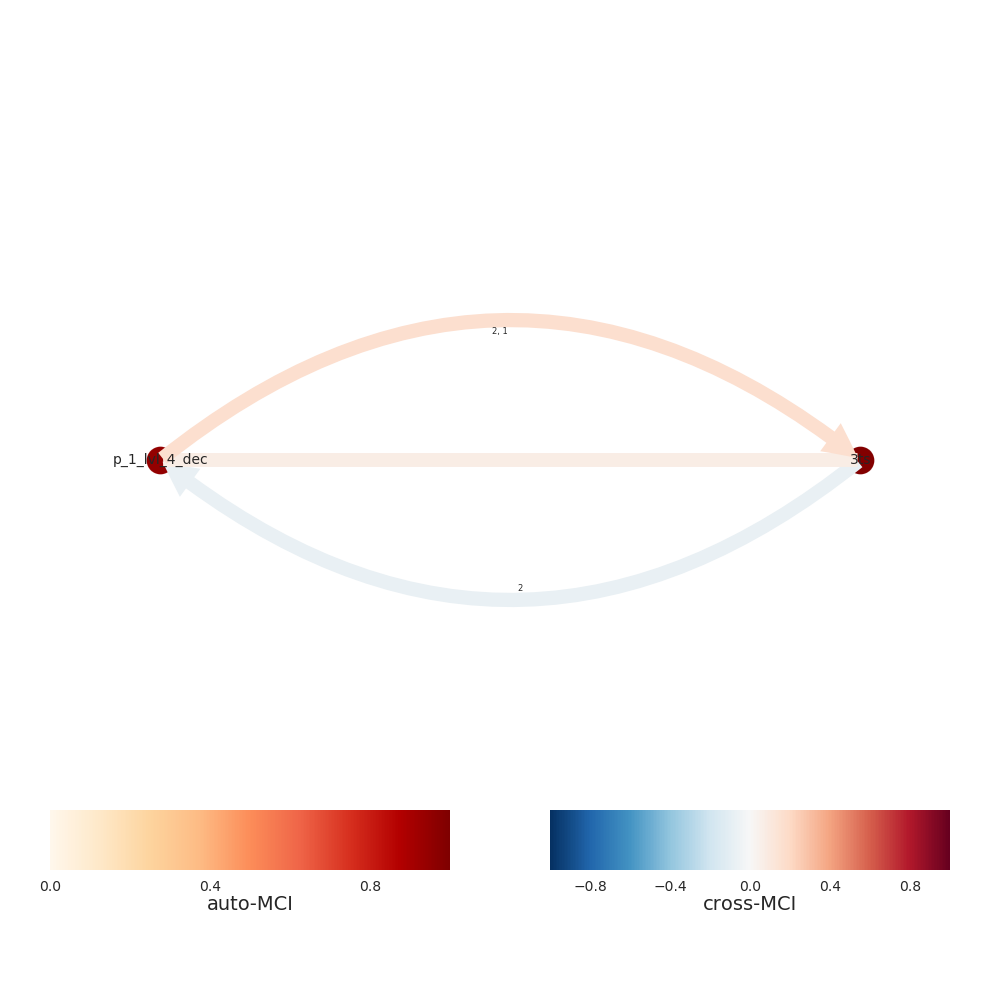

Progress causal inference - traintest set 100%
[INFO] Extracting level 10
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


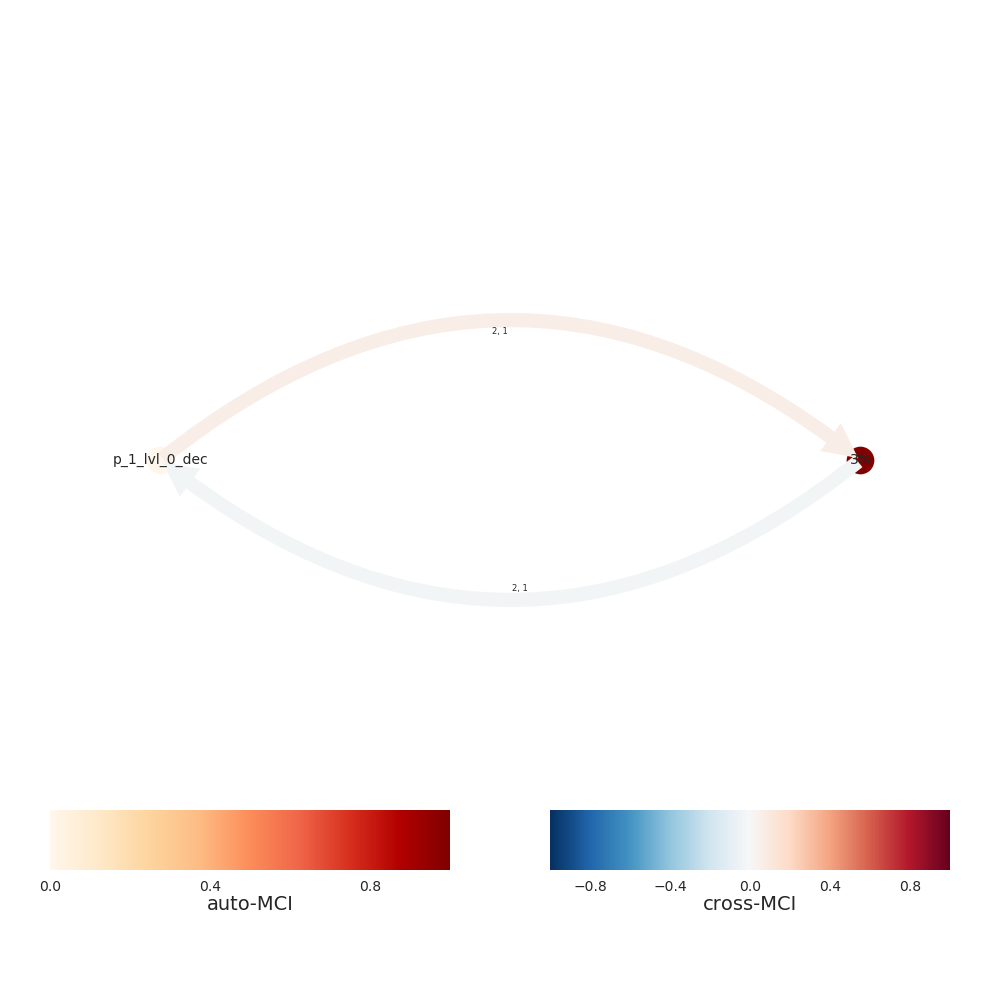

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


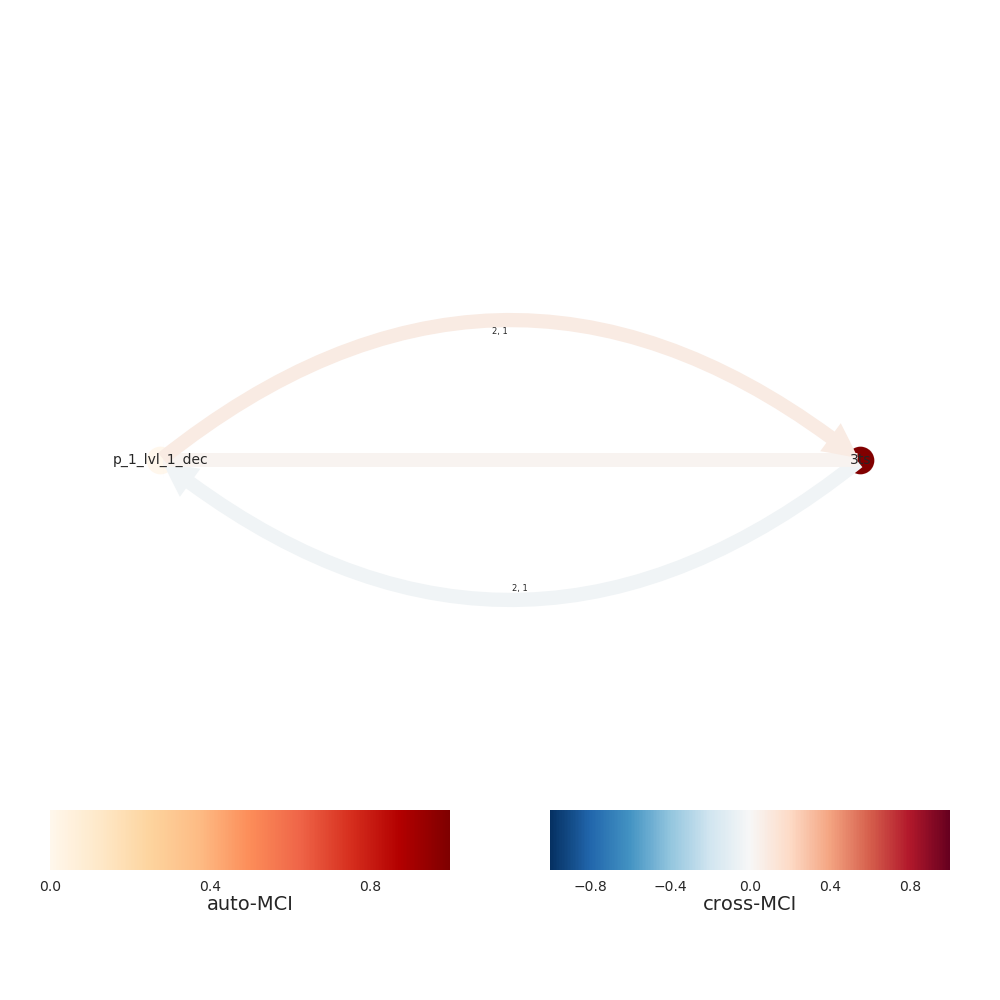

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


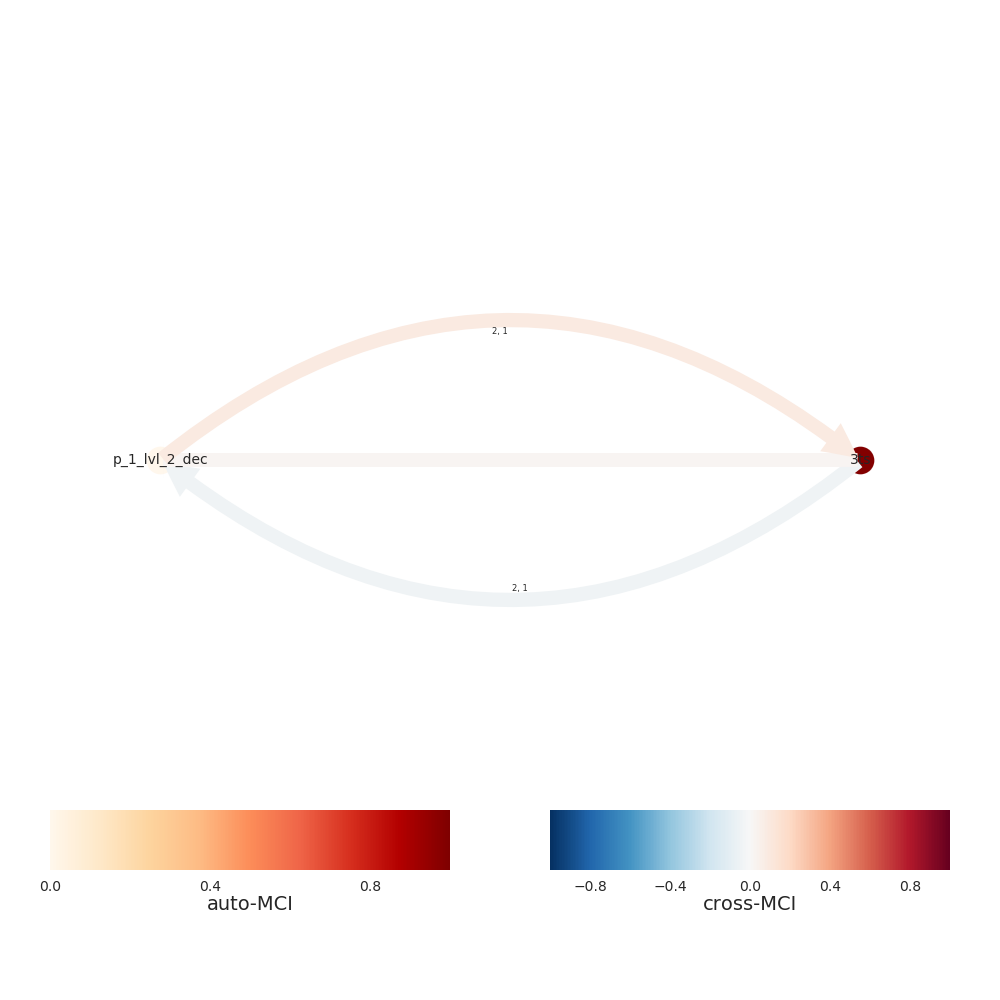

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


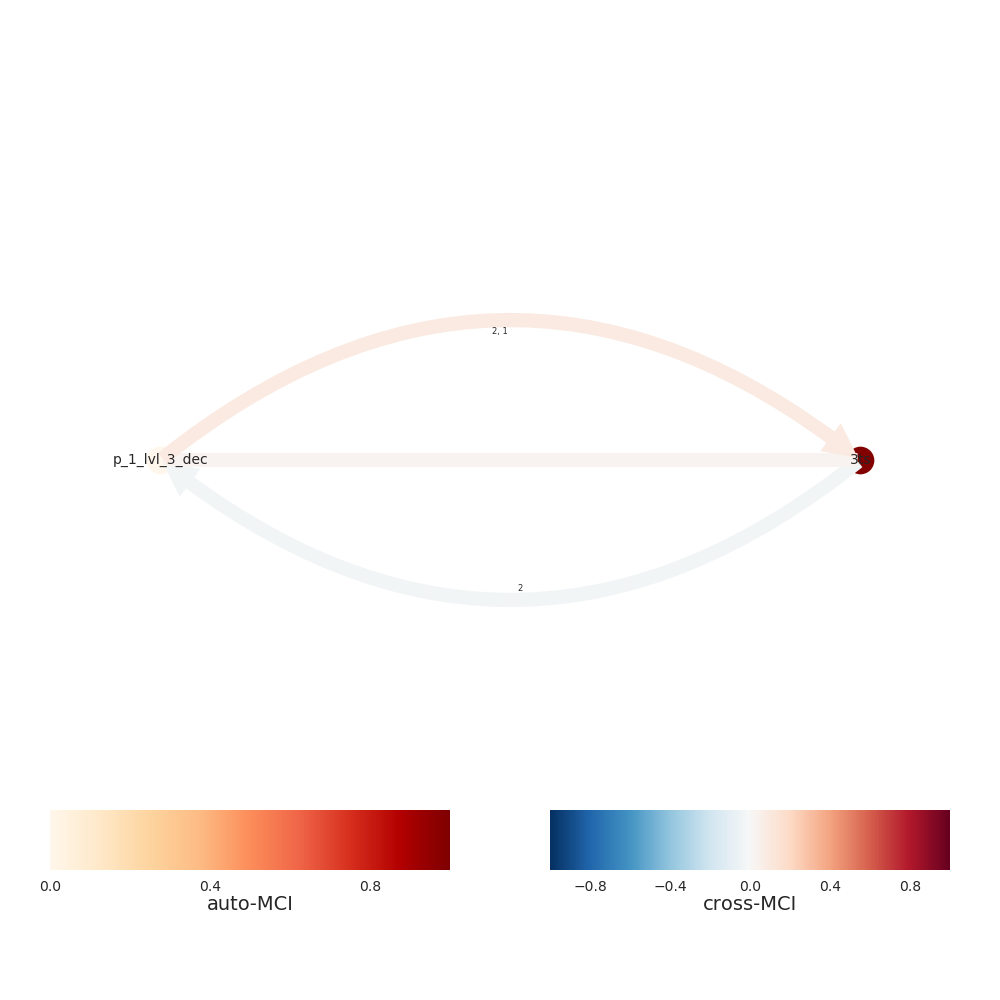

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


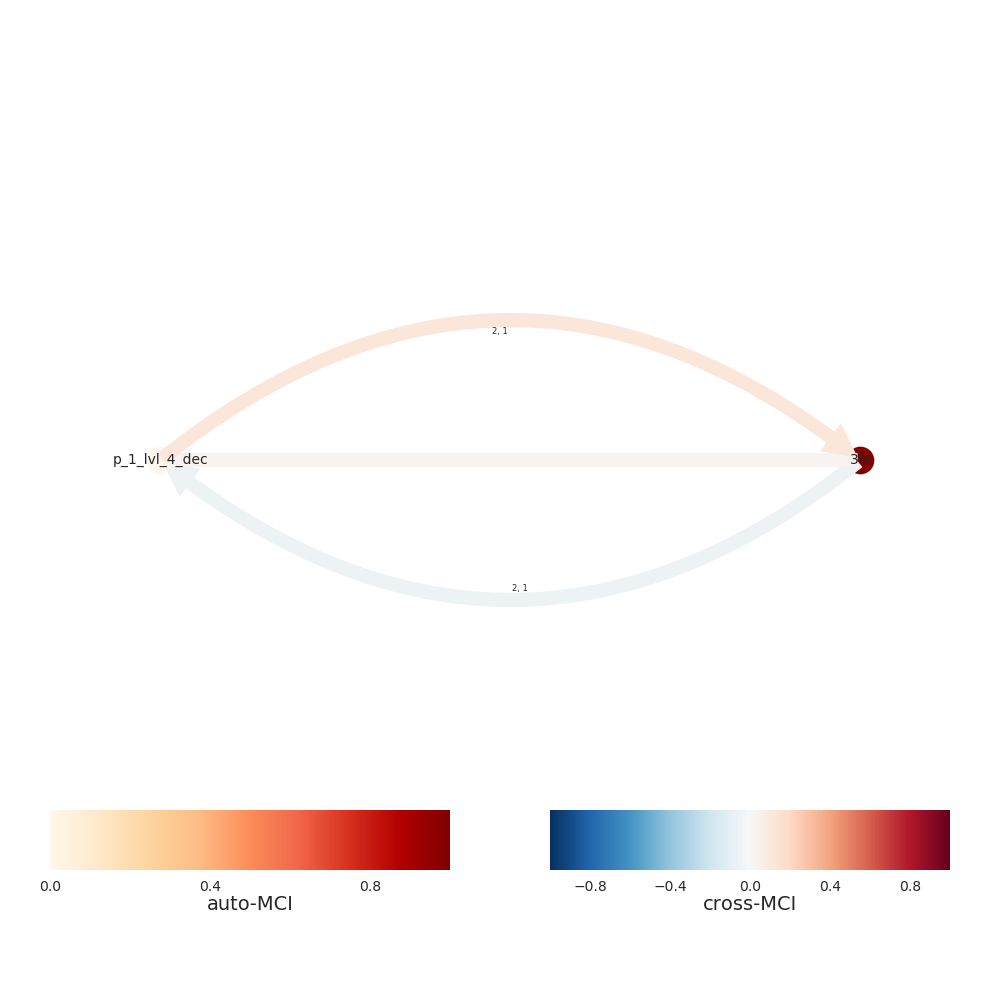

Progress causal inference - traintest set 100%
[INFO] Extracting level 11
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


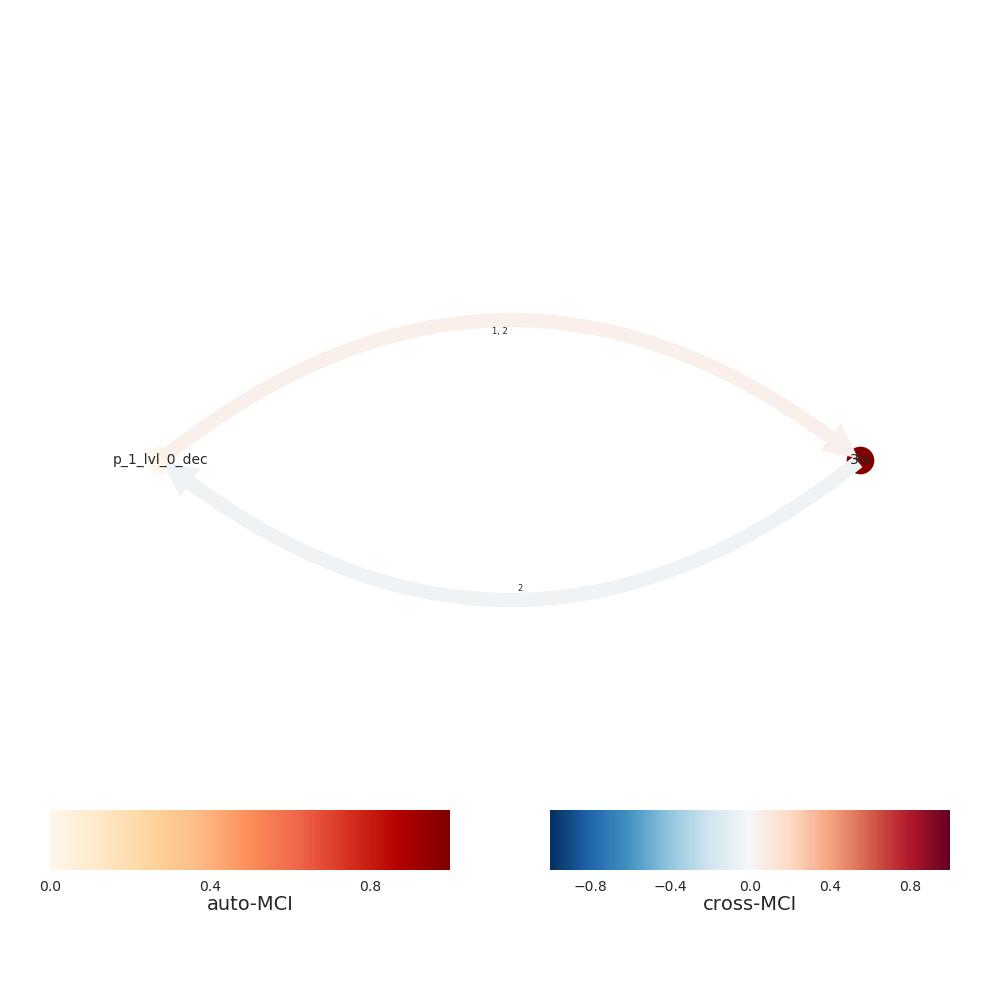

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


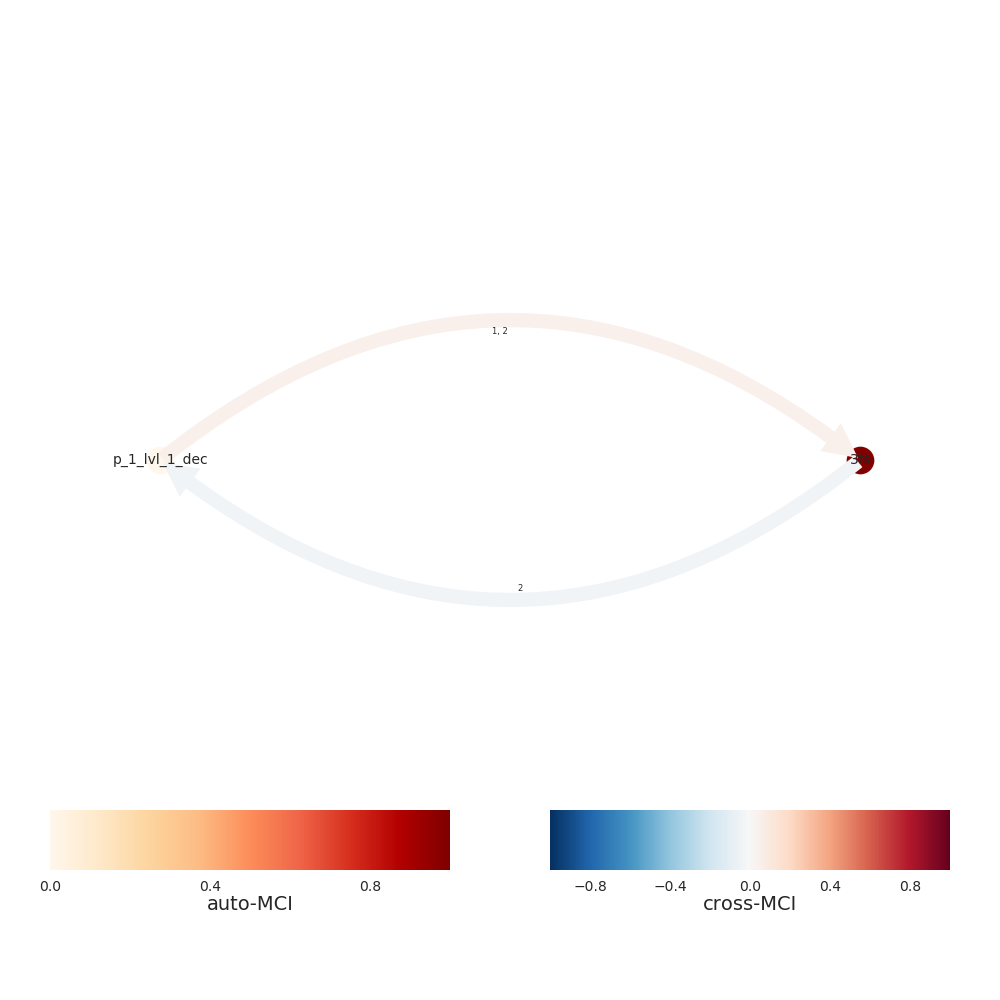

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


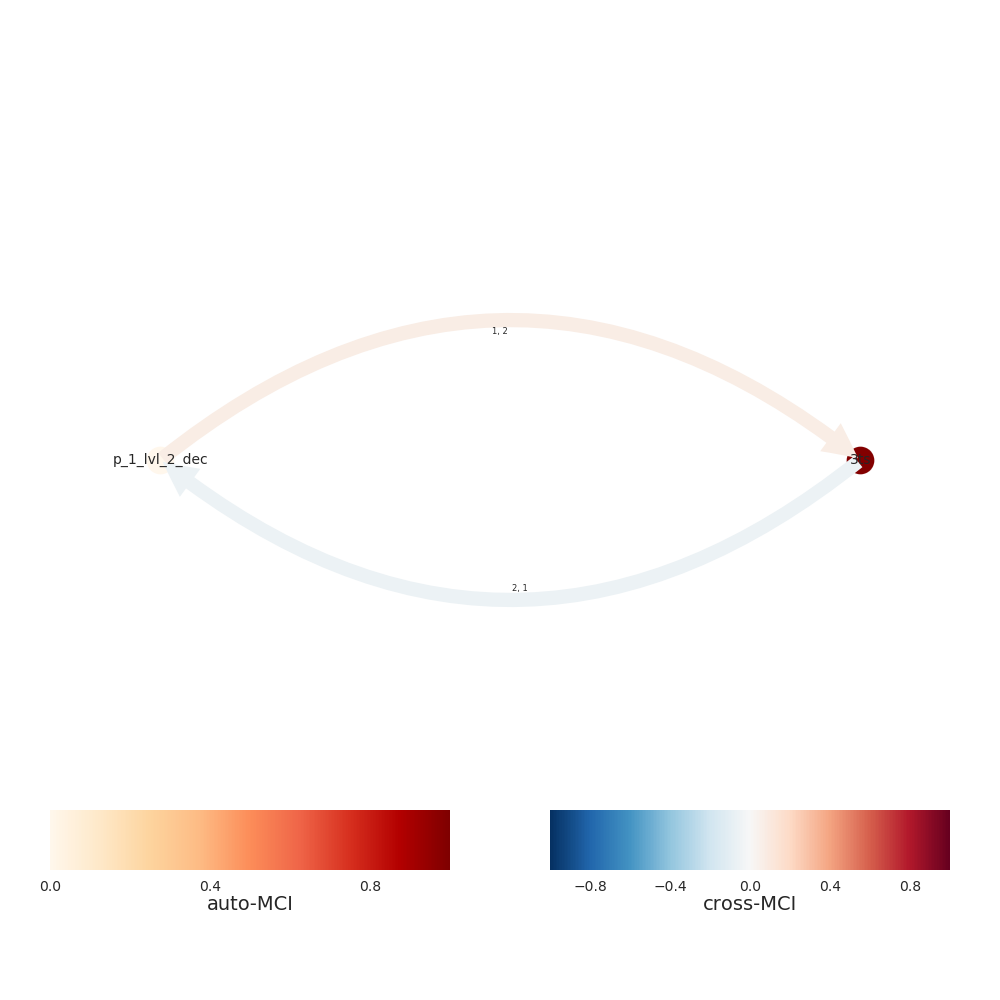

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


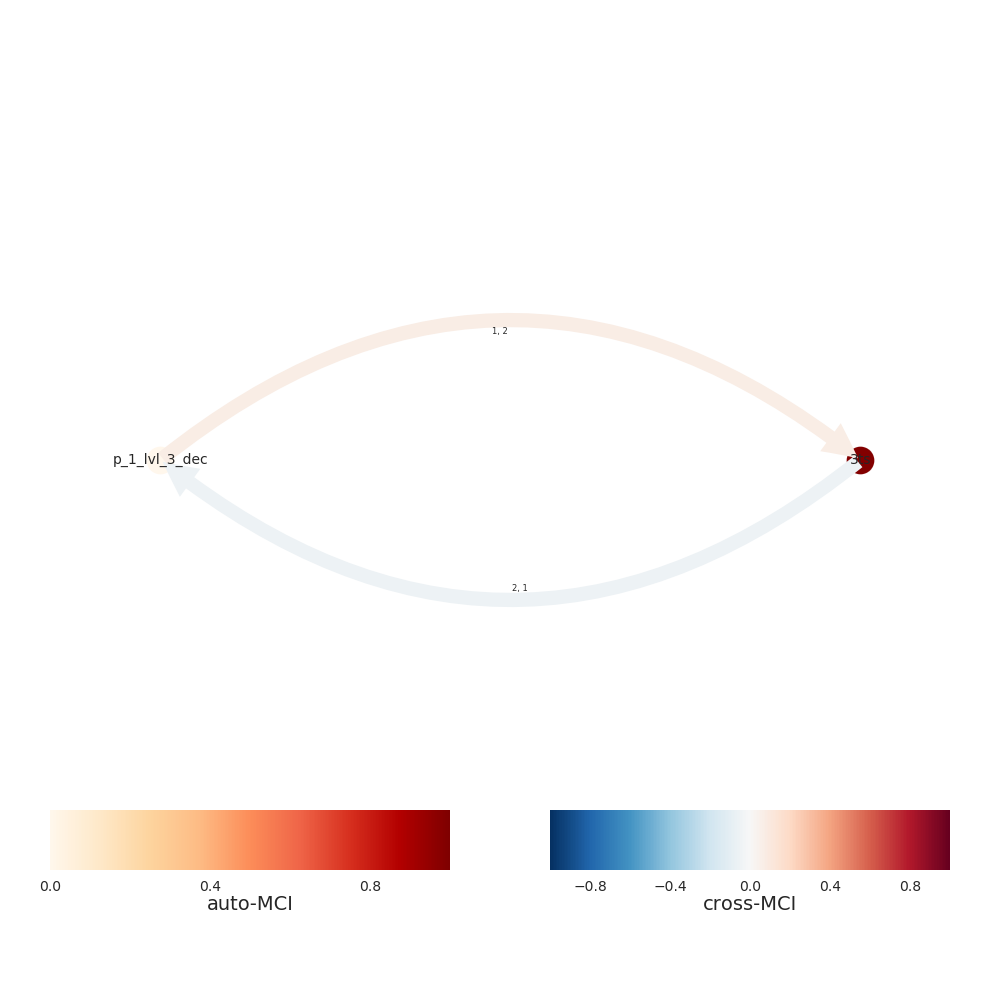

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


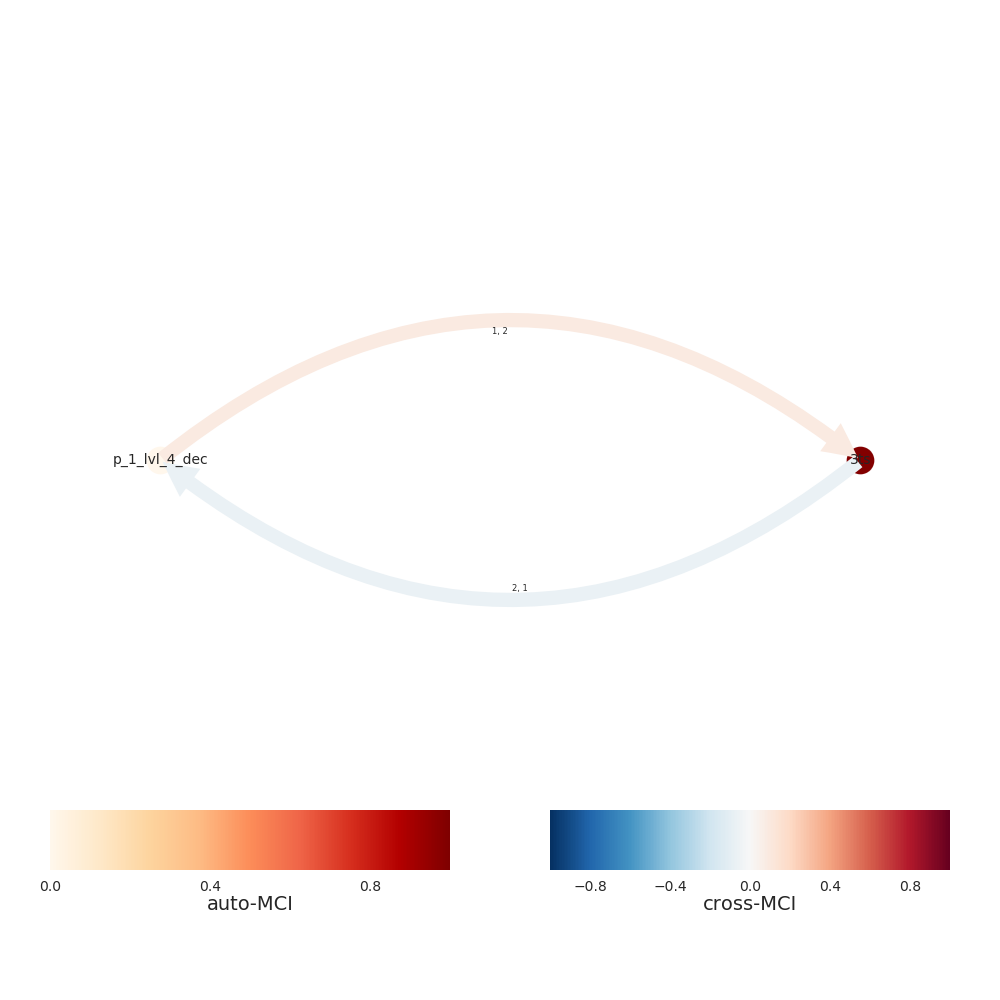

Progress causal inference - traintest set 100%

In [72]:
result_def = run_experiment_levels_default_lag(prepro_target, target_arr,rg, rg_index, peak_test=True,total_levels=levels)

In [67]:
mc_def, _ = result_def

<IPython.core.display.Javascript object>


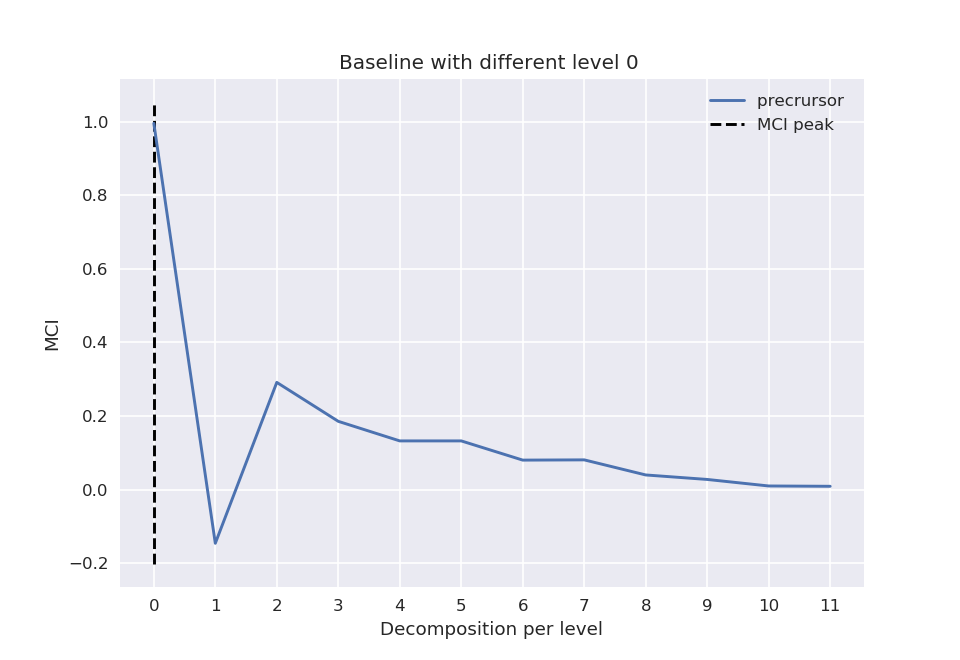

<IPython.core.display.Javascript object>


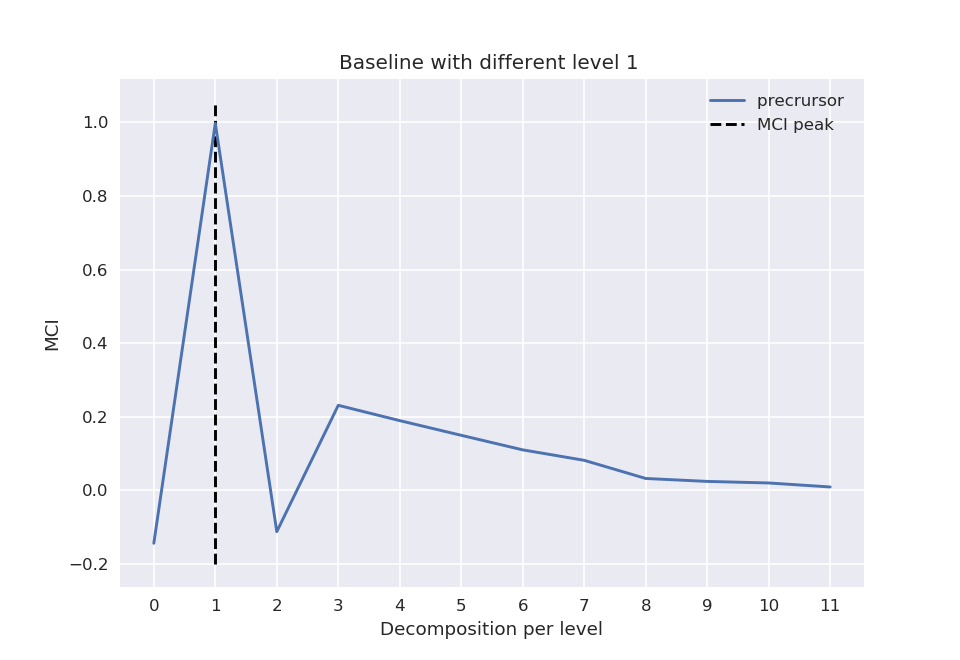

<IPython.core.display.Javascript object>


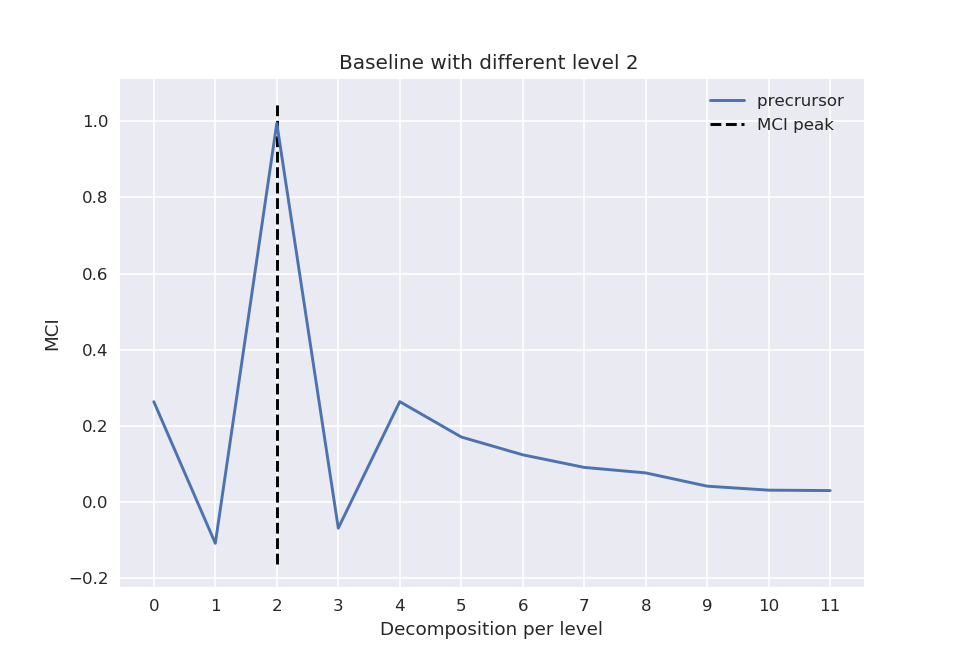

<IPython.core.display.Javascript object>


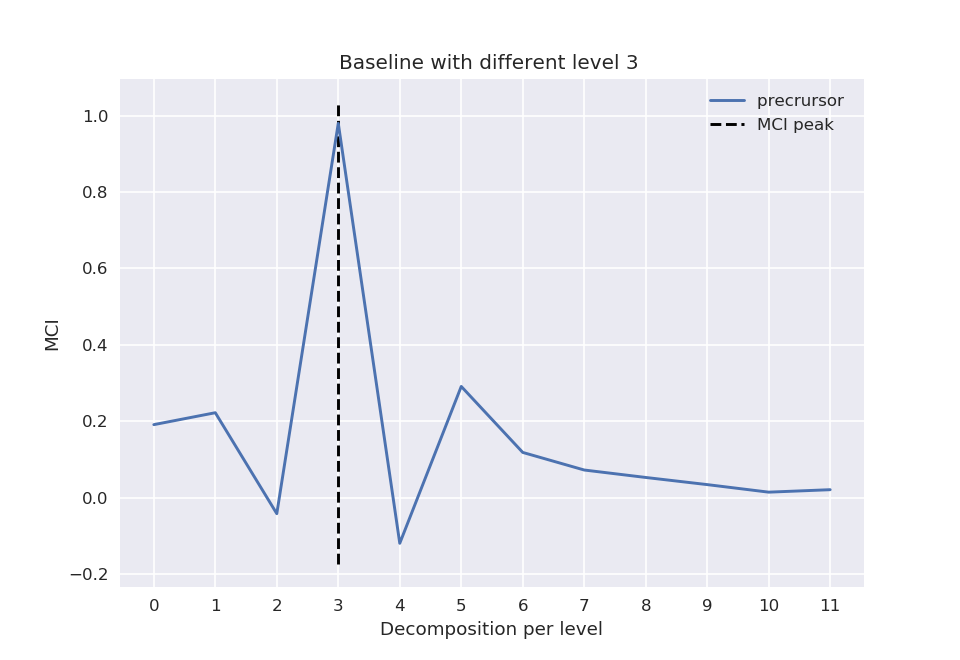

<IPython.core.display.Javascript object>


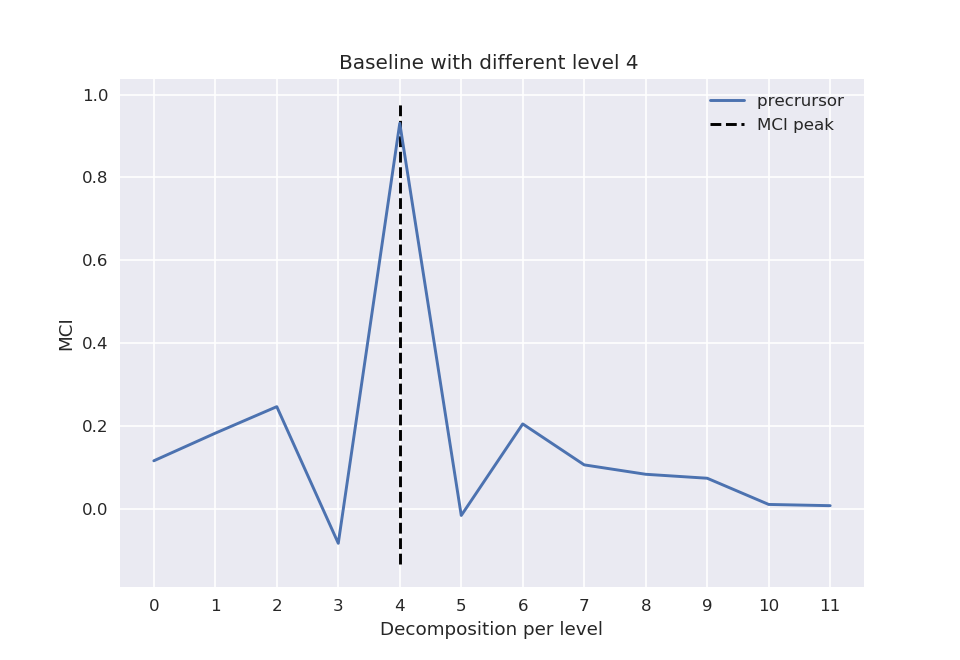

<IPython.core.display.Javascript object>


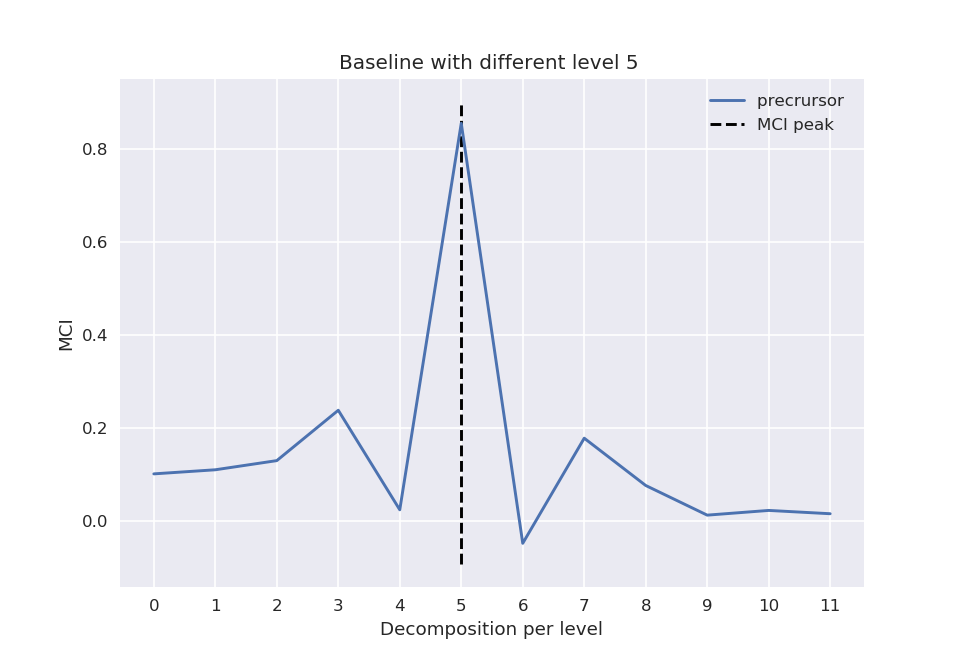

<IPython.core.display.Javascript object>


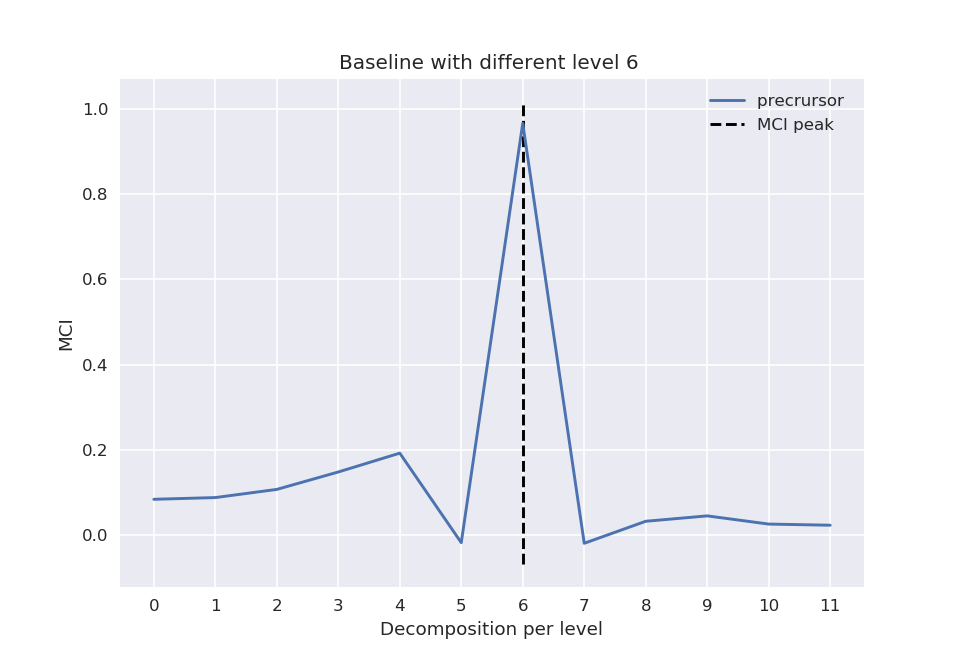

<IPython.core.display.Javascript object>


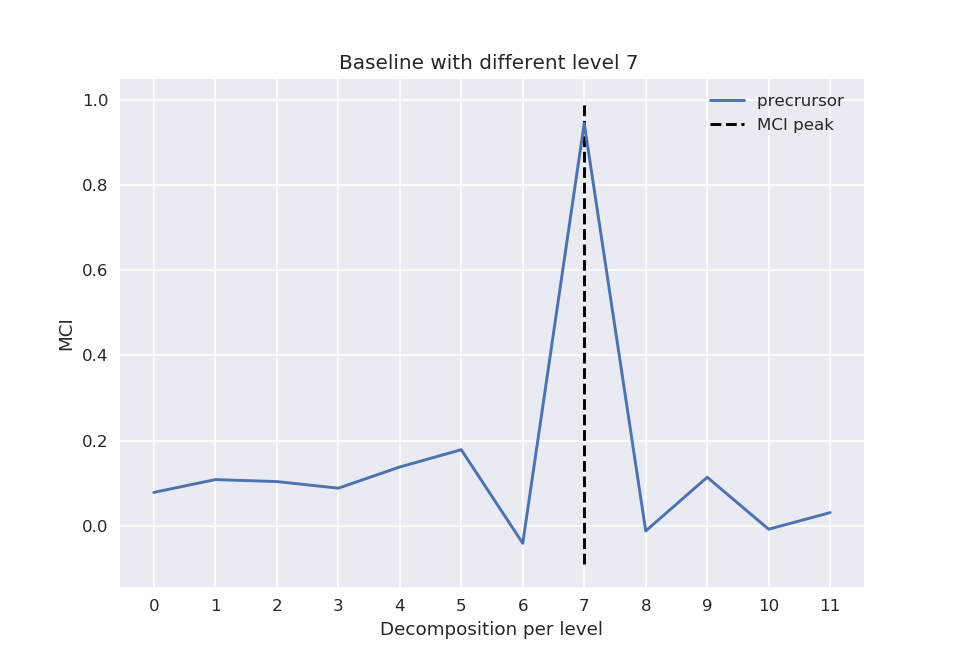

<IPython.core.display.Javascript object>


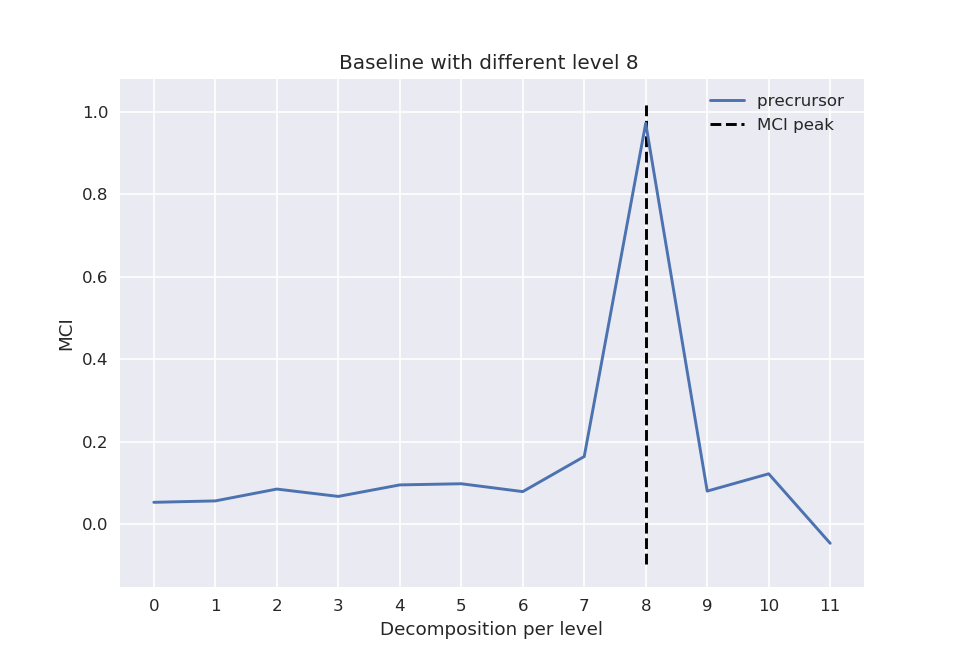

<IPython.core.display.Javascript object>


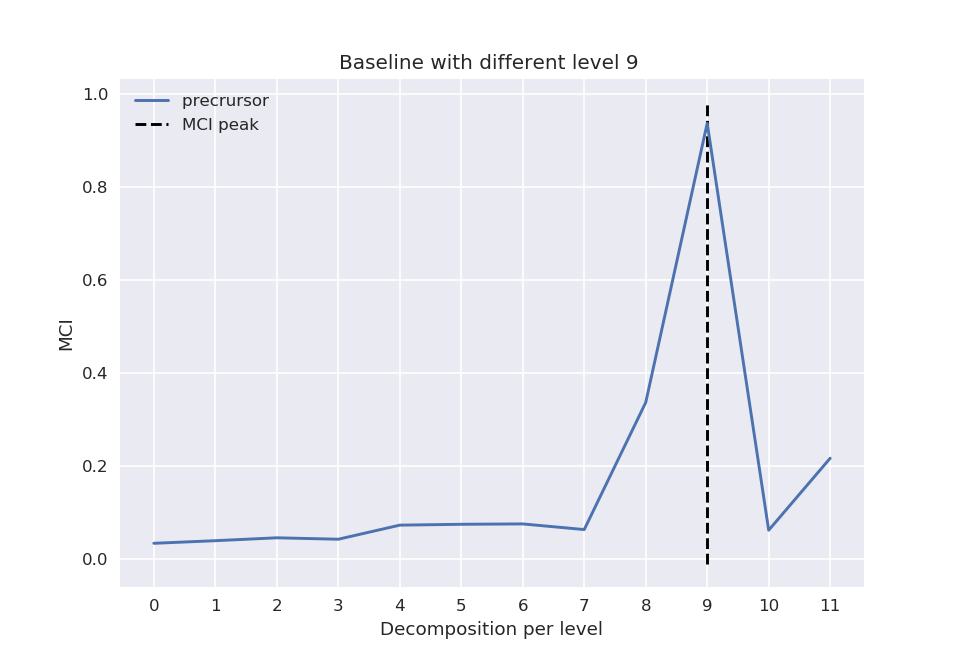

<IPython.core.display.Javascript object>


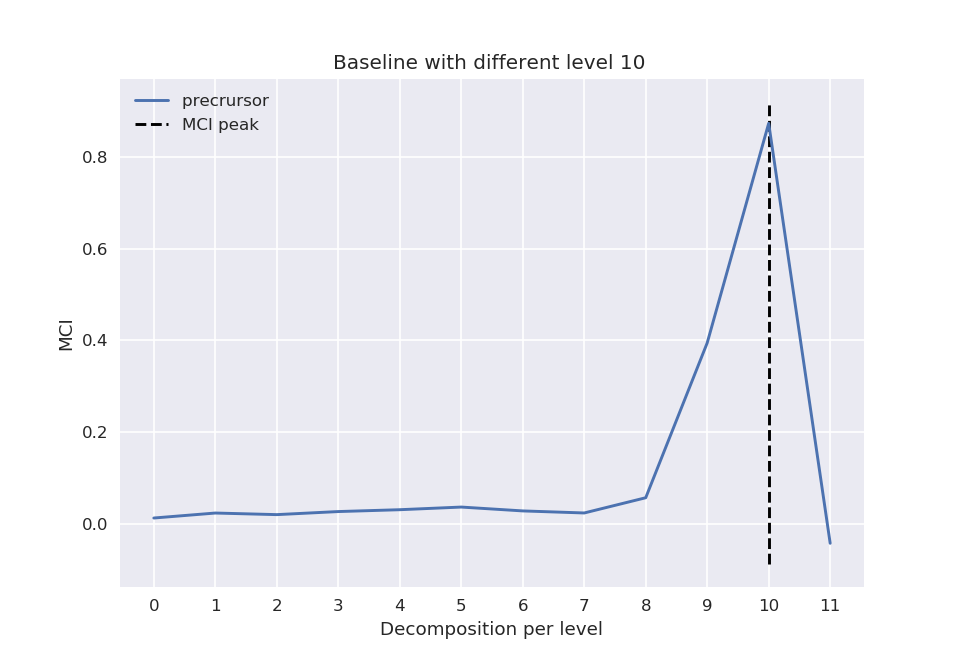

<IPython.core.display.Javascript object>


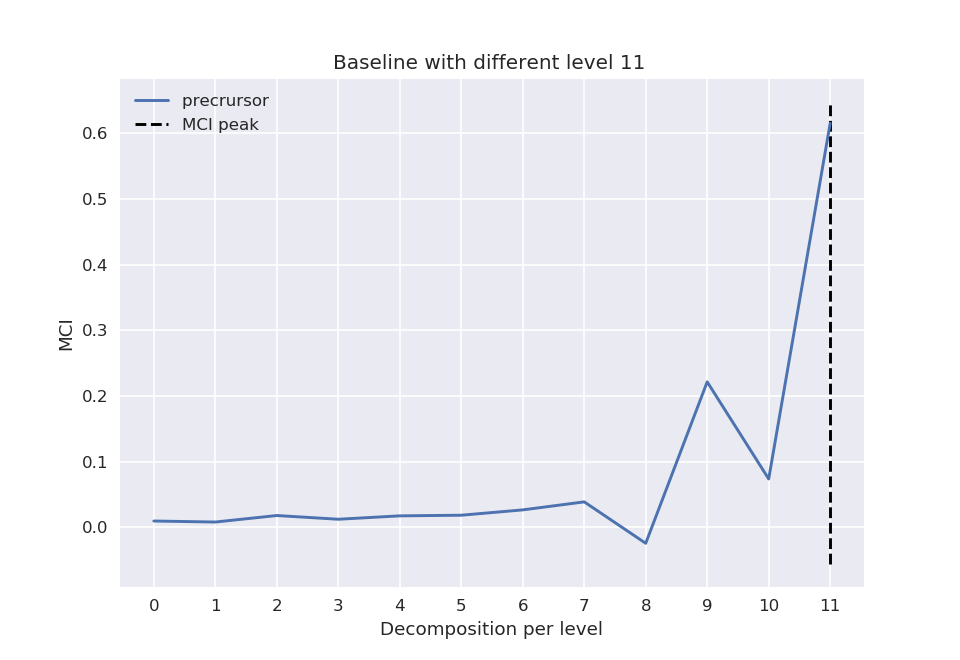

In [73]:
for i, peak in enumerate(mc_def):
    if abs(len(mc_def) - len(peak)) == 1:
        plot_mci_pred_relation(cA=range(len(mc_def)-1), prec_lag=peak, path=' ', title=f'Baseline with different level {str(levels[i])} ', show_level=True, savefig=False)
    else:
        plot_mci_pred_relation(cA=range(len(mc_def)), prec_lag=peak, path=' ', title=f'Baseline with different level {str(levels[i])} ', show_level=True, savefig=False)

### Run experiment with wavelet decomposition on yprime incorporate lags as an extra column


[INFO] Extracting level 0
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


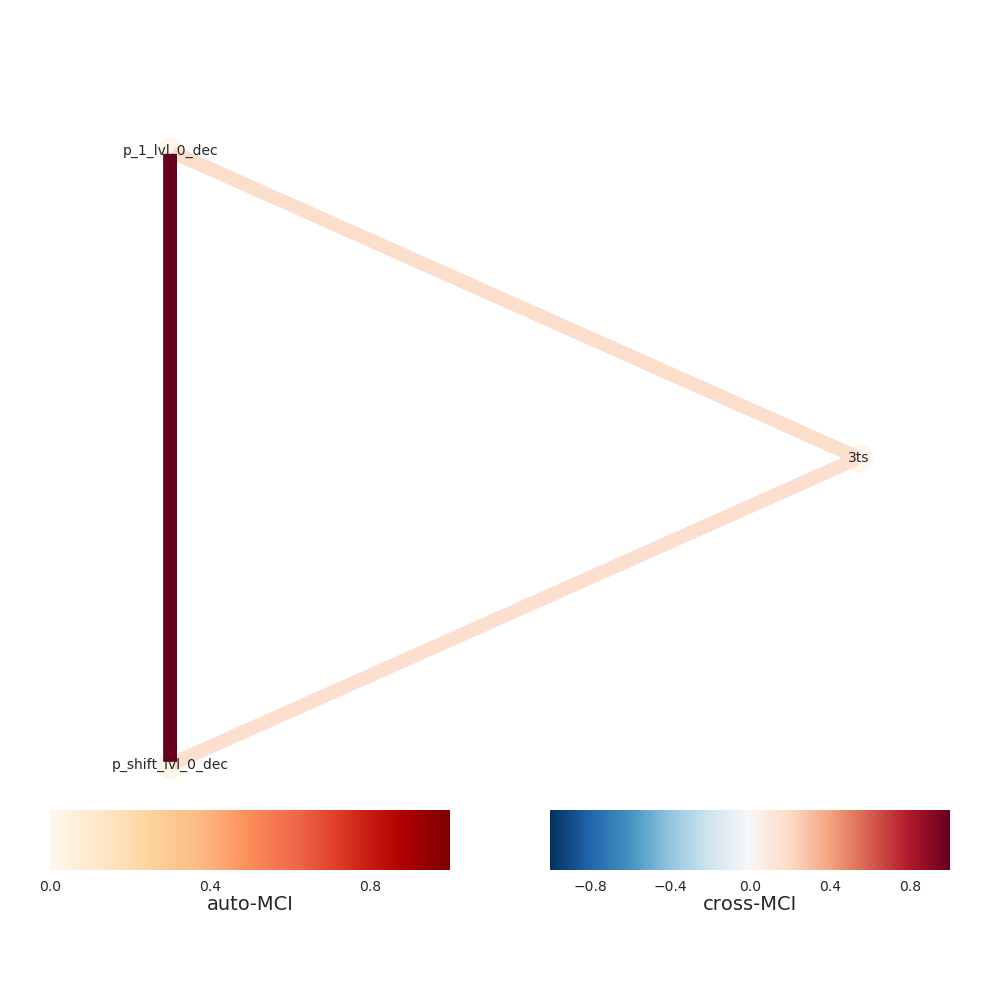

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


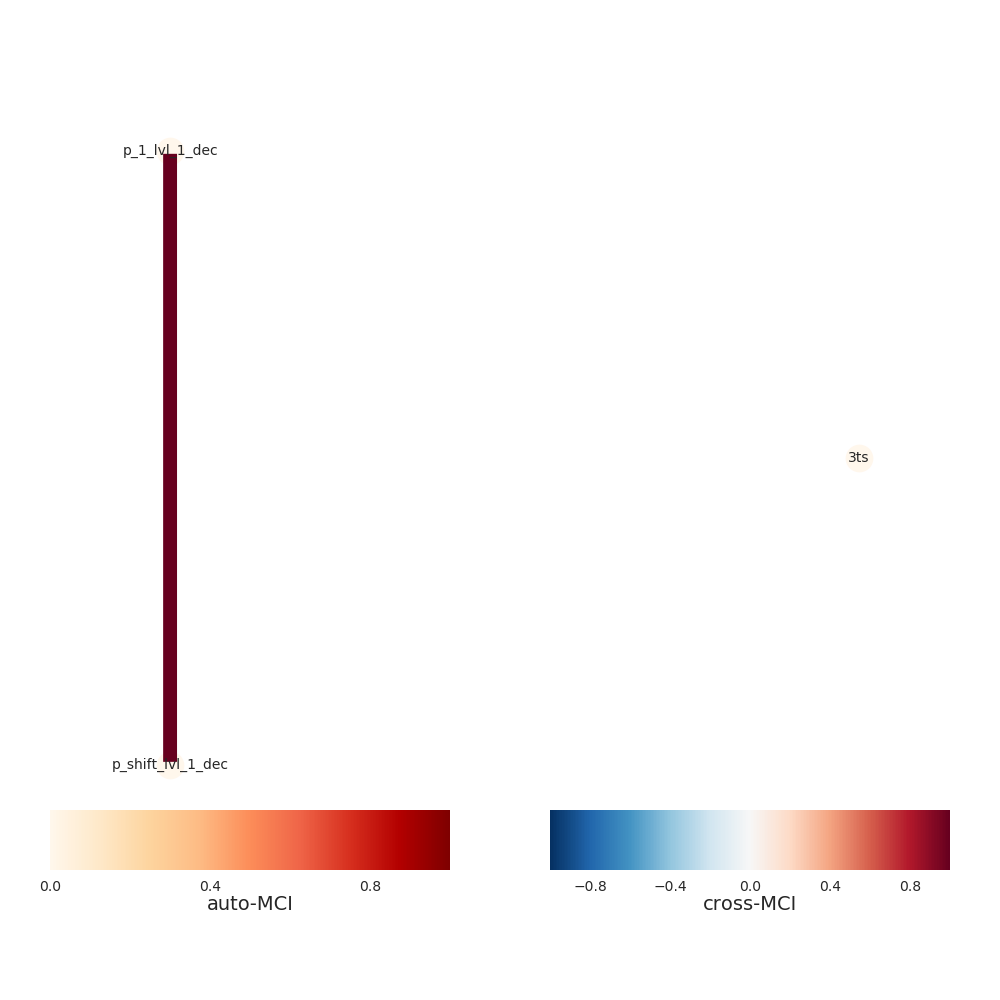

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


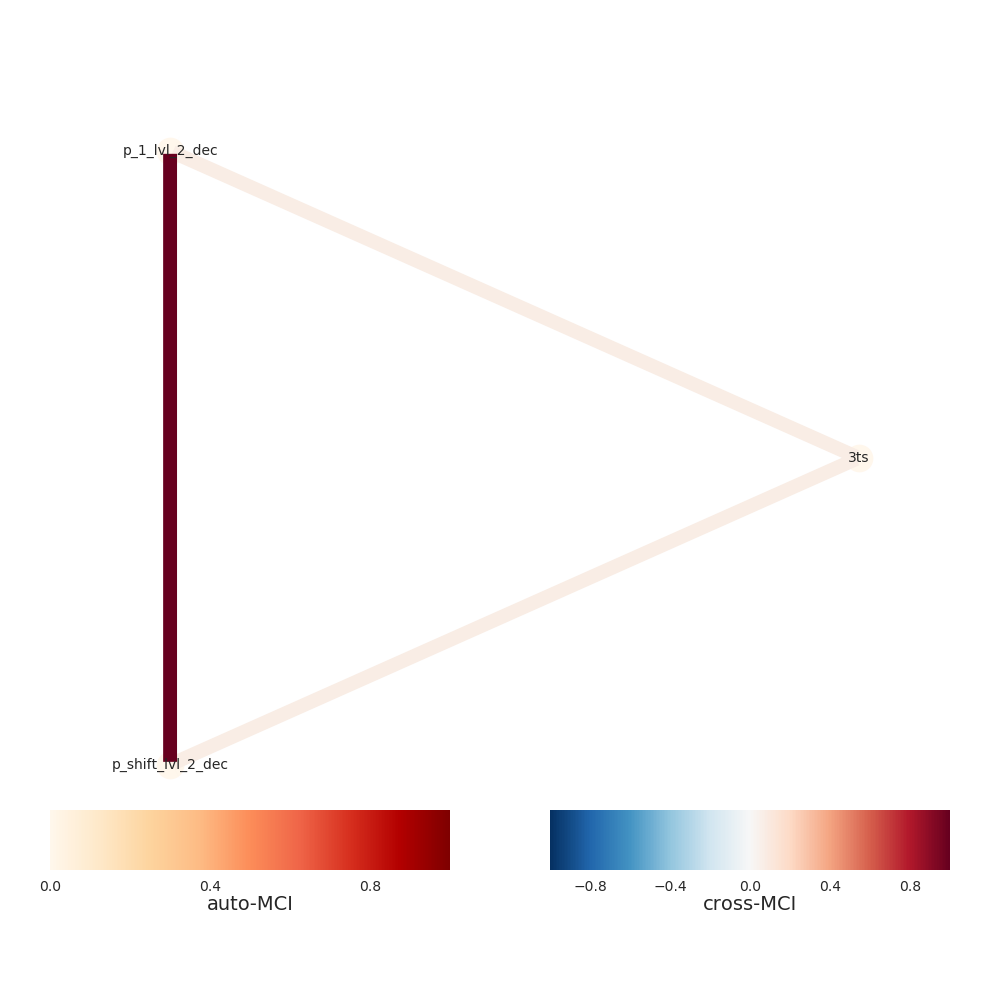

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


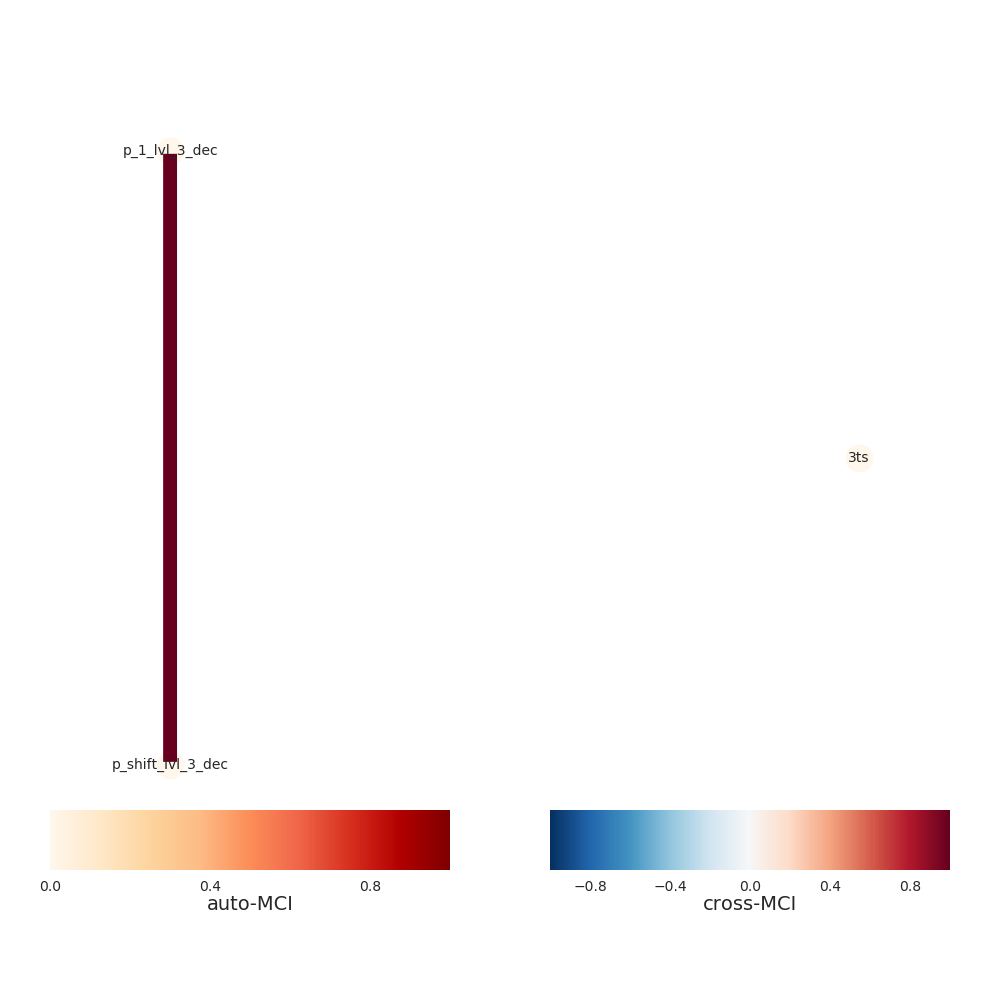

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


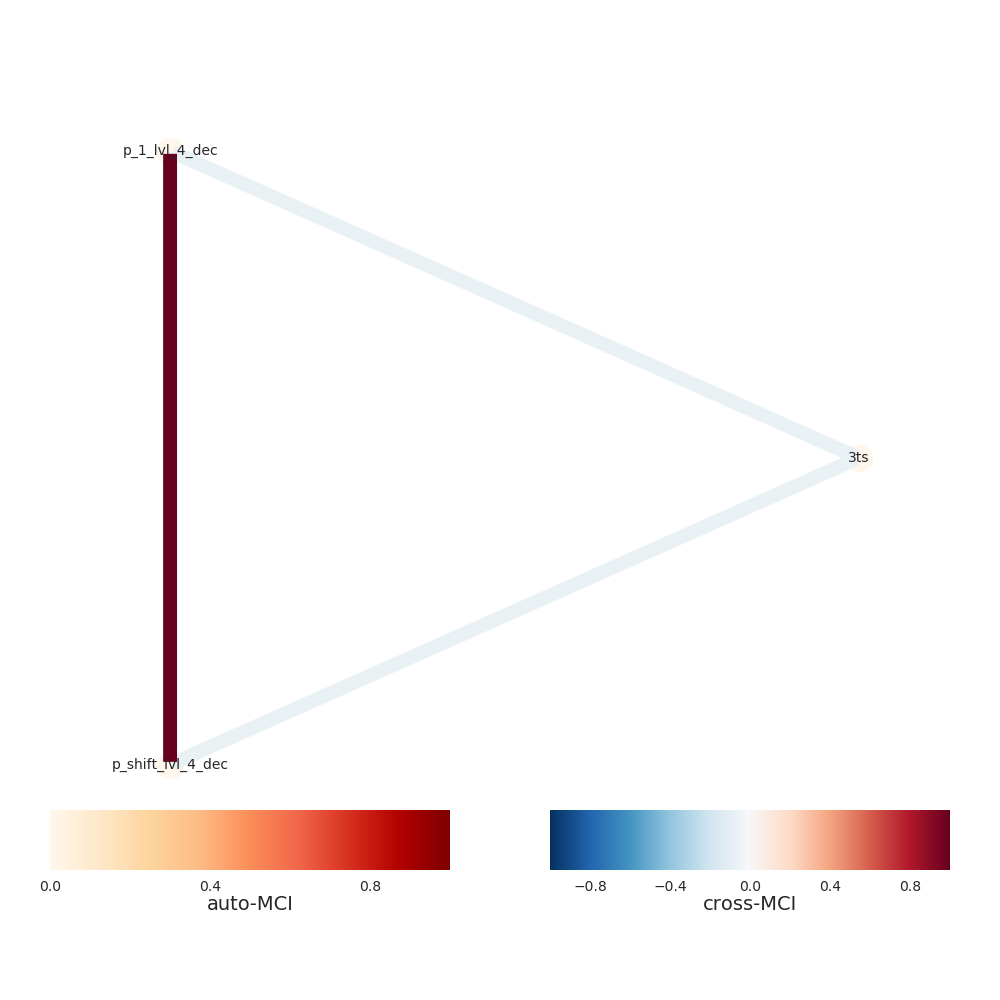

Progress causal inference - traintest set 100%
[INFO] Extracting level 1
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


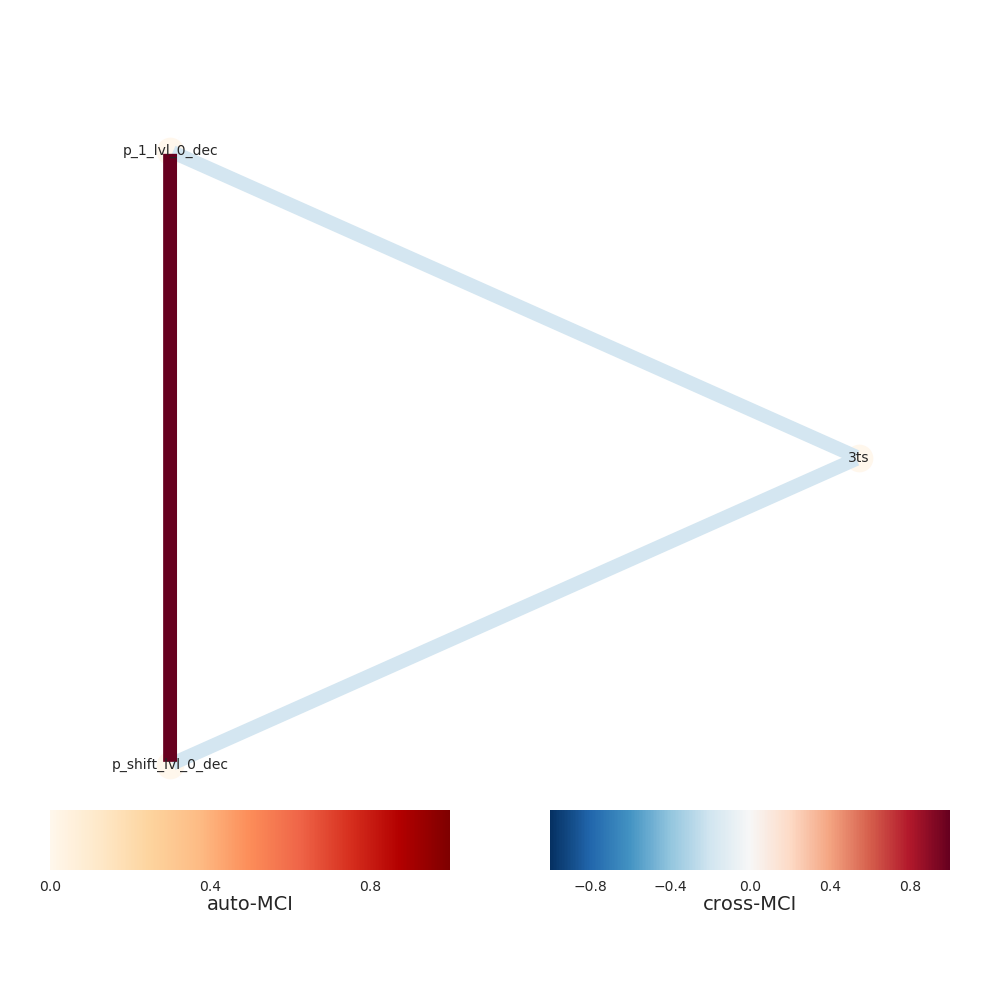

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


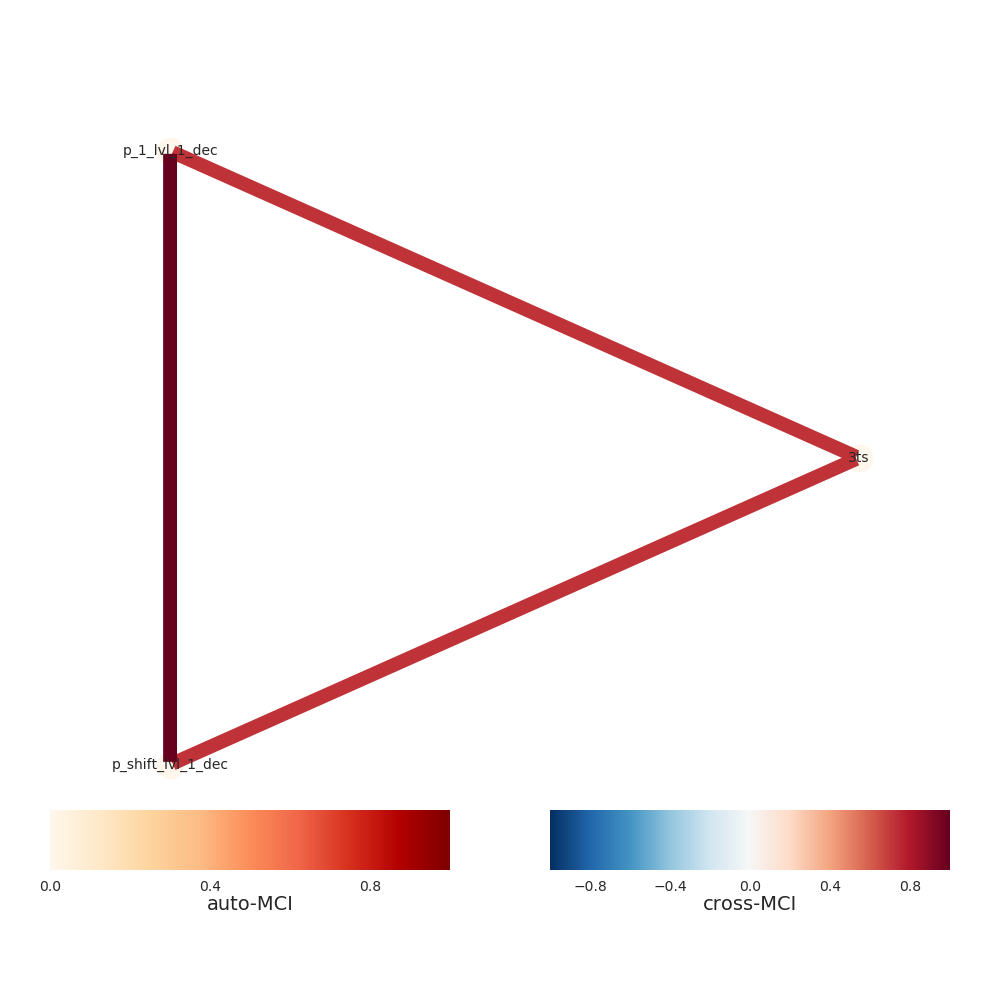

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


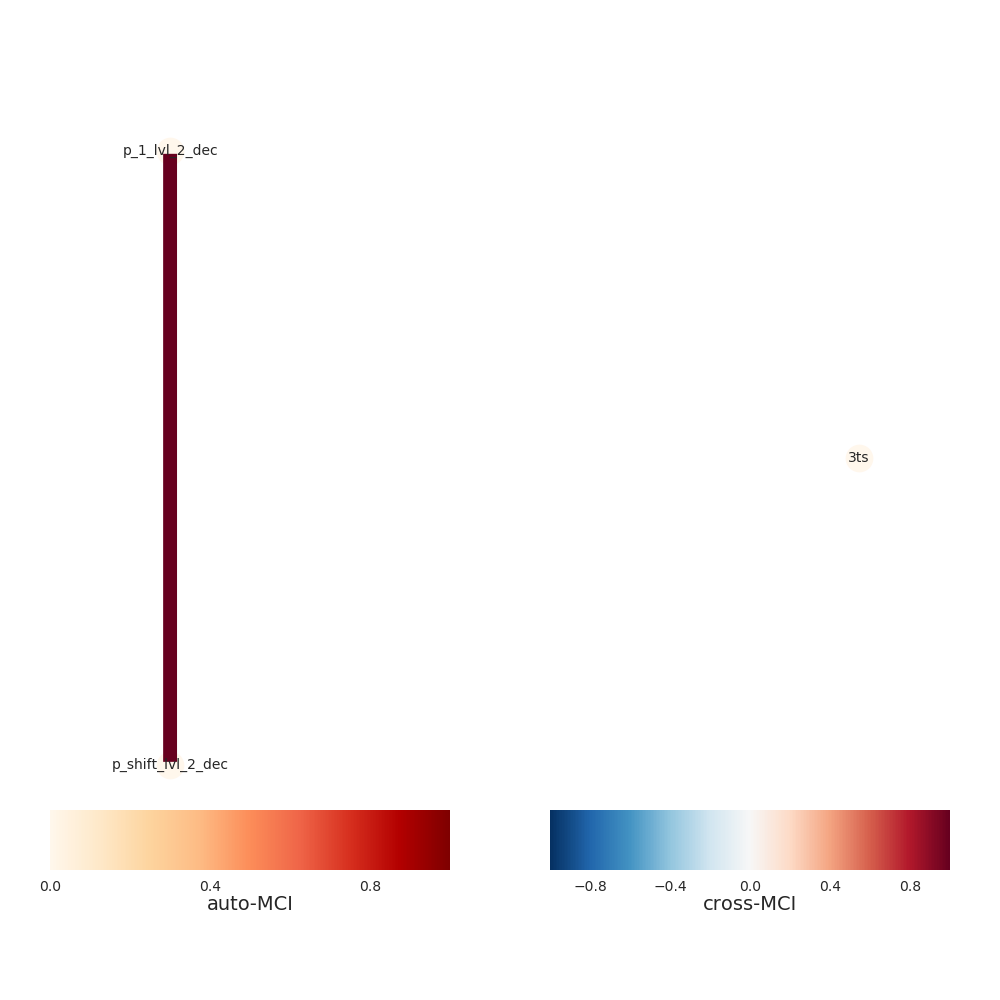

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


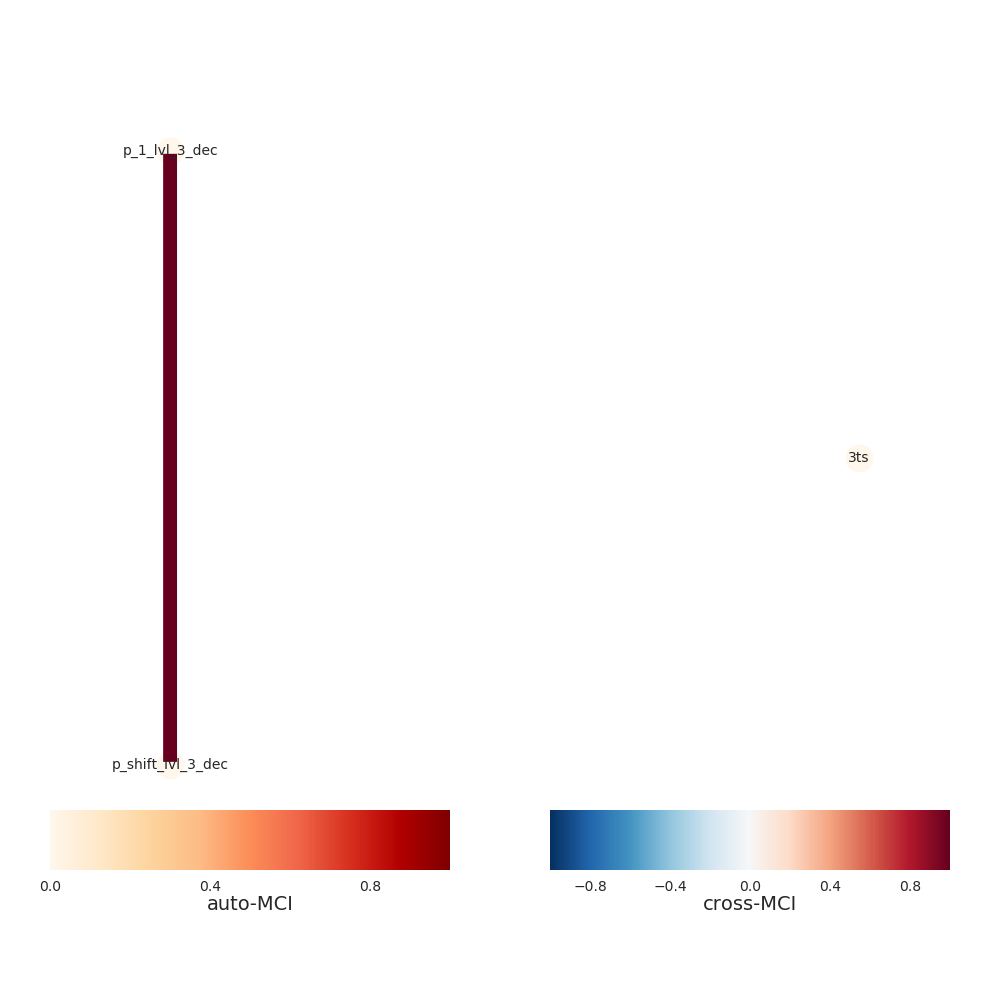

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


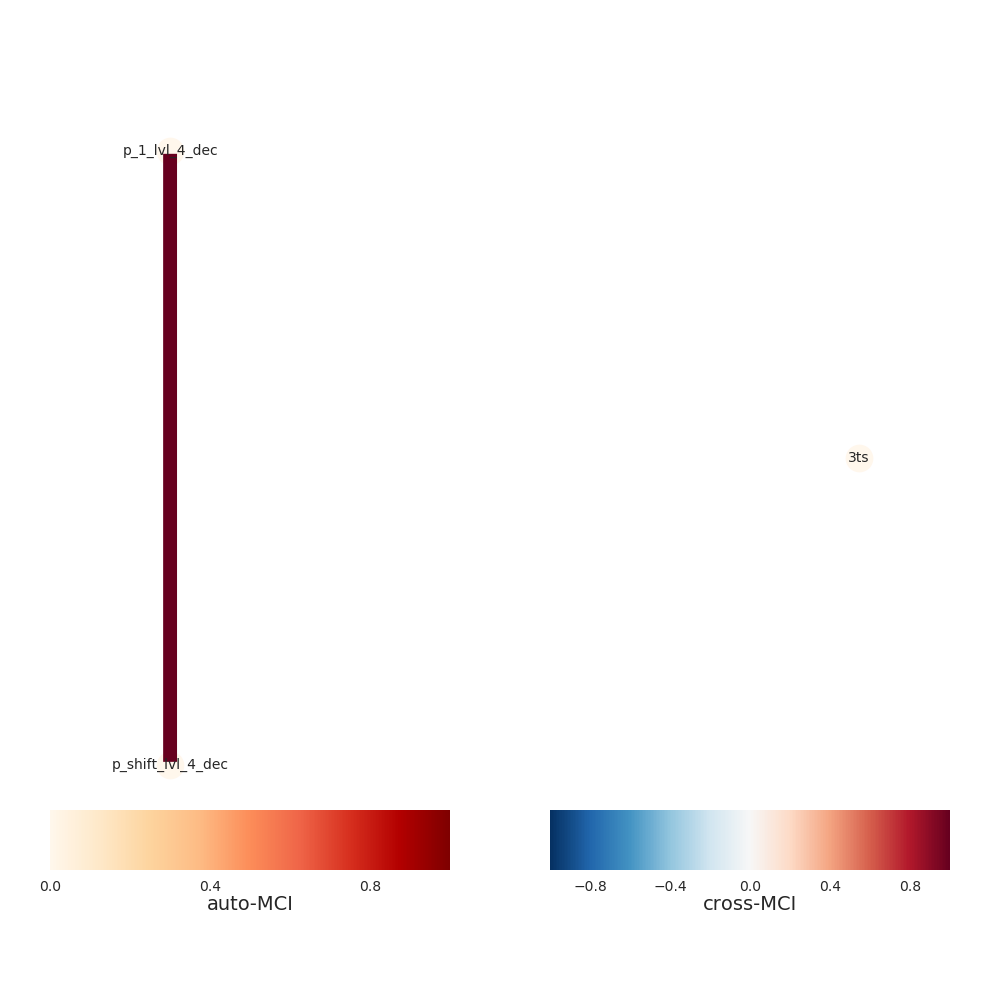

Progress causal inference - traintest set 100%
[INFO] Extracting level 2
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


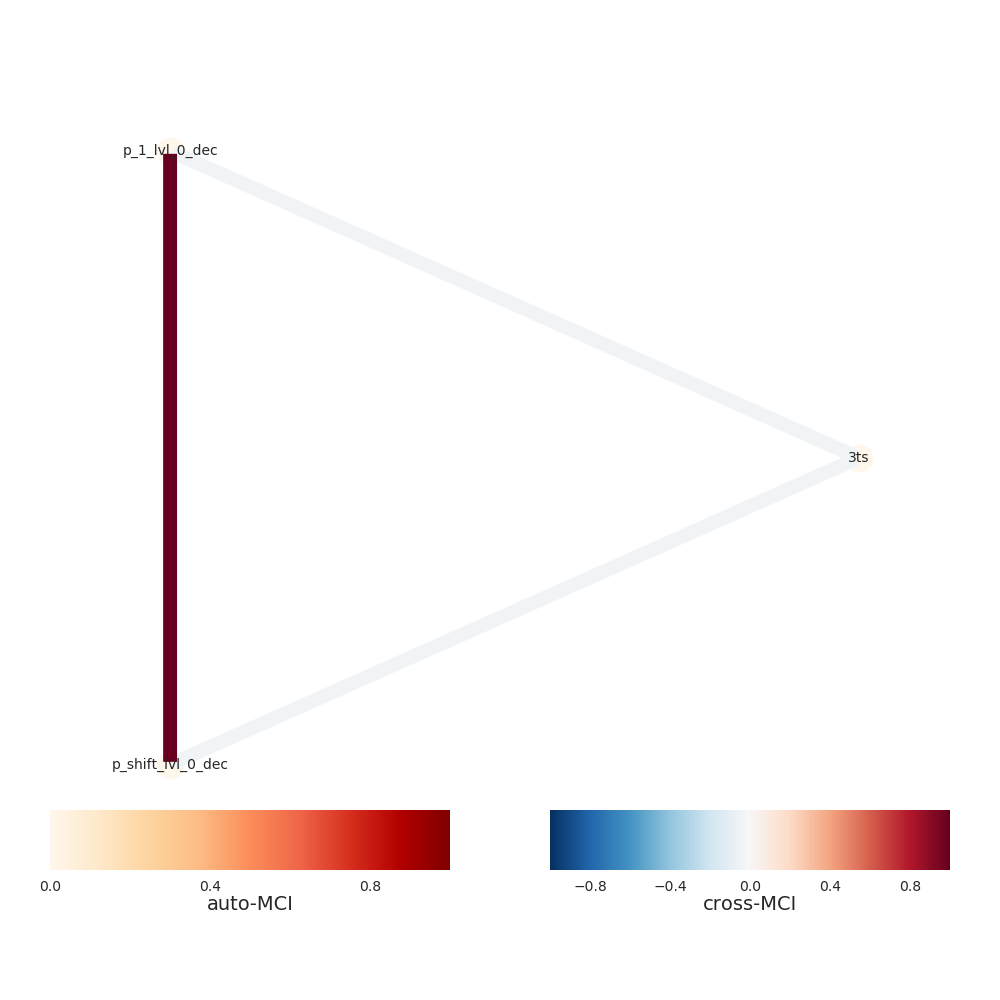

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


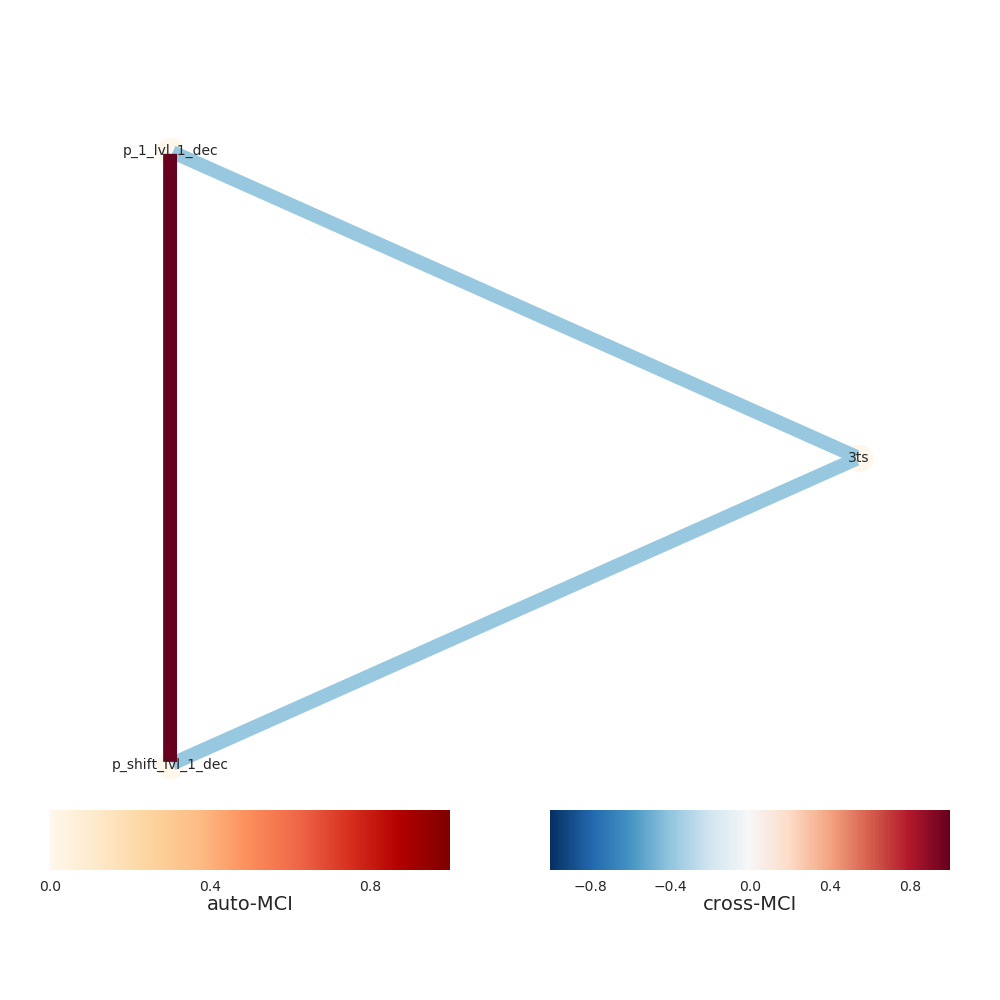

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


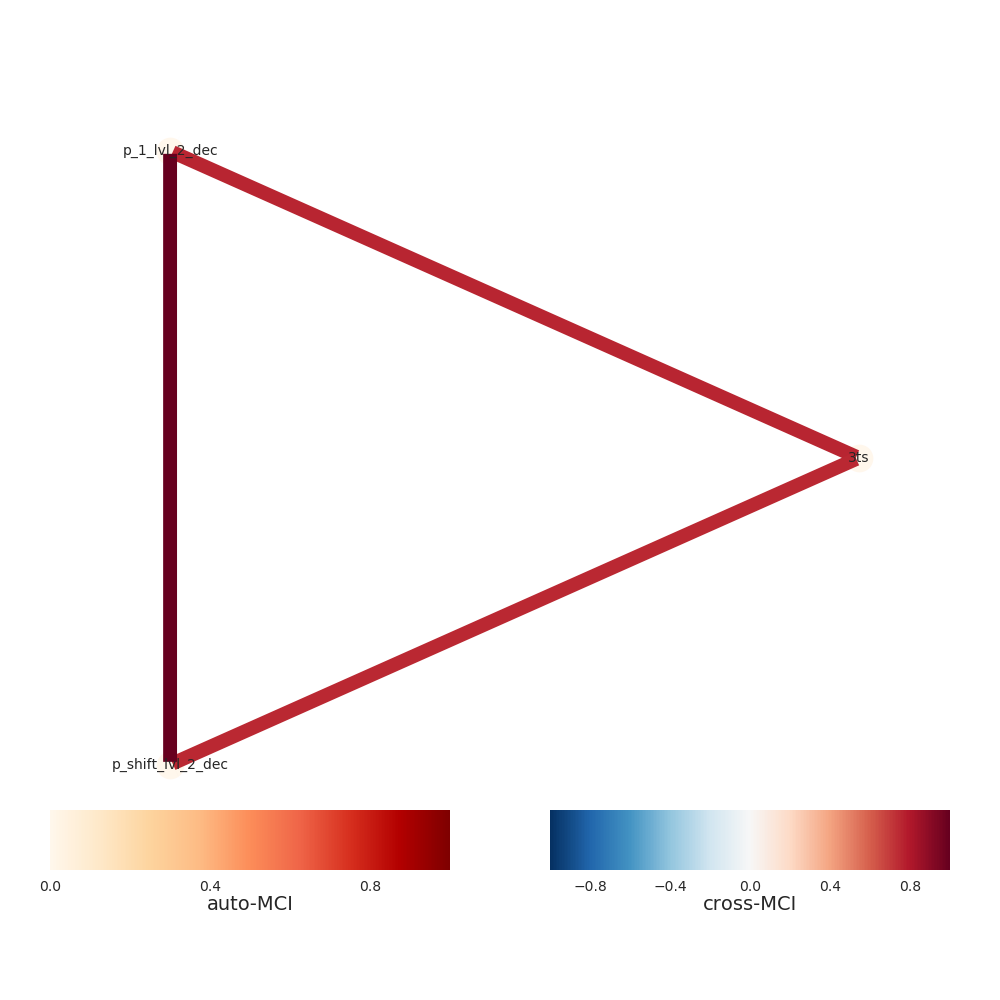

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


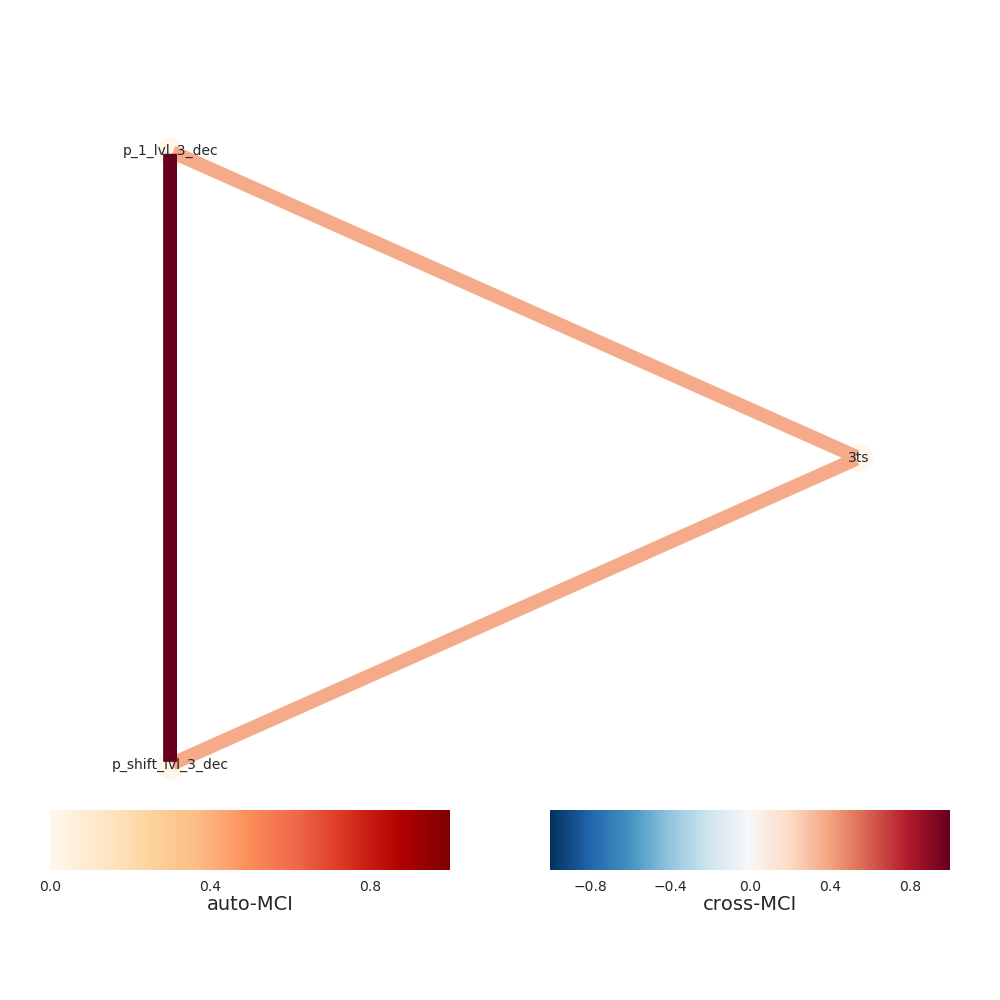

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


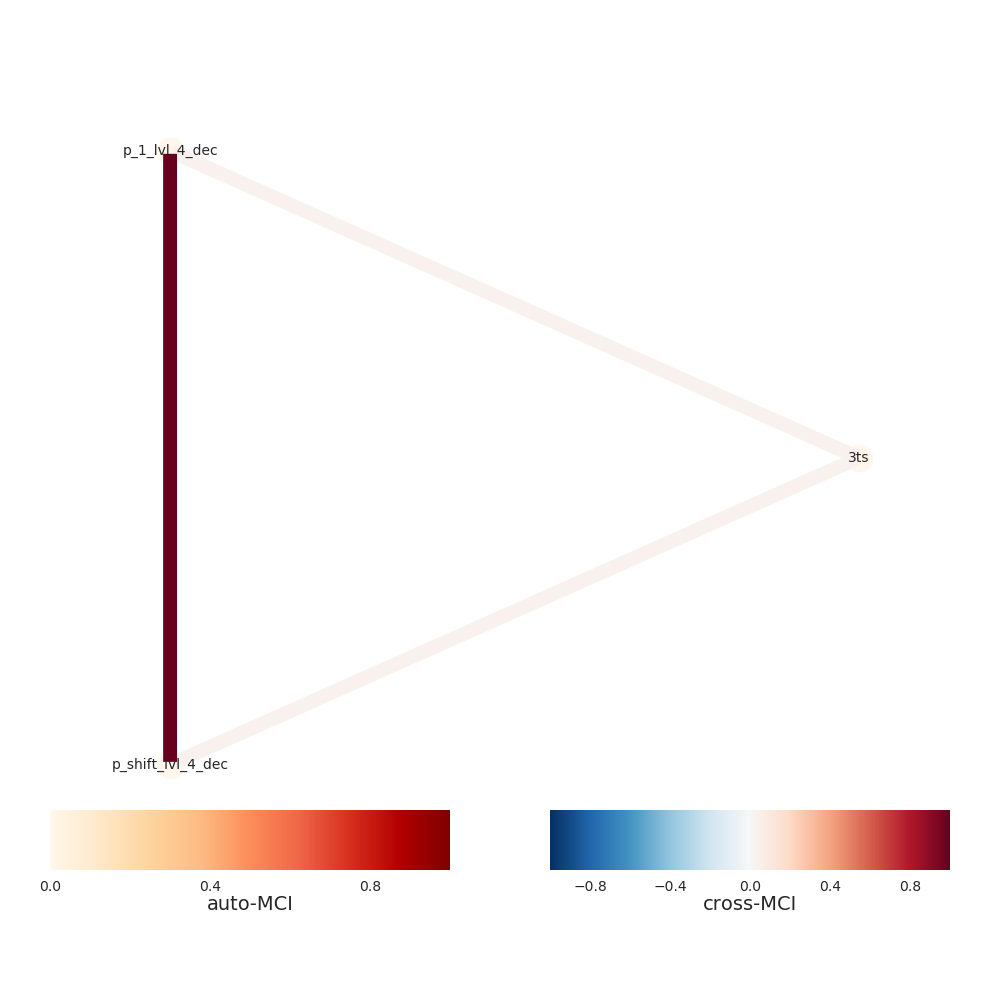

Progress causal inference - traintest set 100%
[INFO] Extracting level 3
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


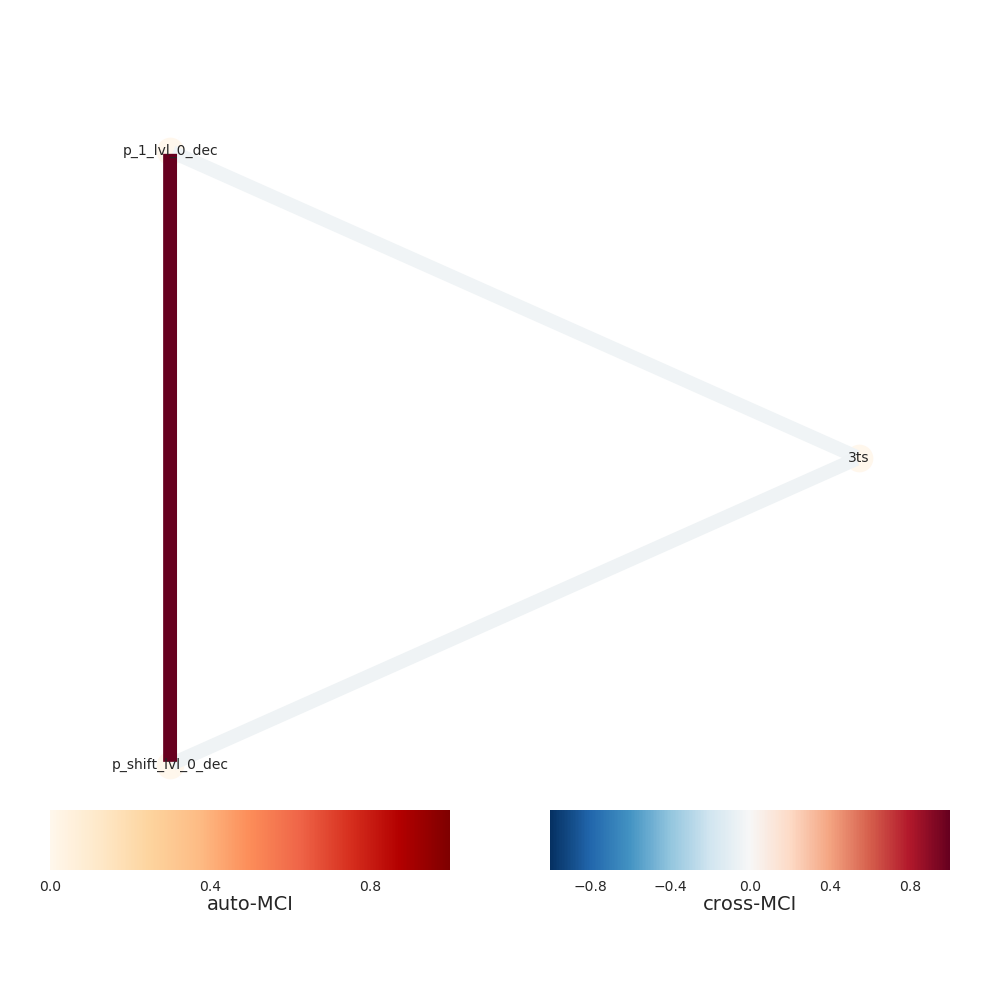

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


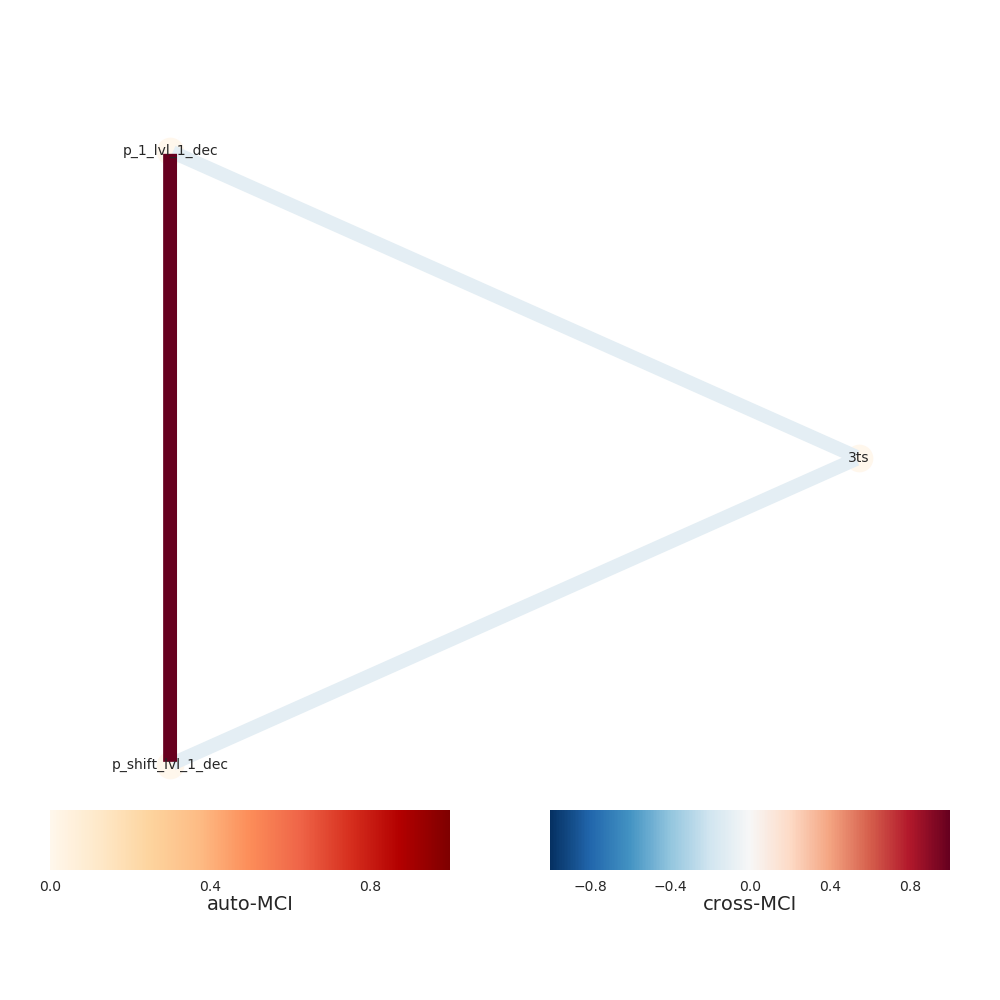

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


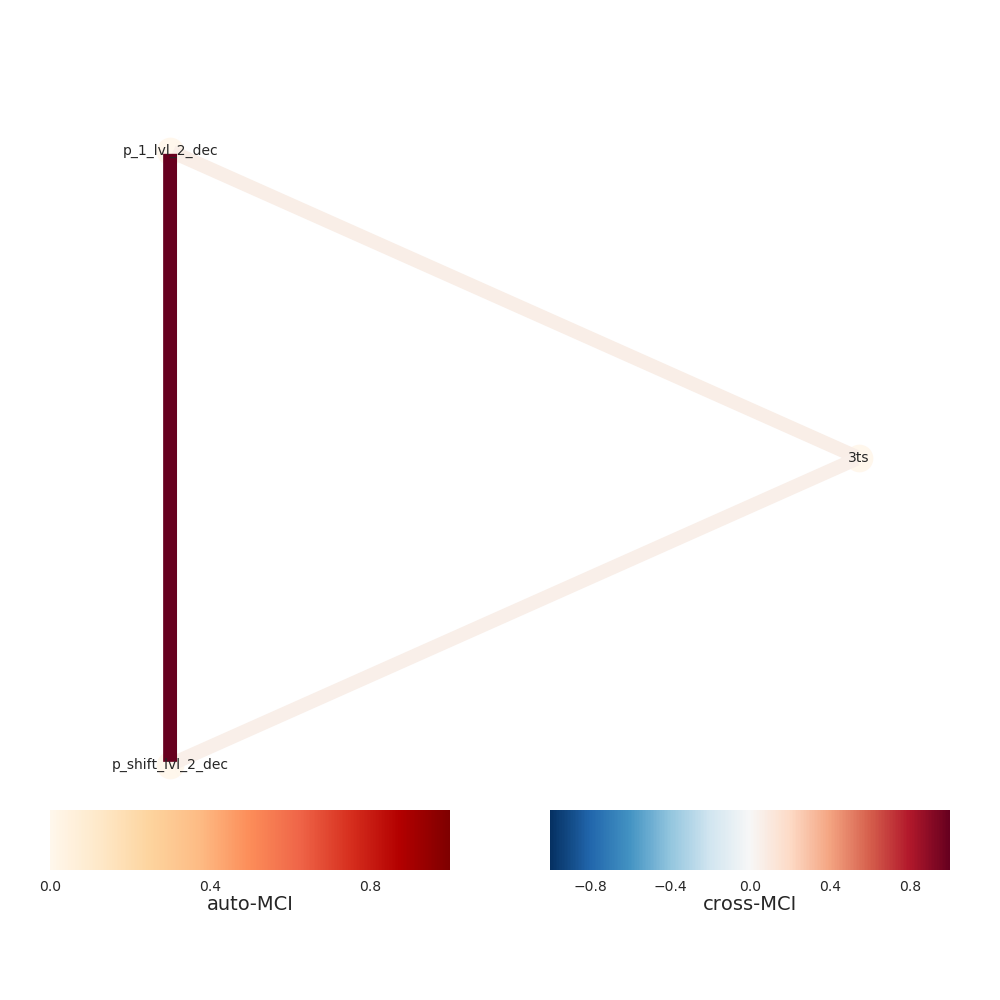

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


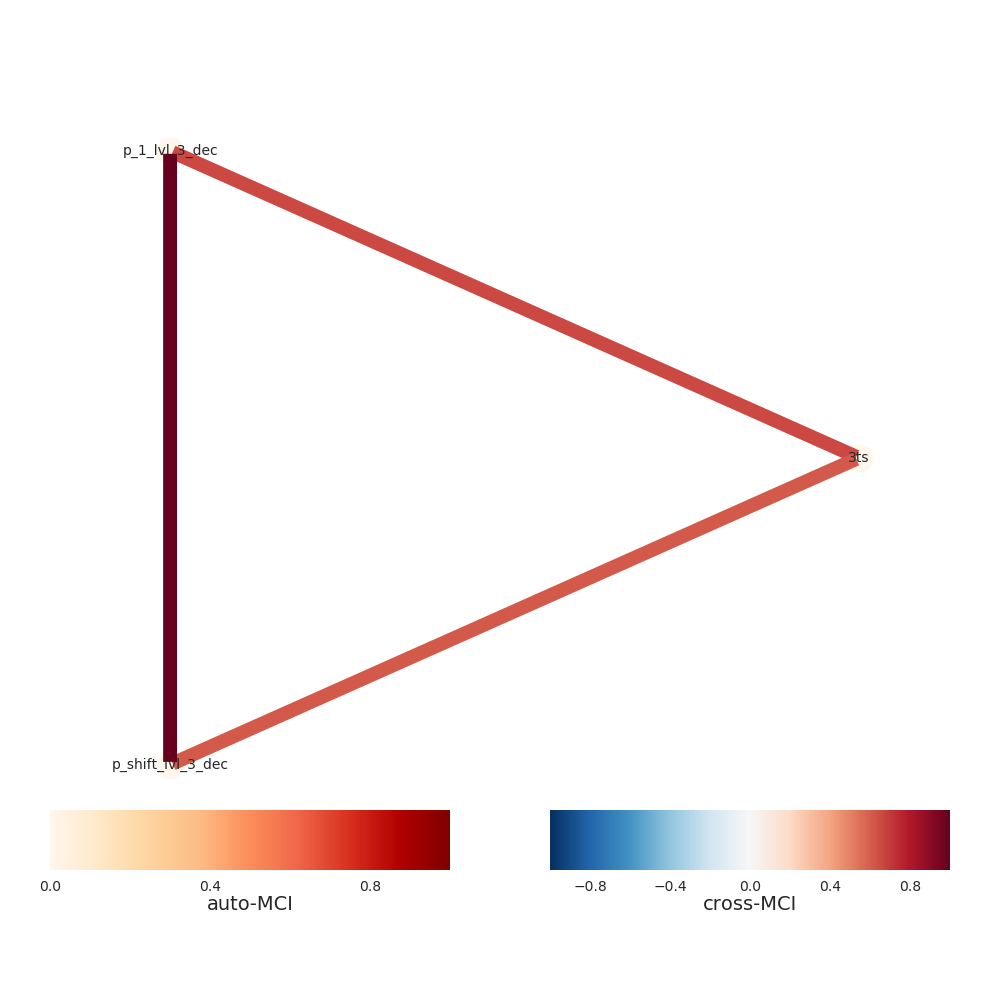

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


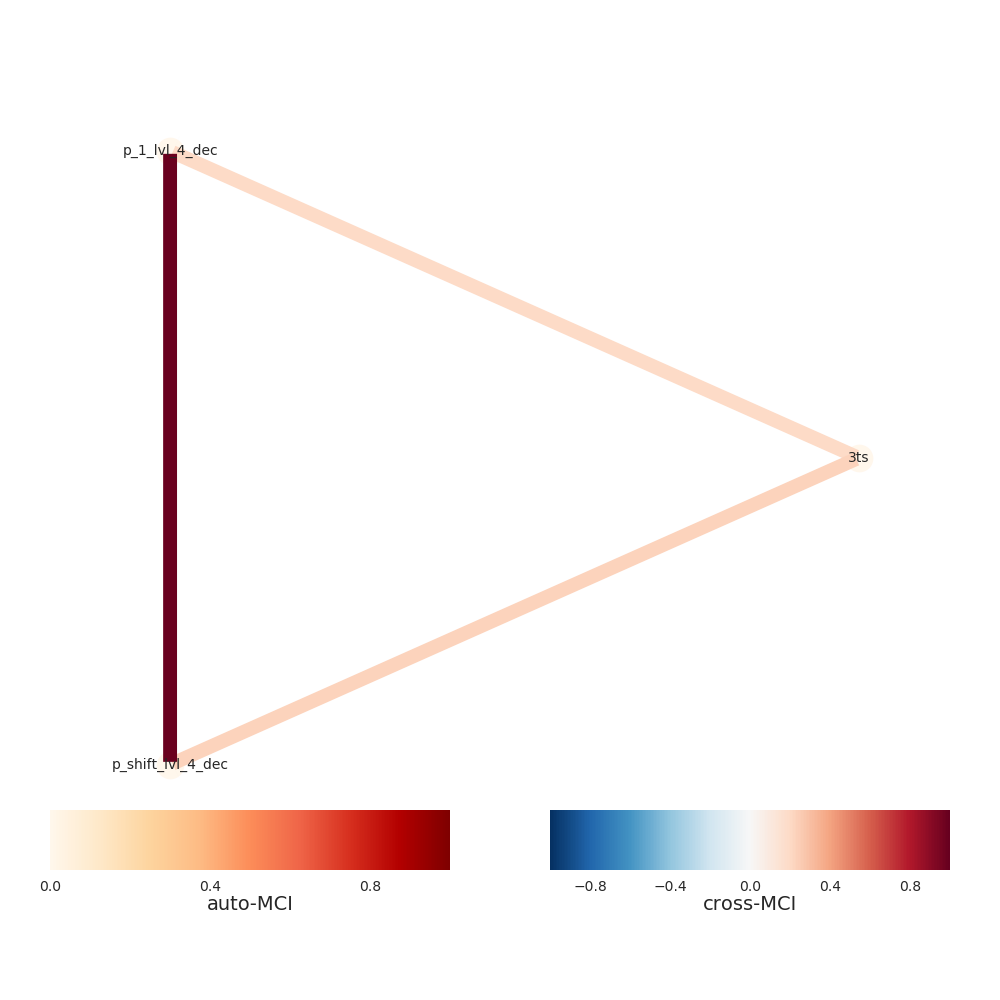

Progress causal inference - traintest set 100%
[INFO] Extracting level 4
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


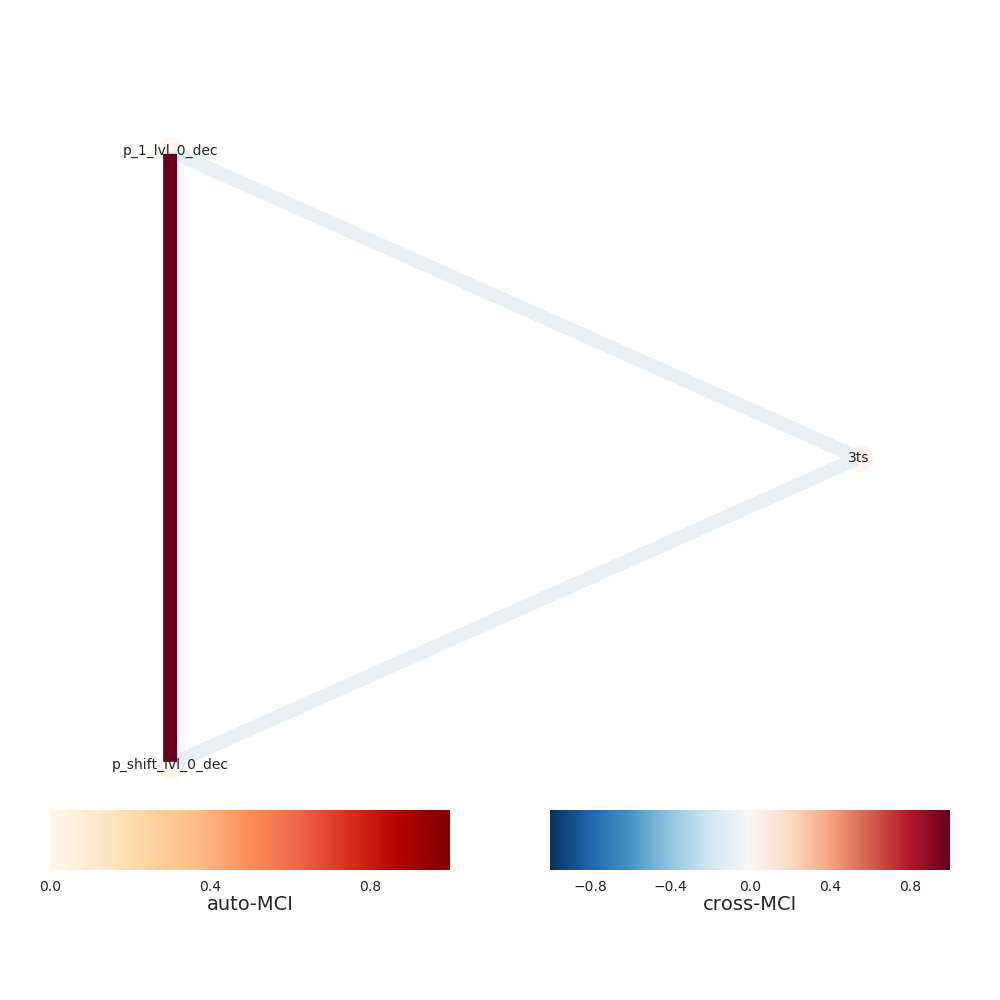

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


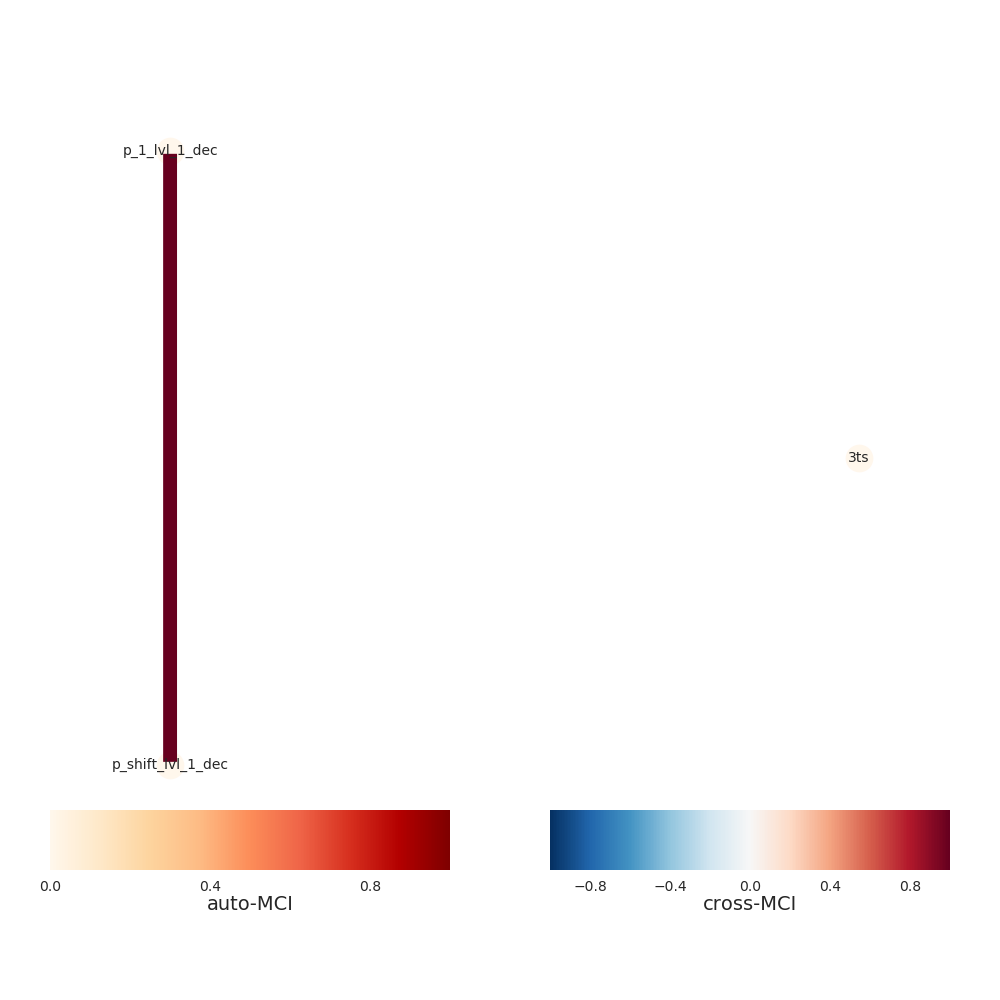

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


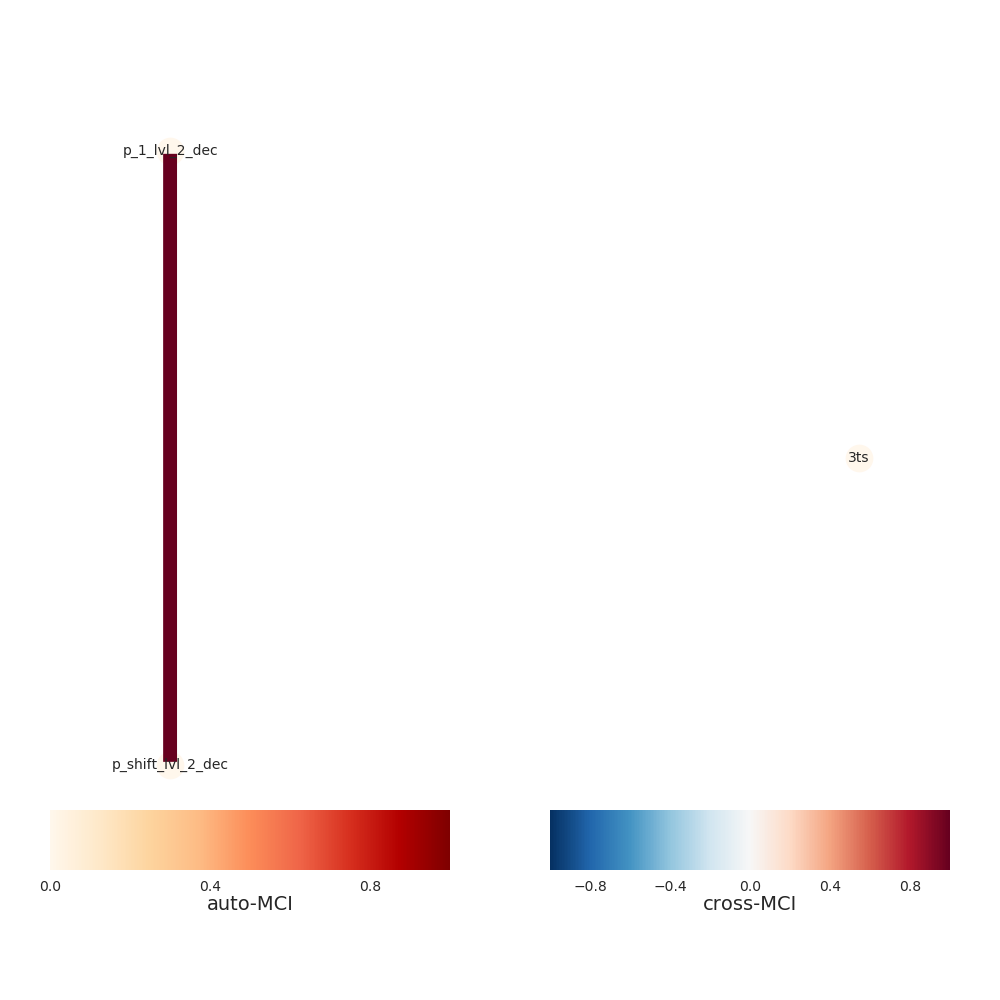

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


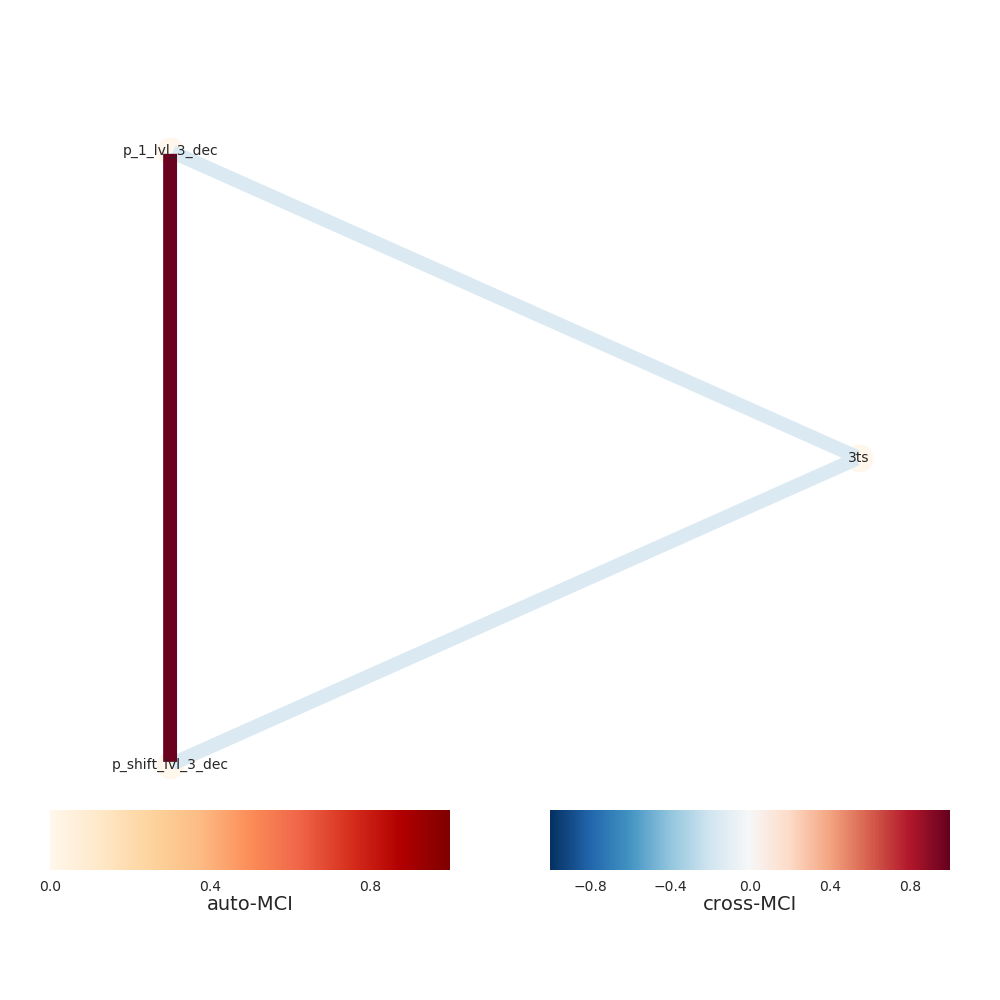

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


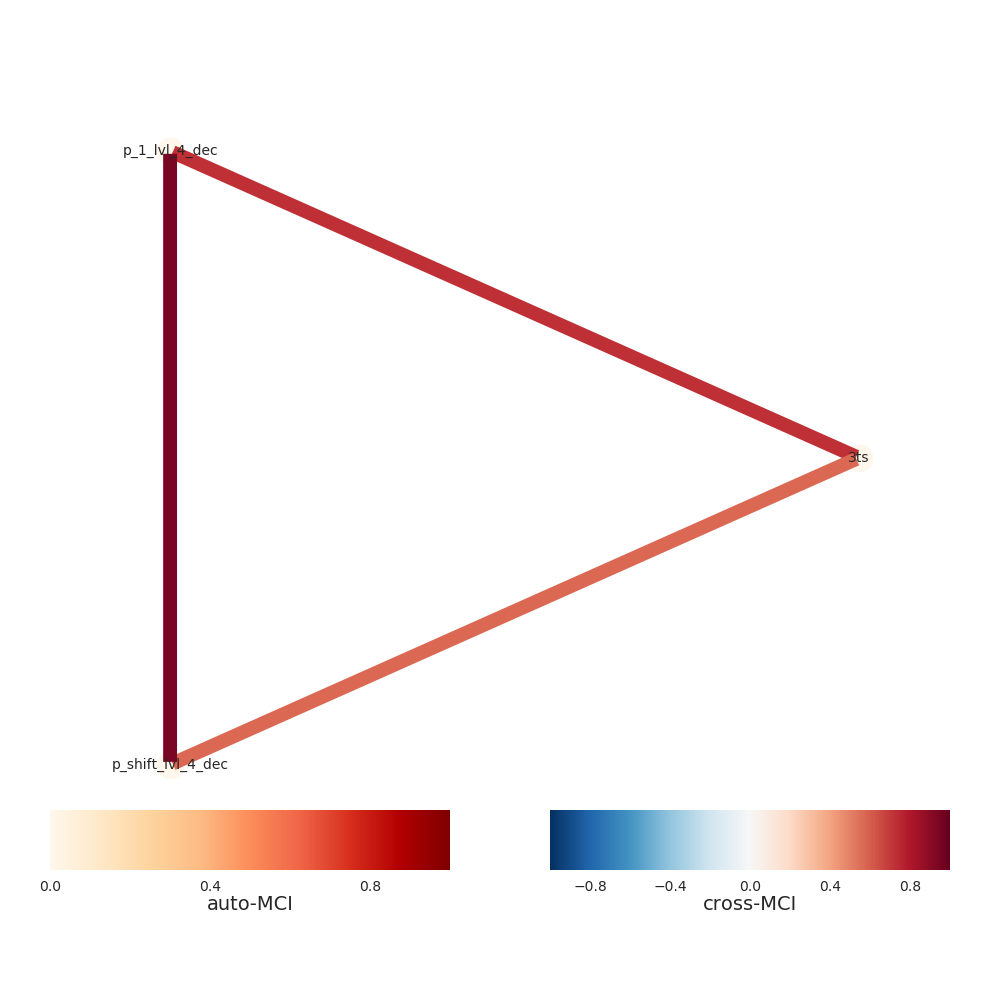

Progress causal inference - traintest set 100%
[INFO] Extracting level 5
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


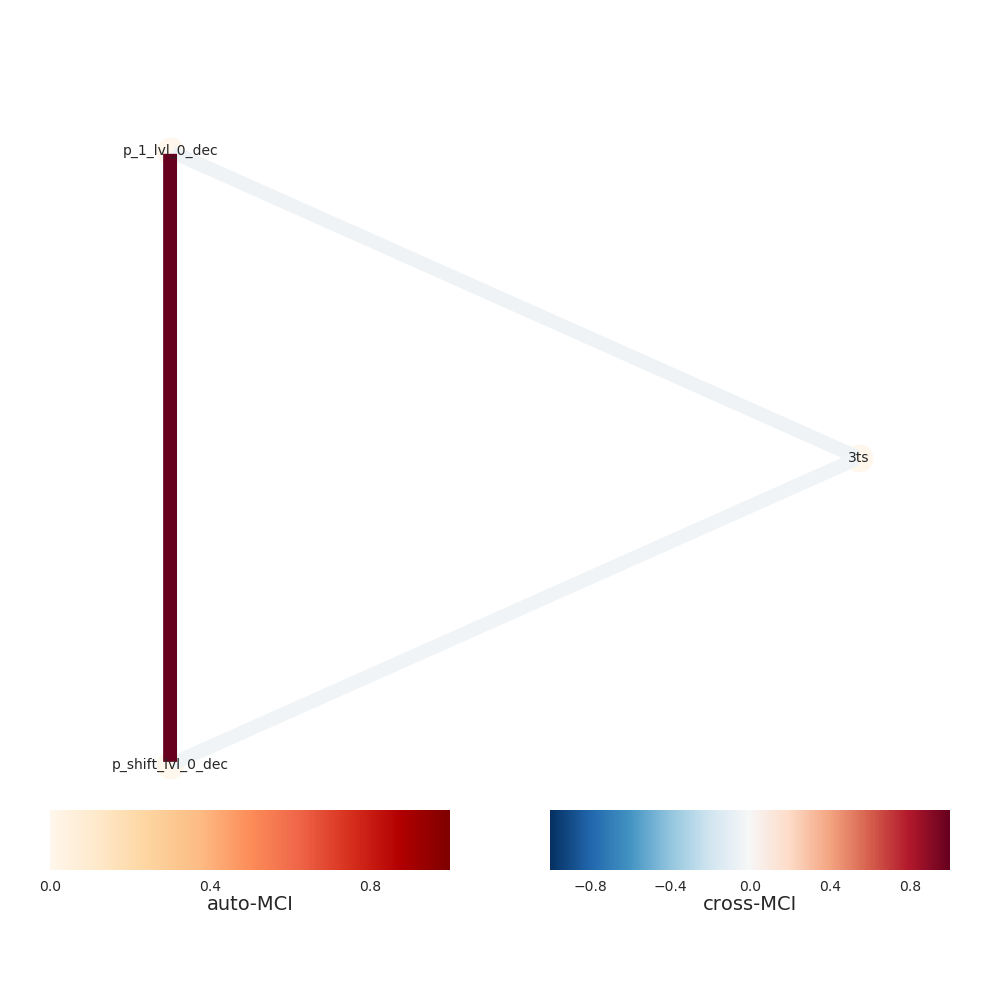

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


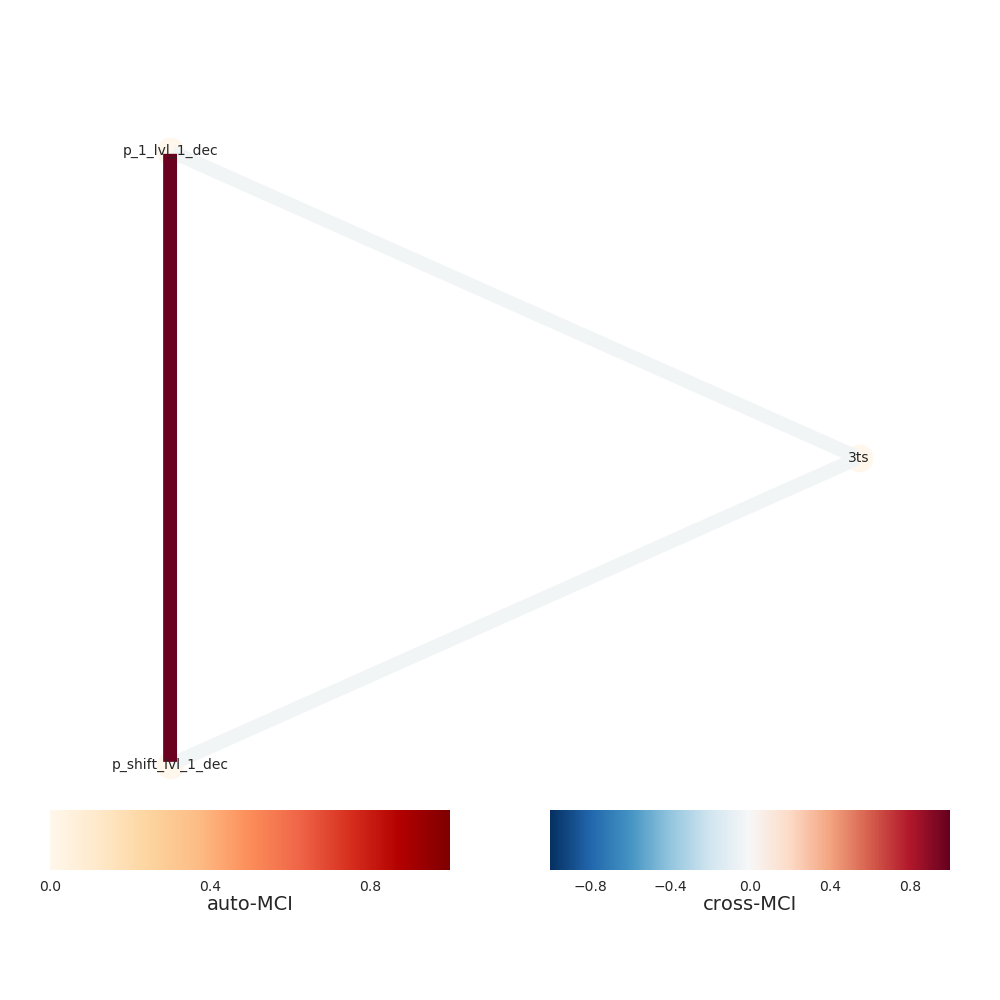

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


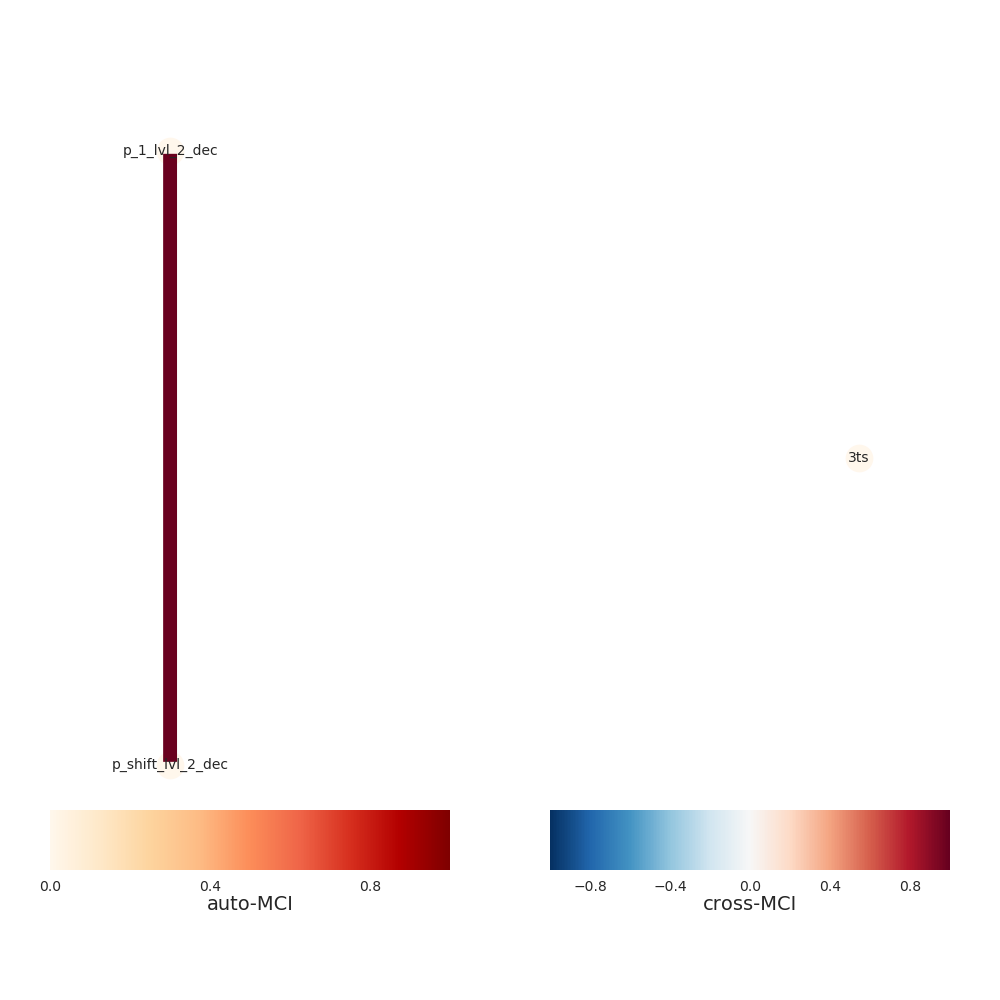

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


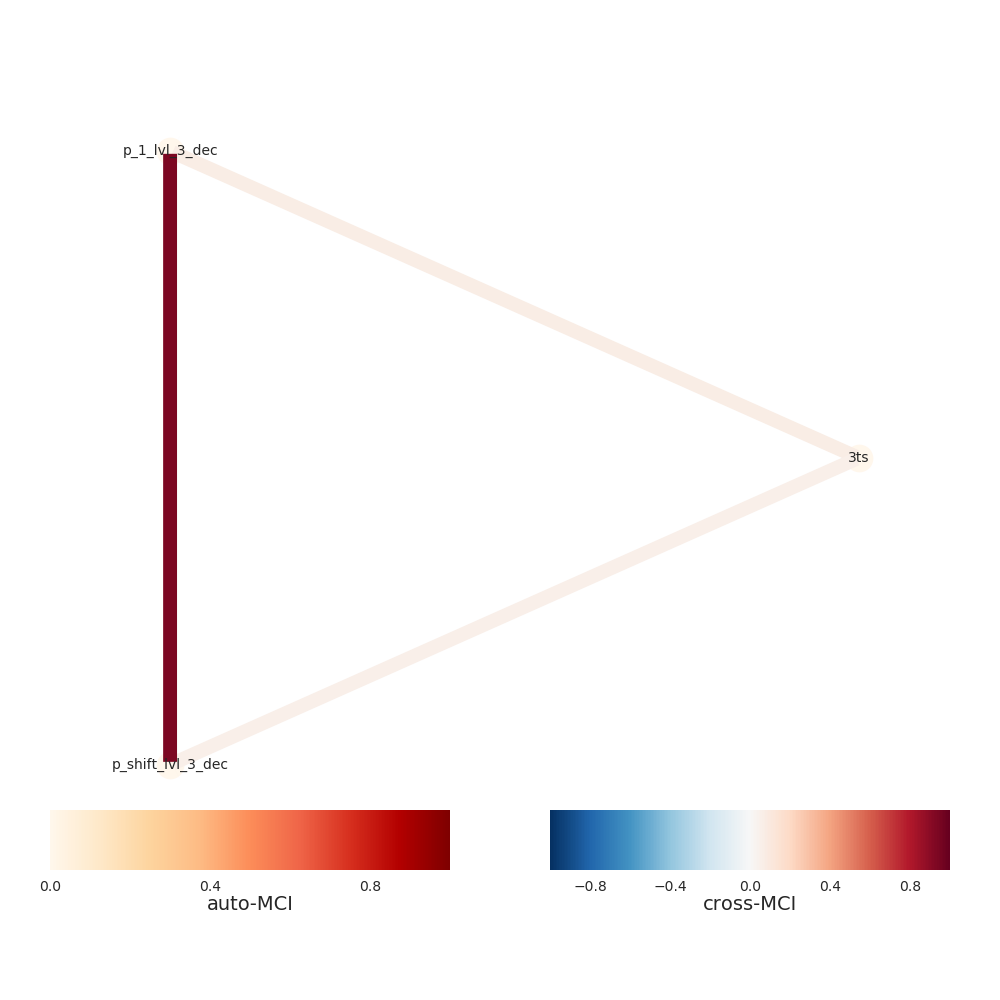

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


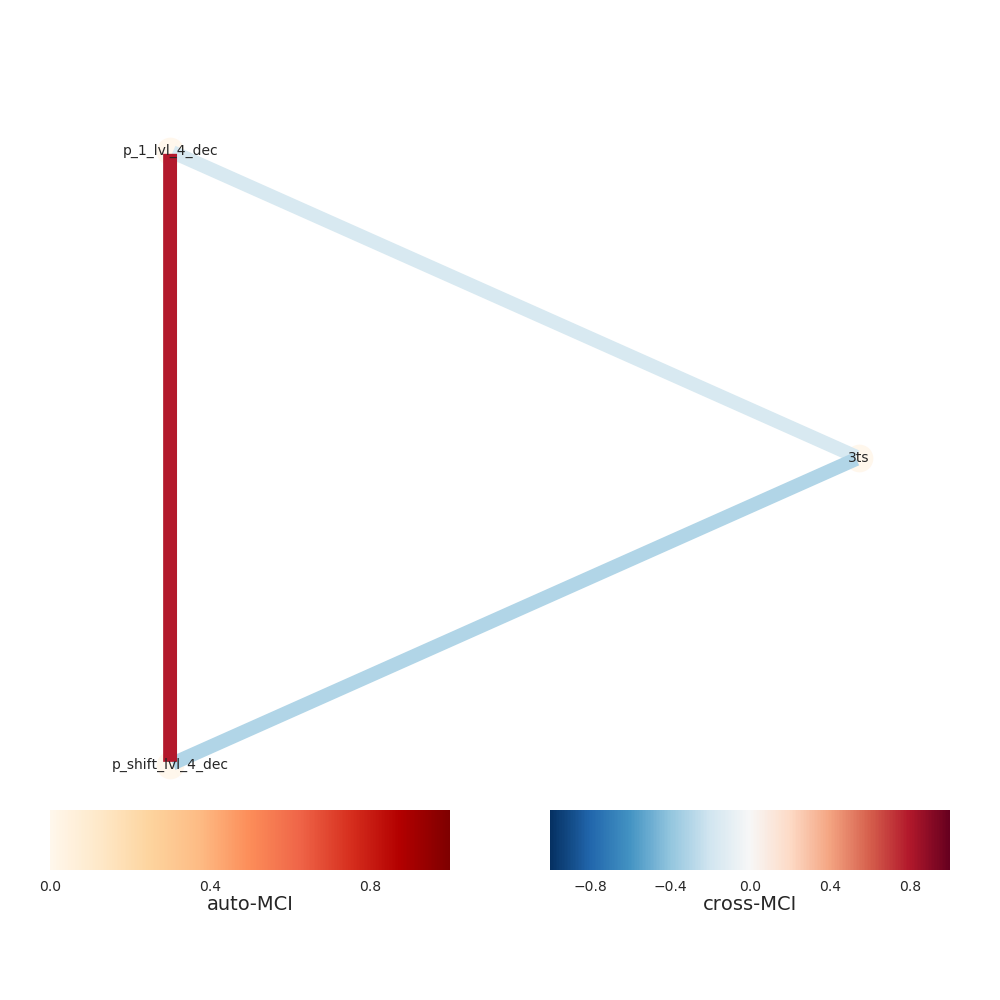

Progress causal inference - traintest set 100%
[INFO] Extracting level 6
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


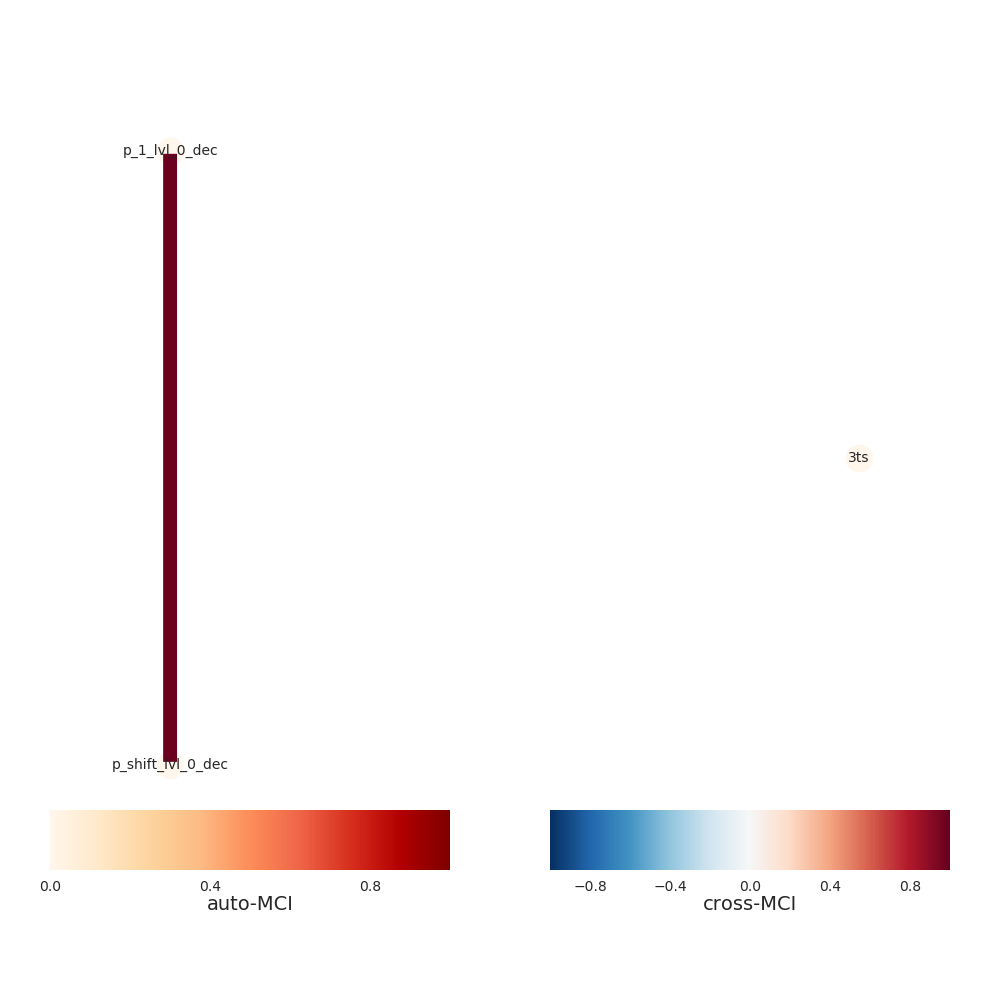

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


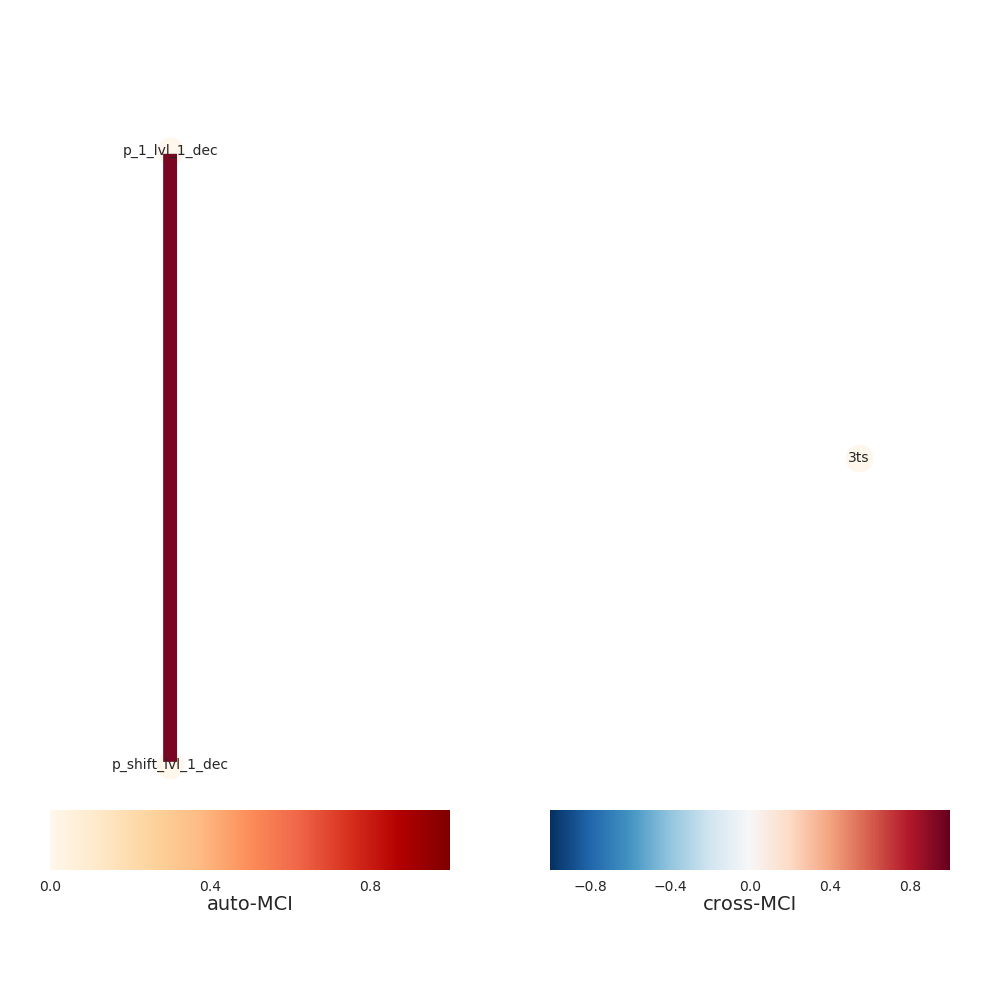

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


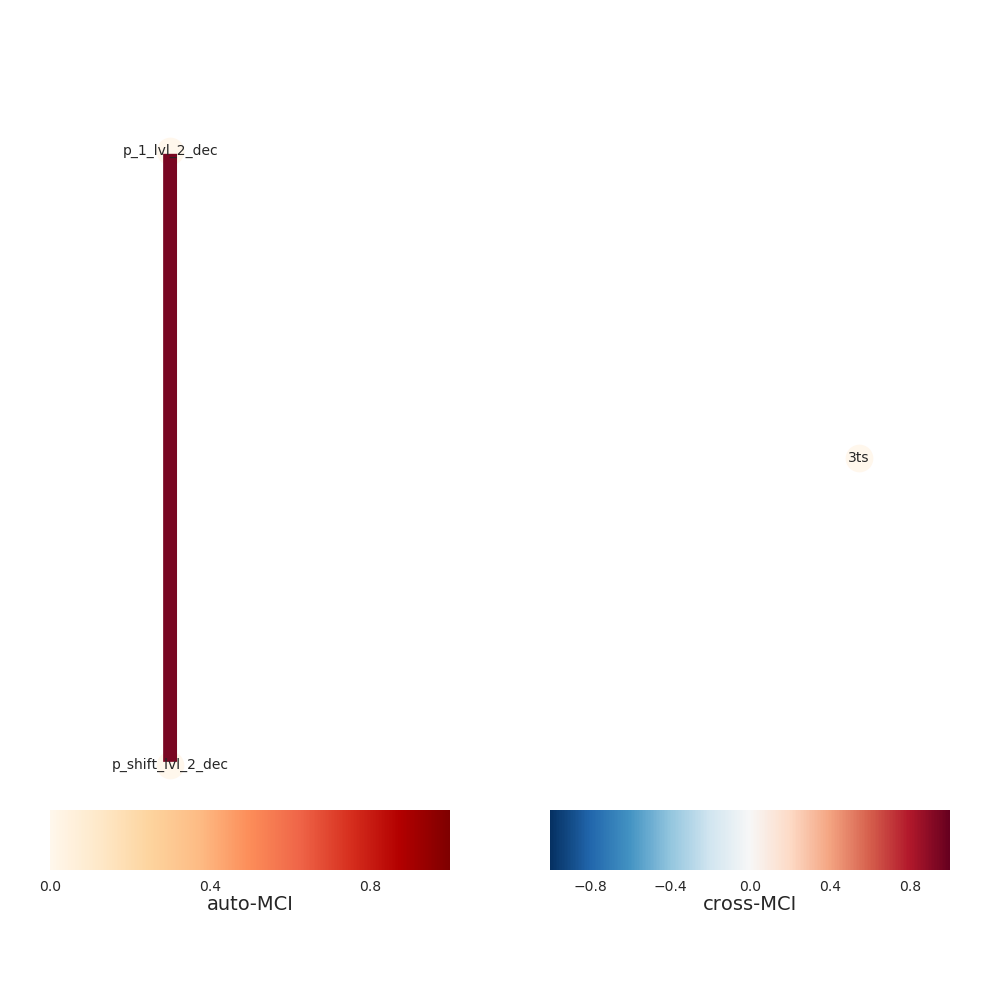

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


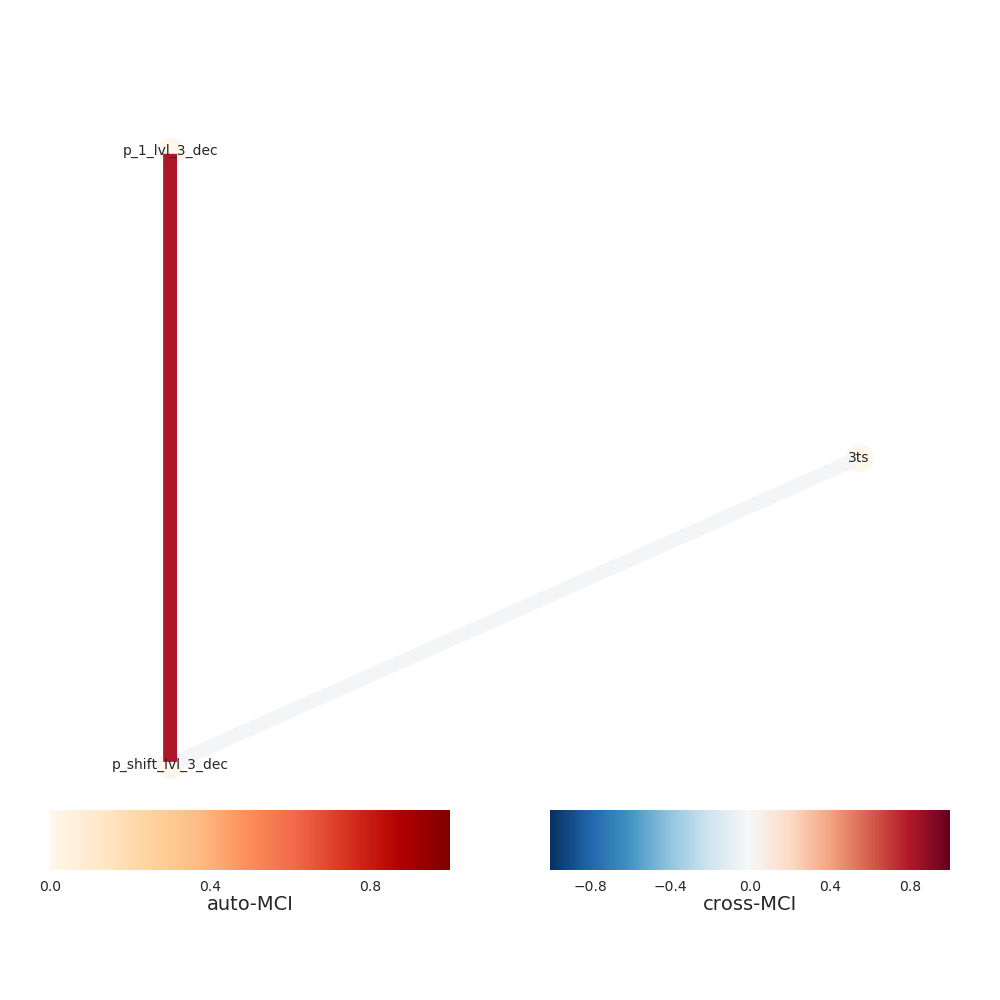

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


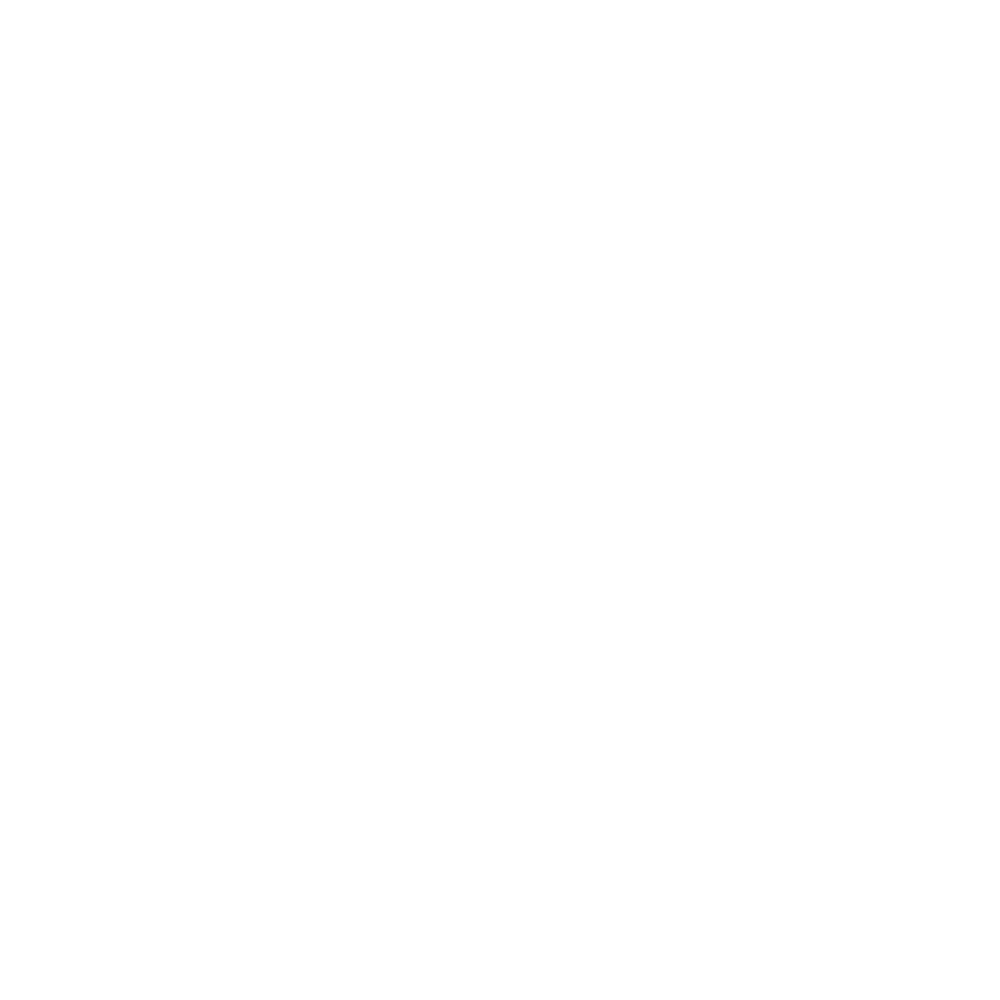

Progress causal inference - traintest set 100%
[INFO] Extracting level 7
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


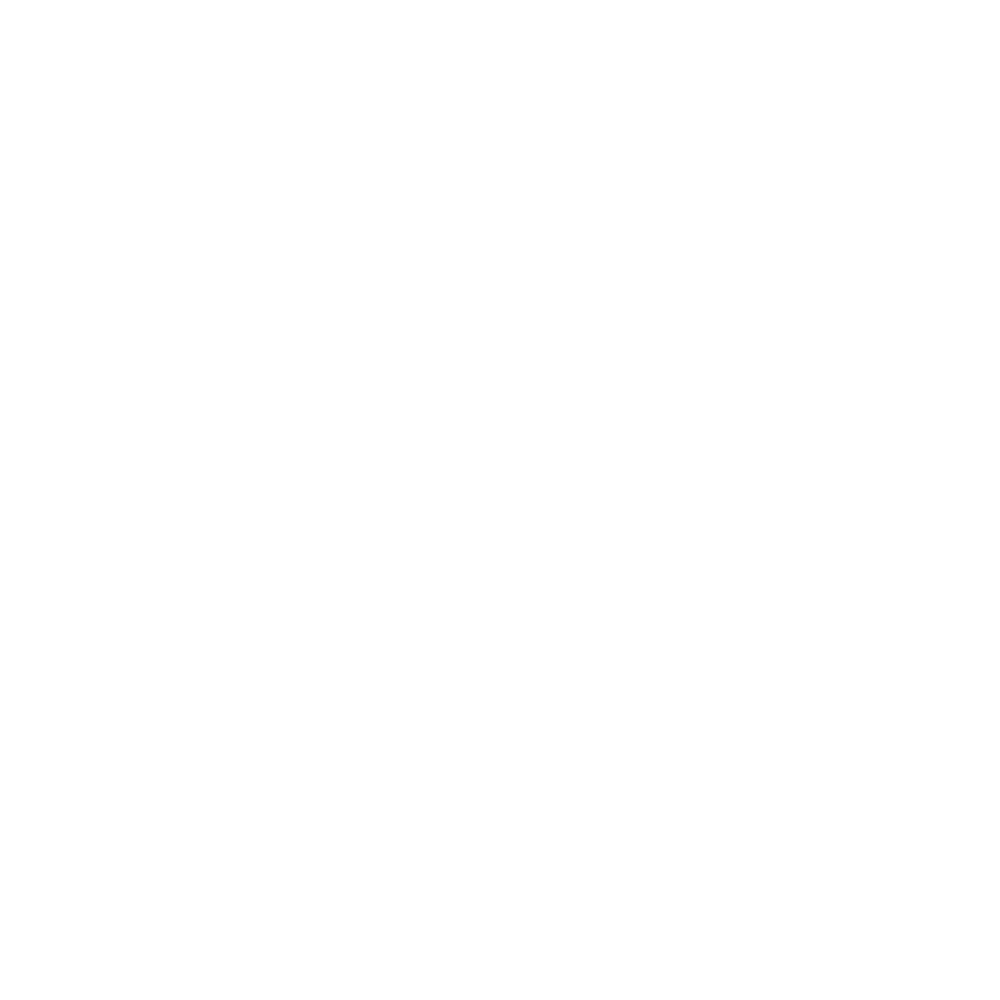

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


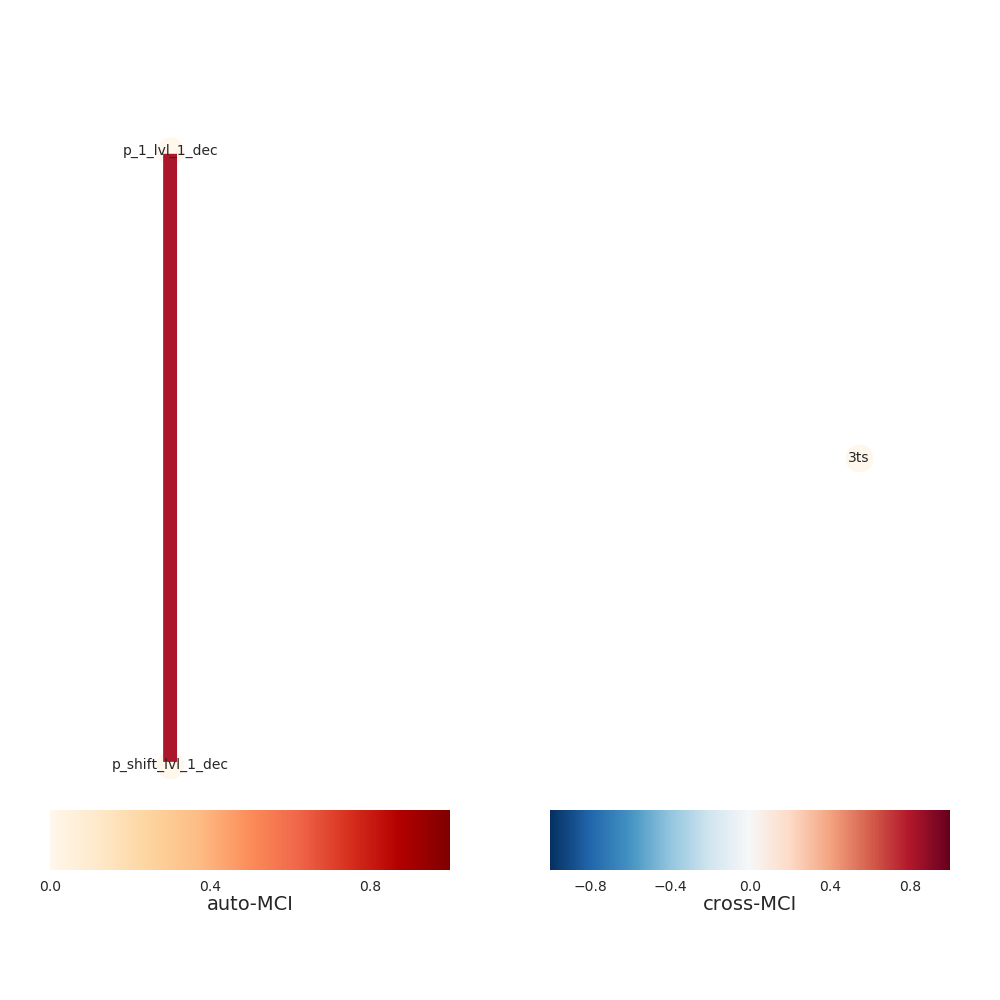

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


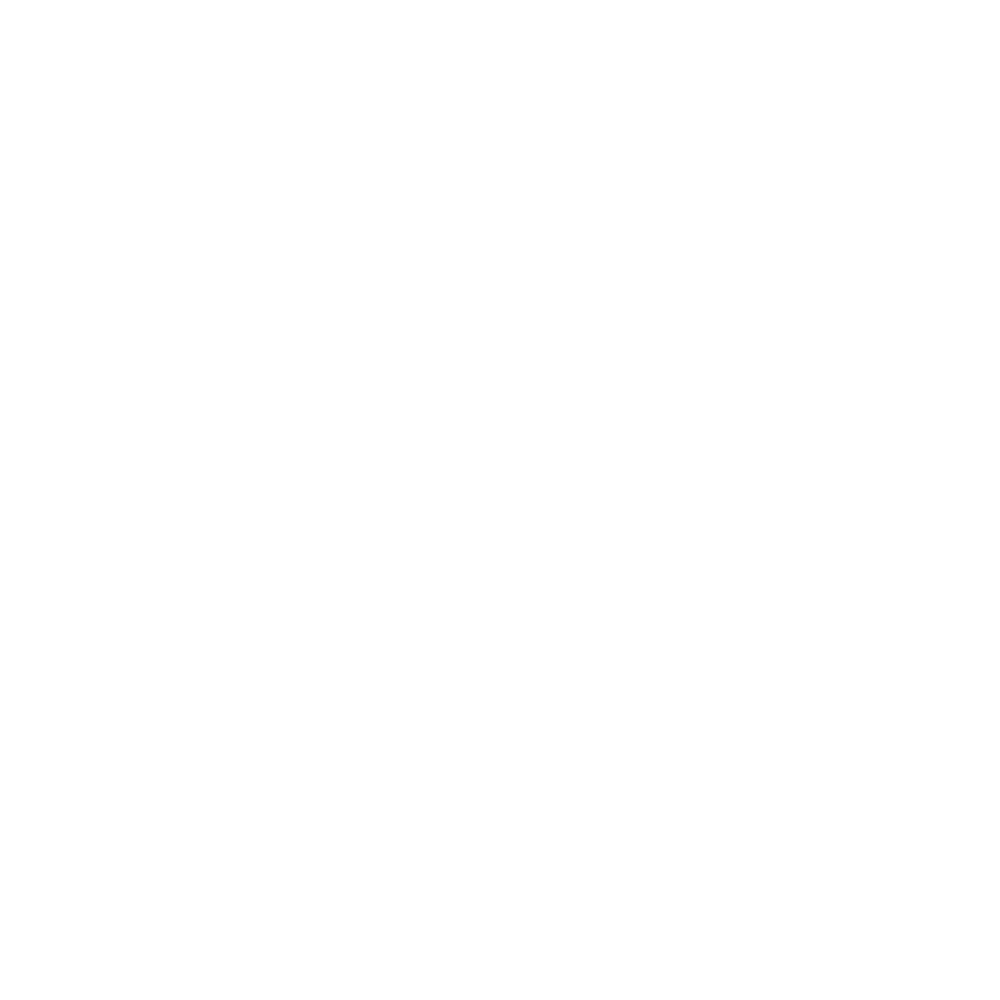

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


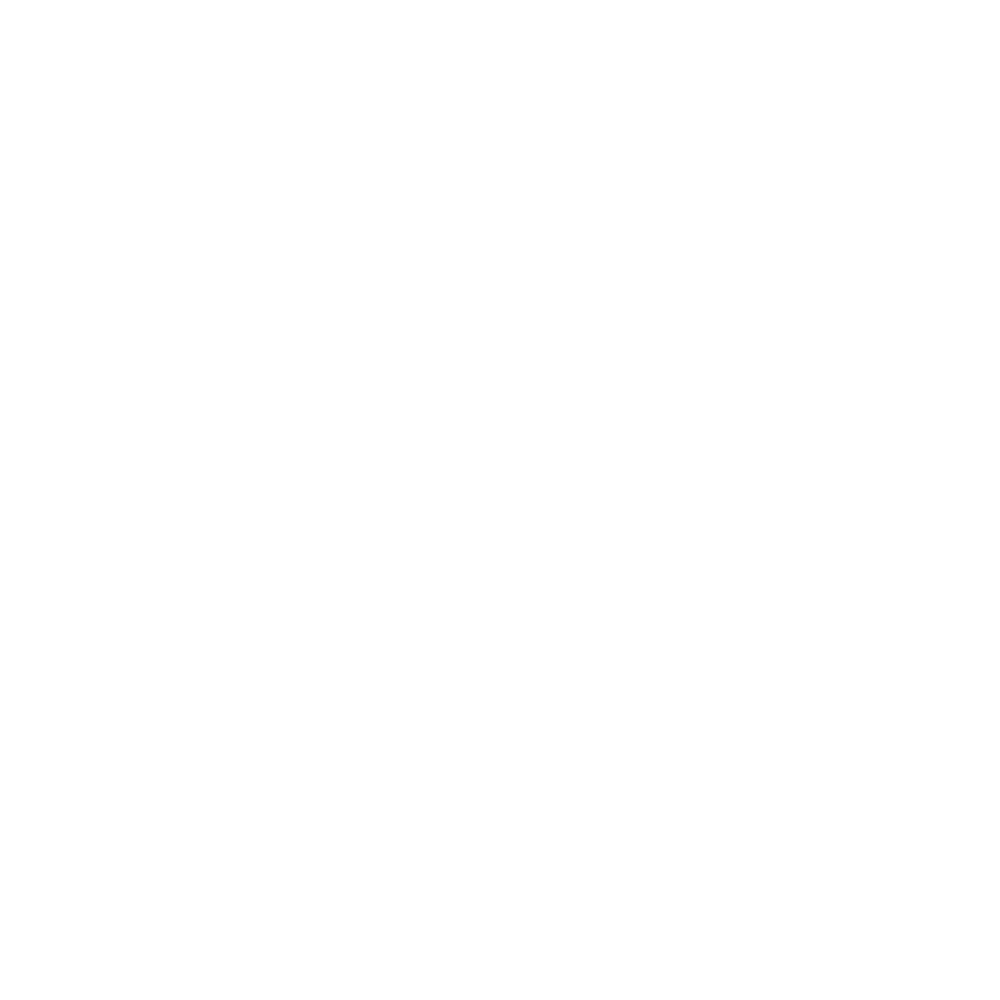

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


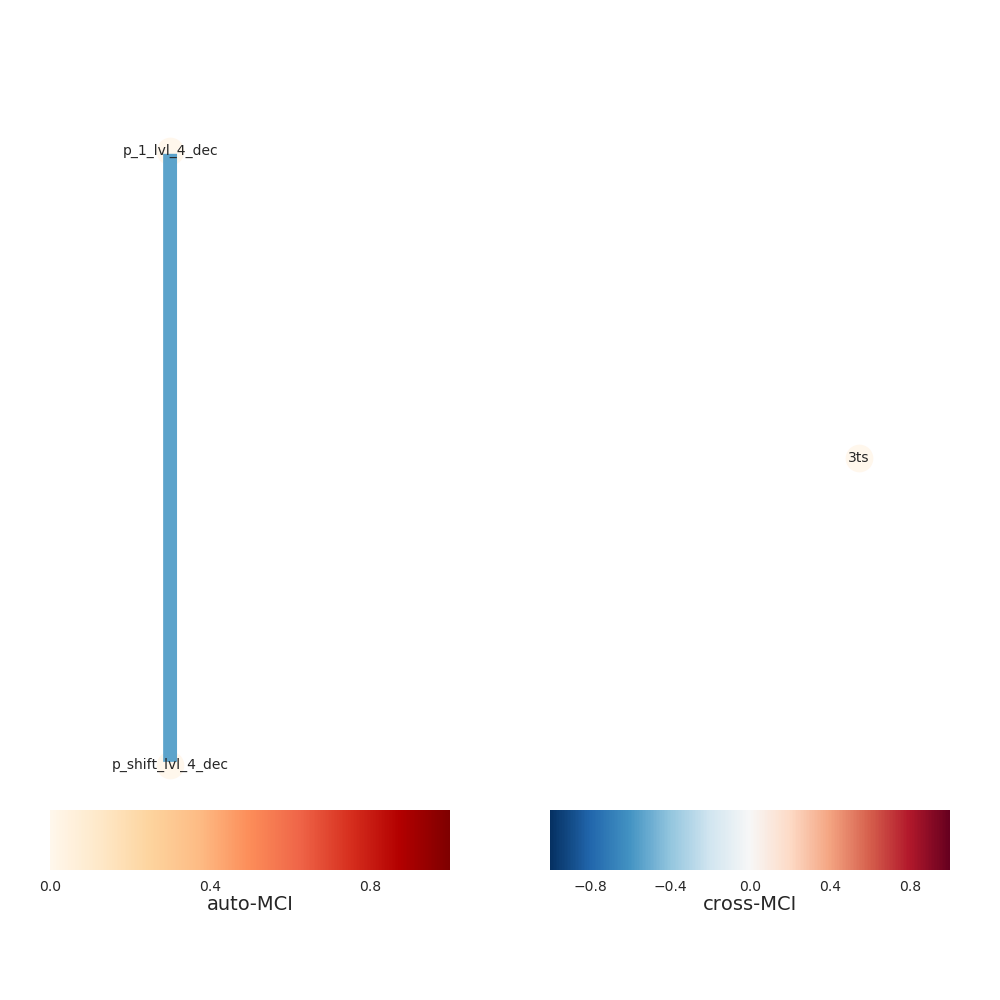

Progress causal inference - traintest set 100%
[INFO] Extracting level 8
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


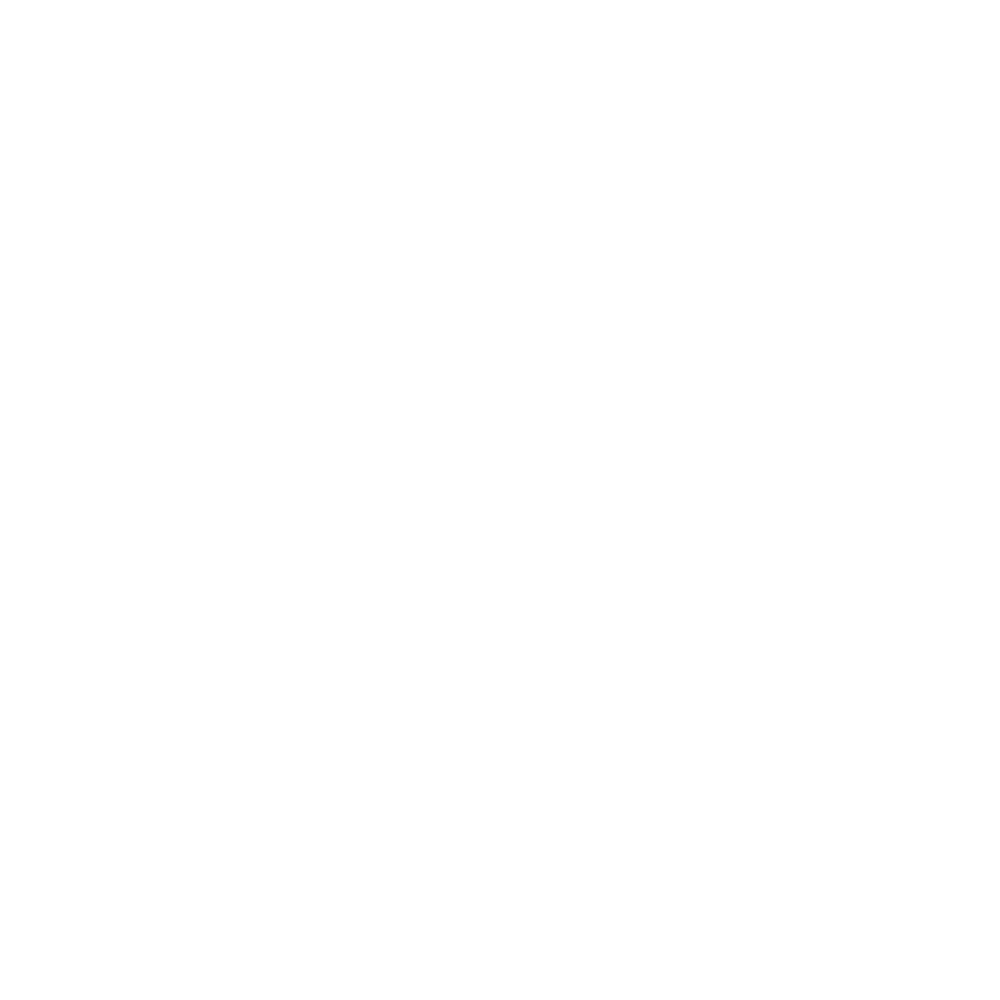

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


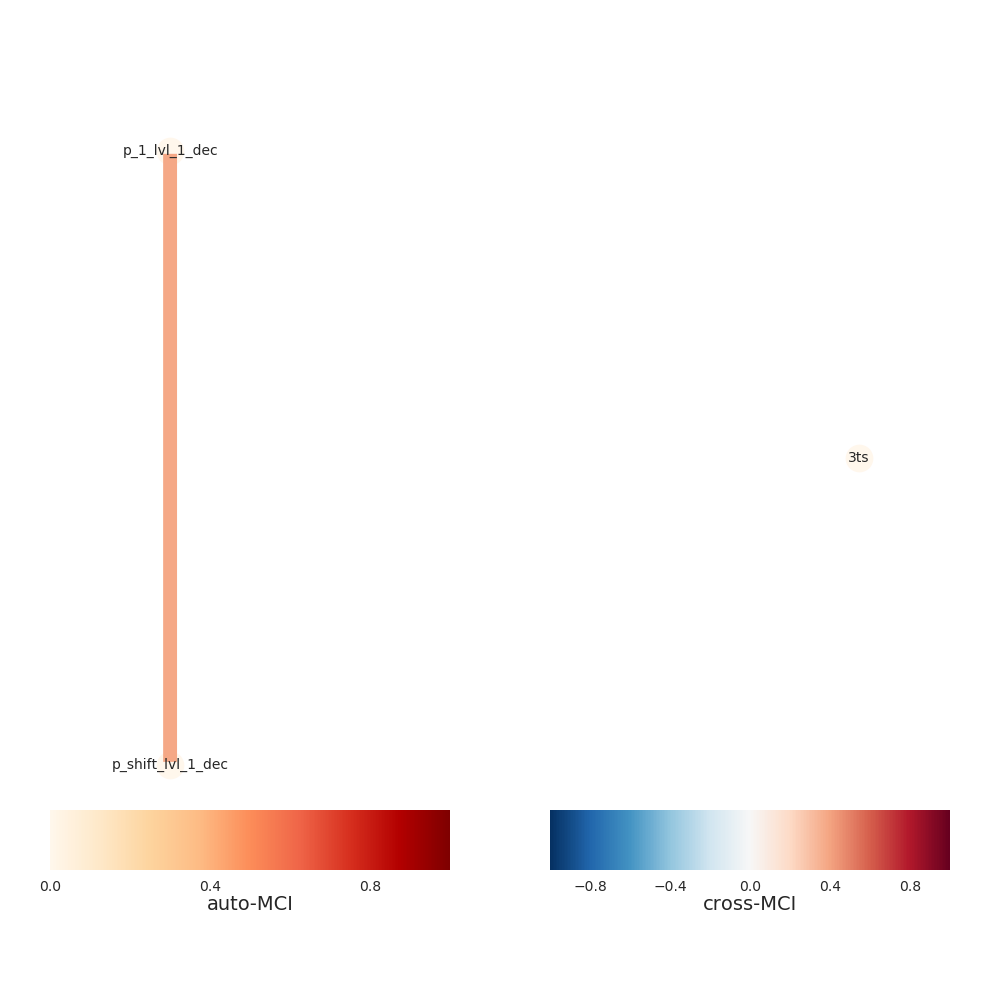

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


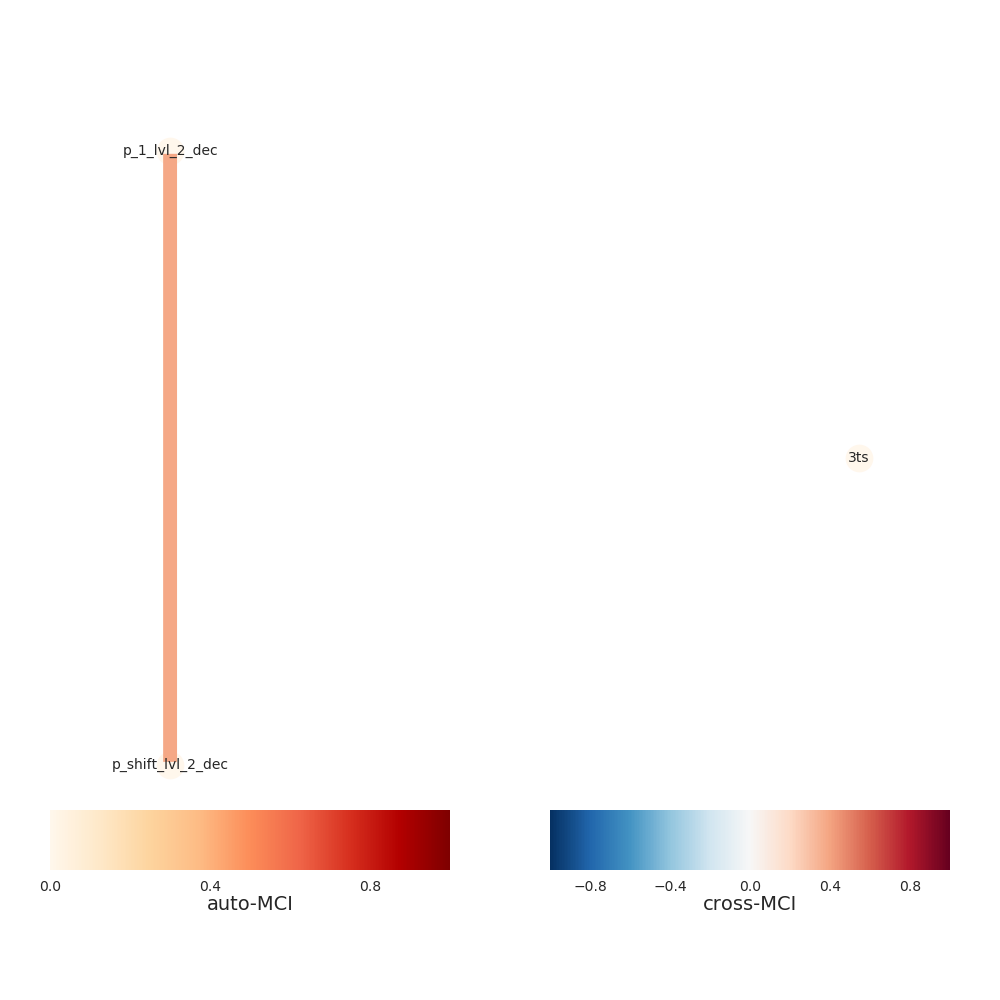

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


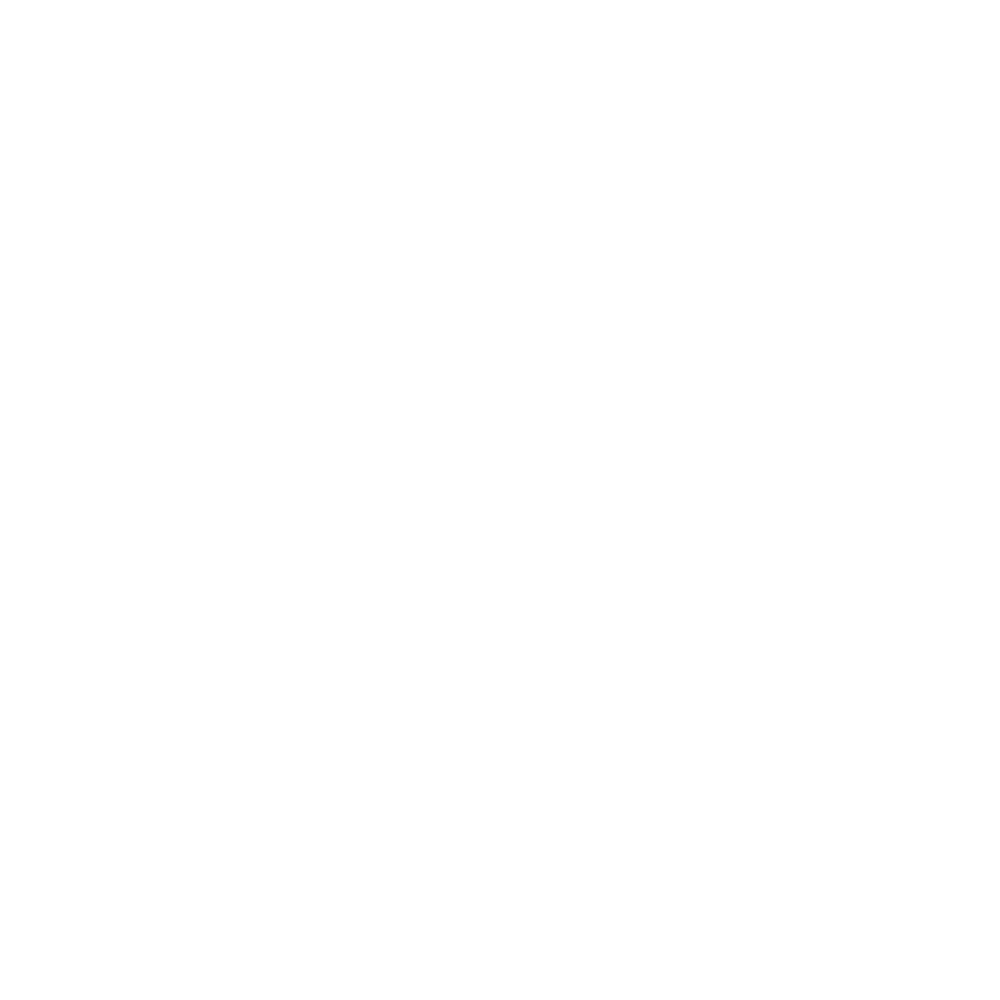

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


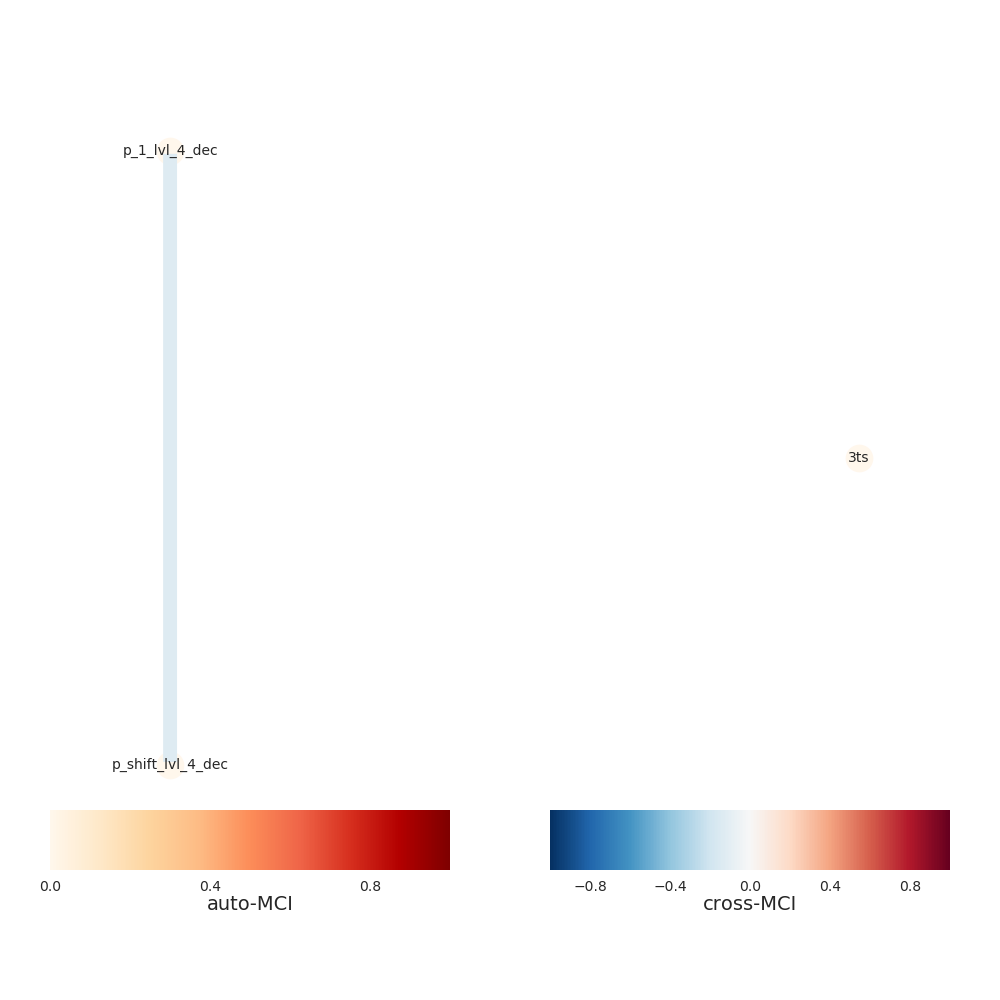

Progress causal inference - traintest set 100%
[INFO] Extracting level 9
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


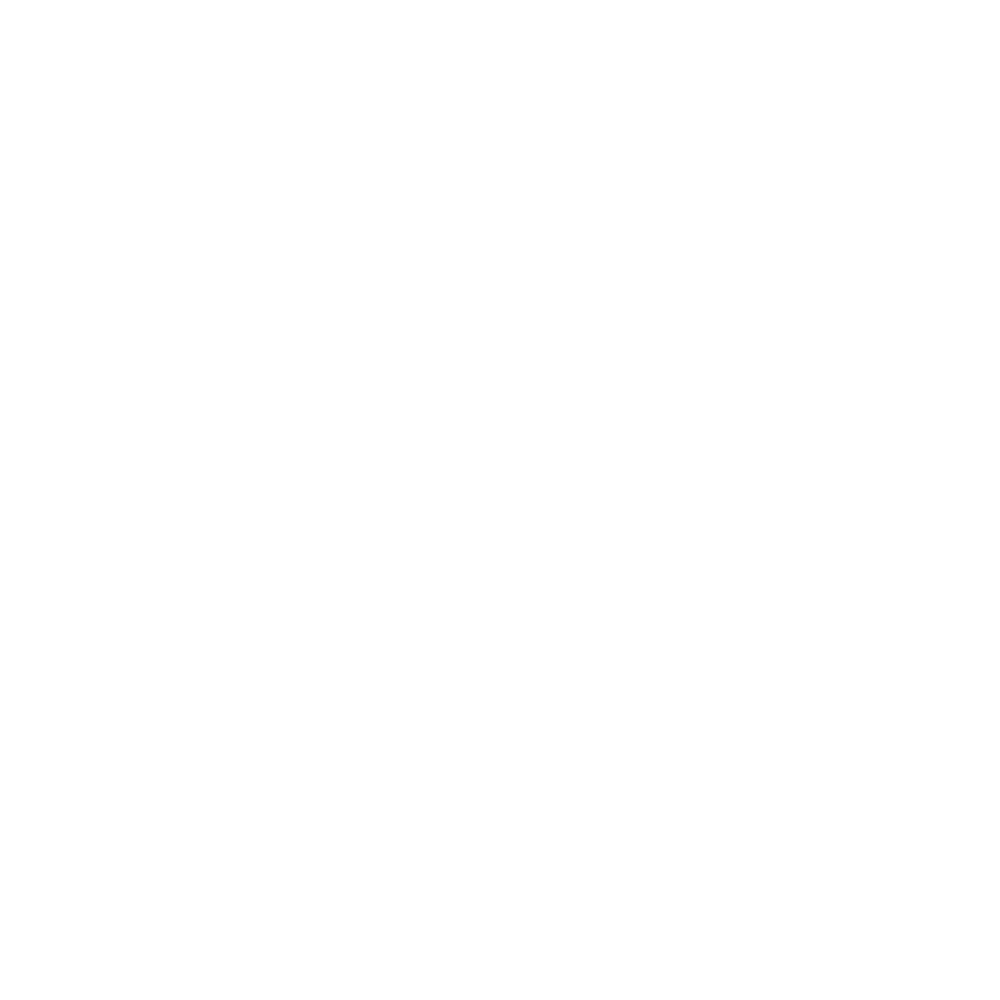

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


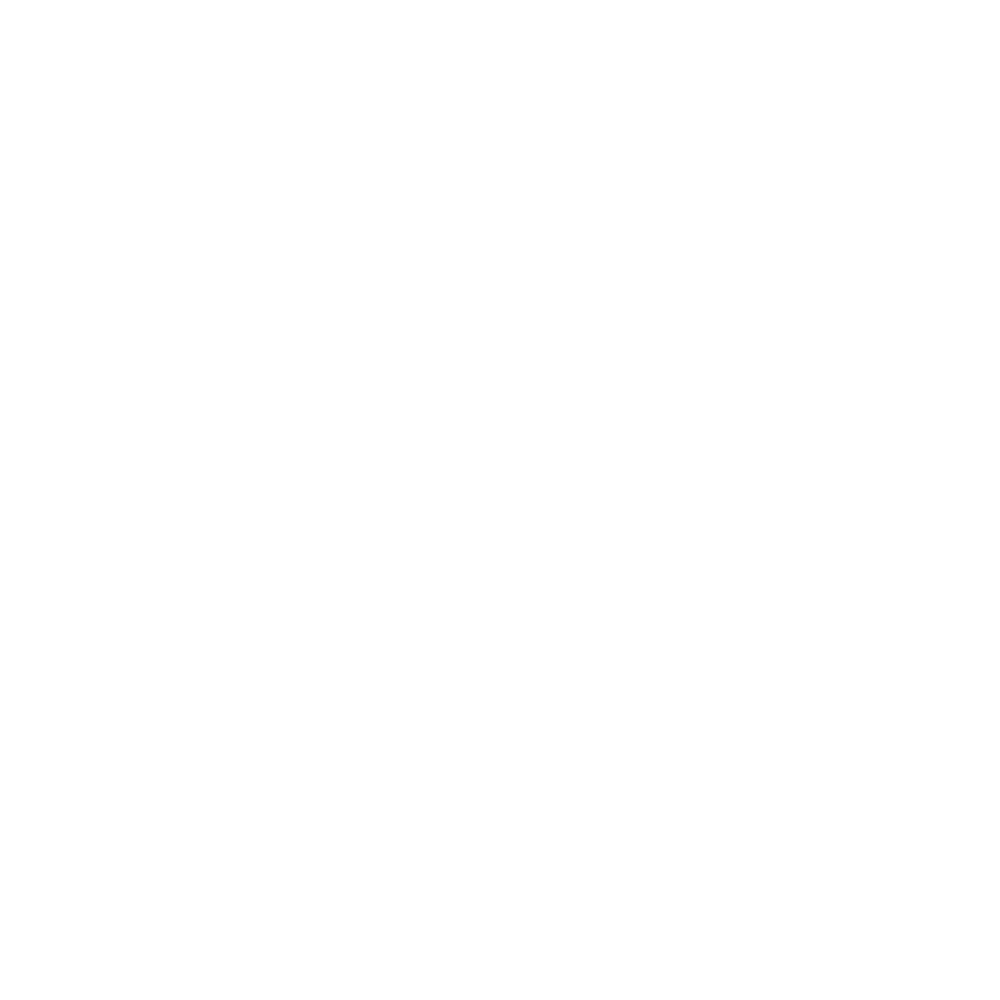

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


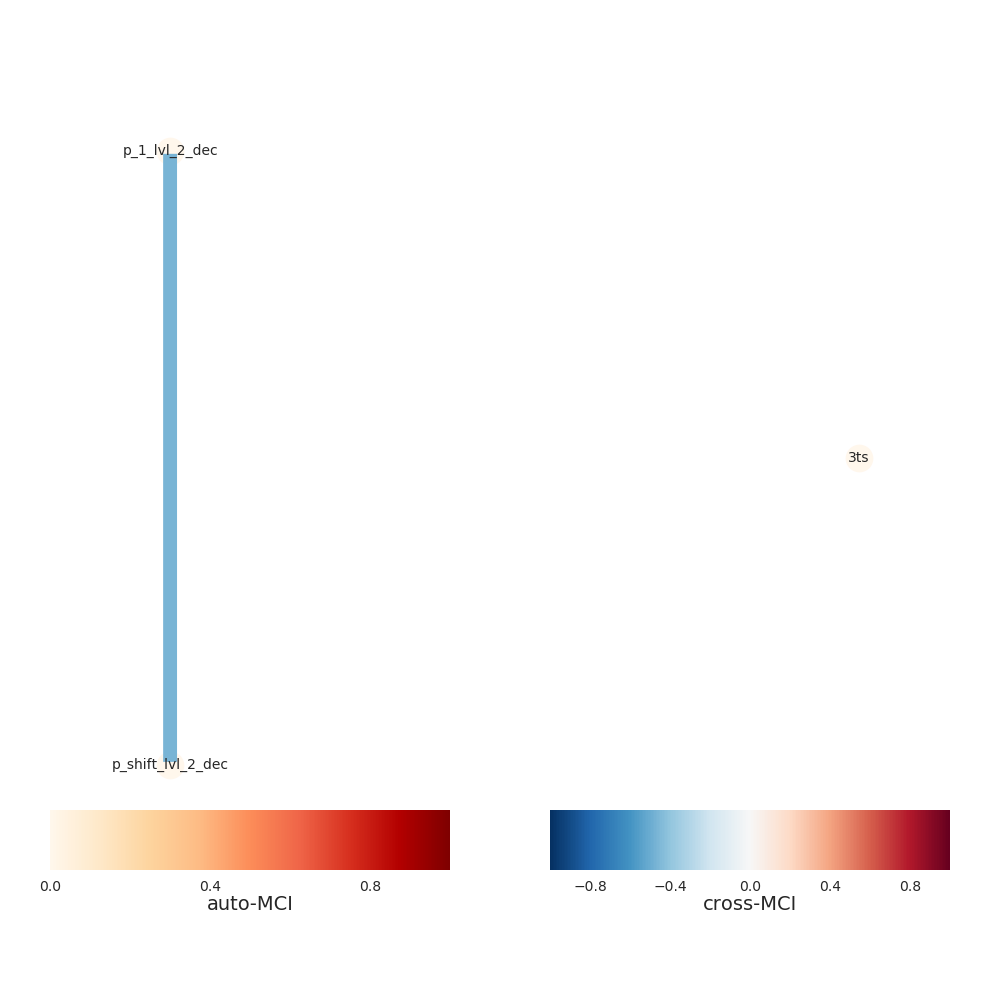

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


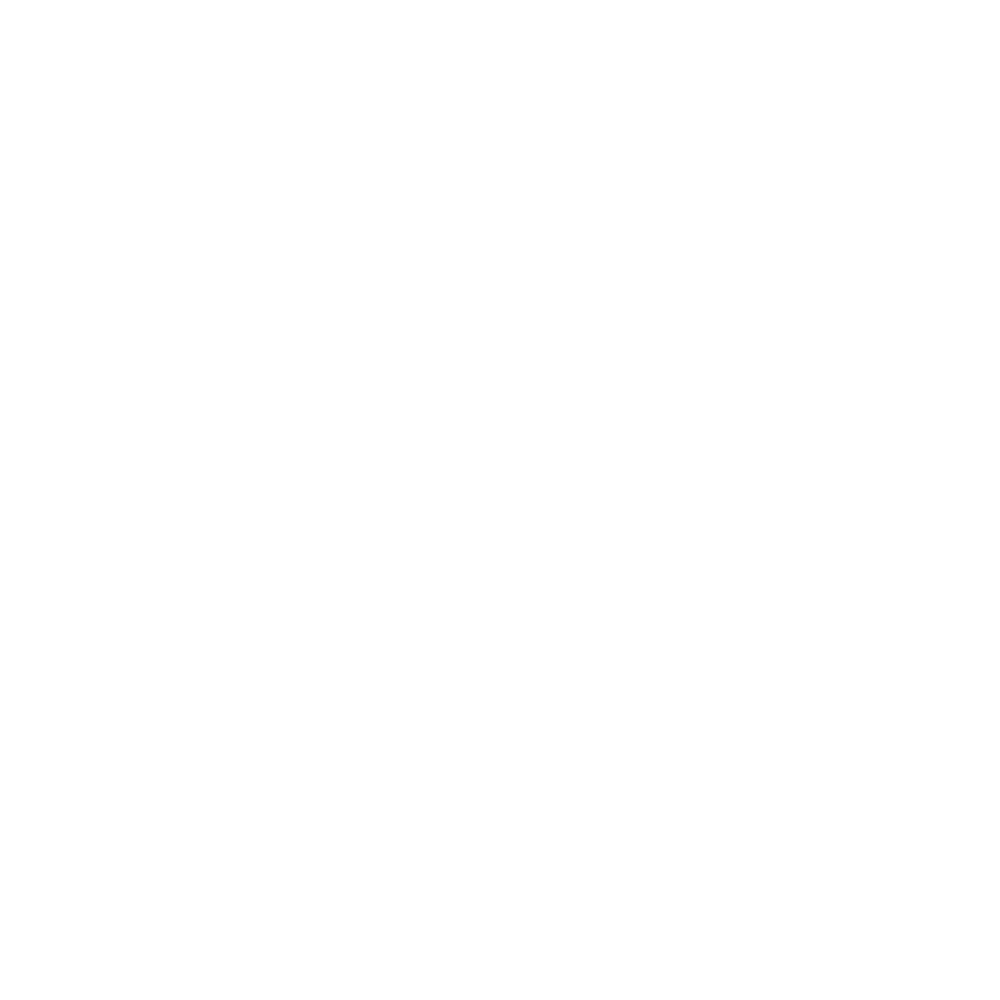

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


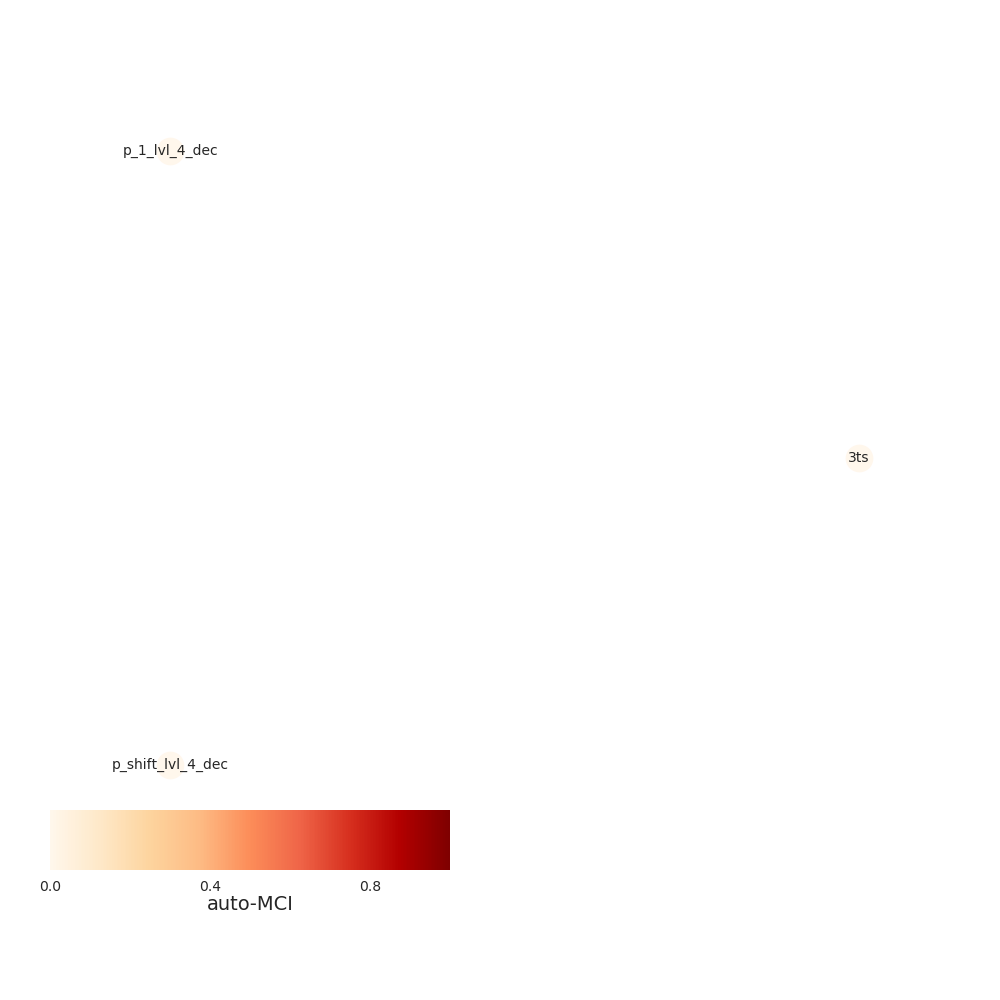

Progress causal inference - traintest set 100%
[INFO] Extracting level 10
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


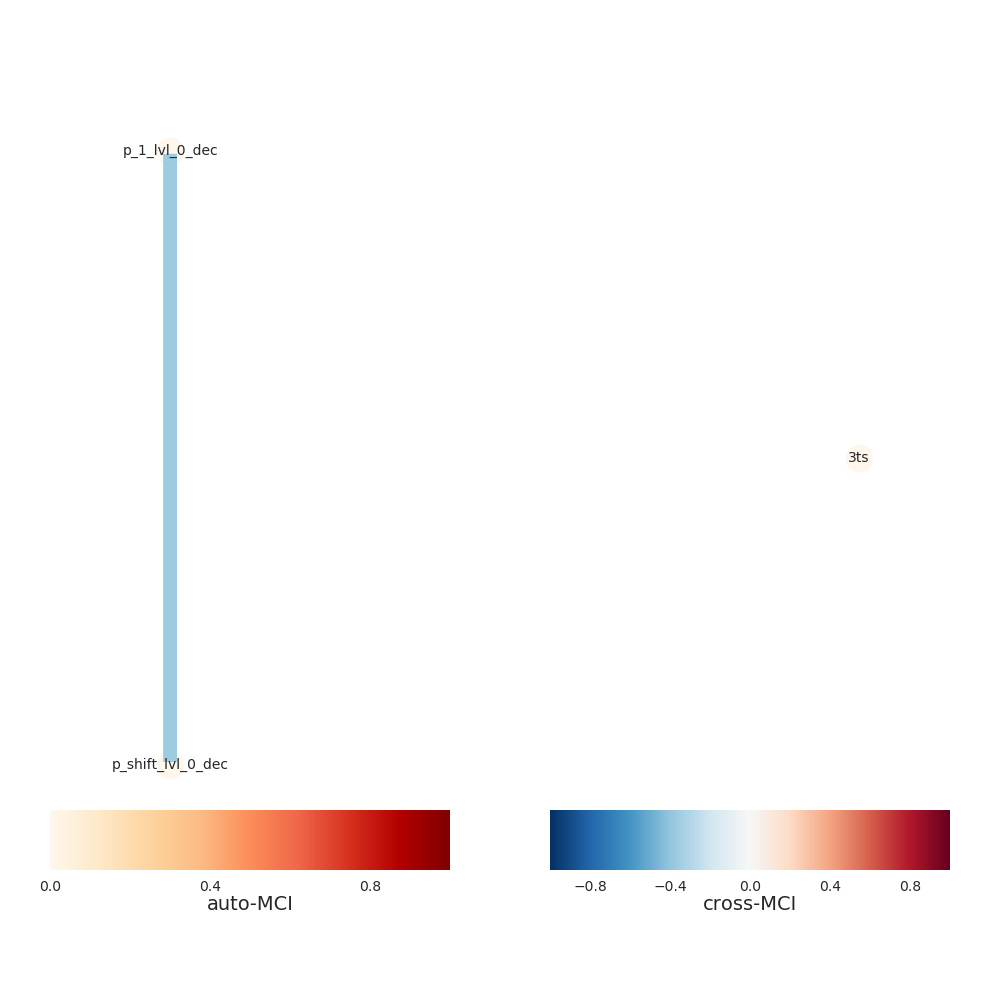

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


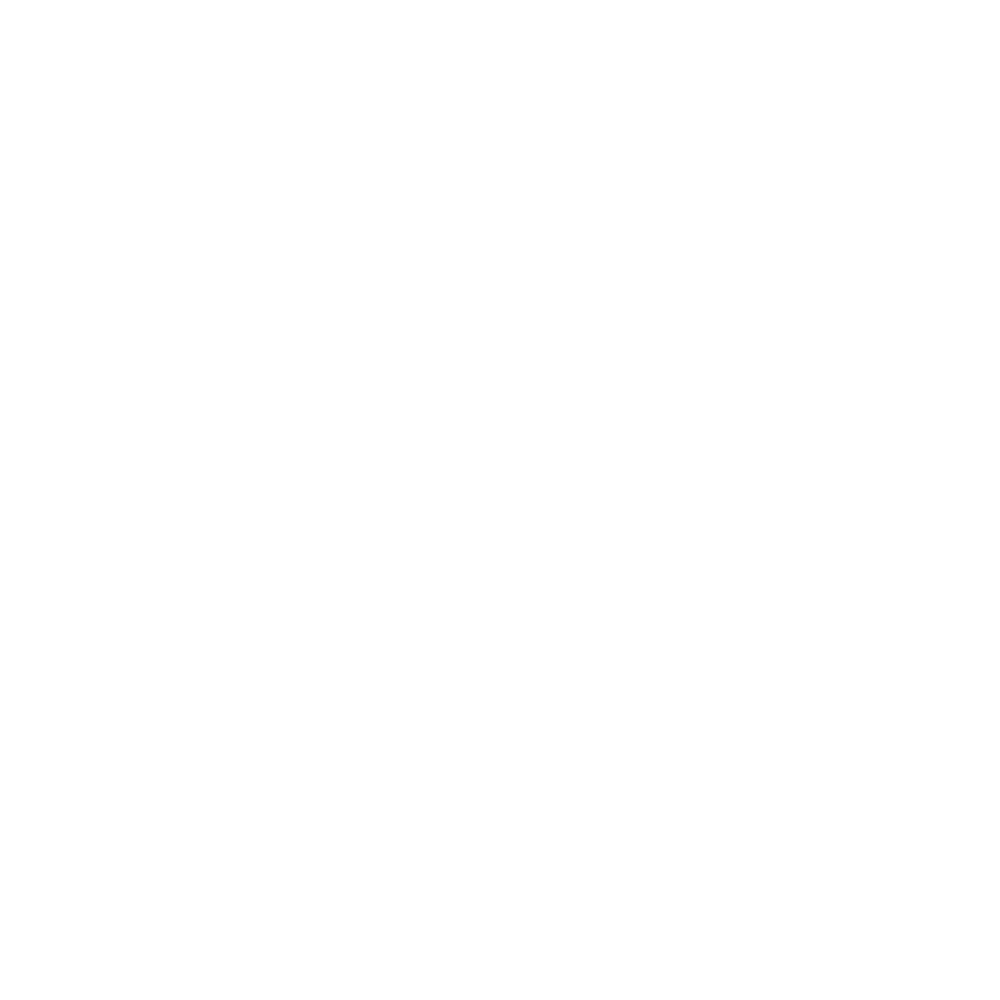

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


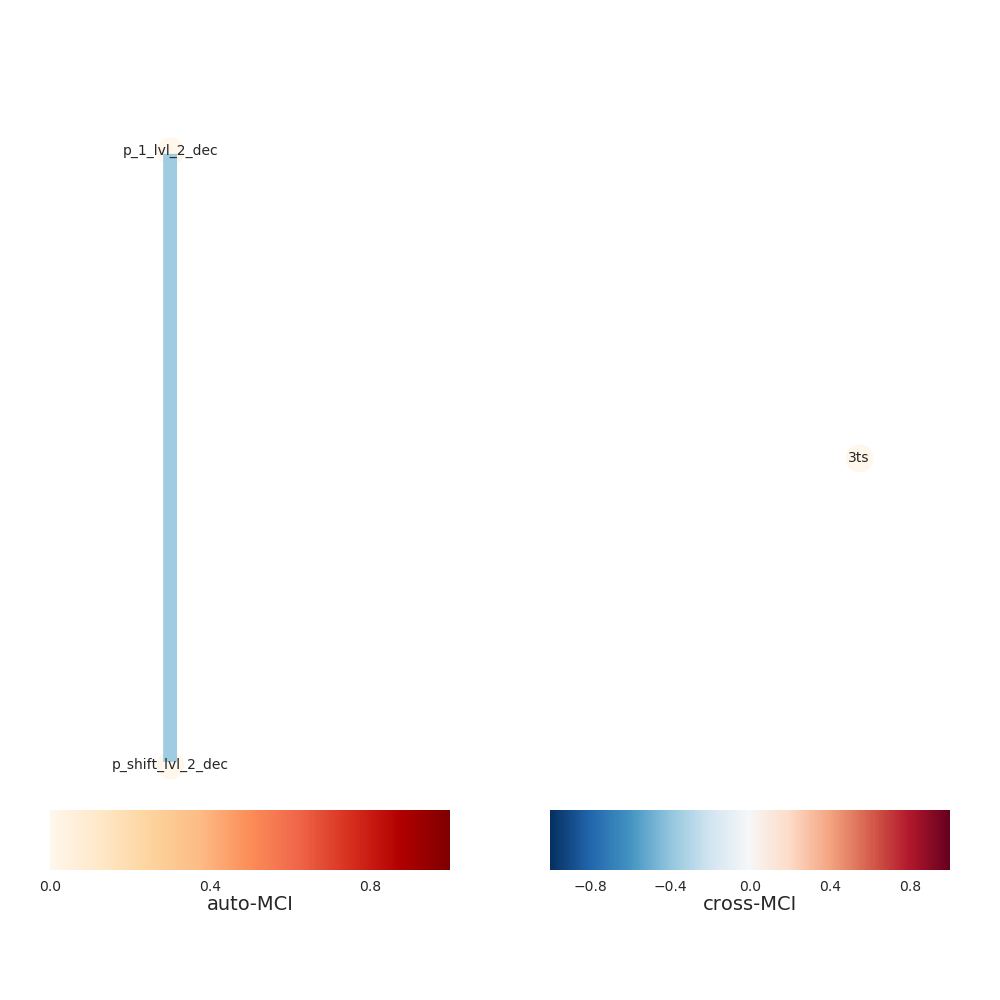

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


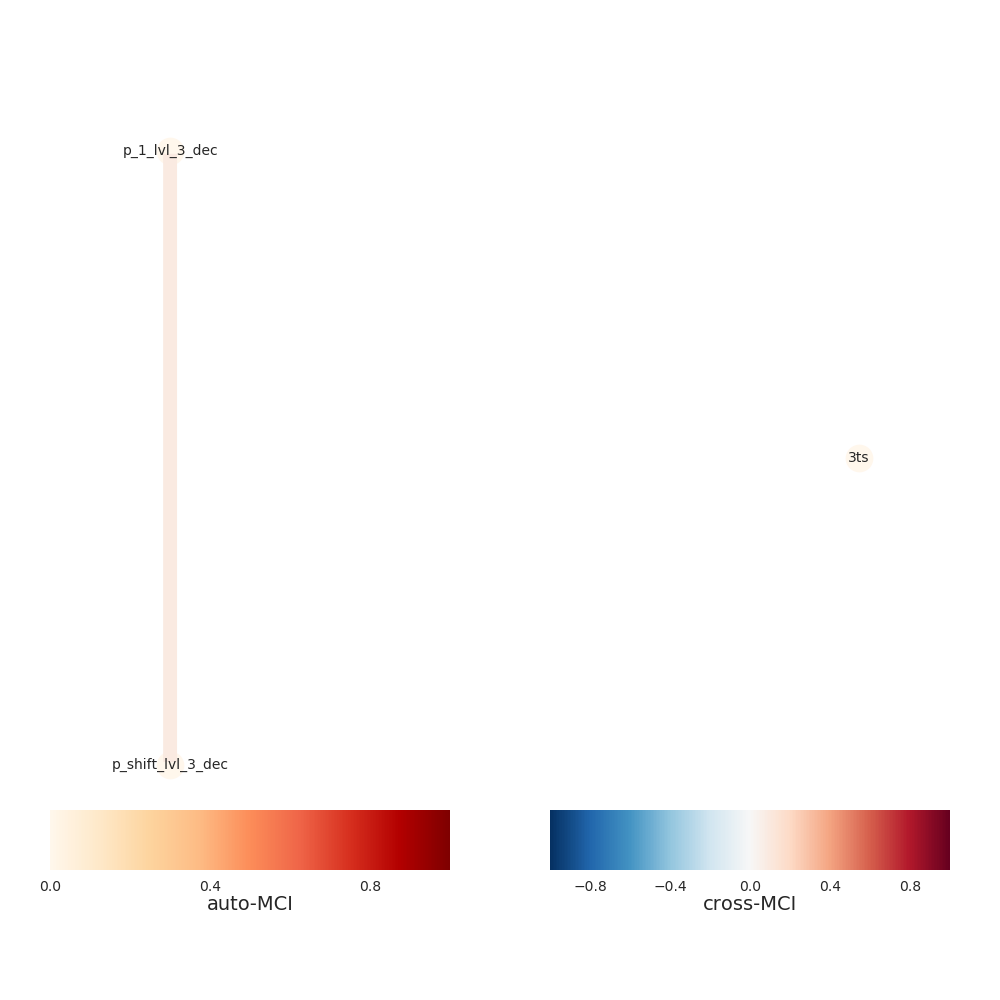

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


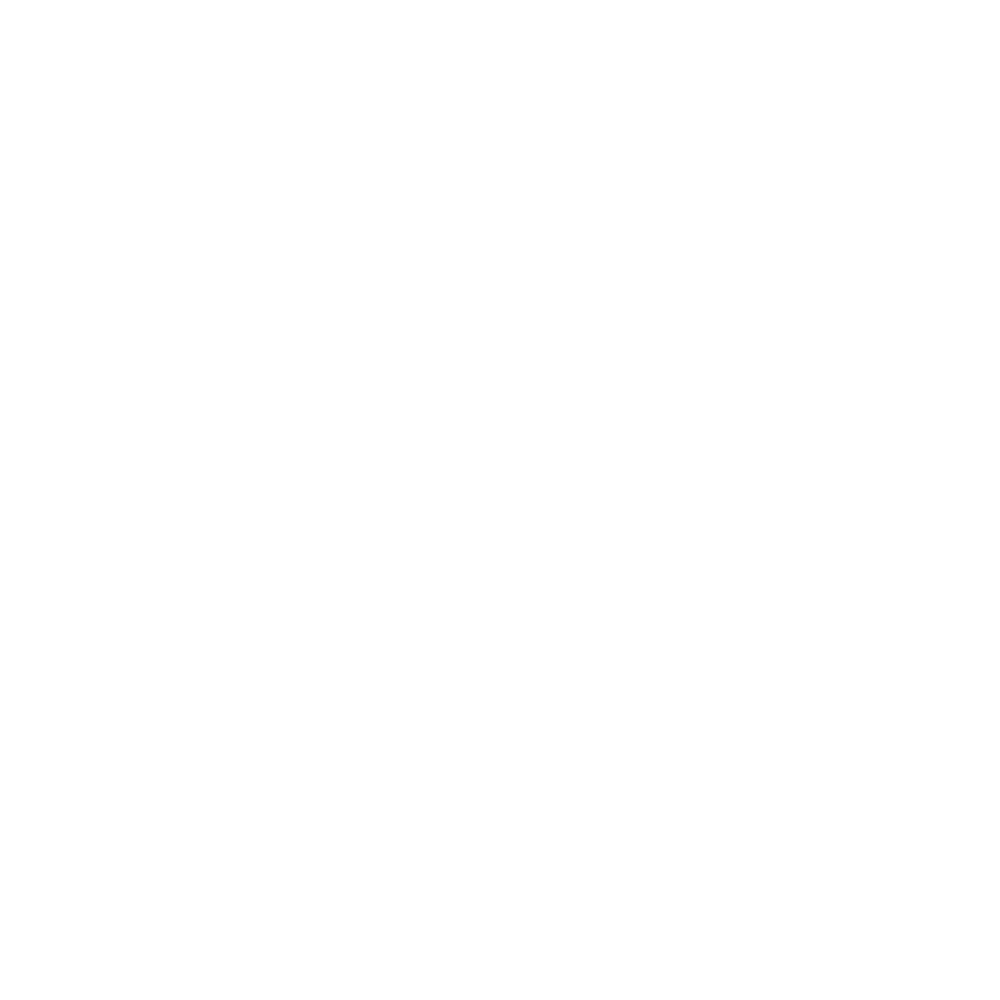

Progress causal inference - traintest set 100%
[INFO] Extracting level 11
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


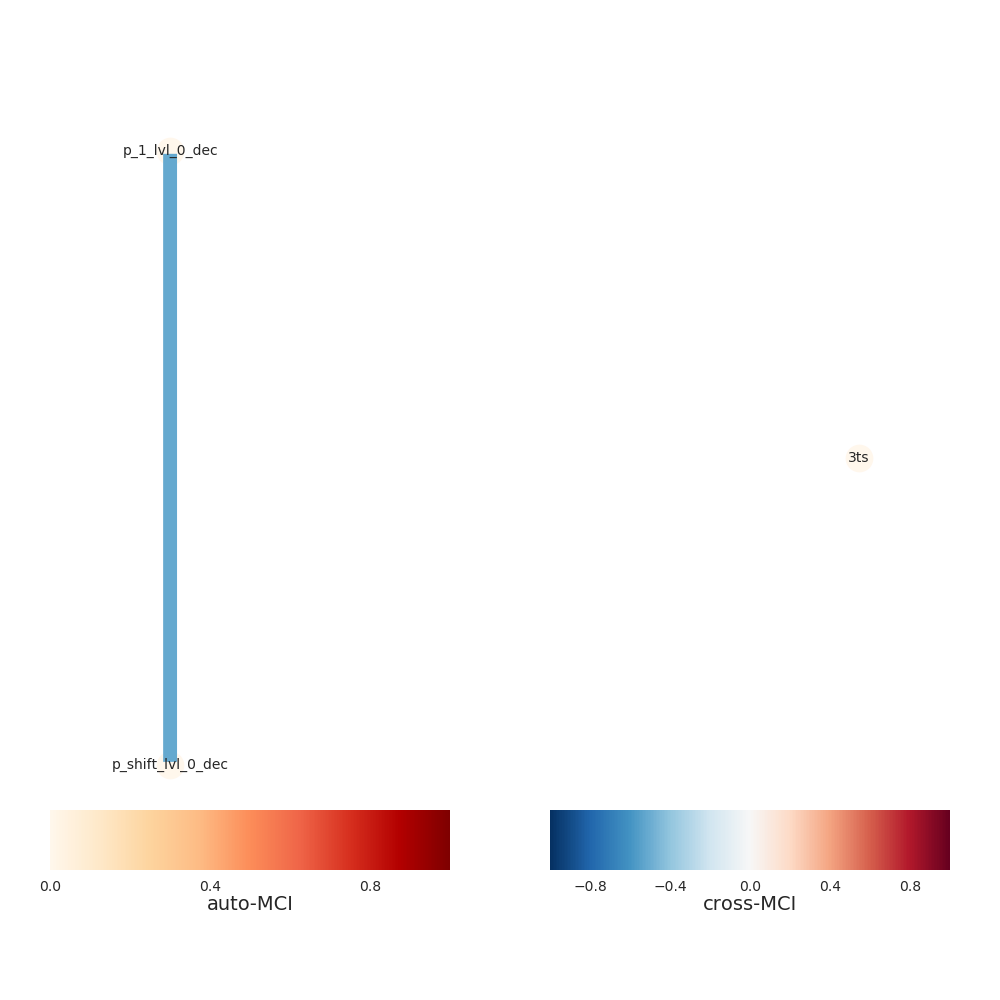

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


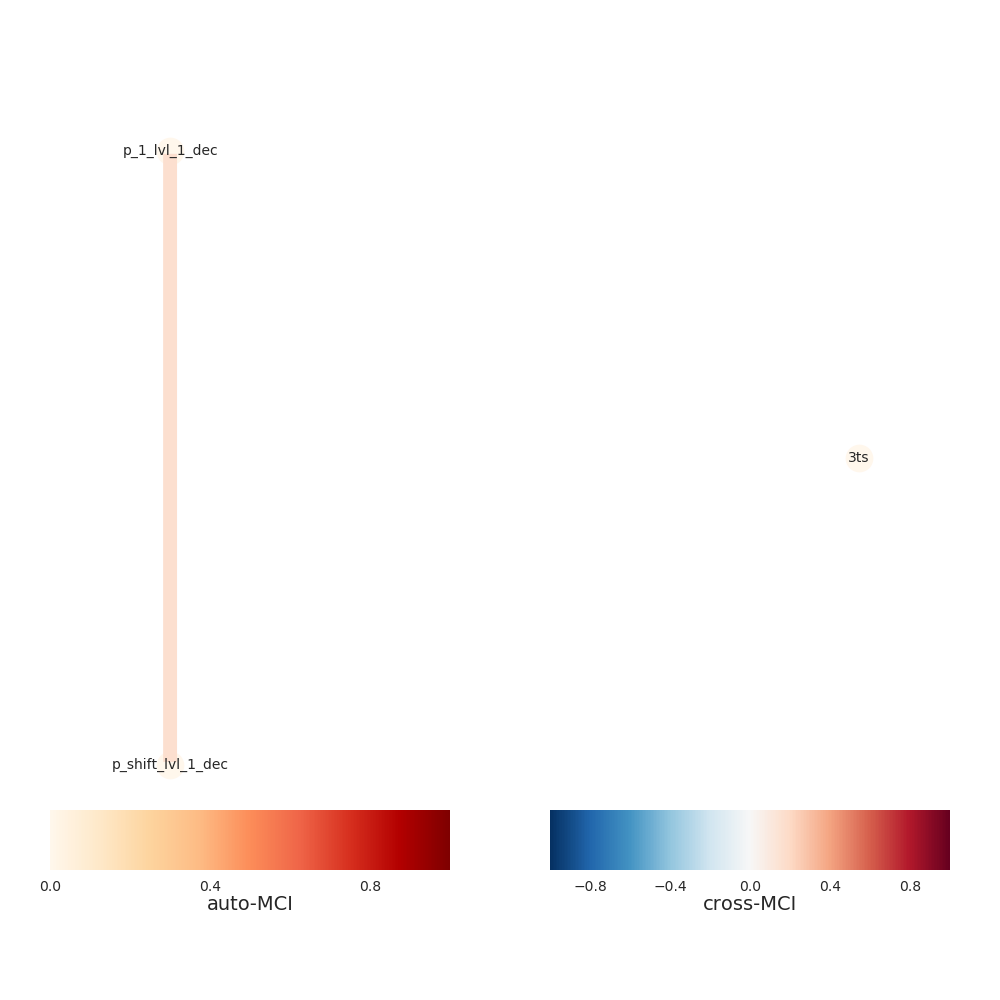

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


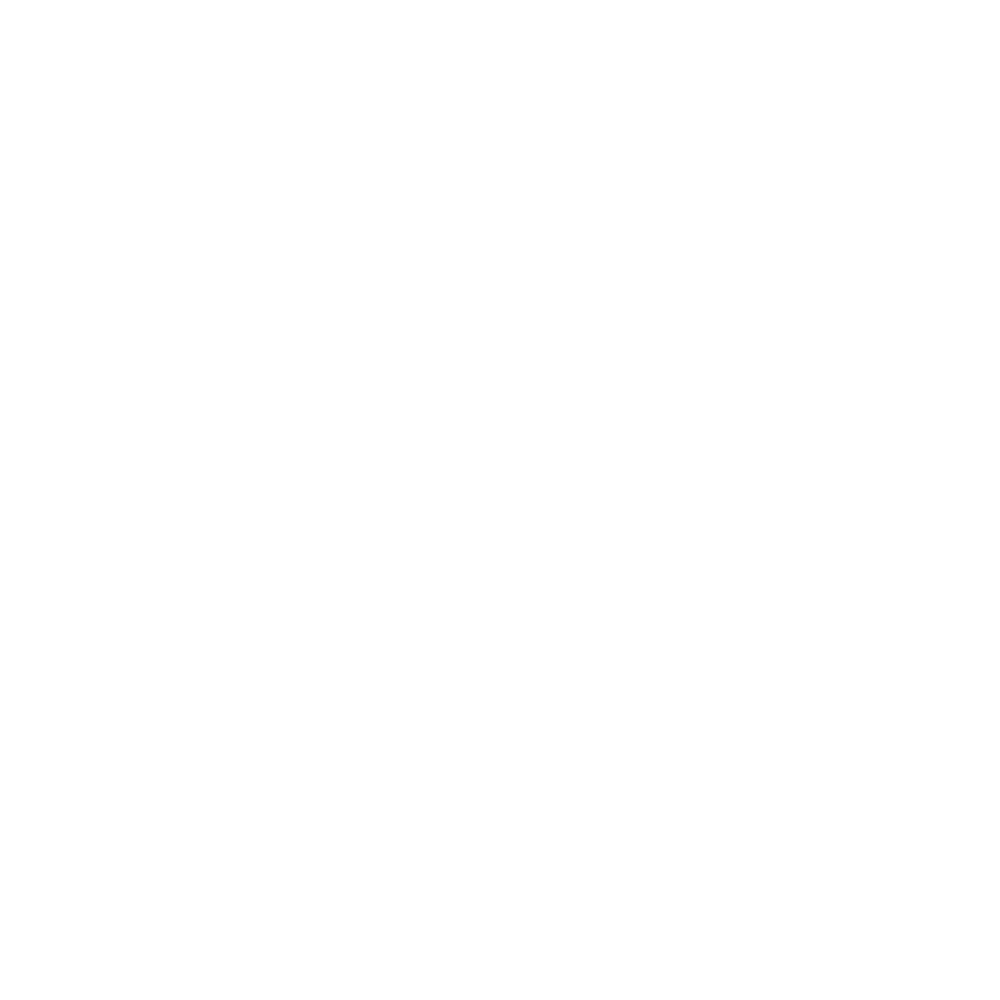

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


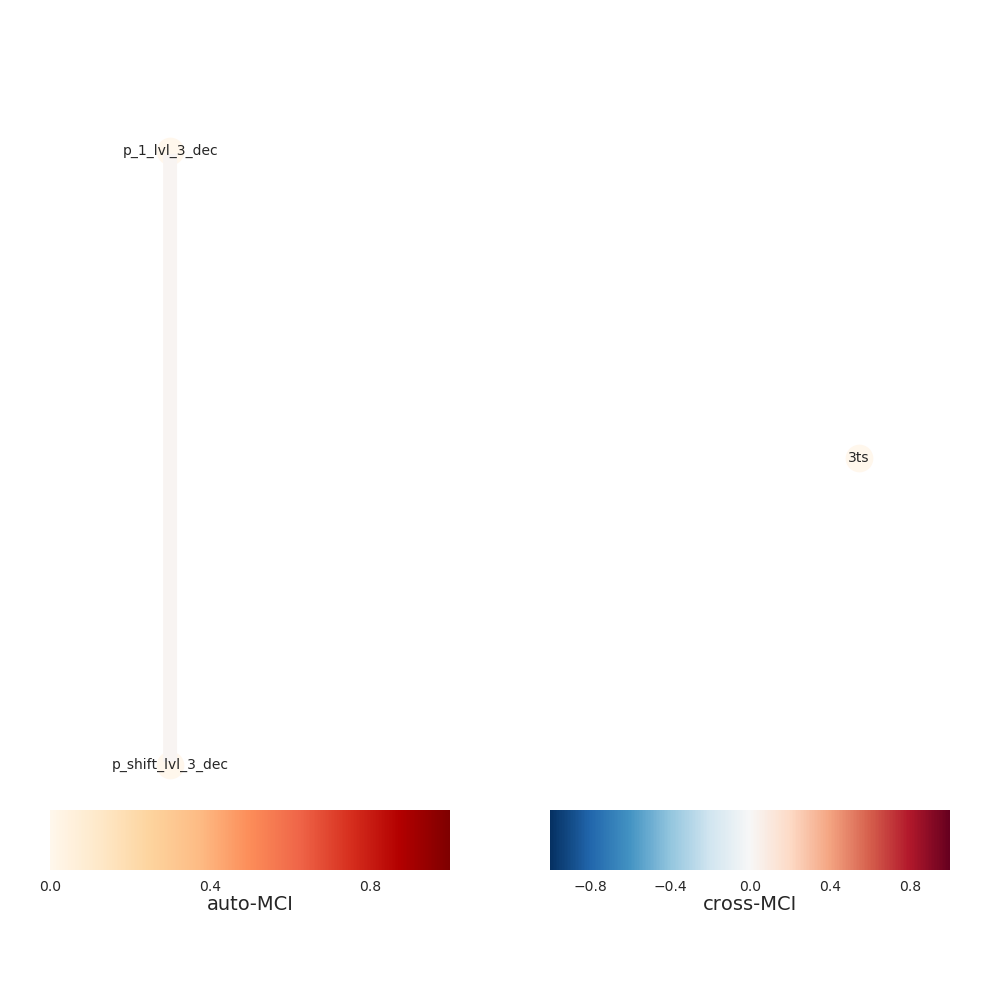

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


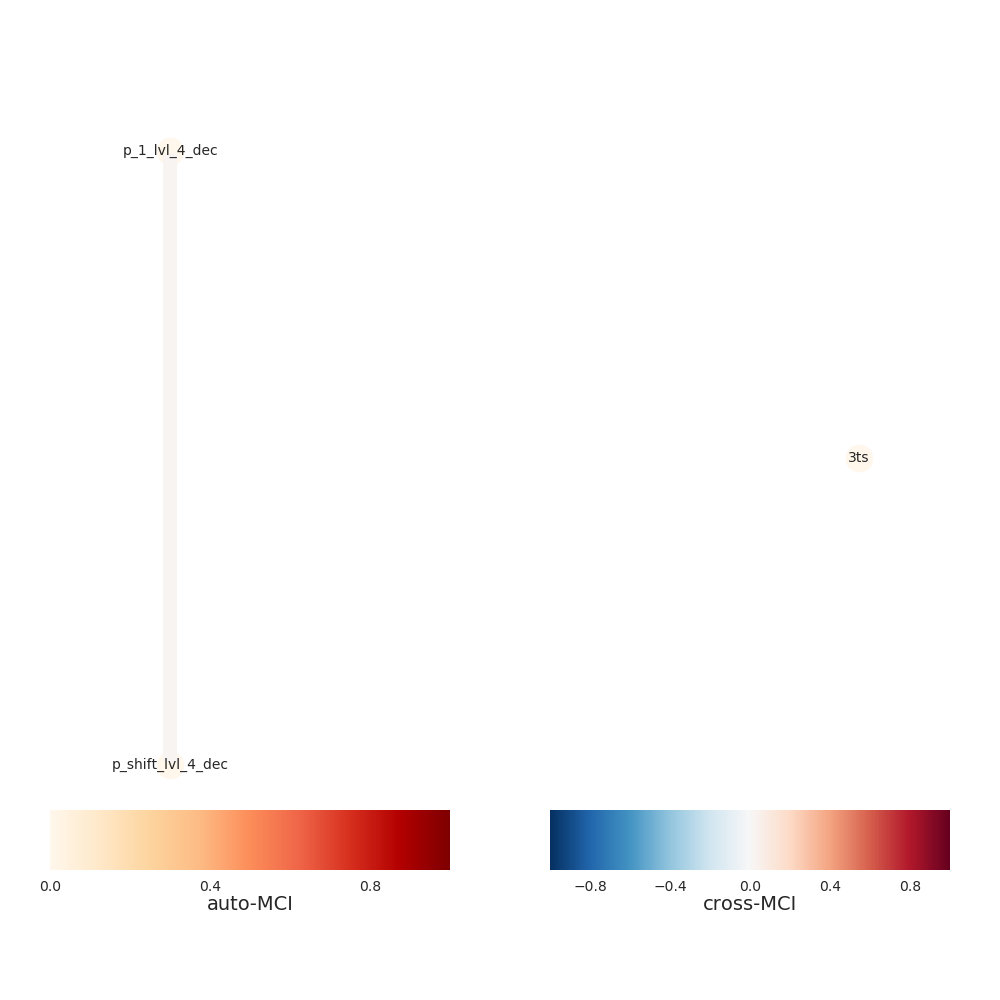

Progress causal inference - traintest set 100%

In [74]:
result_extra = run_experiment_levels(prepro_target, target_arr,rg, rg_index, peak_test=True,total_levels=levels)

In [75]:
mcs, _ = result_extra

<IPython.core.display.Javascript object>


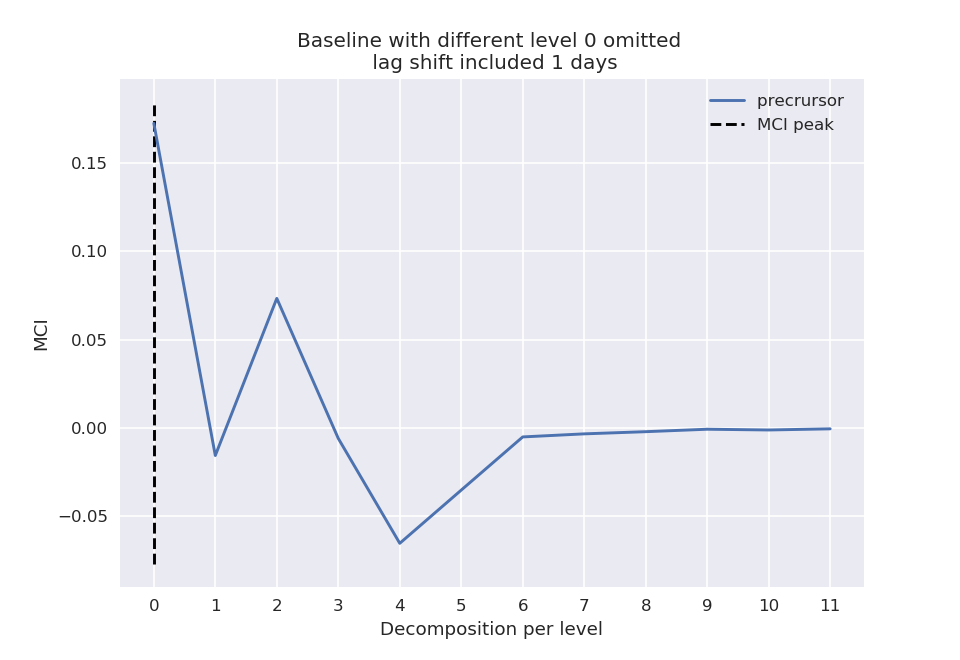

<IPython.core.display.Javascript object>


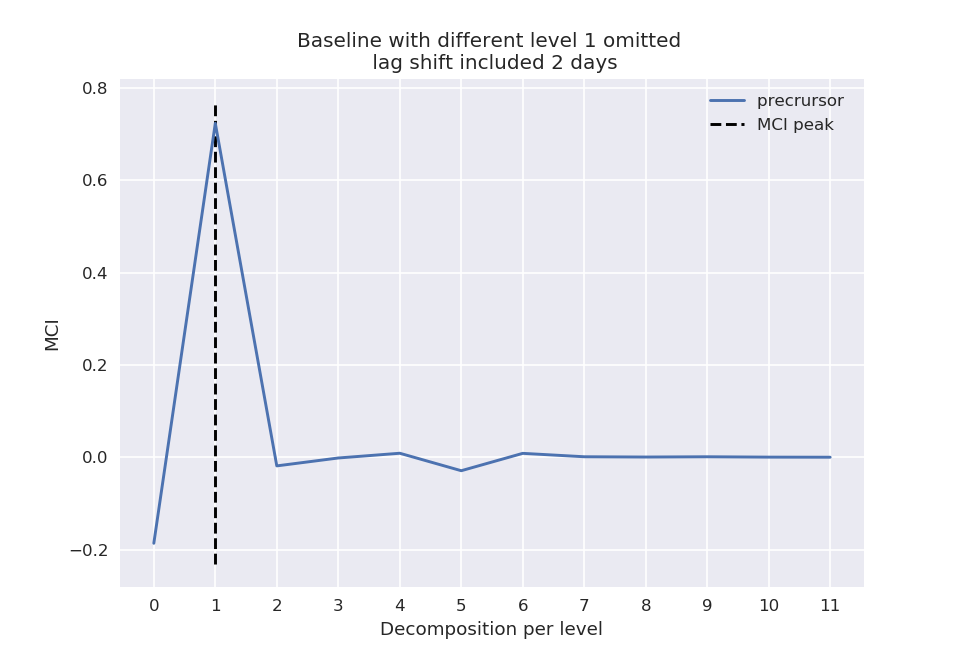

<IPython.core.display.Javascript object>


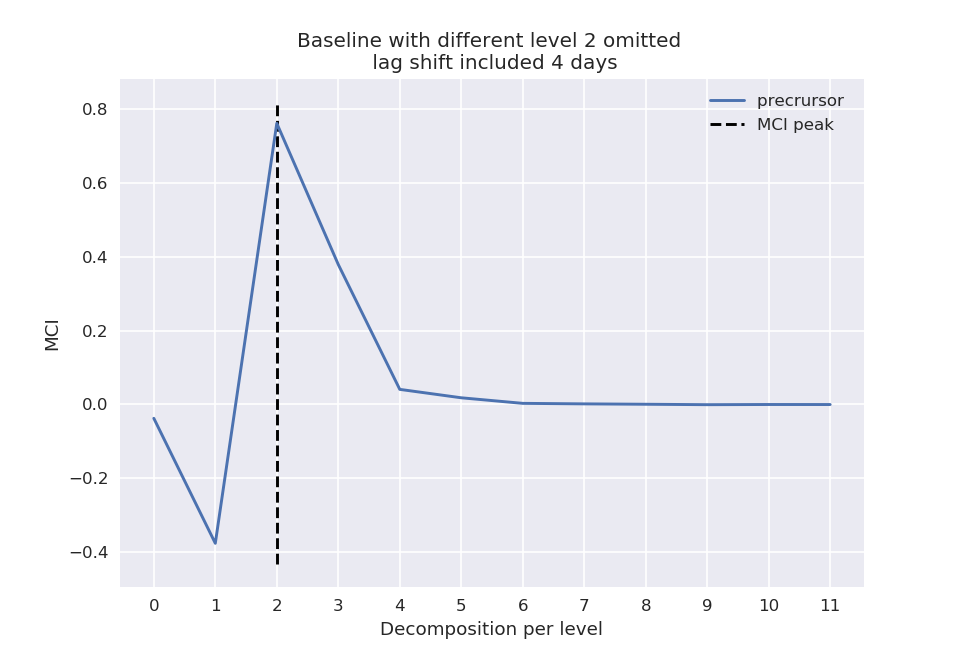

<IPython.core.display.Javascript object>


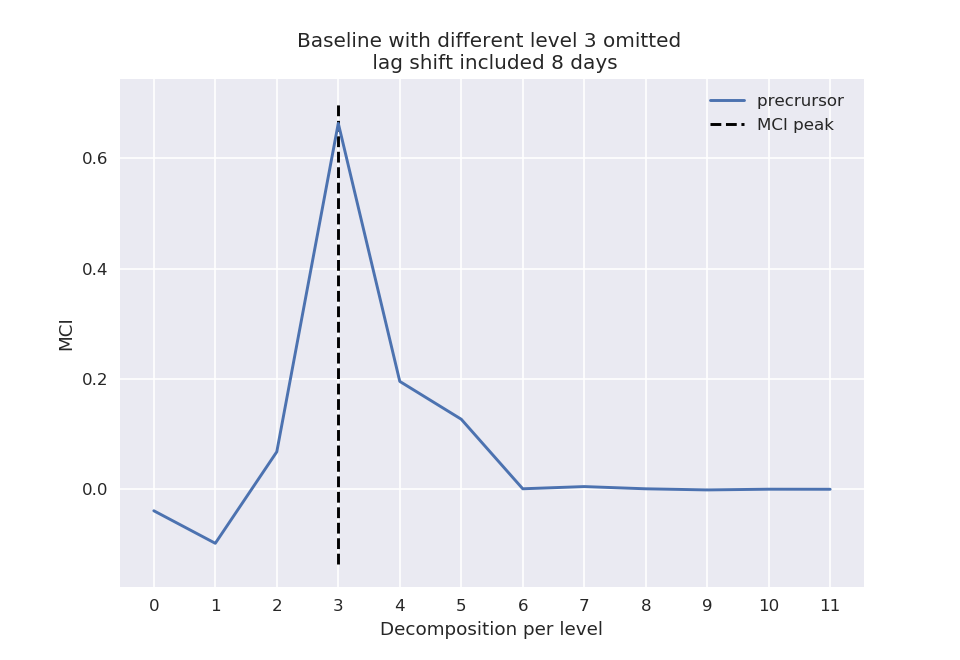

<IPython.core.display.Javascript object>


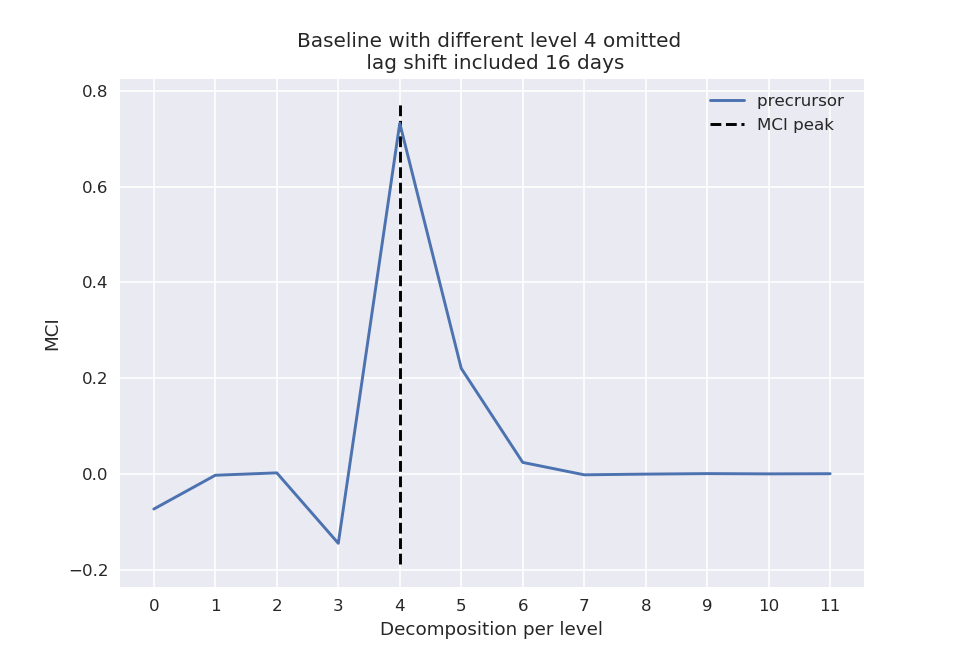

<IPython.core.display.Javascript object>


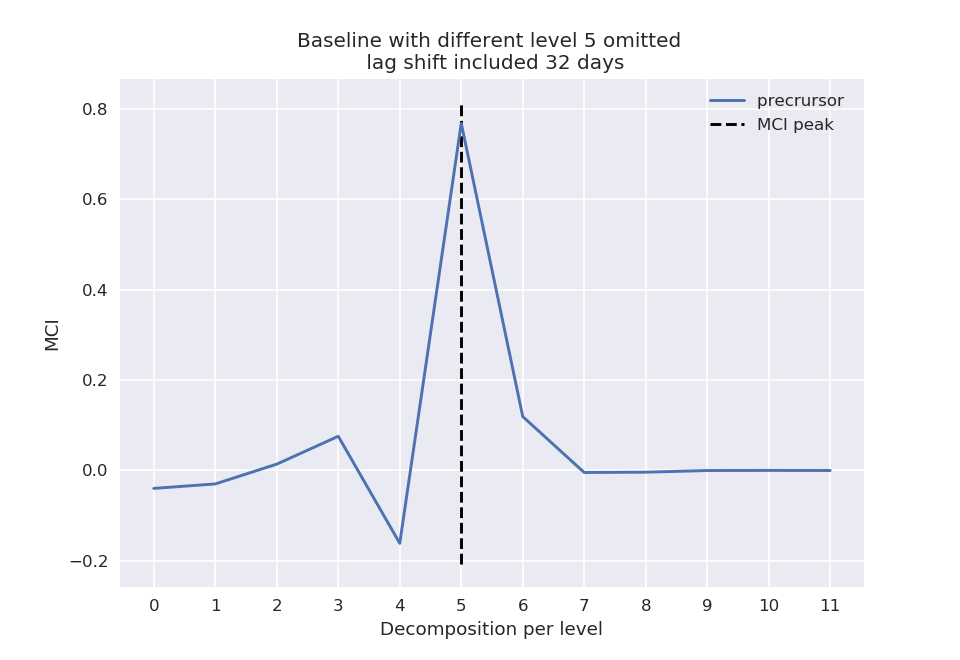

<IPython.core.display.Javascript object>


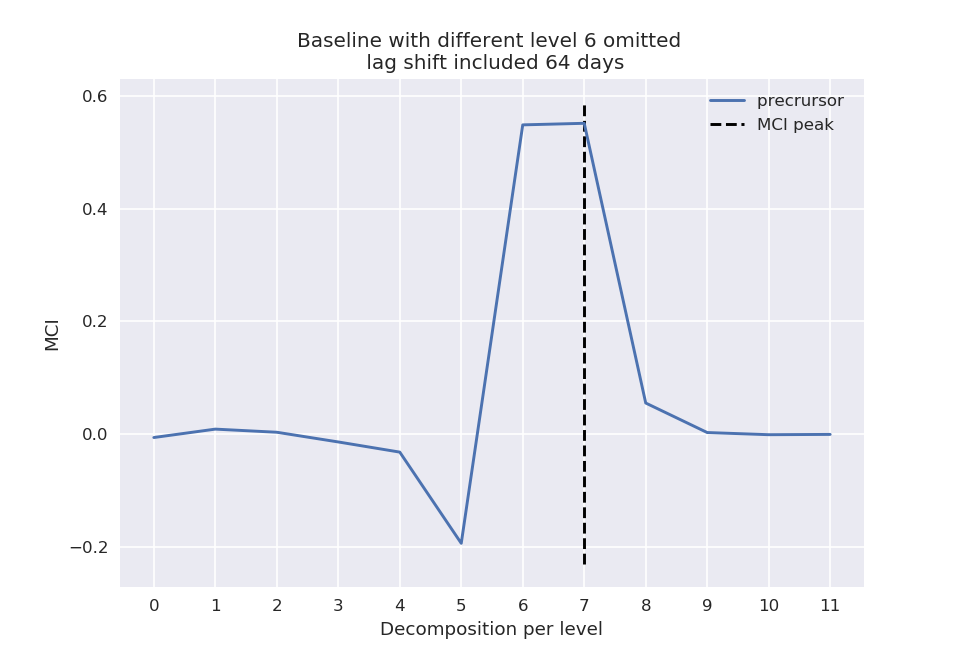

<IPython.core.display.Javascript object>


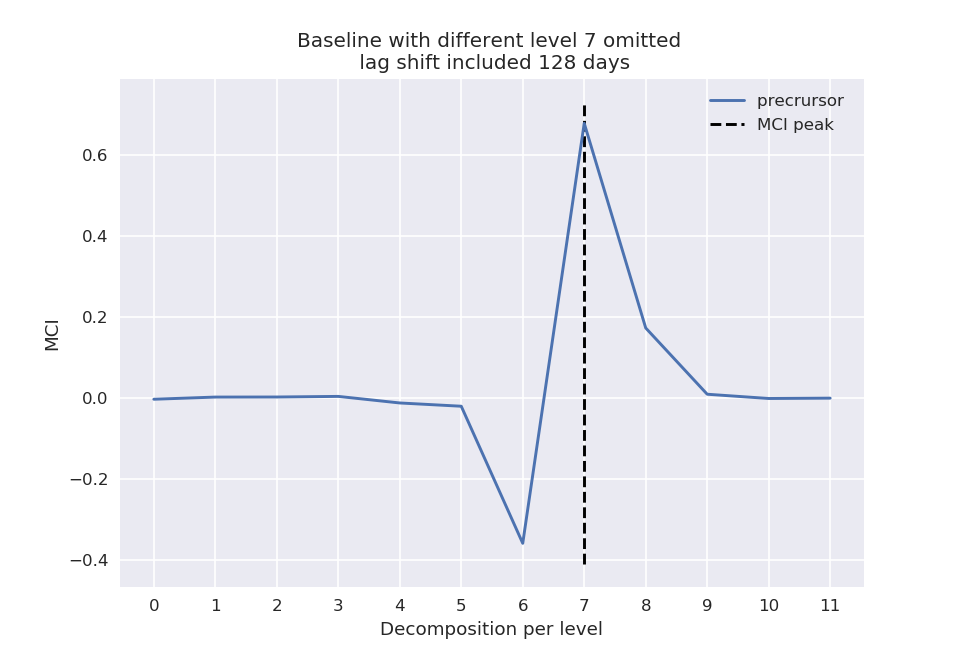

<IPython.core.display.Javascript object>


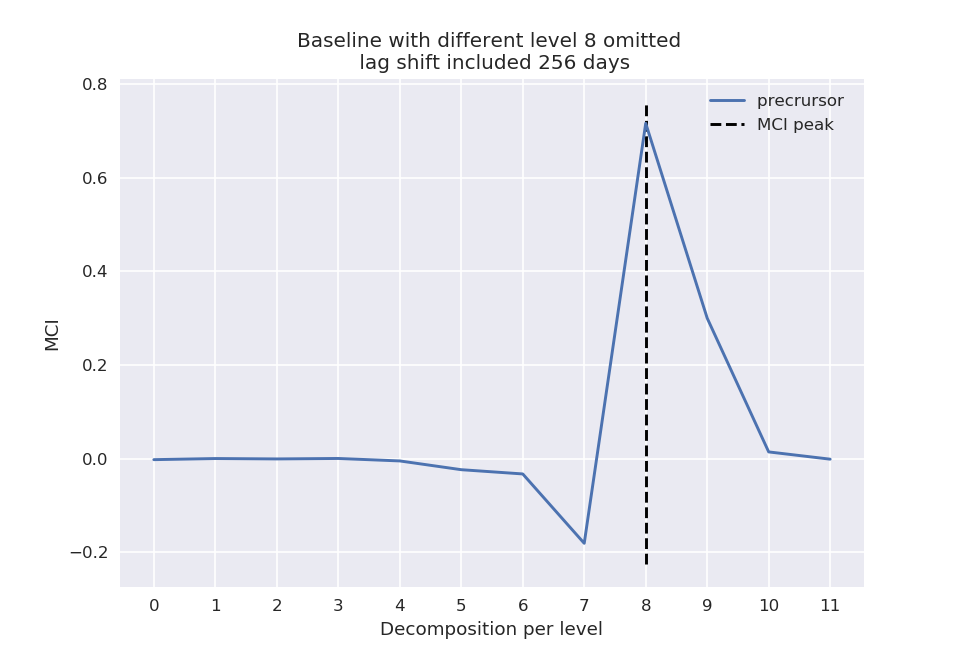

<IPython.core.display.Javascript object>


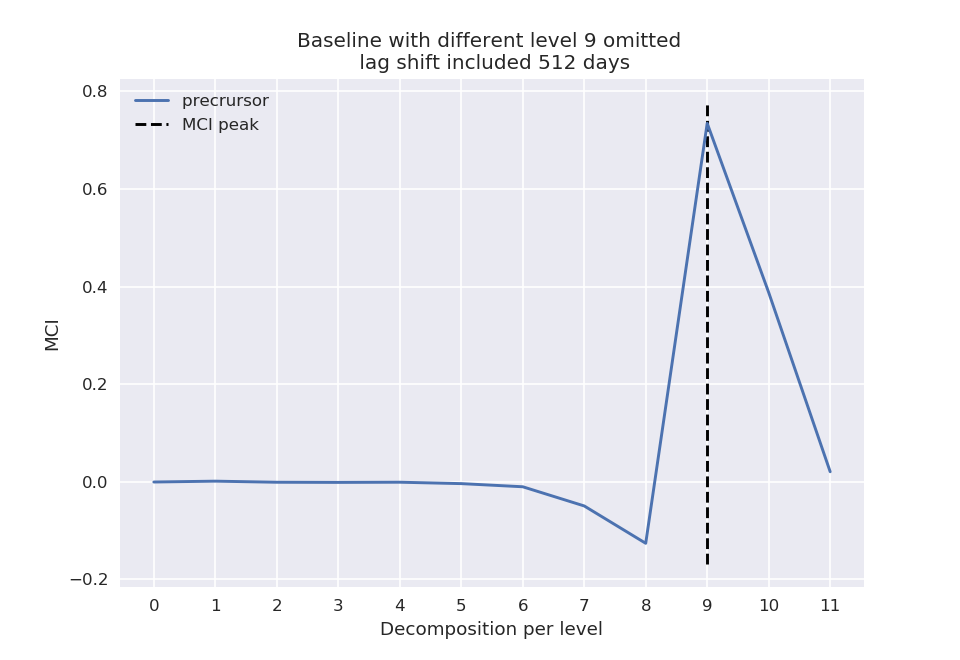

<IPython.core.display.Javascript object>


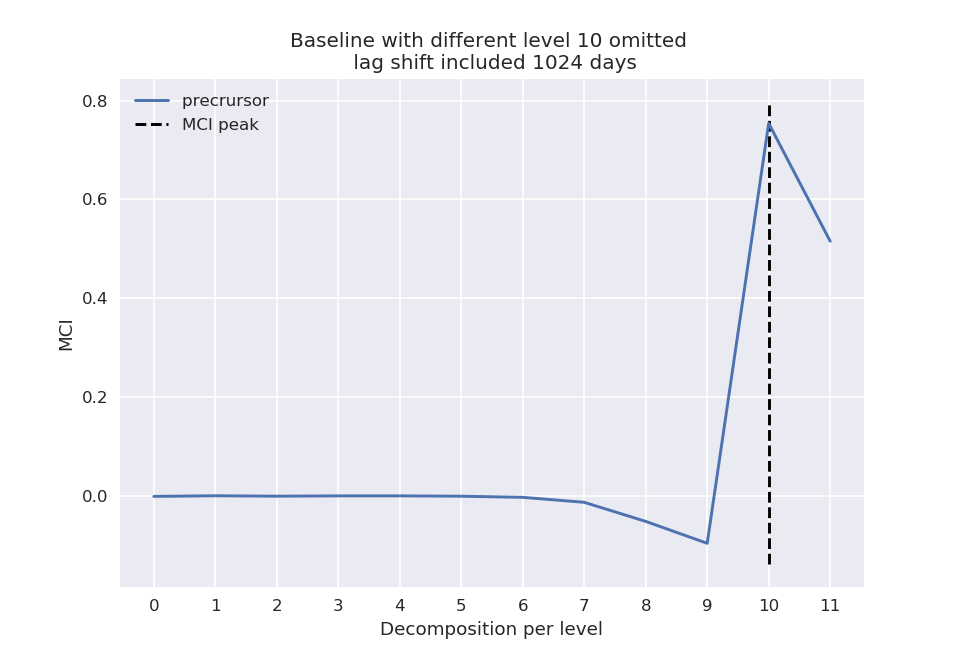

<IPython.core.display.Javascript object>


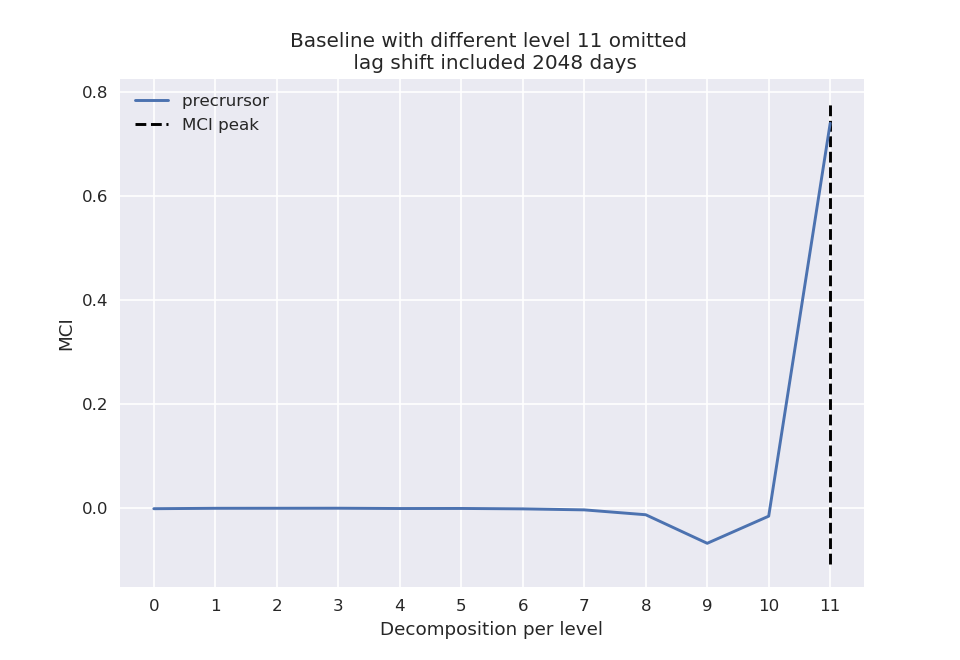

In [80]:
for i, peak in enumerate(mcs):
    if abs(len(mcs) - len(peak)) == 1:
        plot_mci_pred_relation(cA=range(len(mcs)-1), prec_lag=peak, path=' ', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days', show_level=True, savefig=False)
    else:
        plot_mci_pred_relation(cA=range(len(mcs)), prec_lag=peak, path=' ', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days', show_level=True, savefig=False)

### Run experiment with wavelet decomposition on yprime incorporate lags of target, prec as an extra column


[INFO] Extracting level 0
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


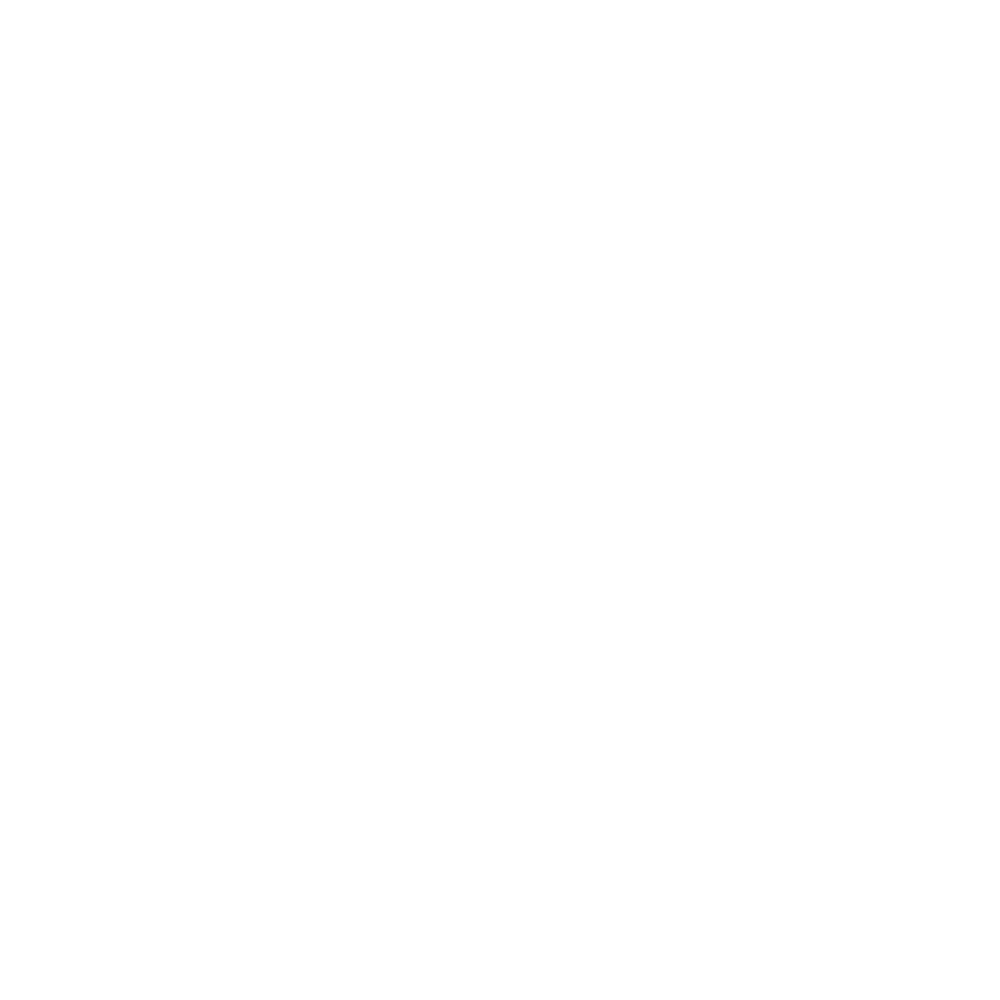

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


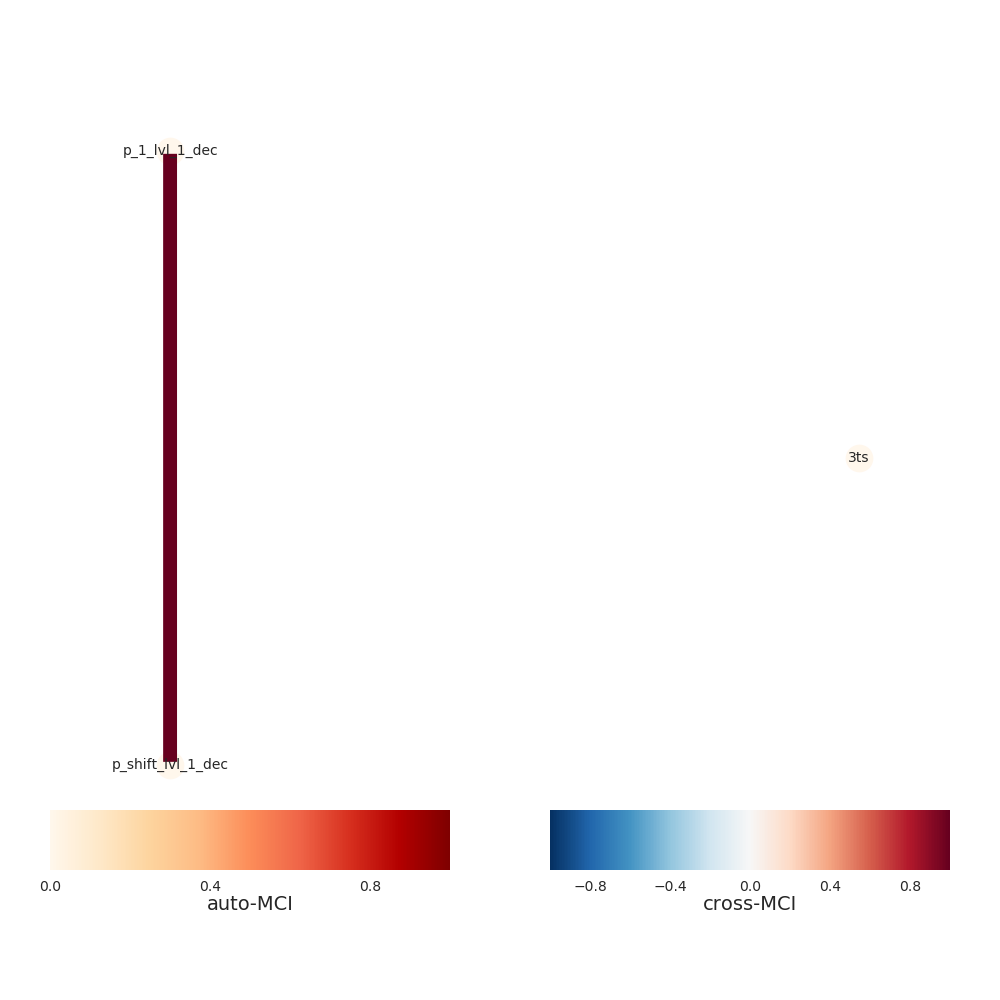

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


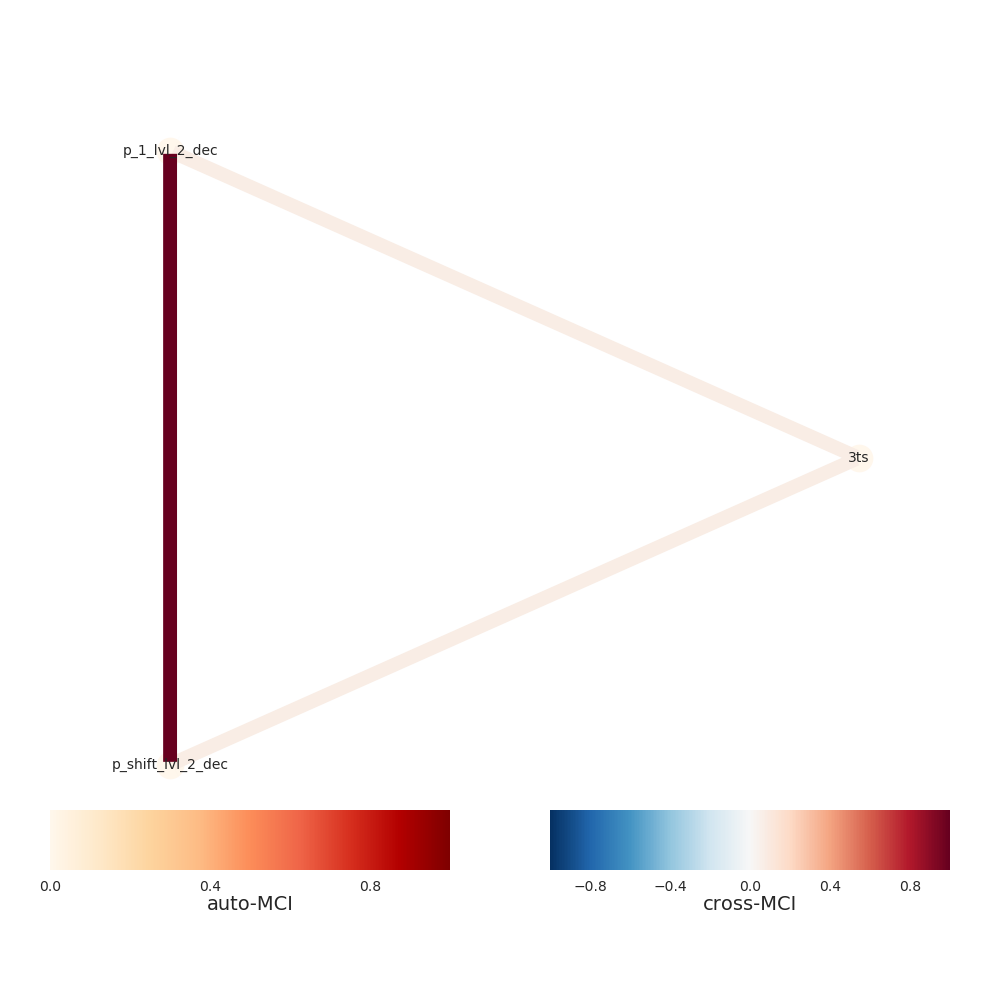

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


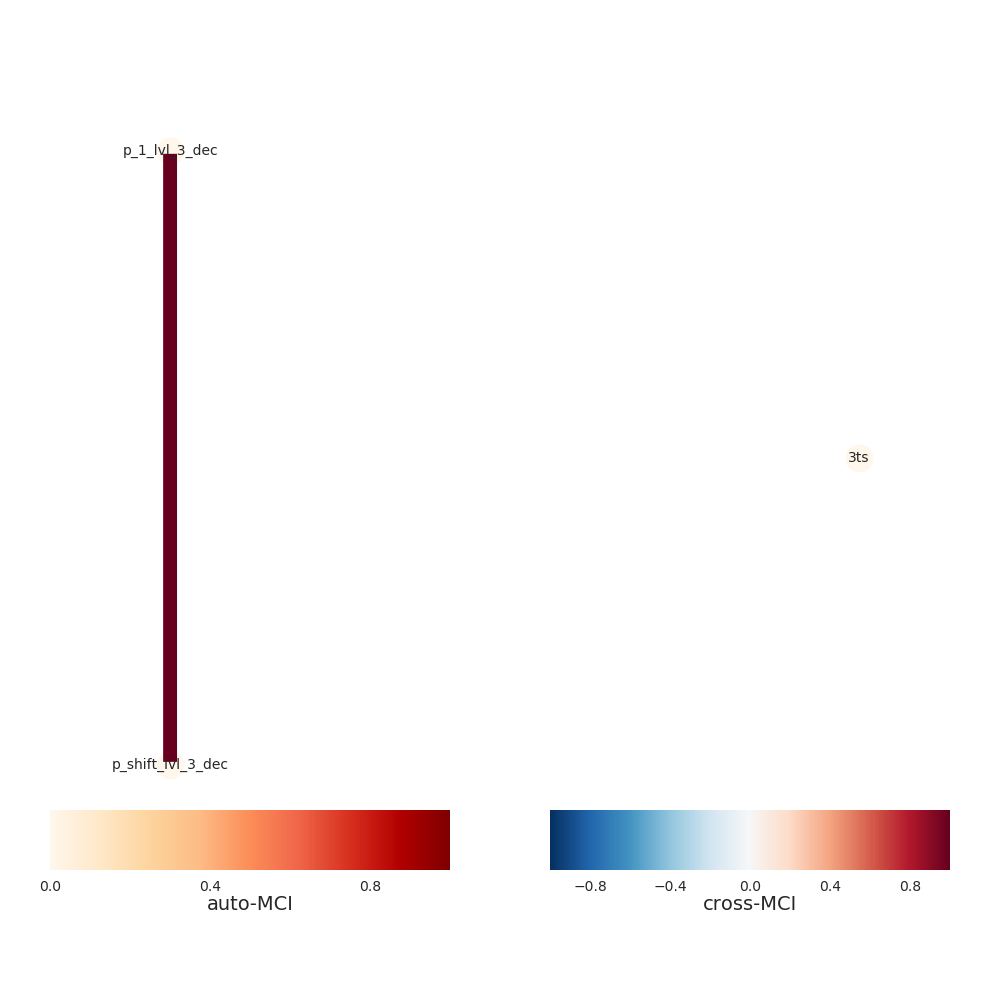

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


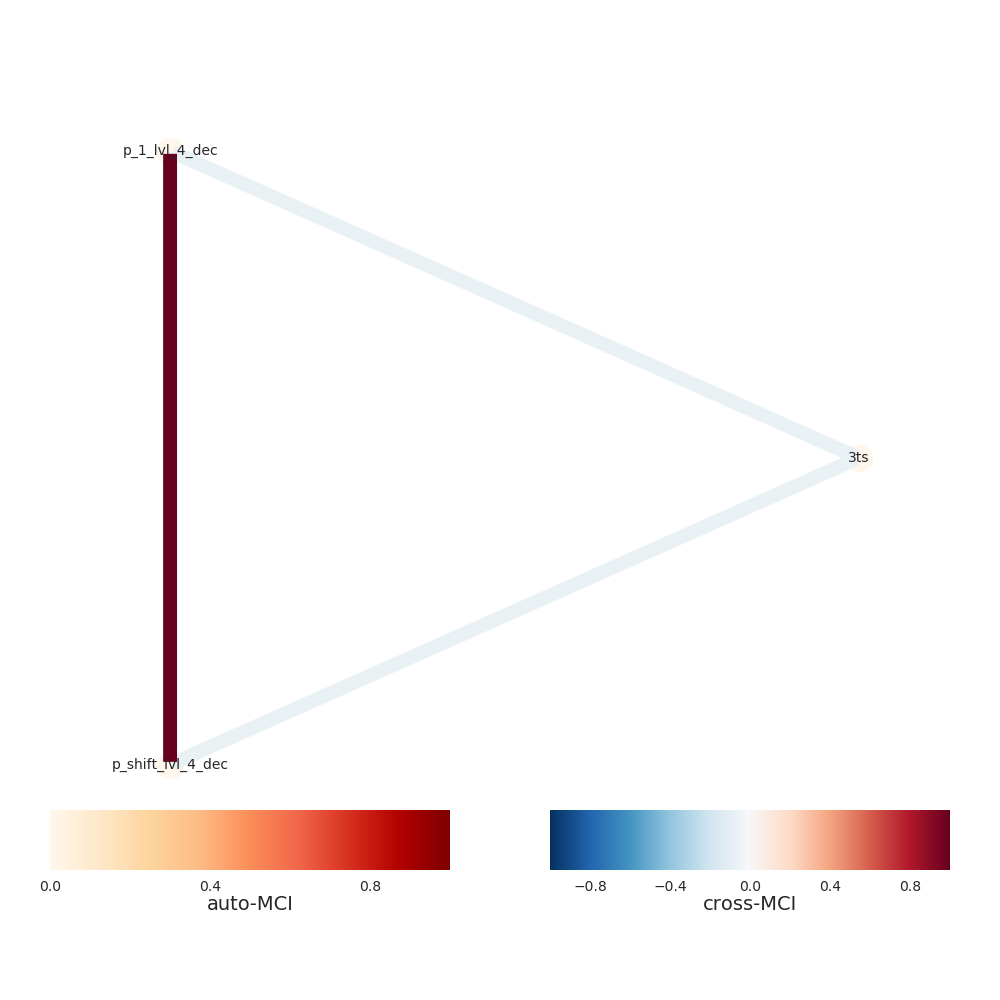

Progress causal inference - traintest set 100%
[INFO] Extracting level 1
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


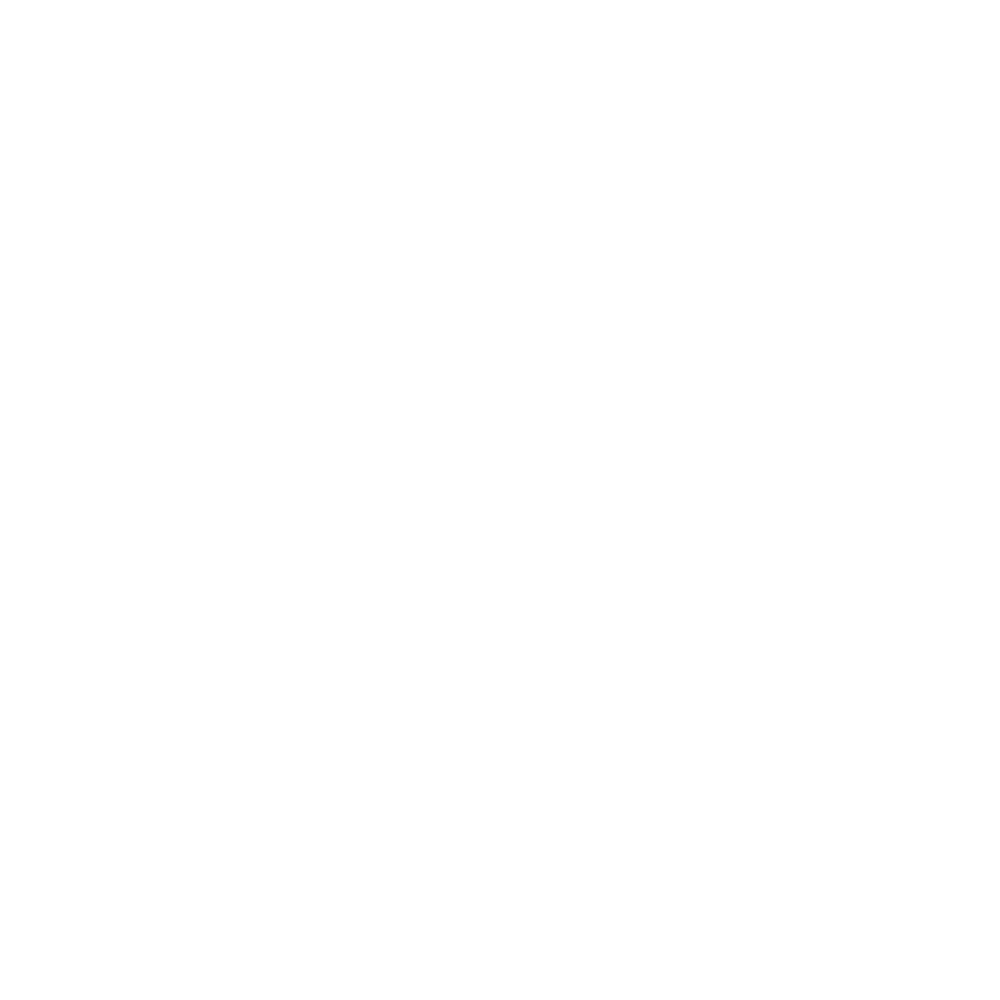

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


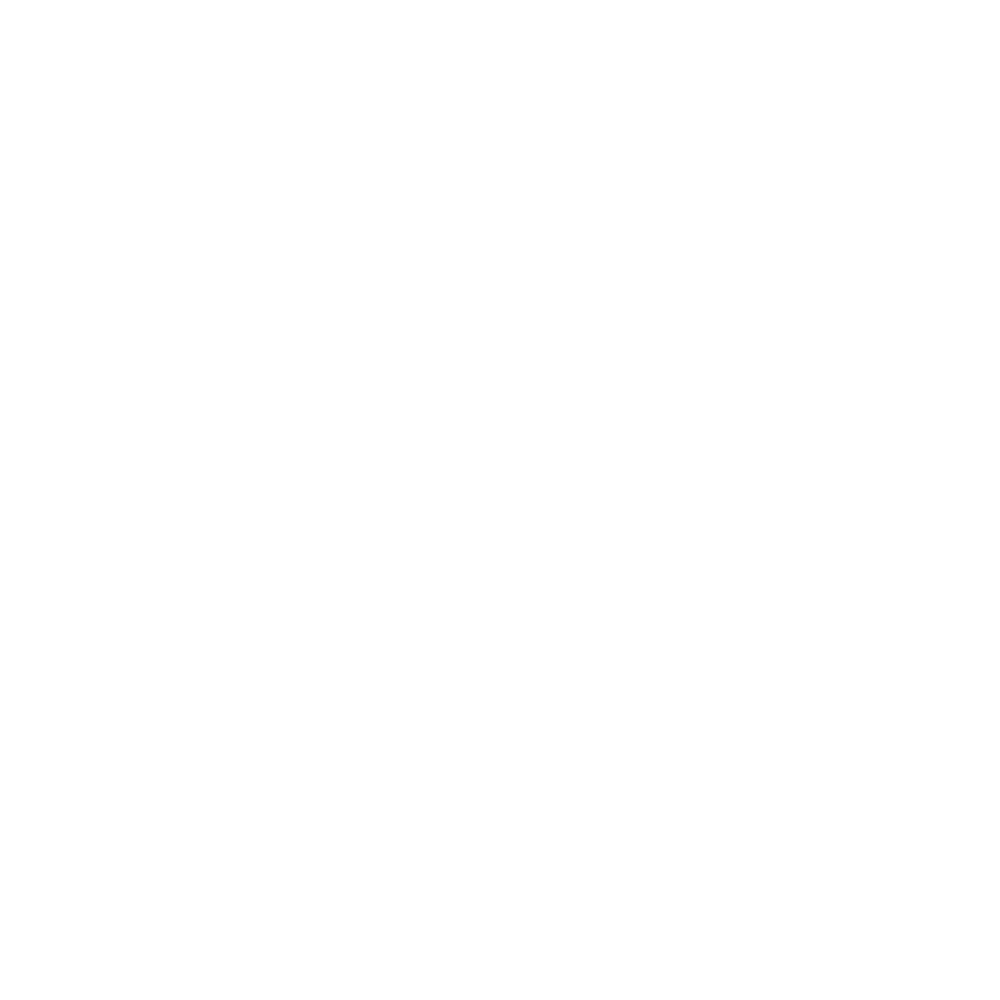

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


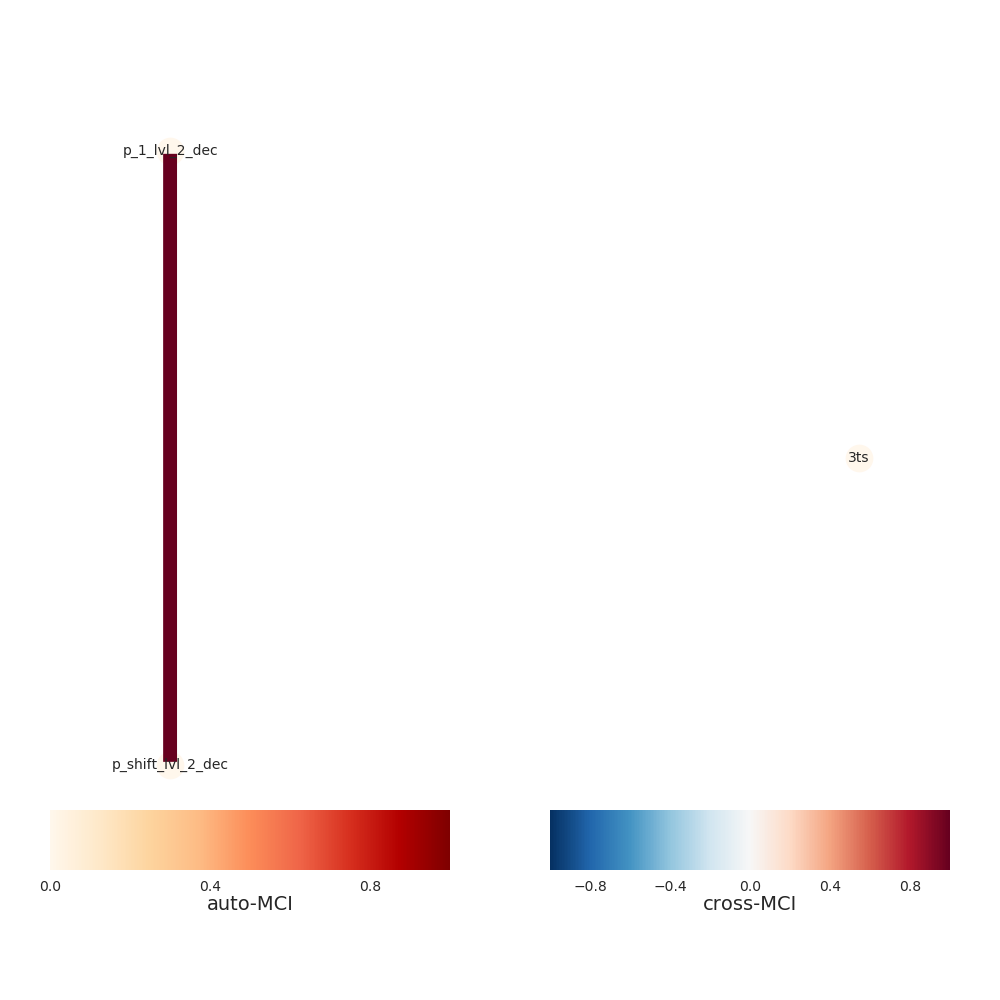

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


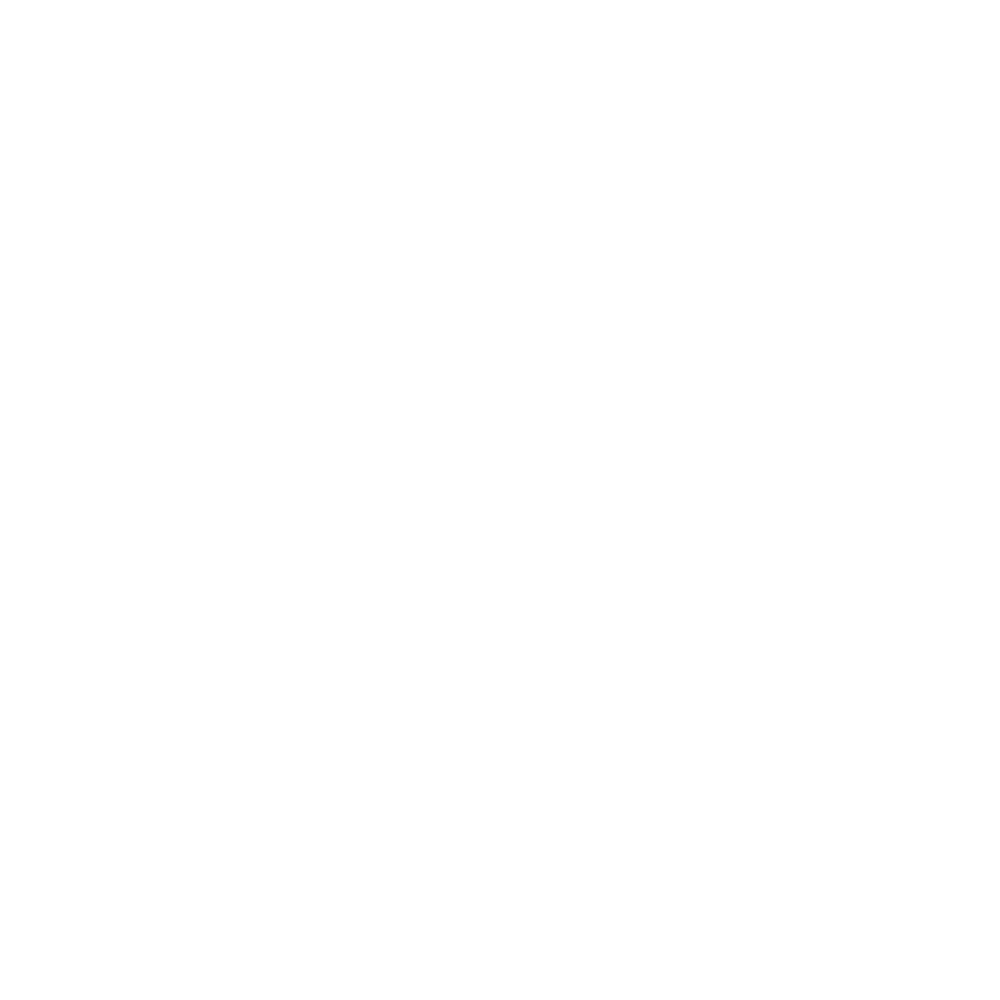

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


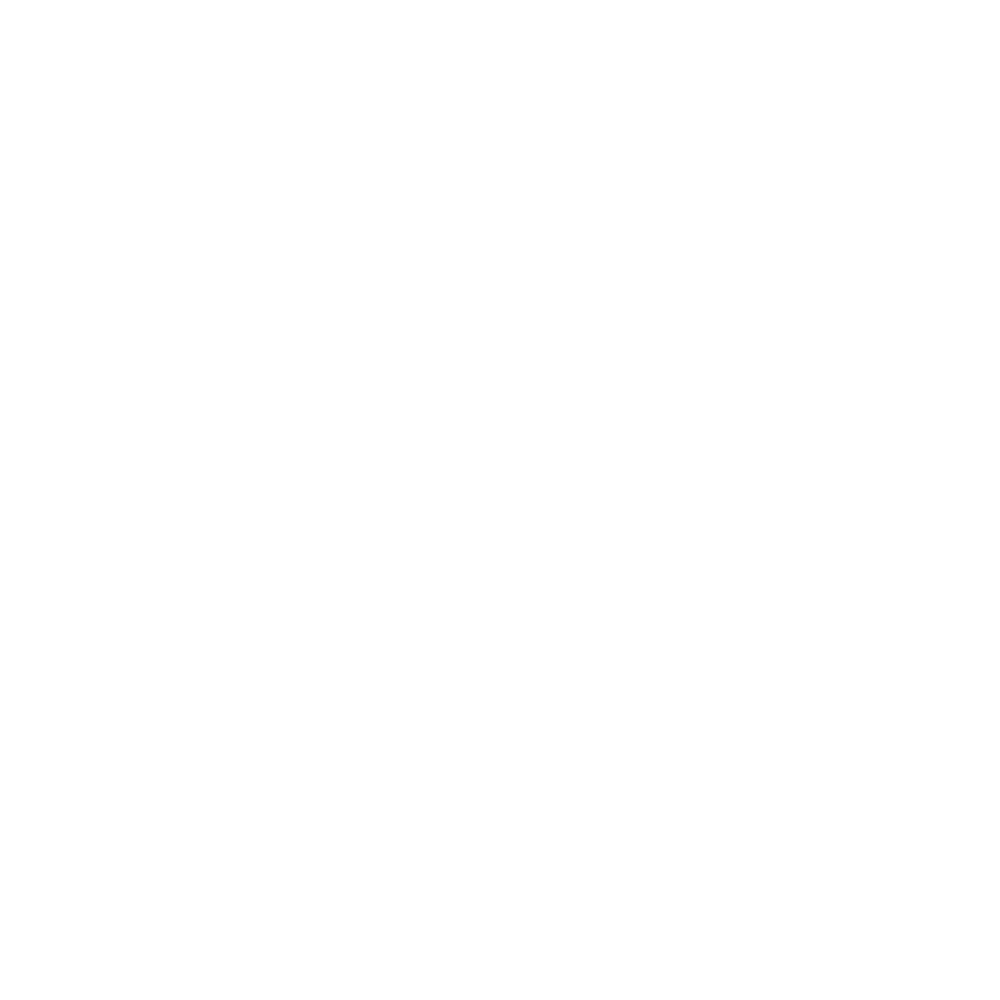

Progress causal inference - traintest set 100%
[INFO] Extracting level 2
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


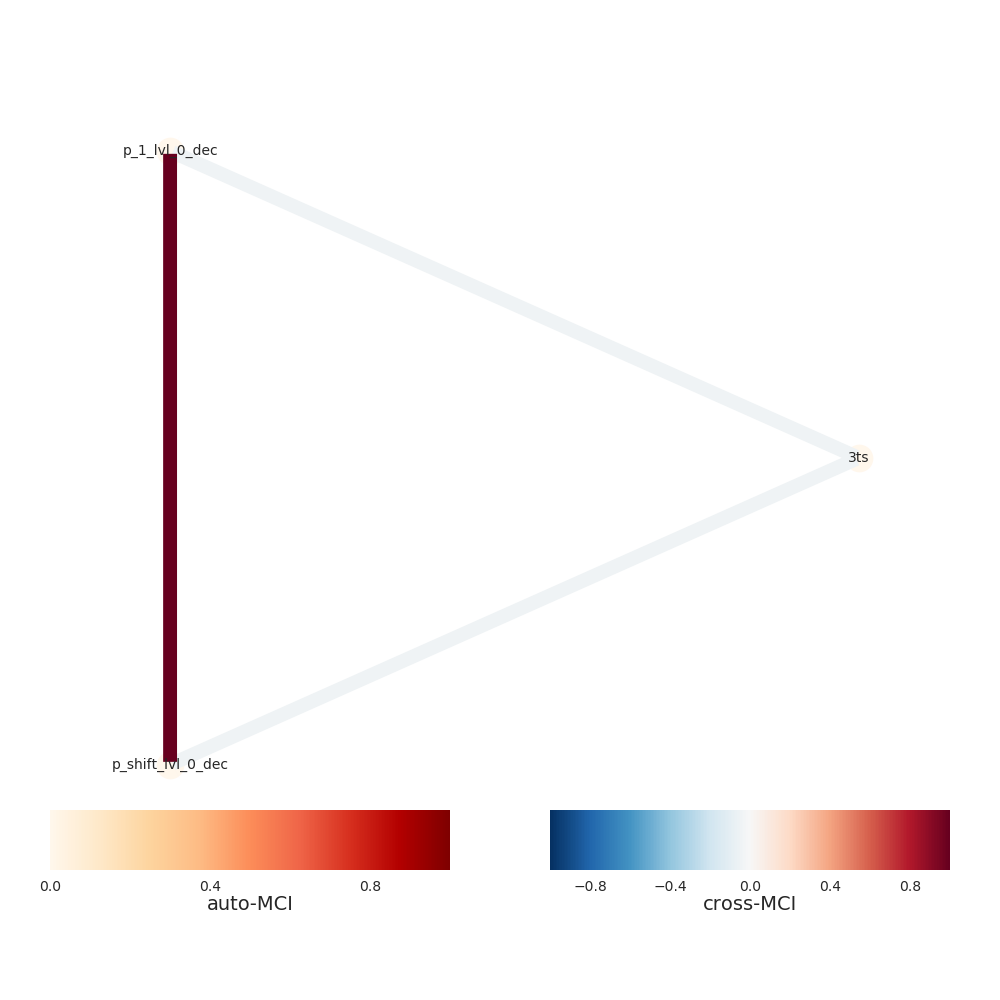

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


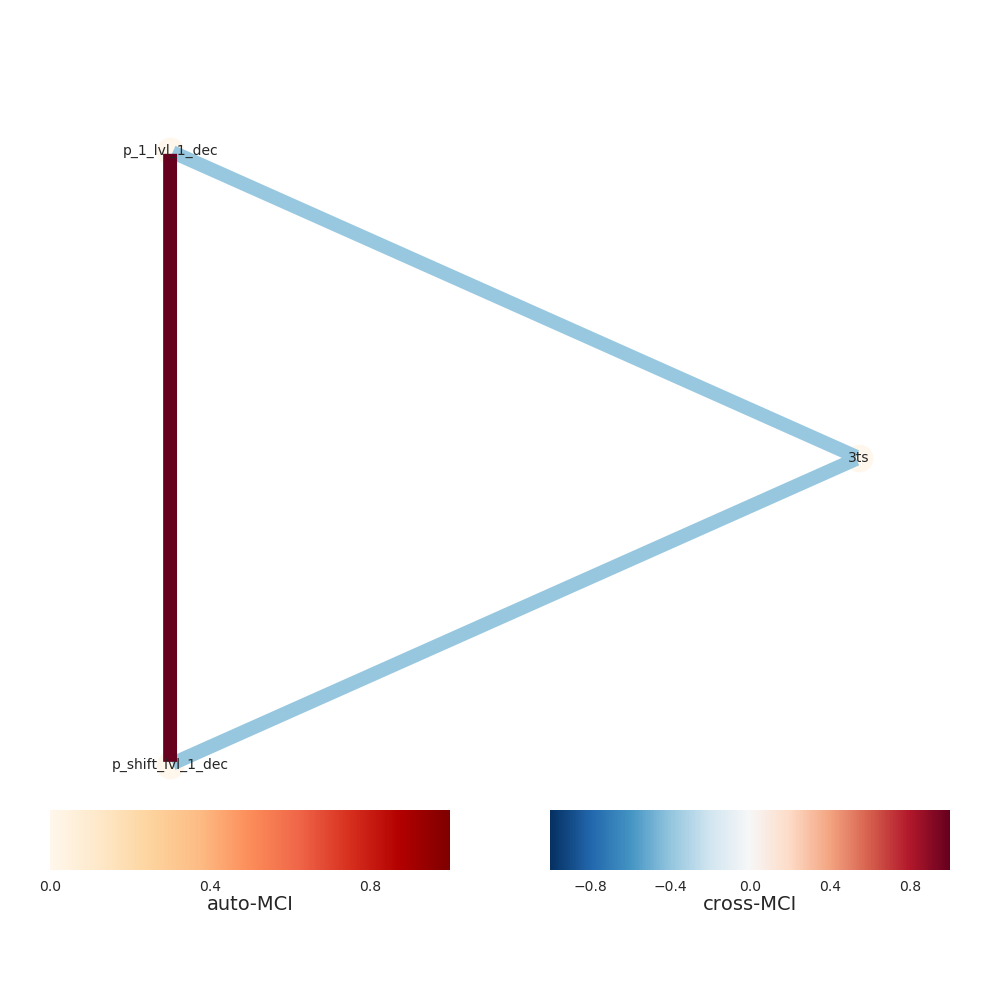

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


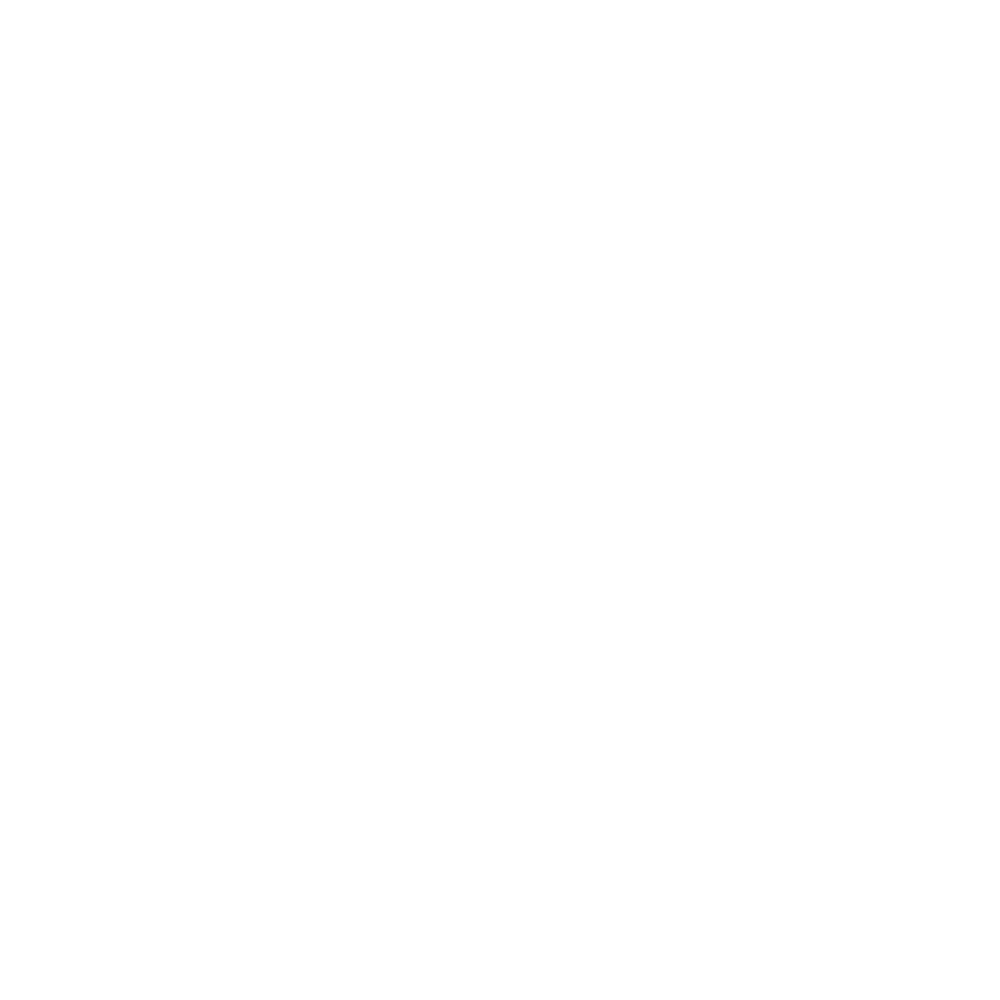

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


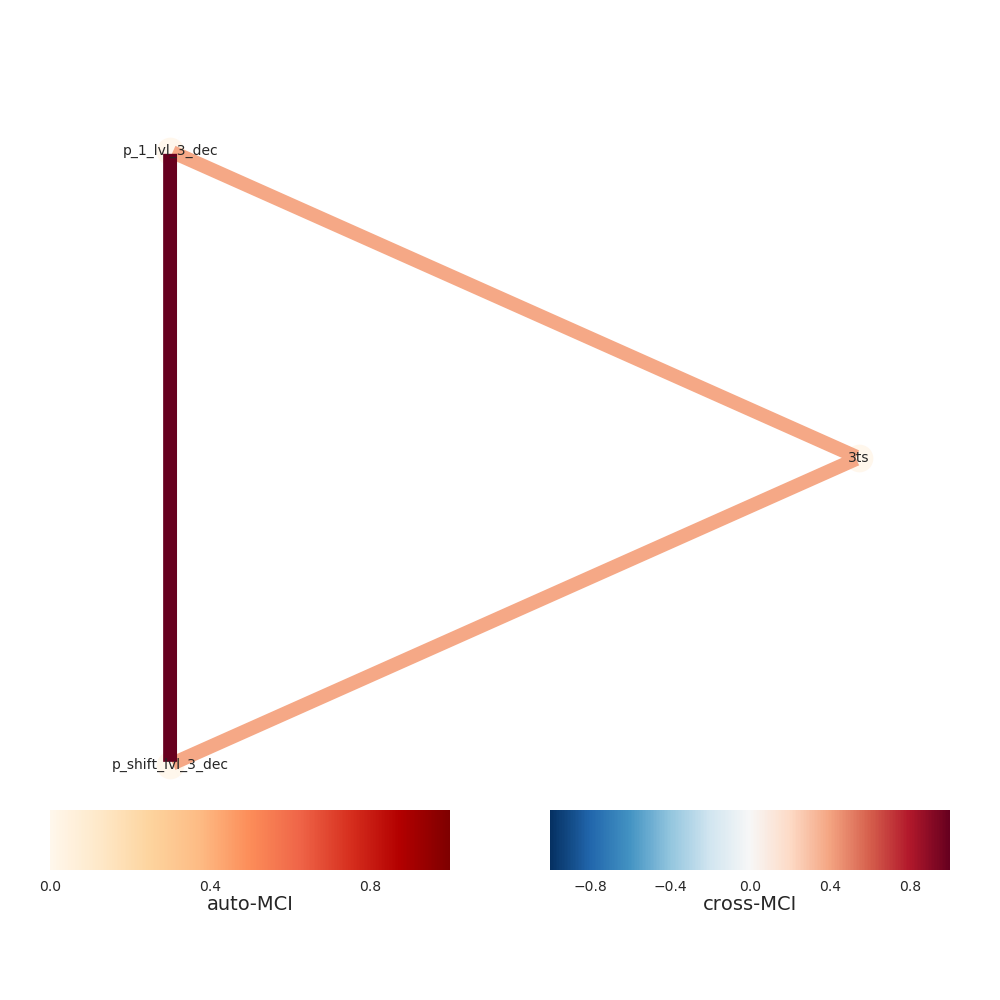

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


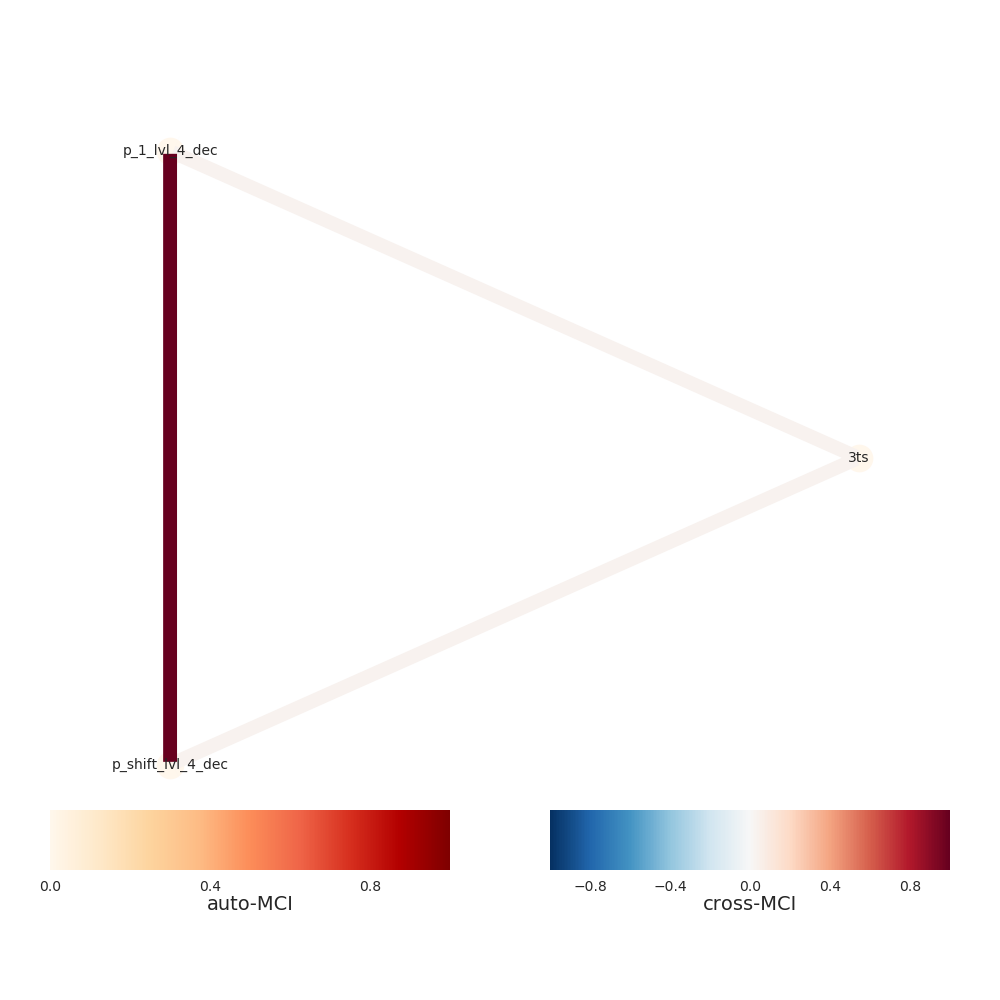

Progress causal inference - traintest set 100%
[INFO] Extracting level 3
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


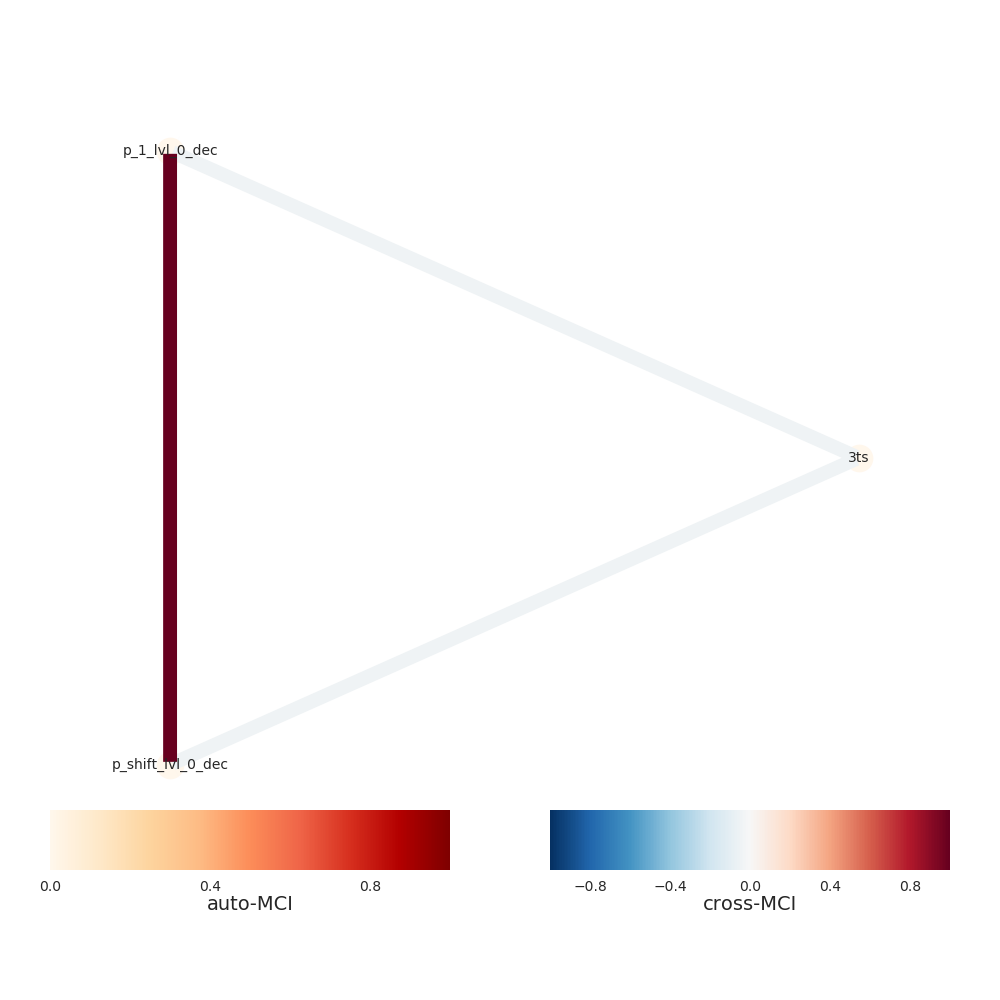

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


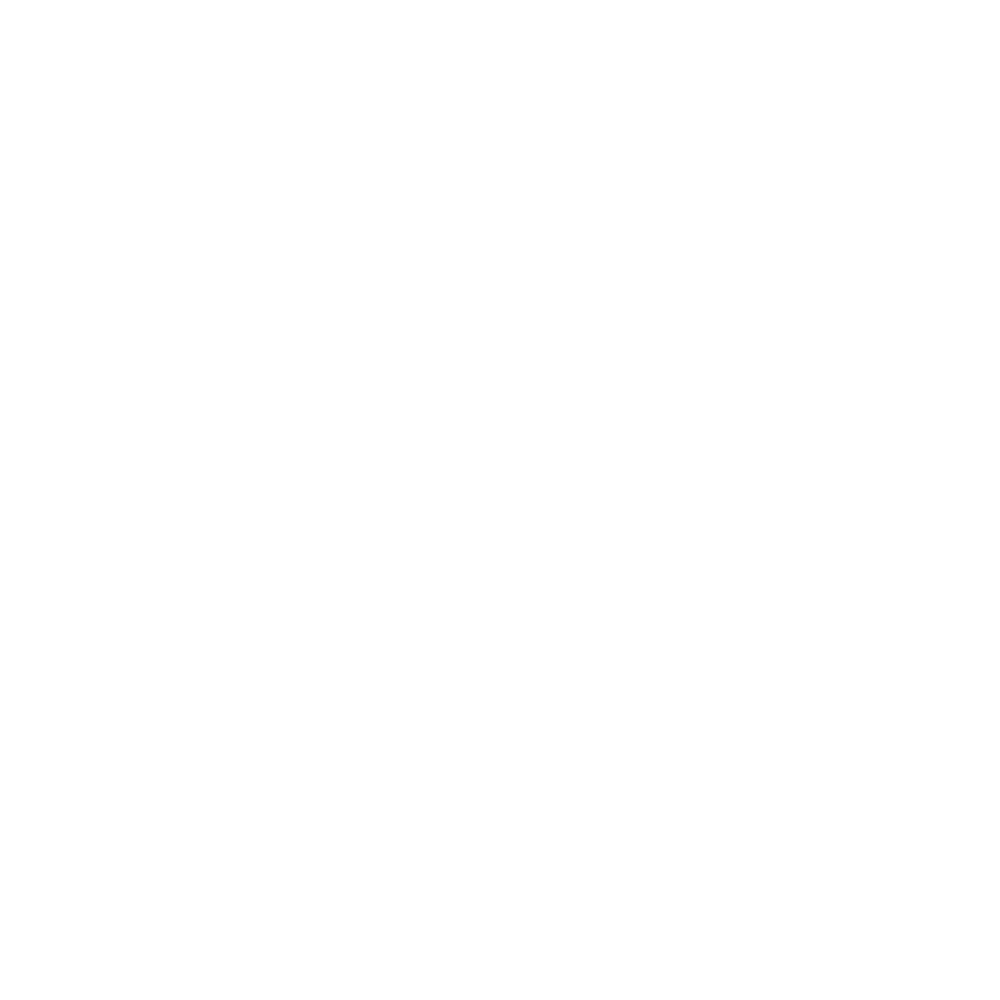

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


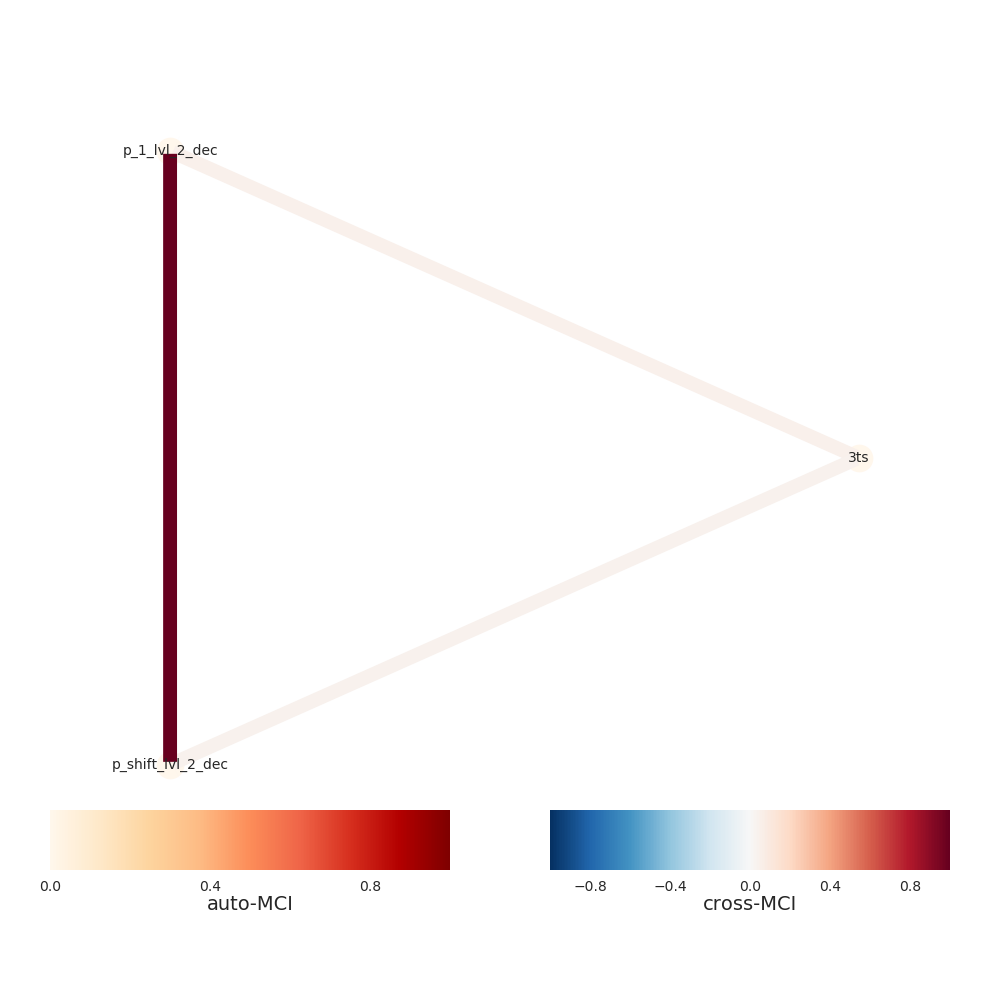

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


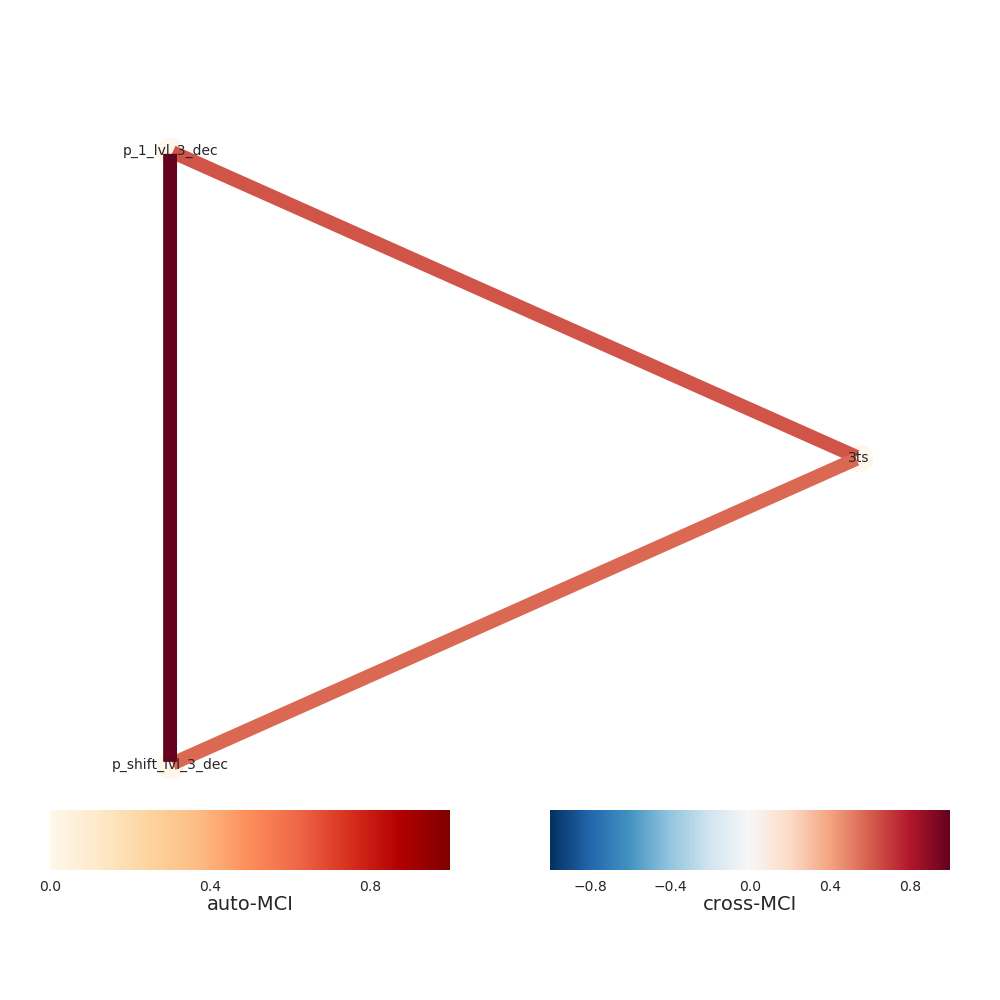

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


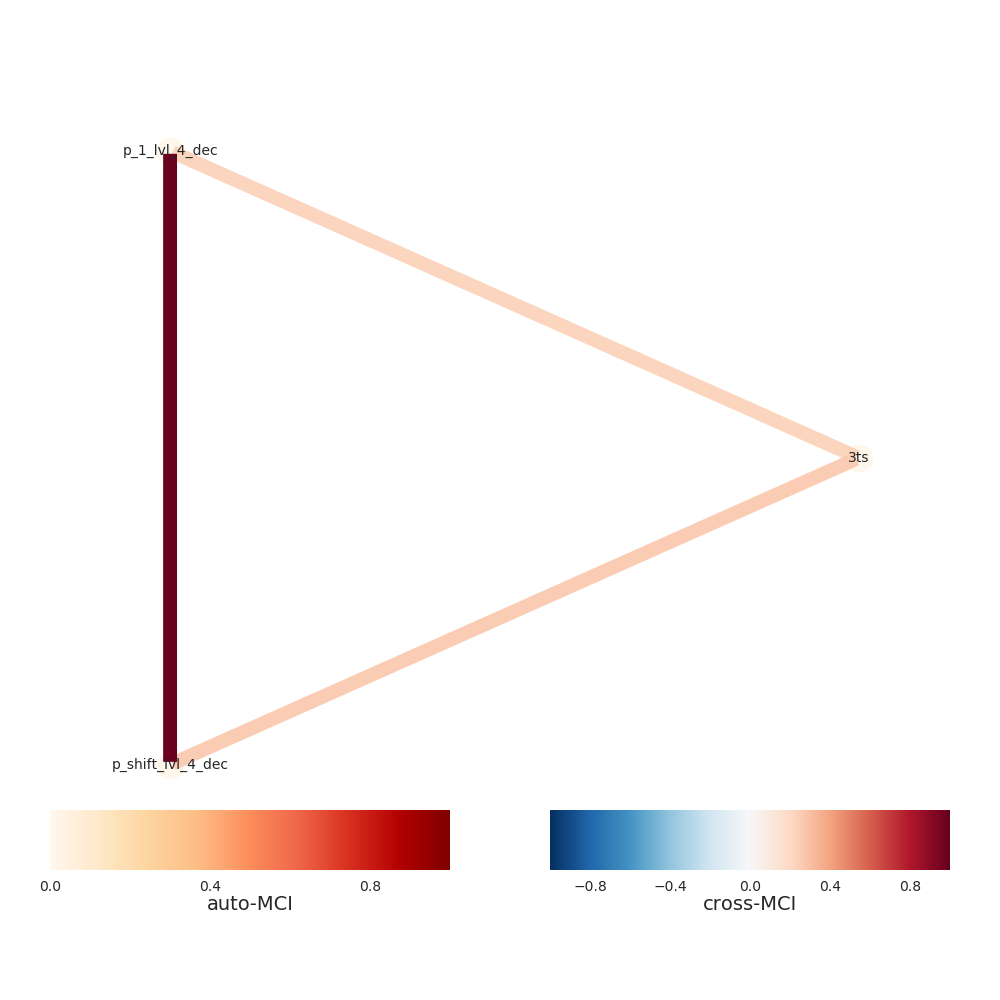

Progress causal inference - traintest set 100%
[INFO] Extracting level 4
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


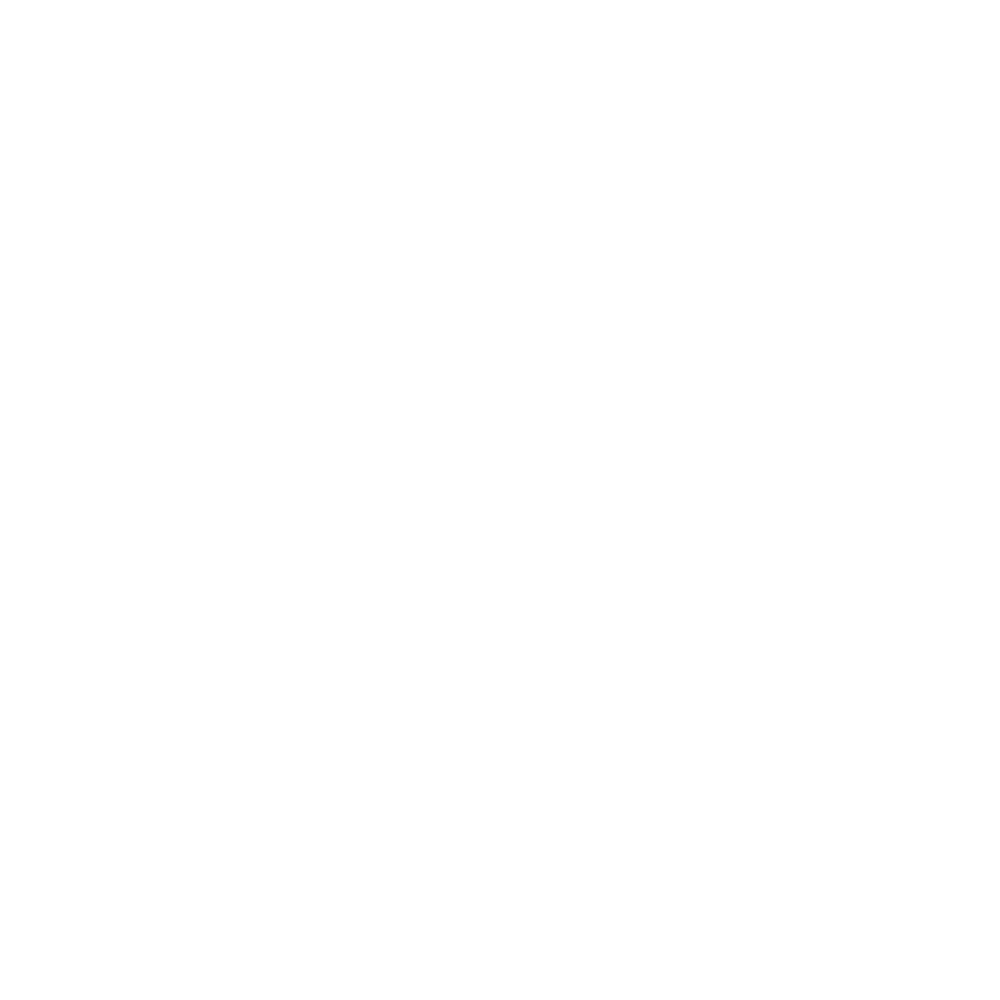

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


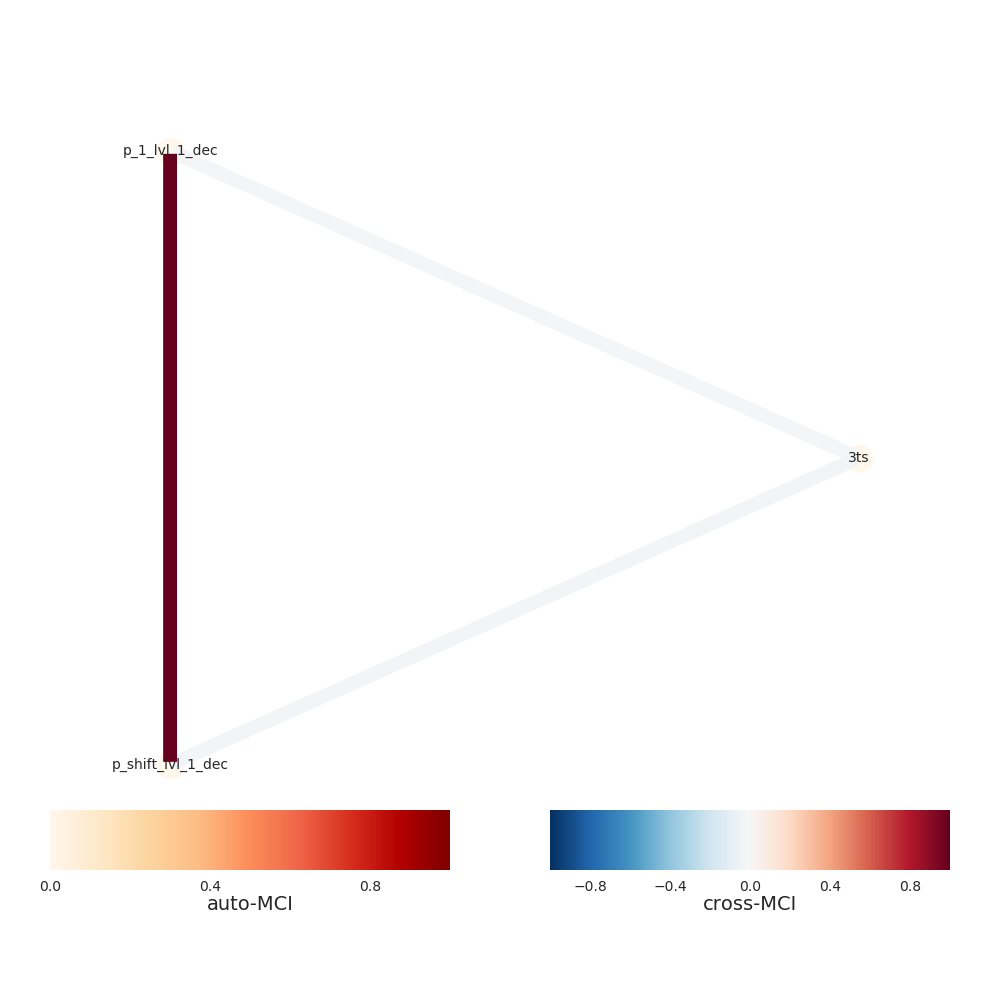

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


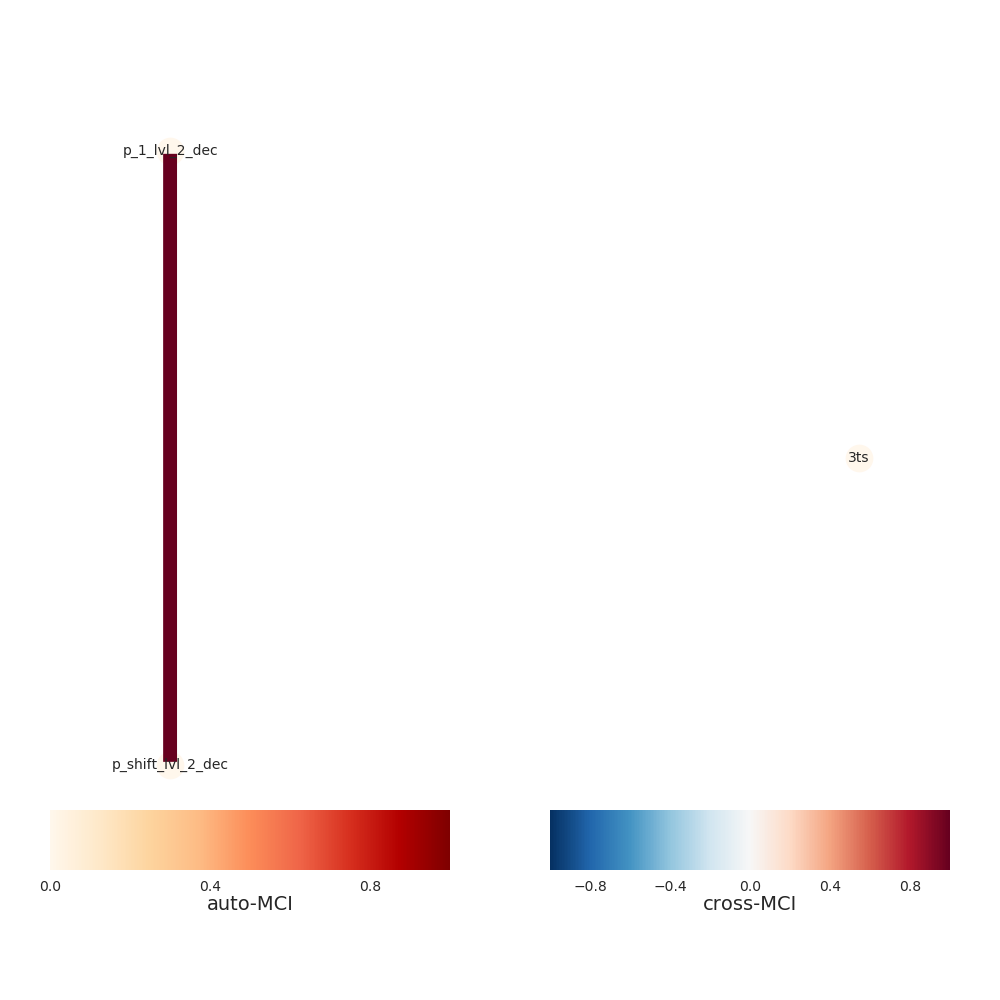

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


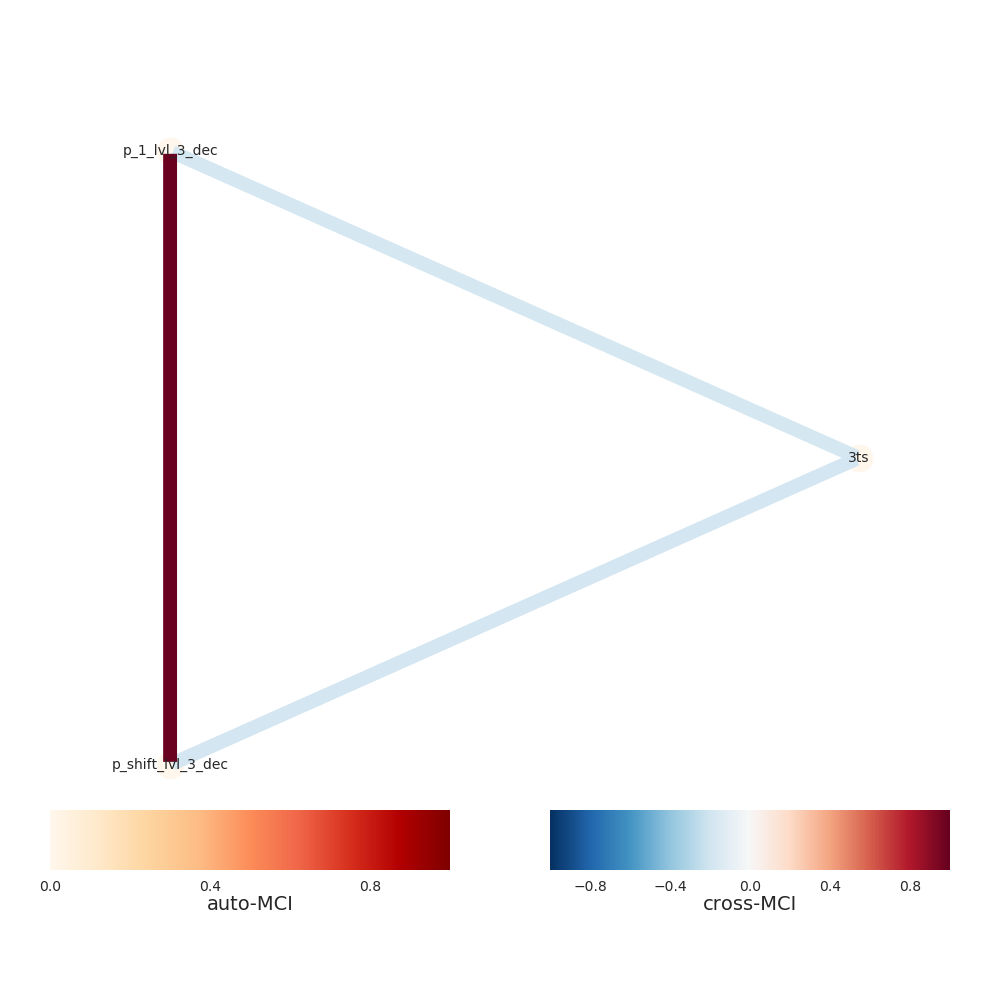

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


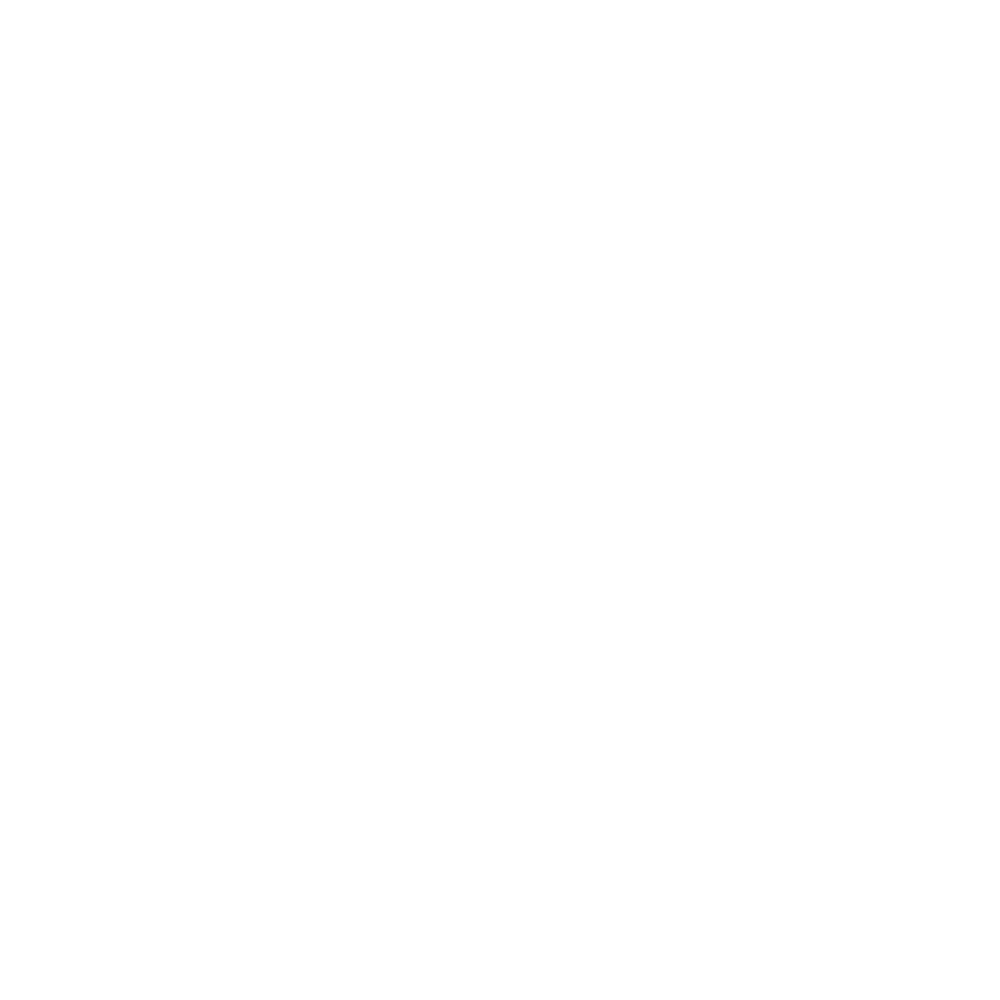

Progress causal inference - traintest set 100%
[INFO] Extracting level 5
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


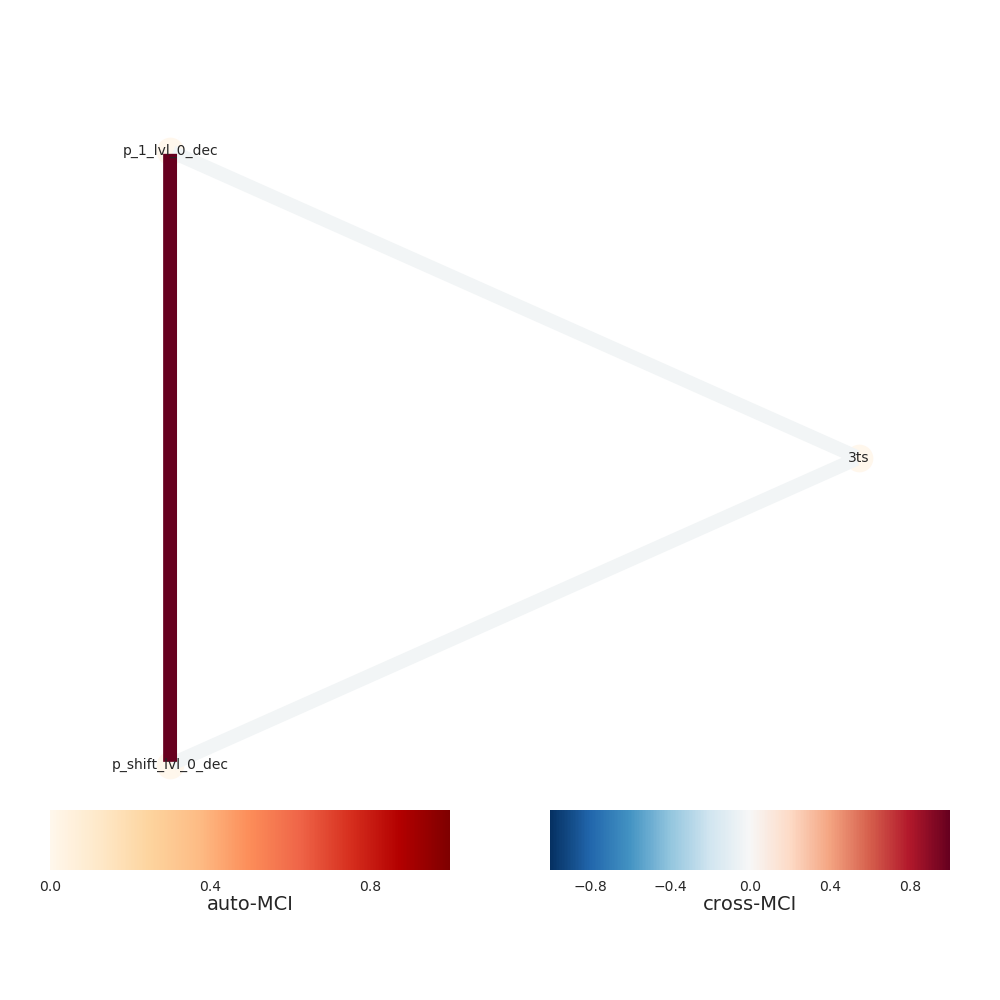

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


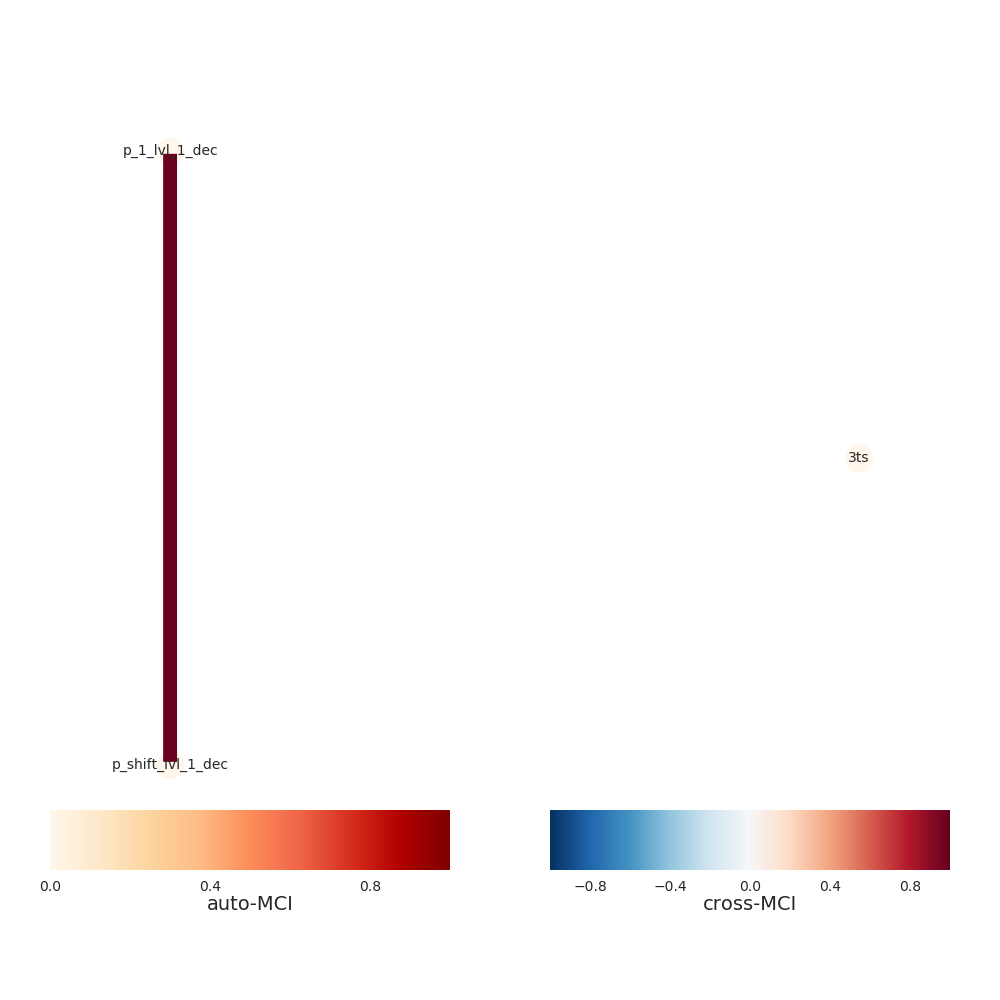

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


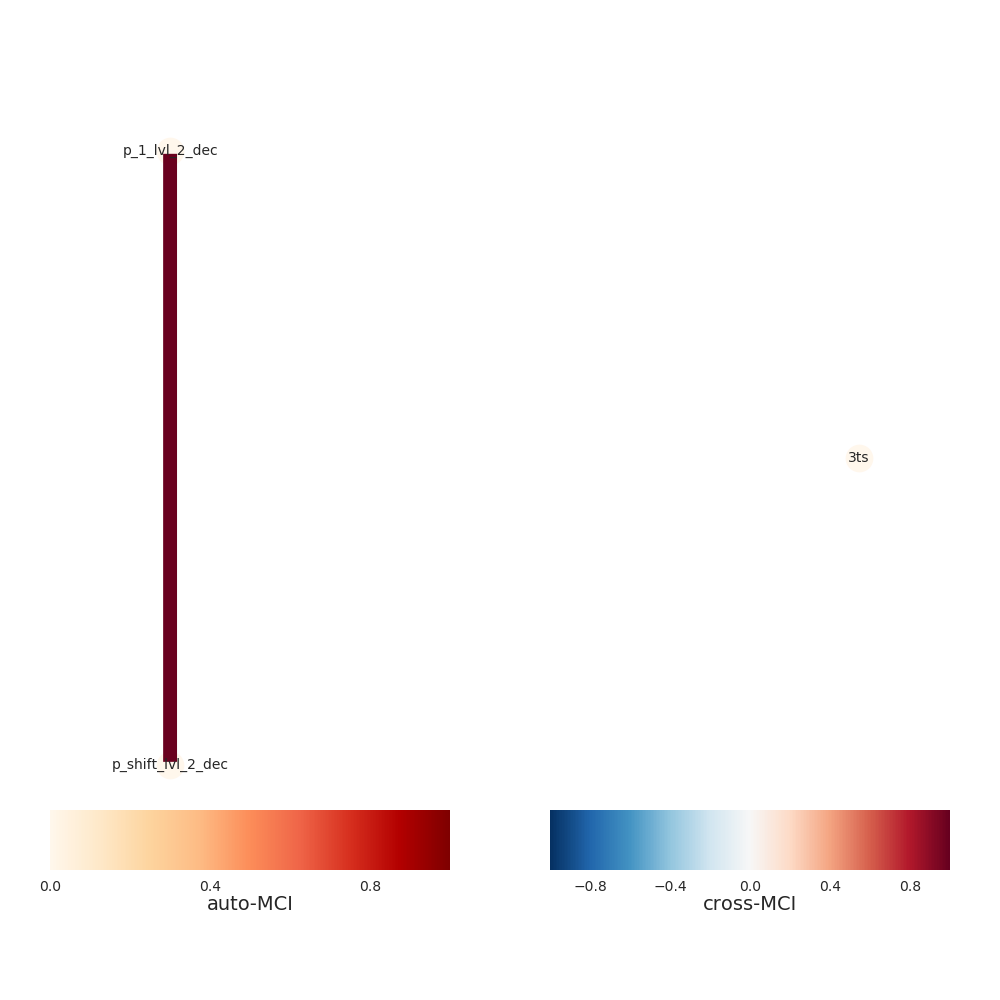

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


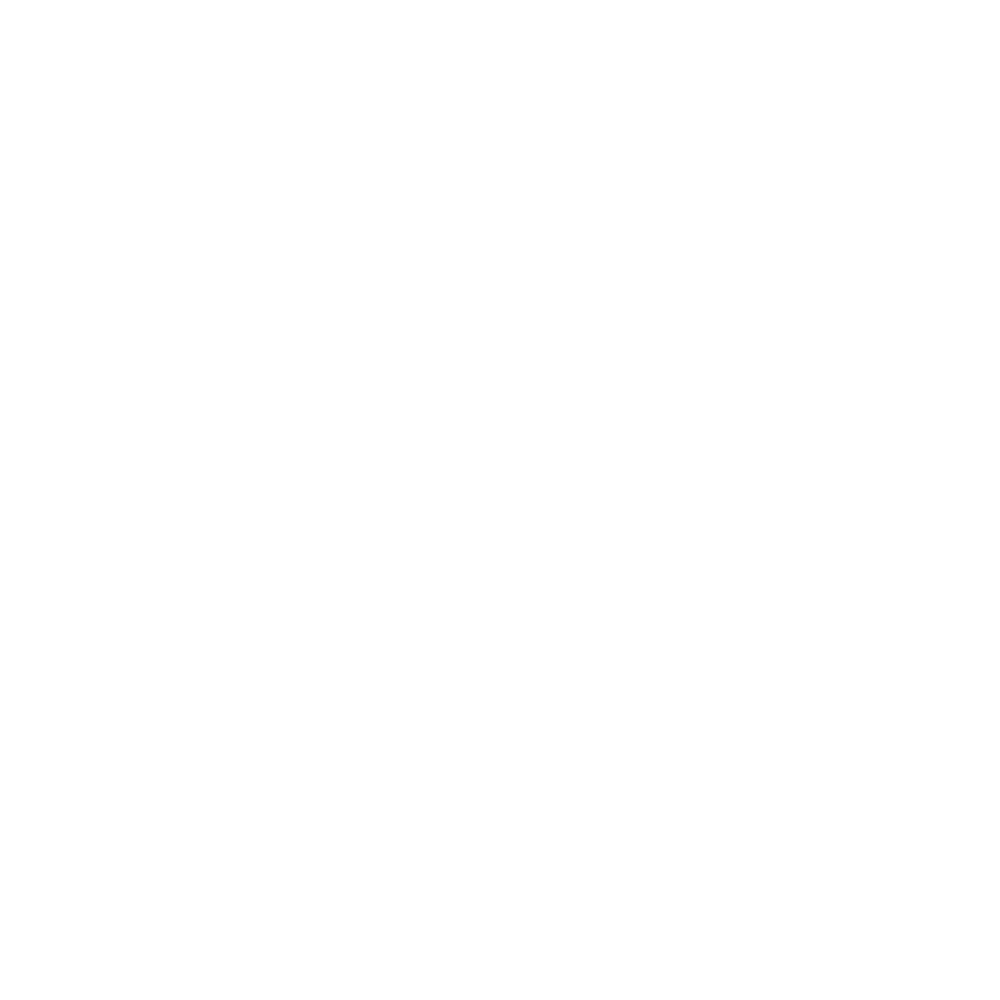

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


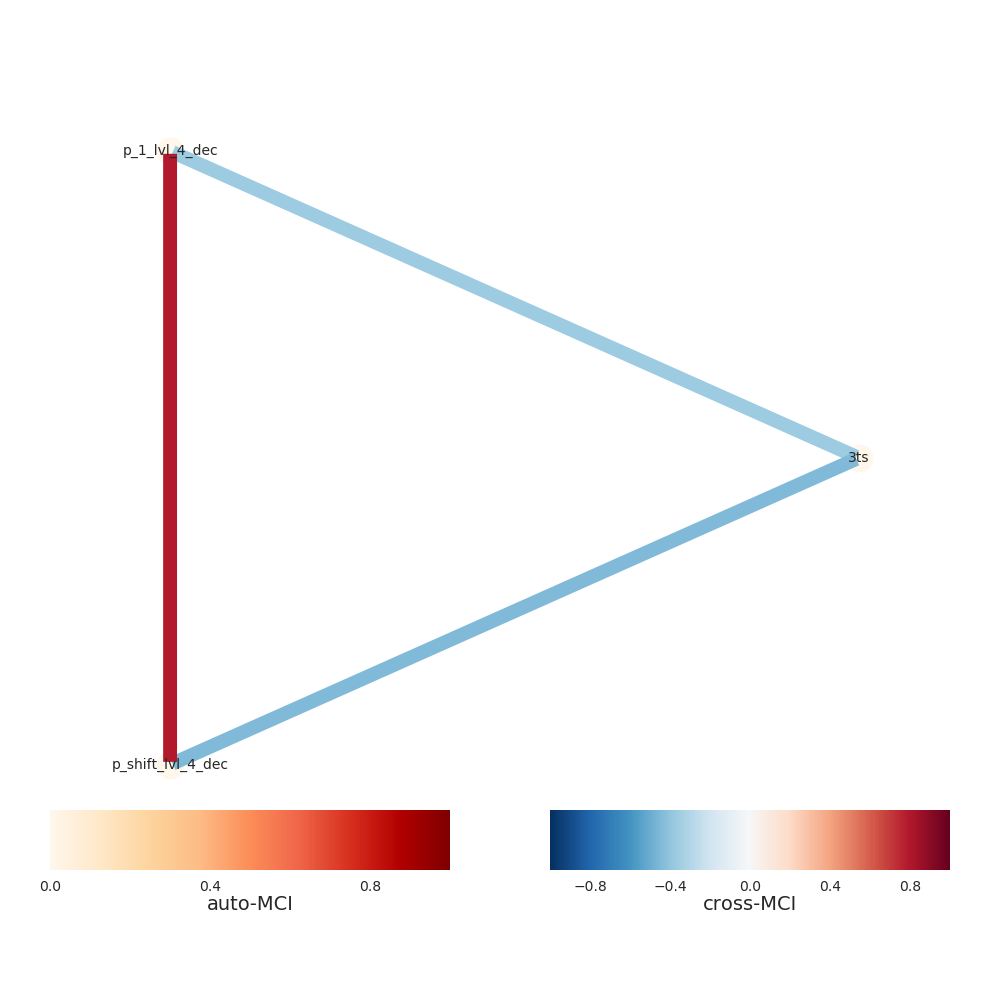

Progress causal inference - traintest set 100%
[INFO] Extracting level 6
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


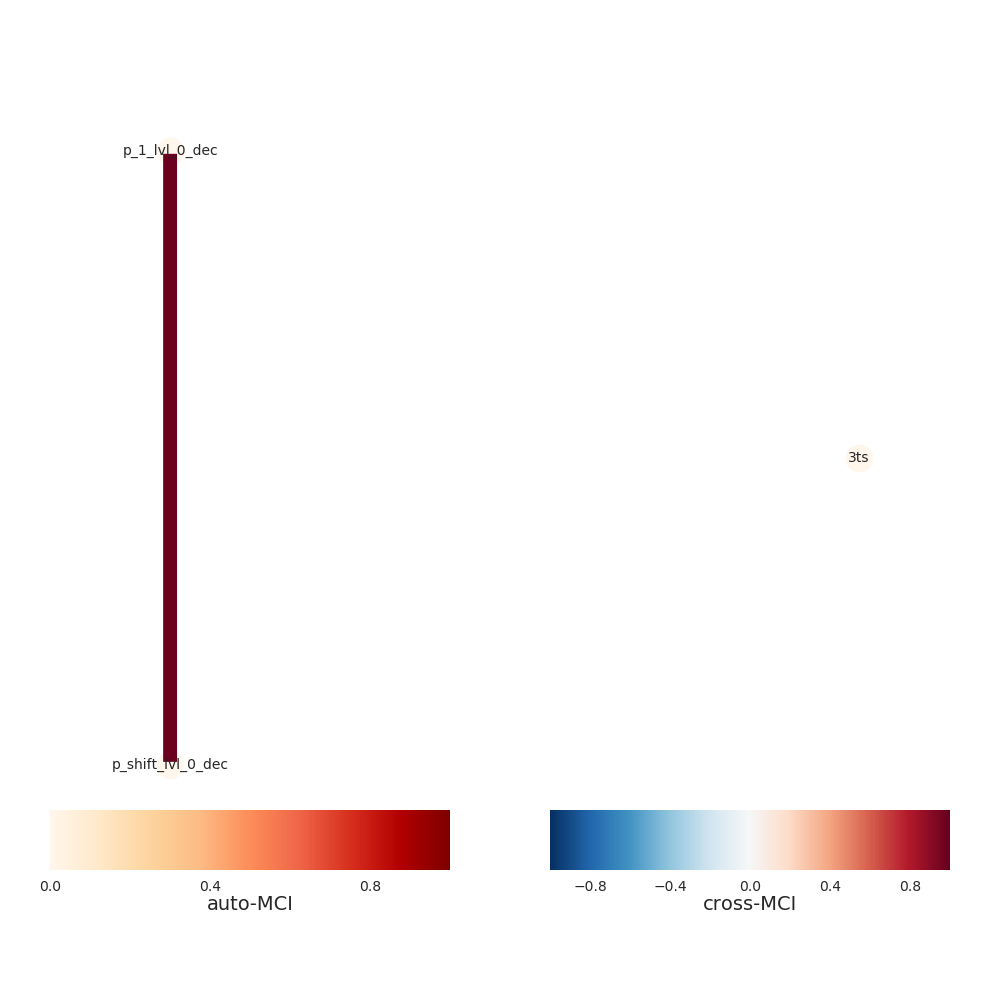

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


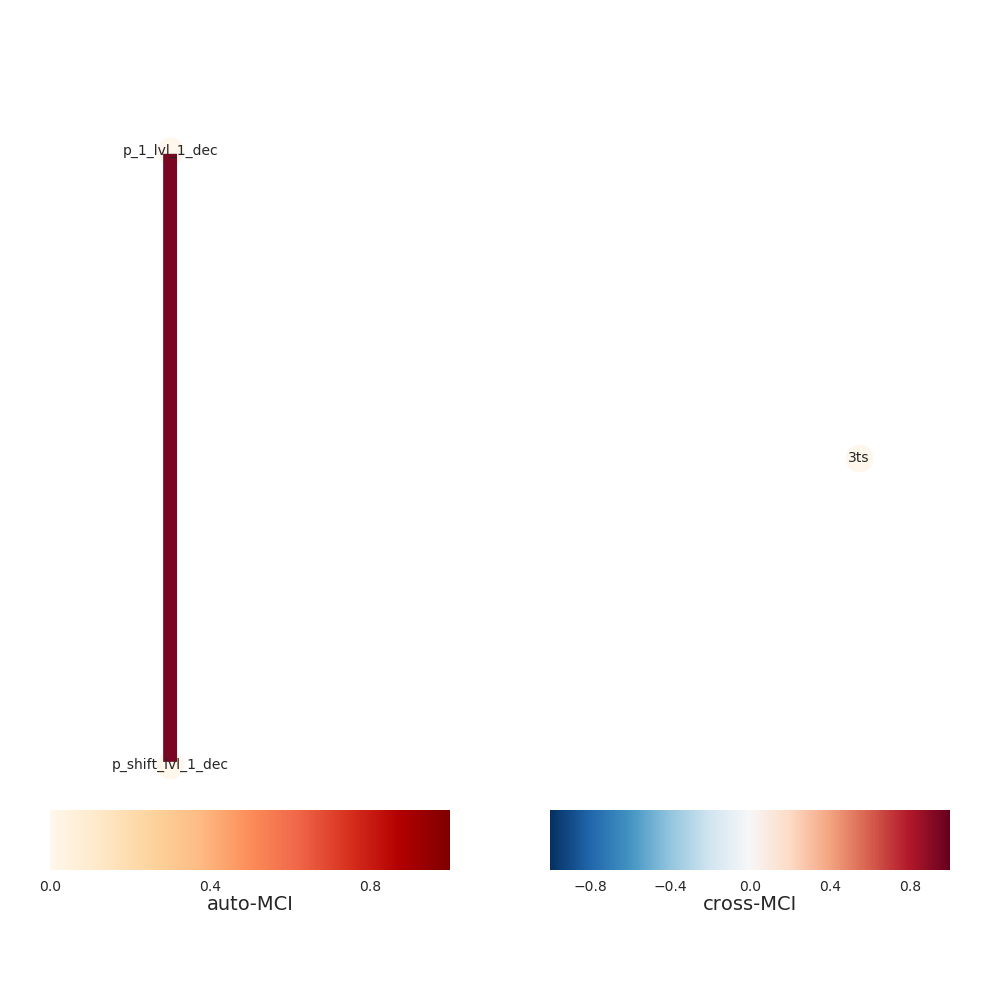

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


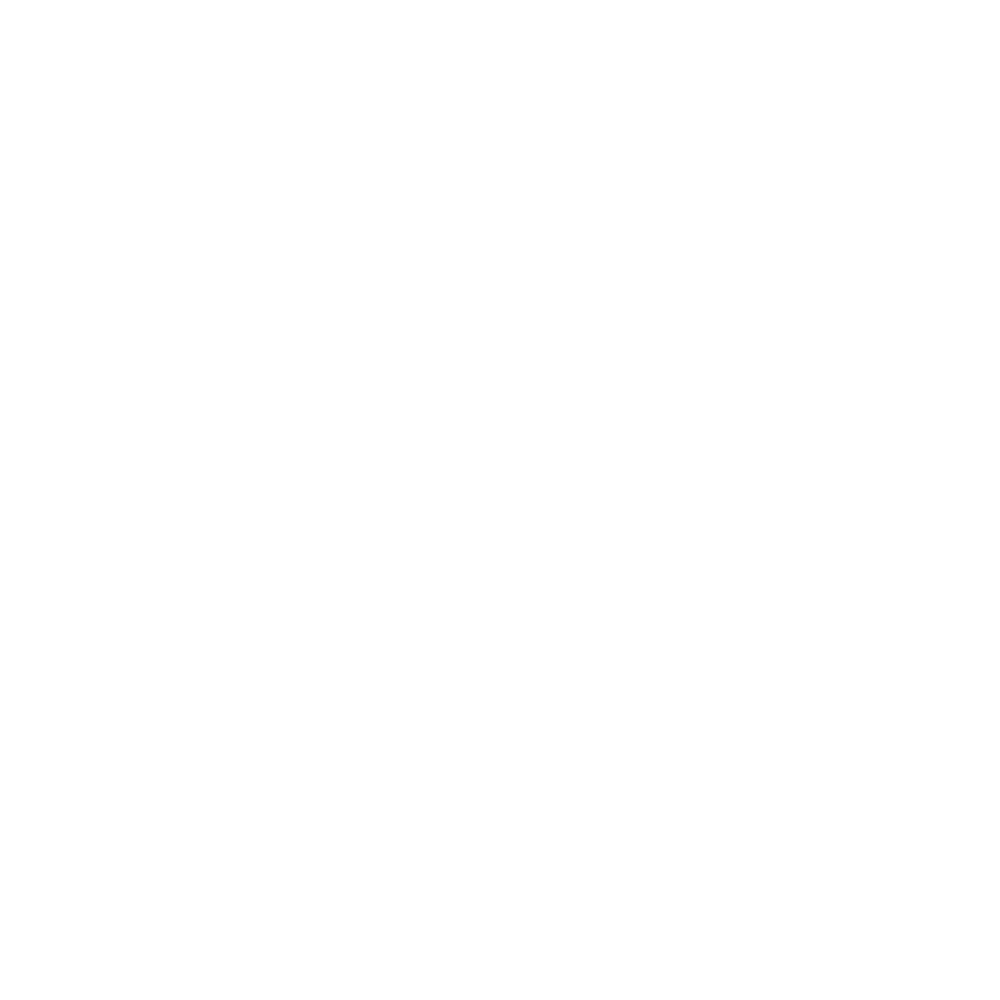

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


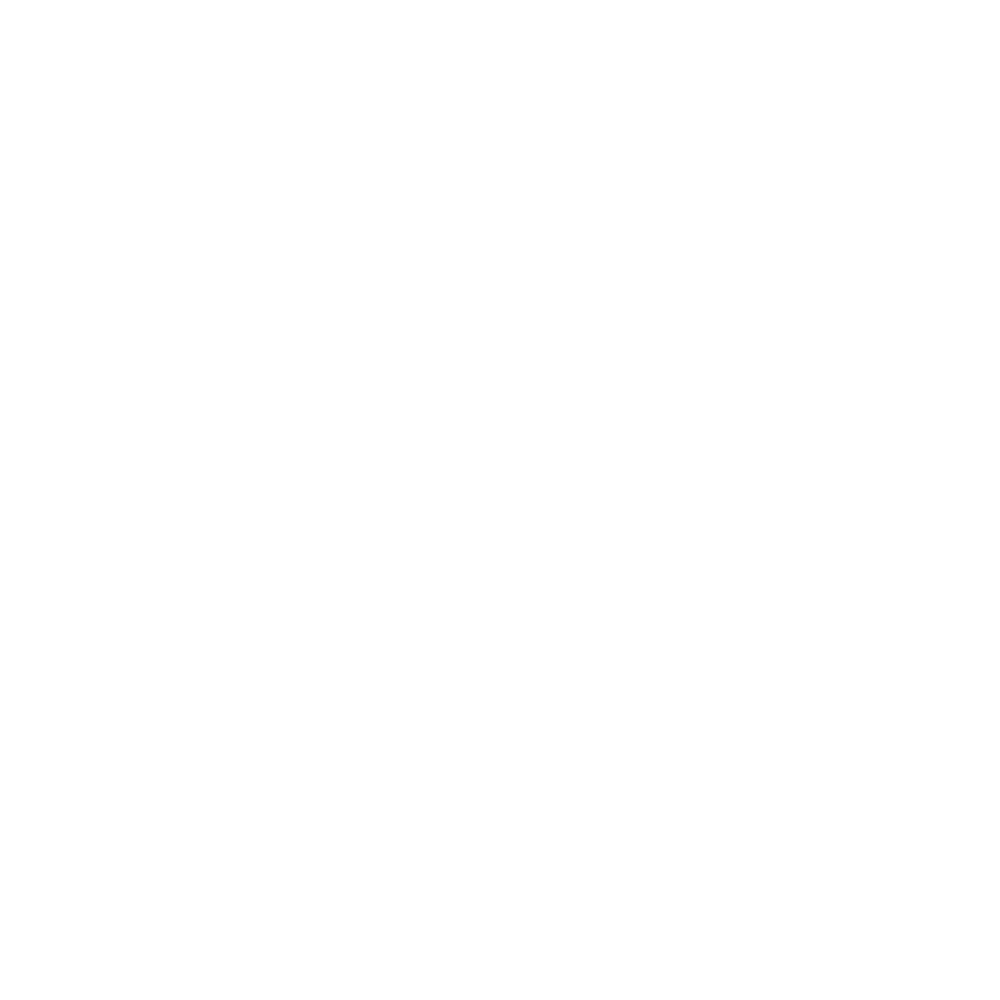

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


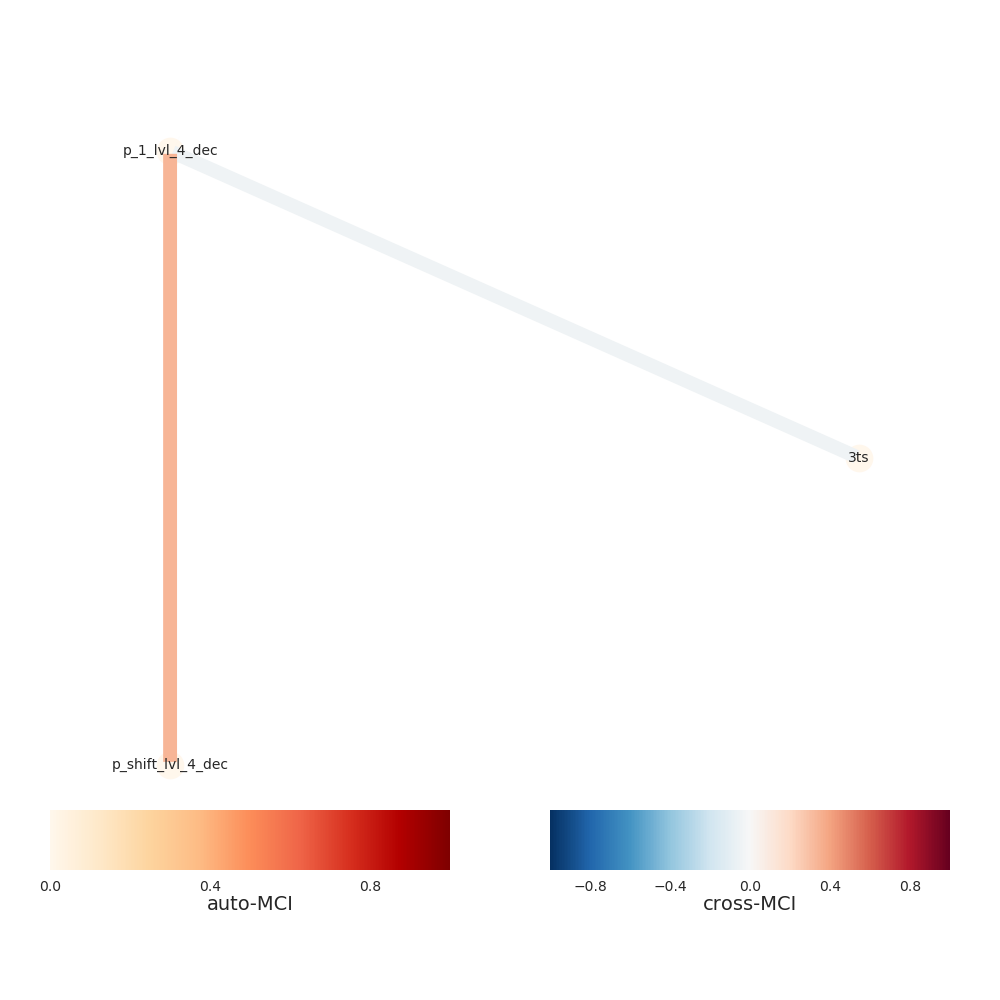

Progress causal inference - traintest set 100%
[INFO] Extracting level 7
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


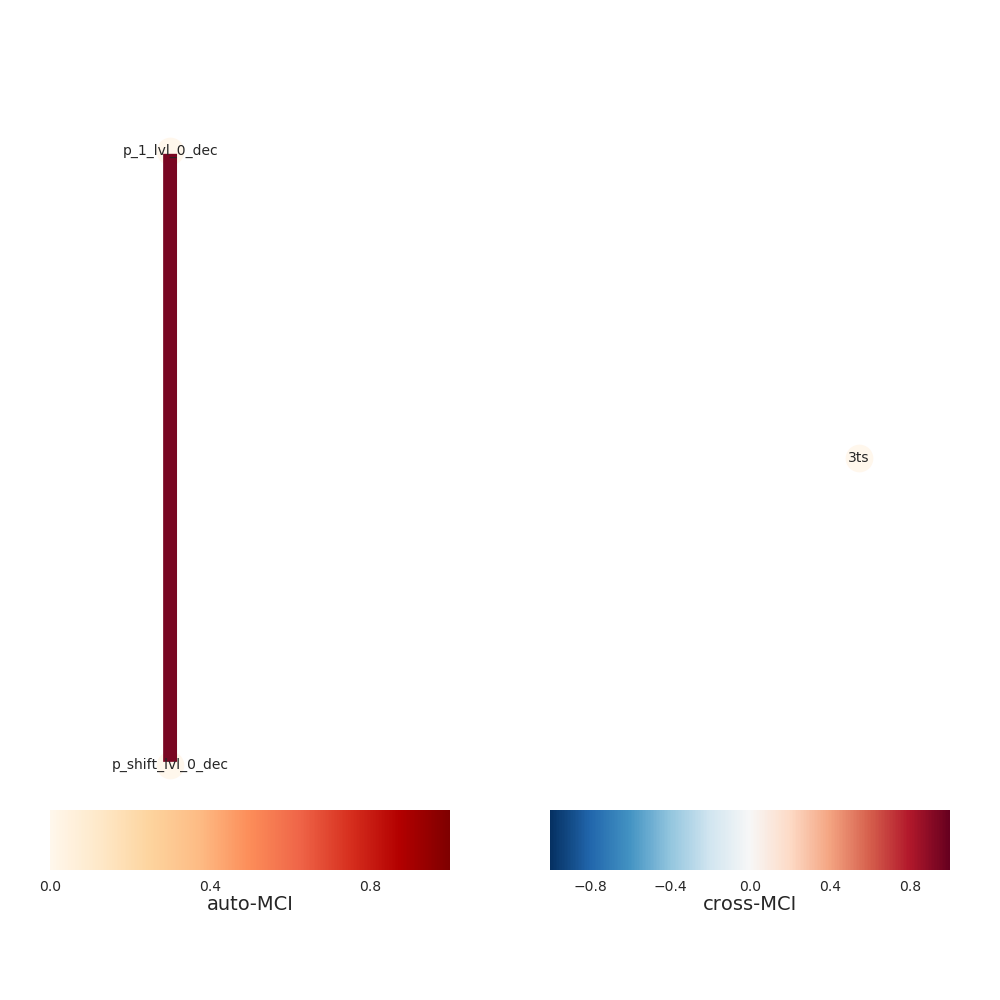

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


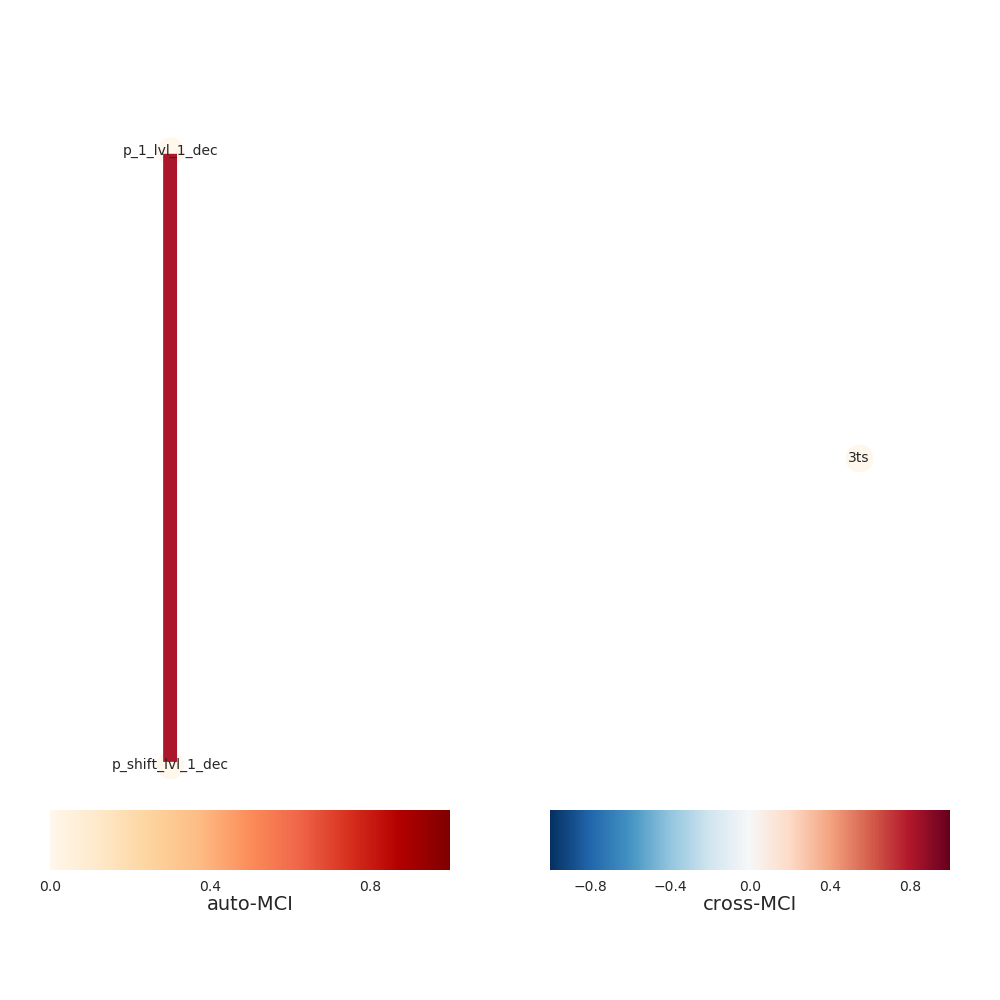

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


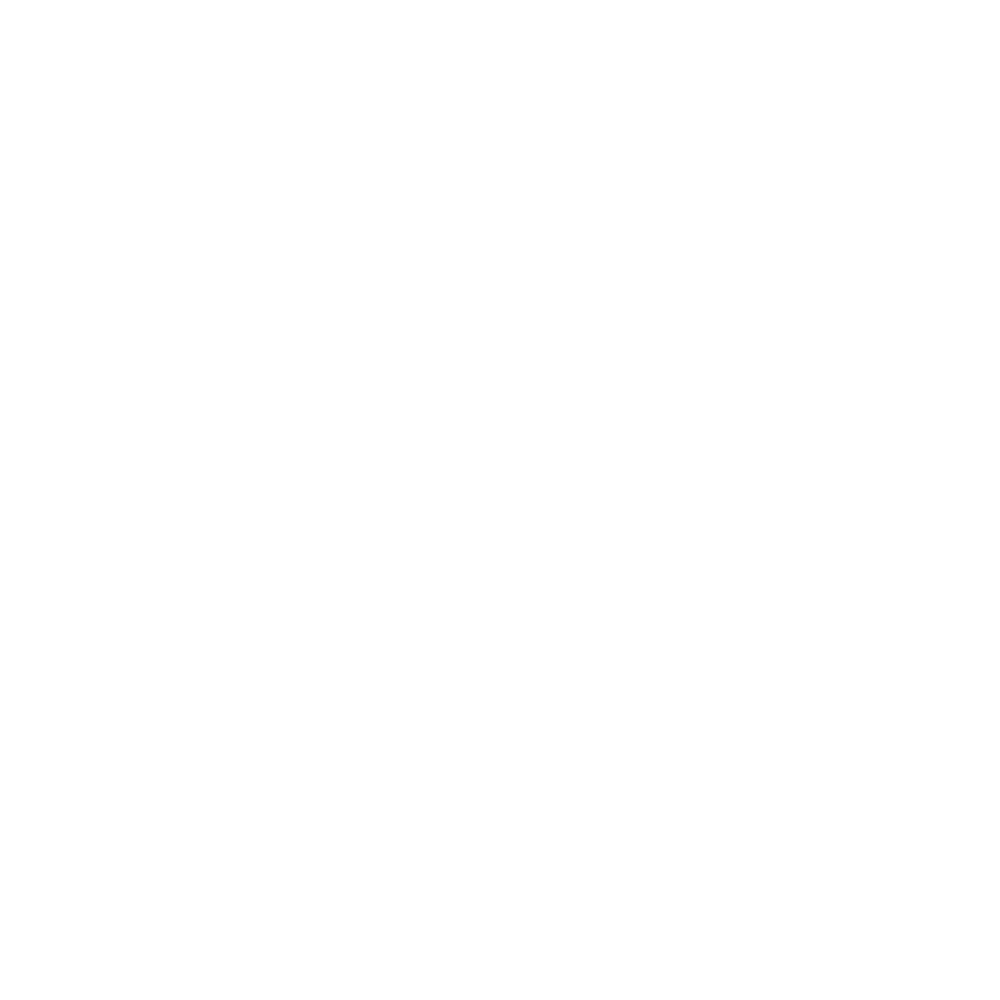

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


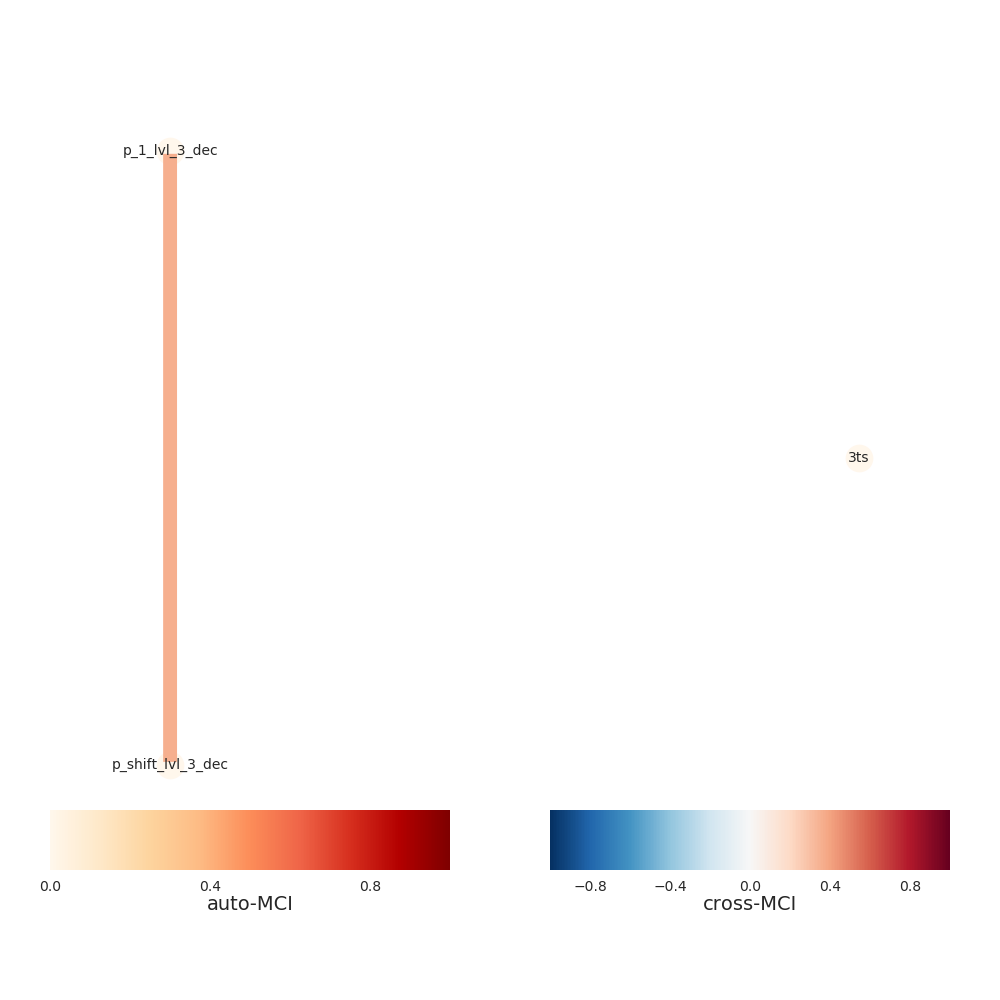

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


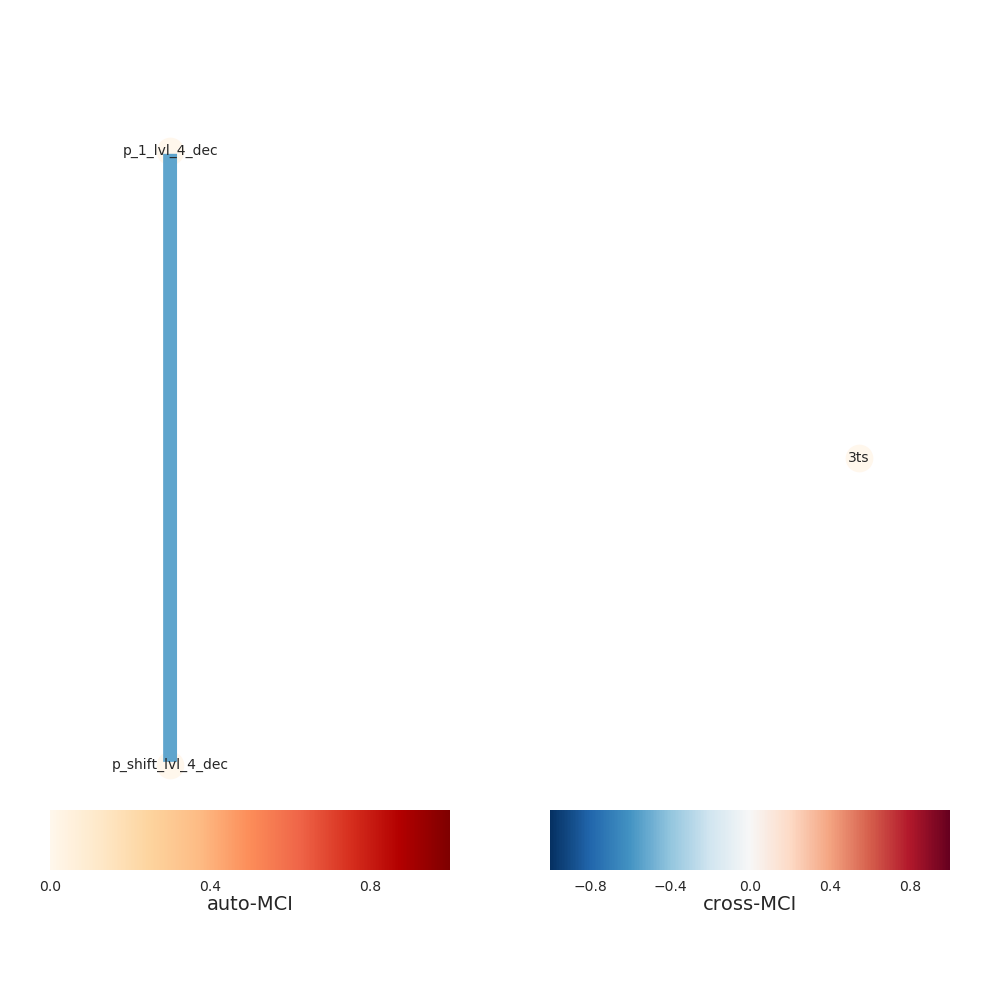

Progress causal inference - traintest set 100%
[INFO] Extracting level 8
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


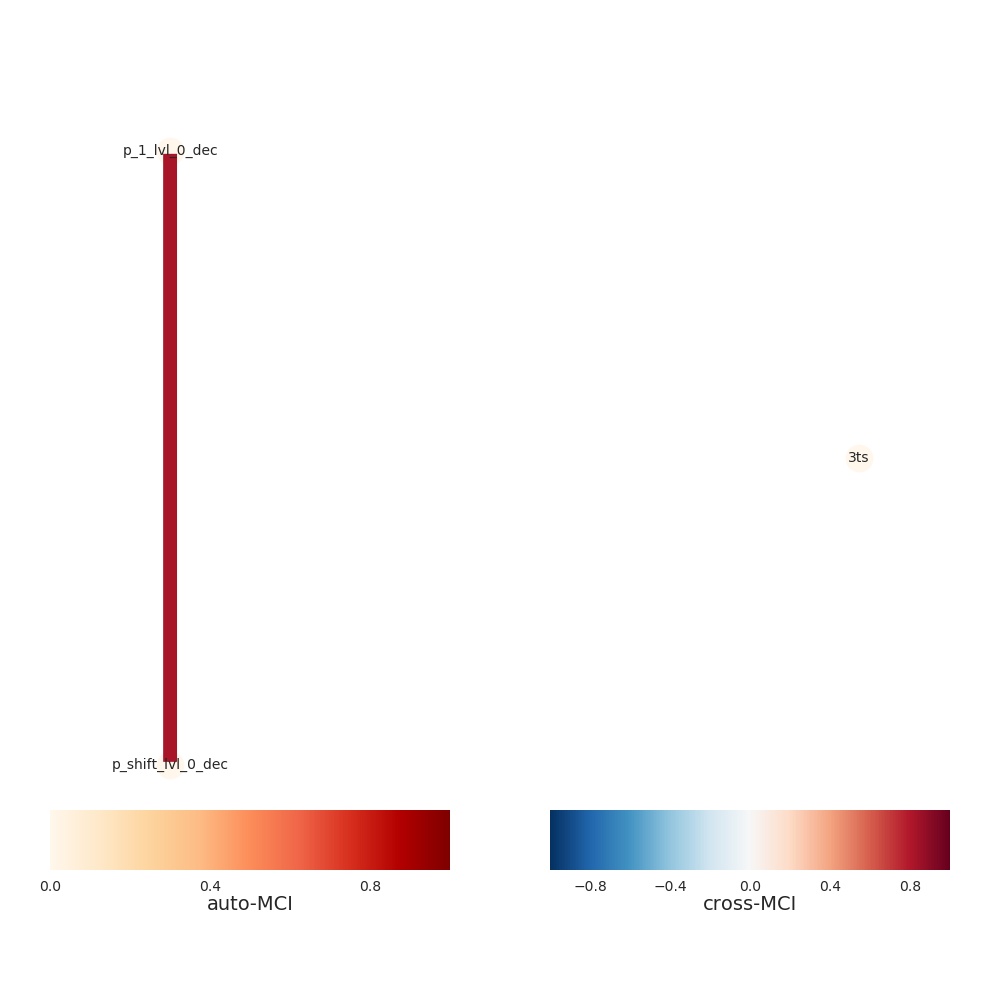

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


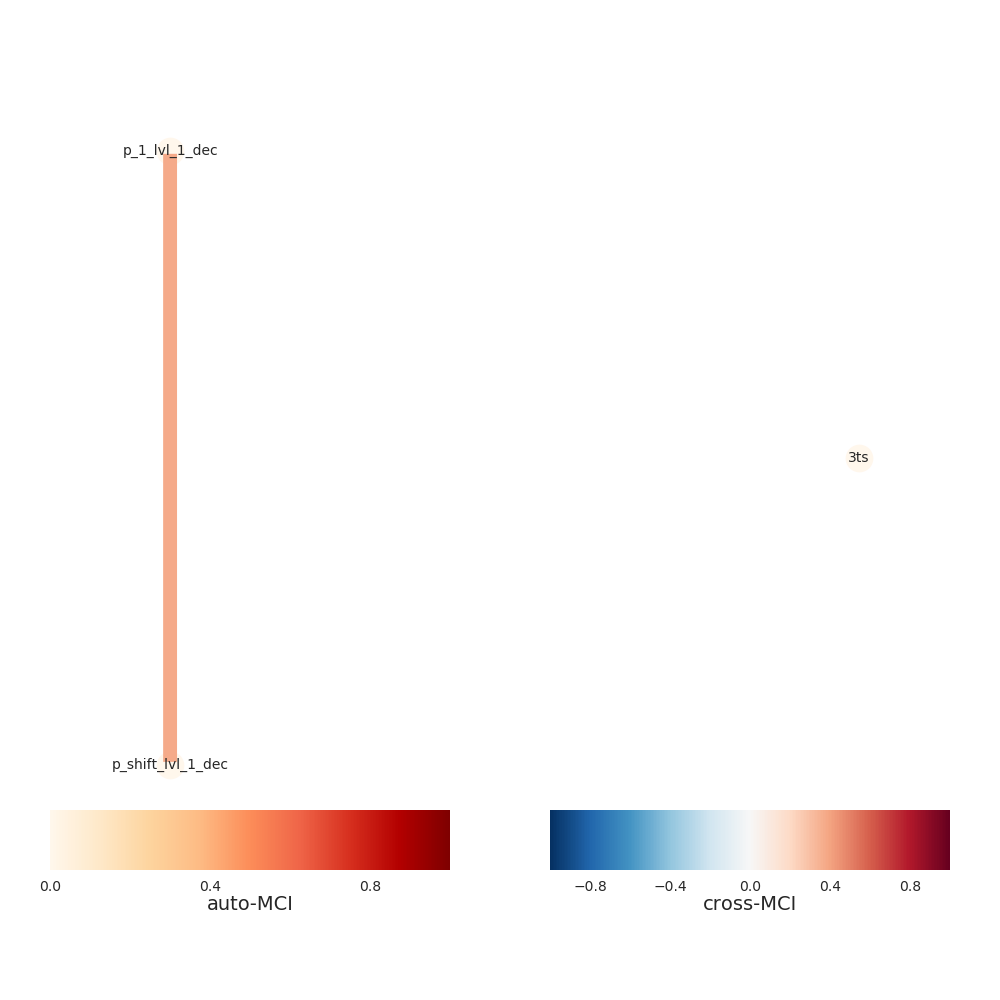

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


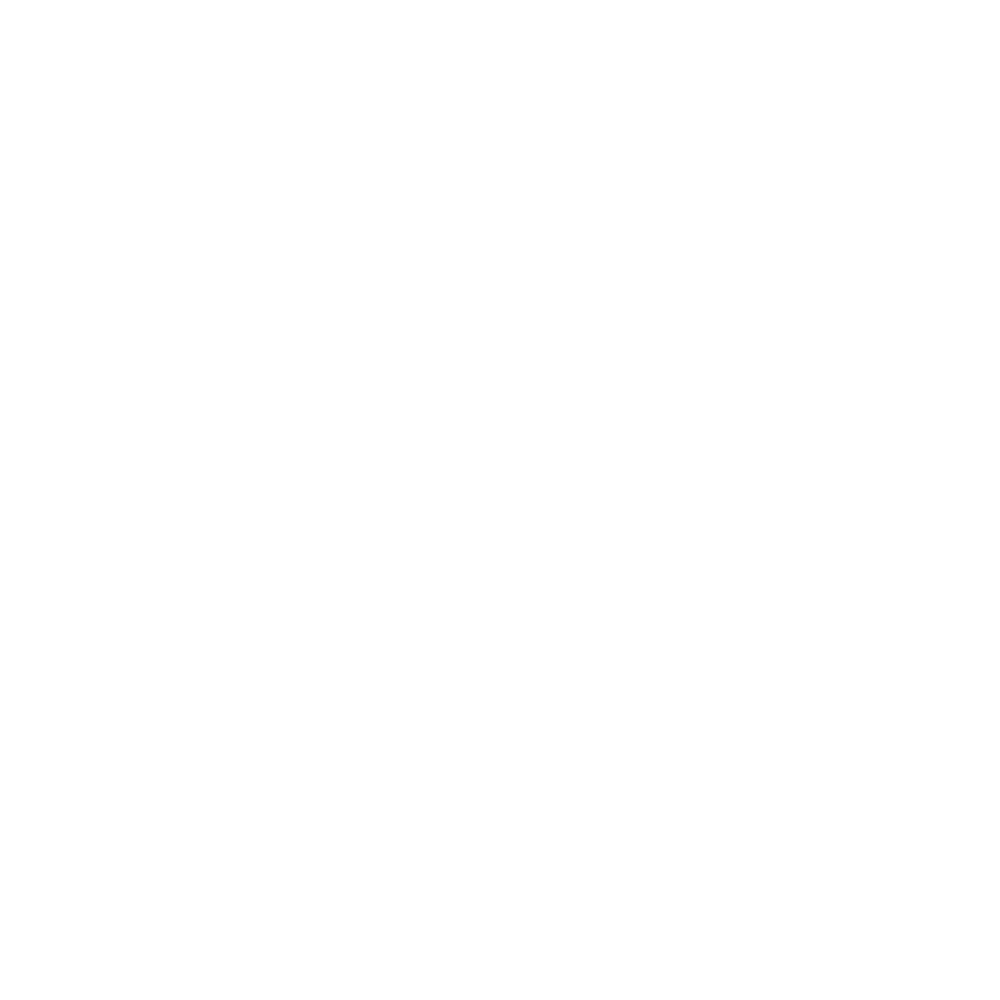

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


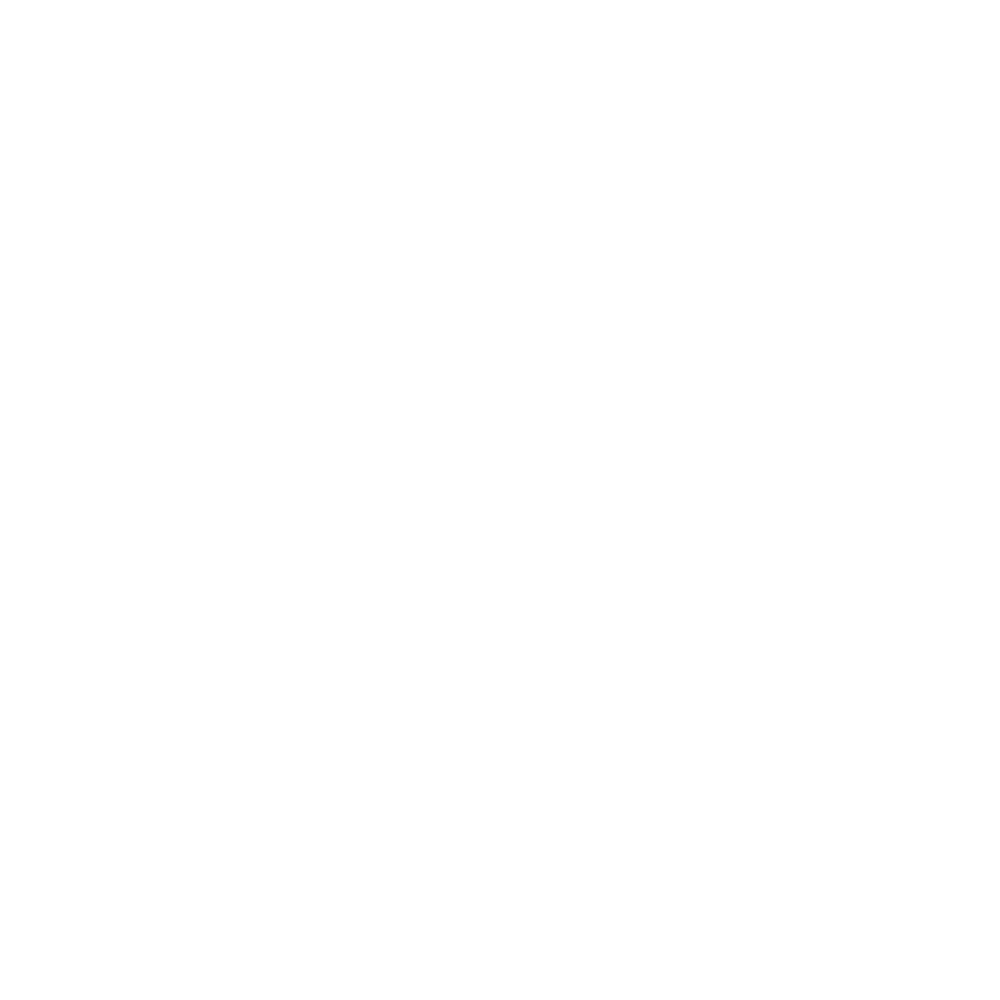

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


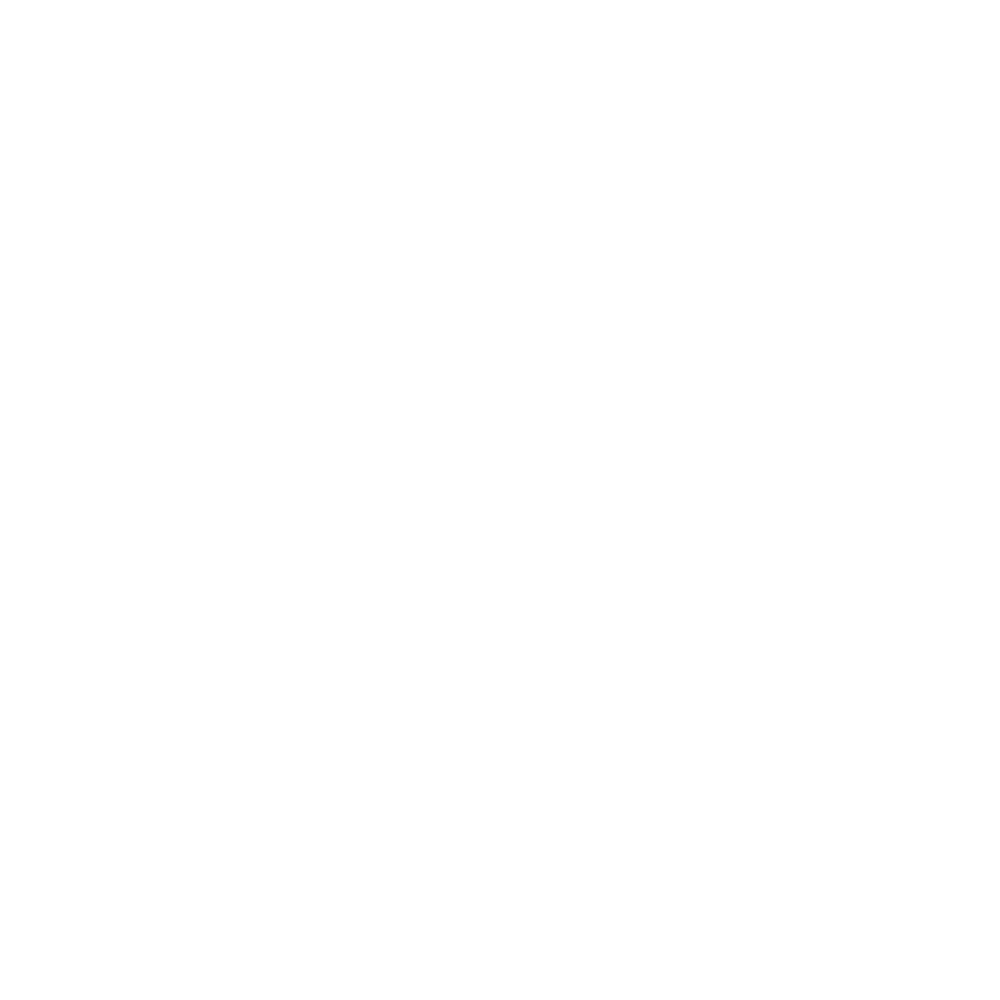

Progress causal inference - traintest set 100%
[INFO] Extracting level 9
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


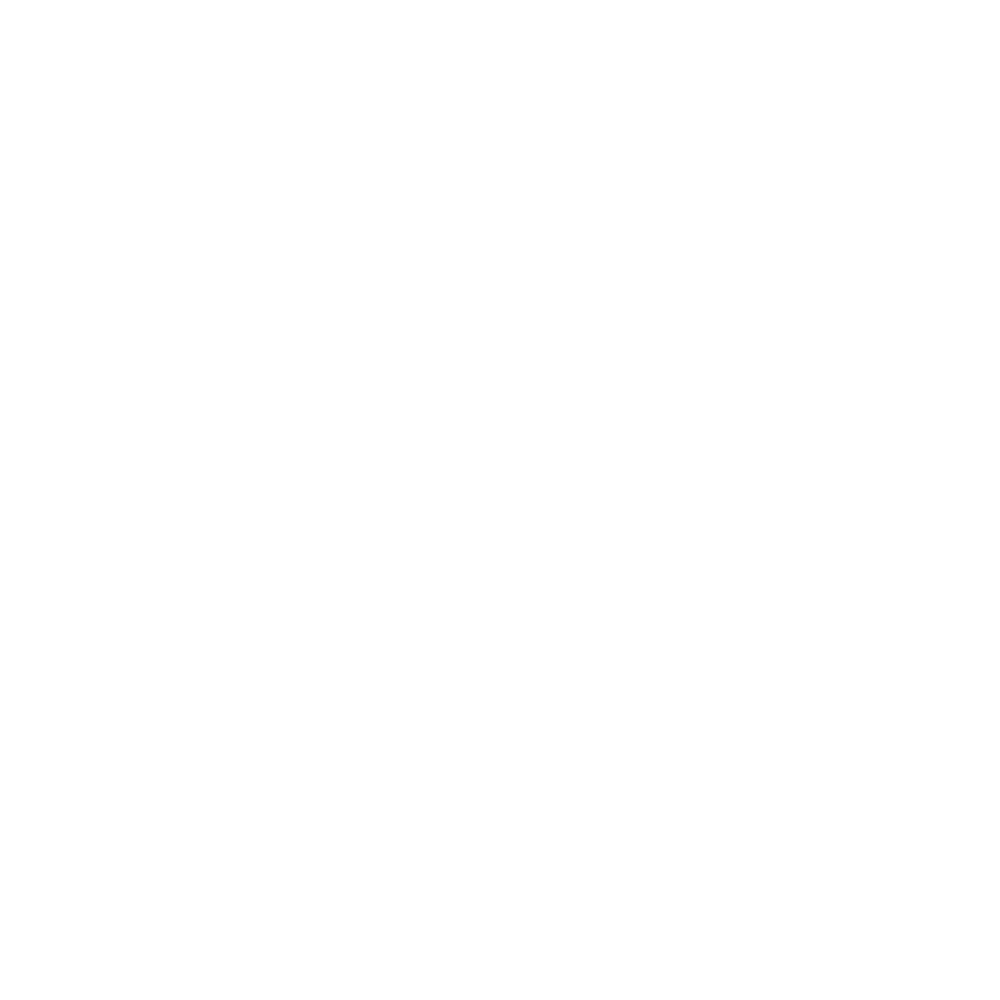

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


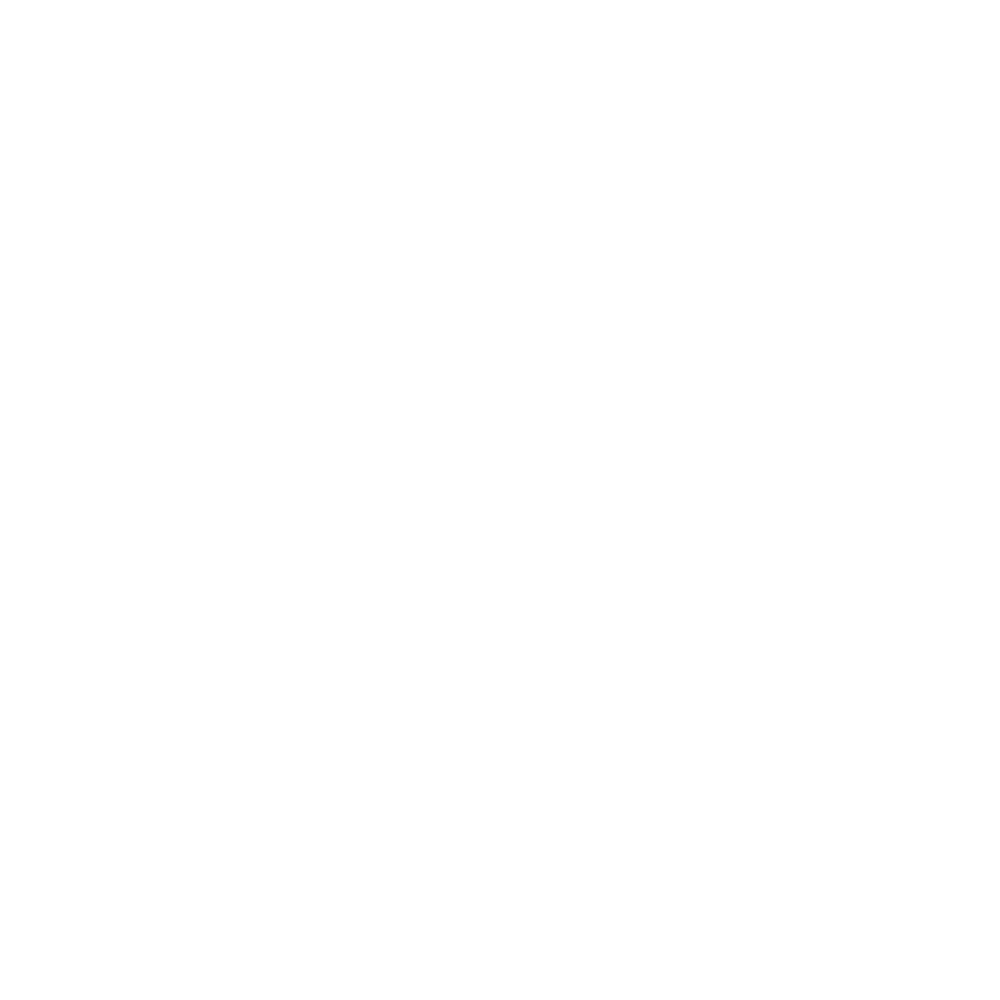

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


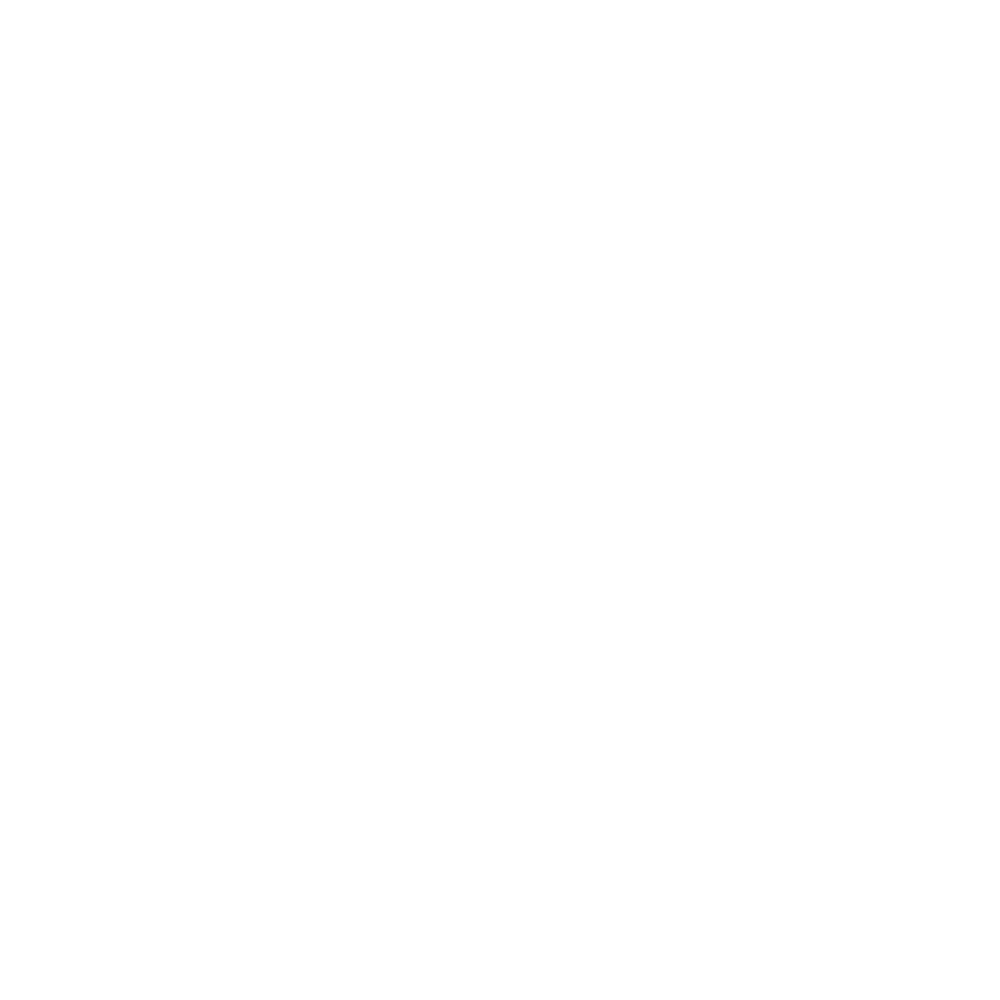

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


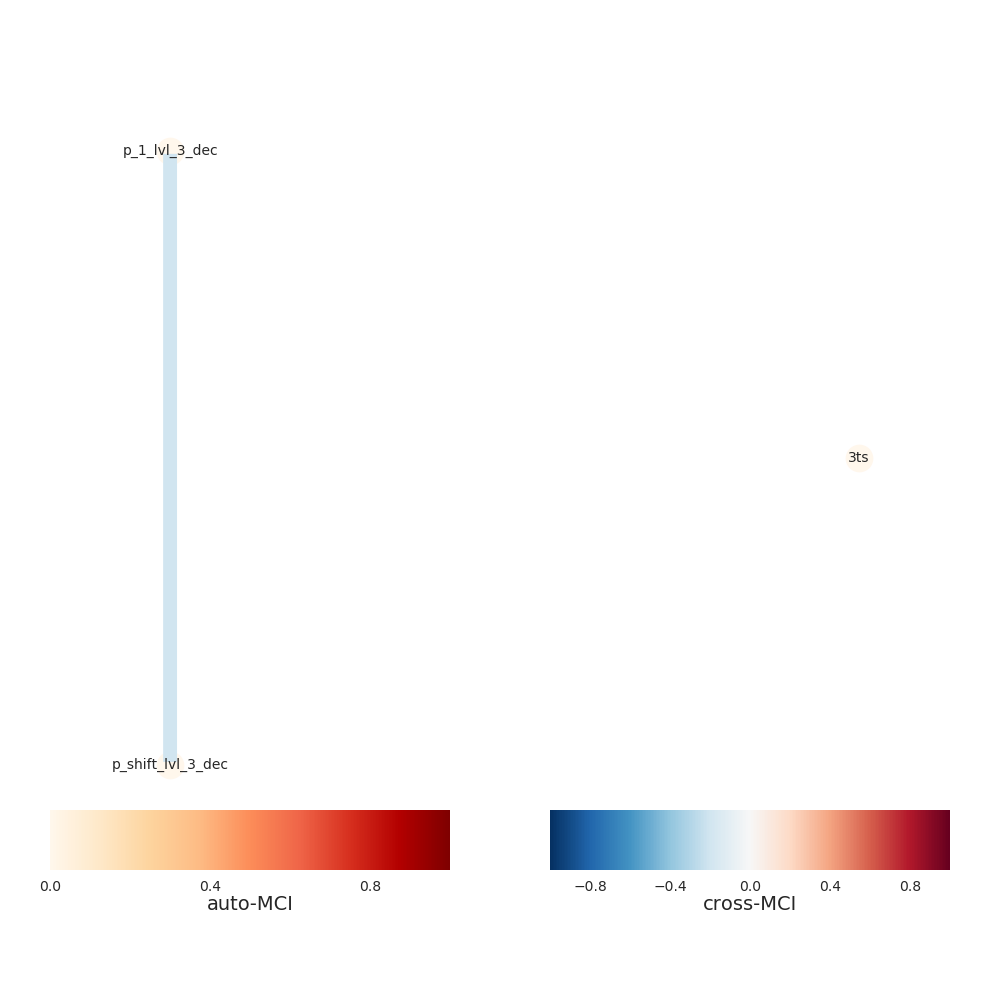

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


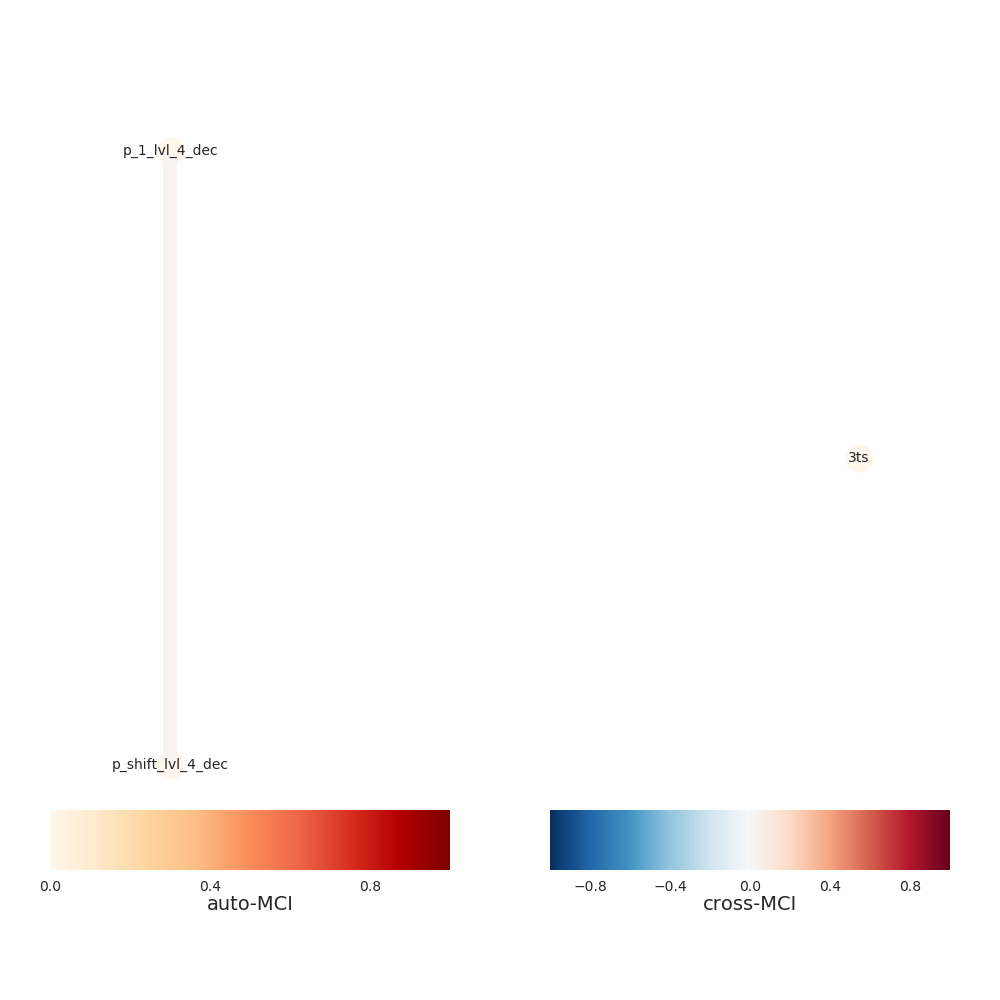

Progress causal inference - traintest set 100%
[INFO] Extracting level 10
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


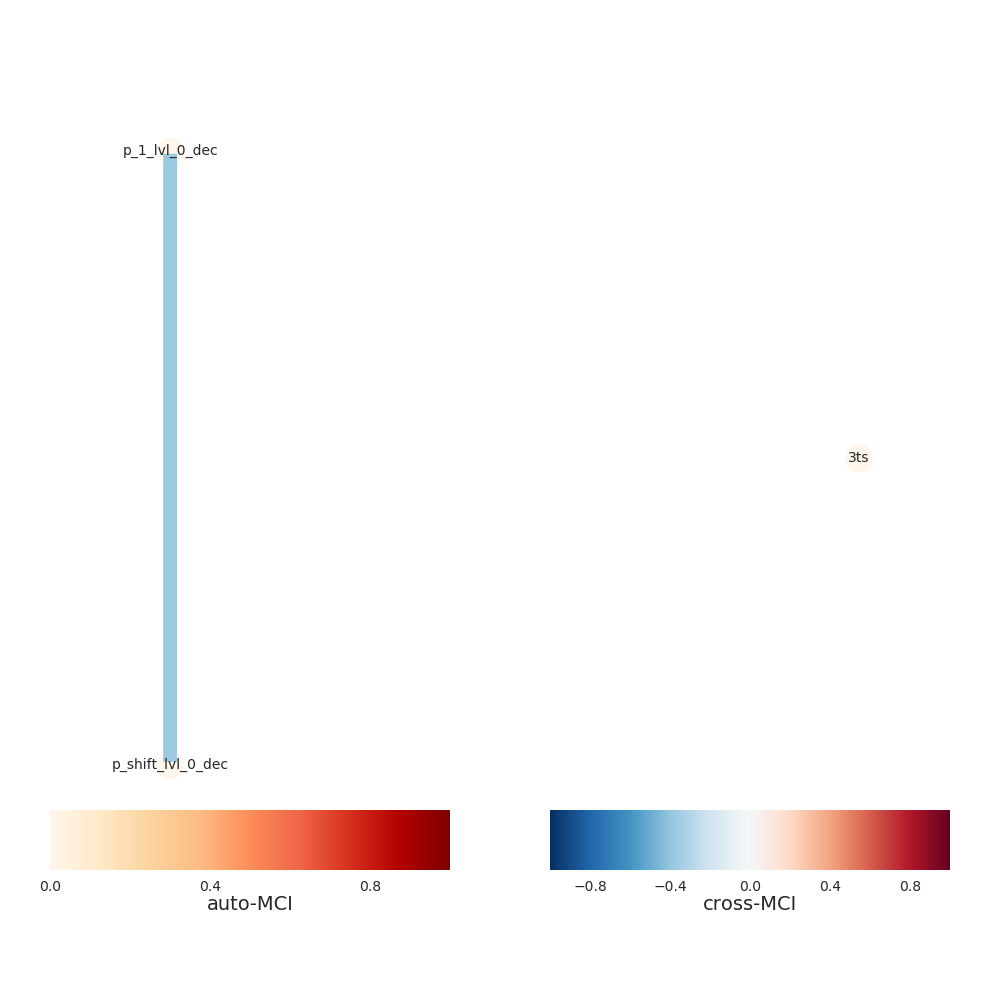

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


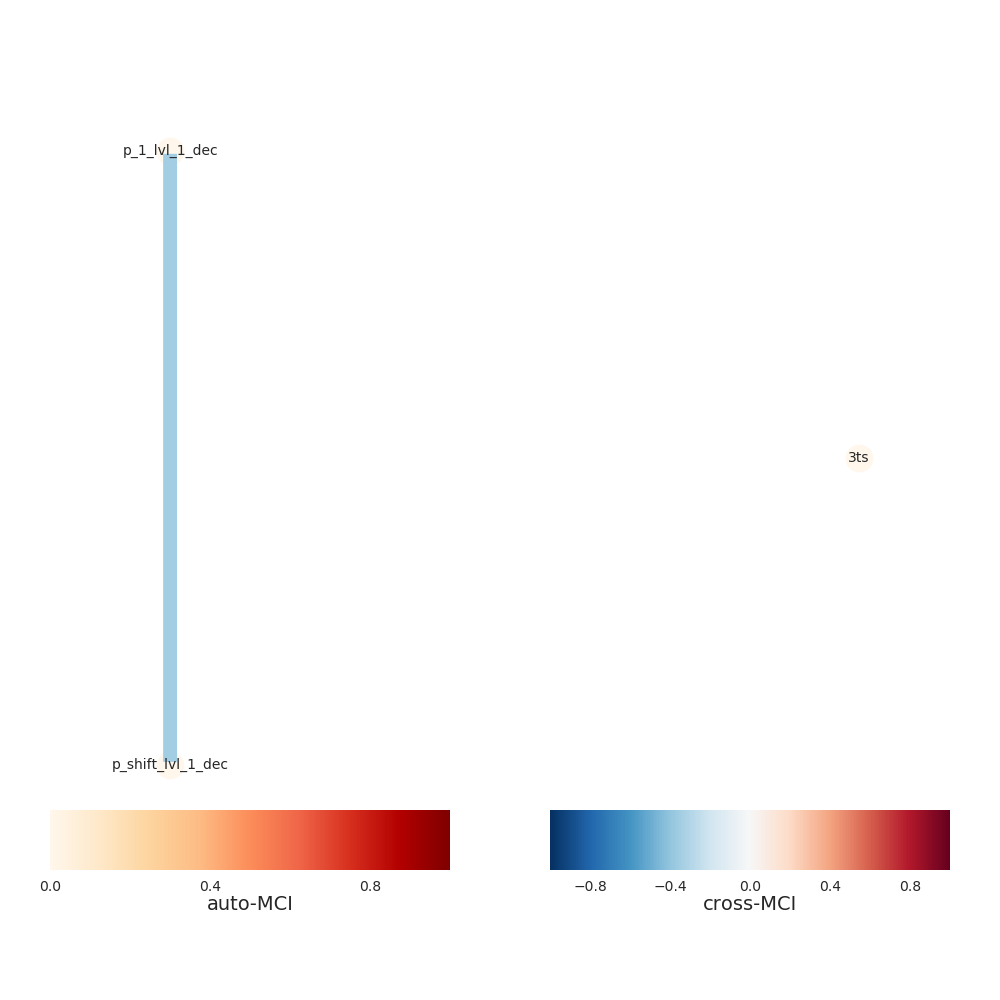

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


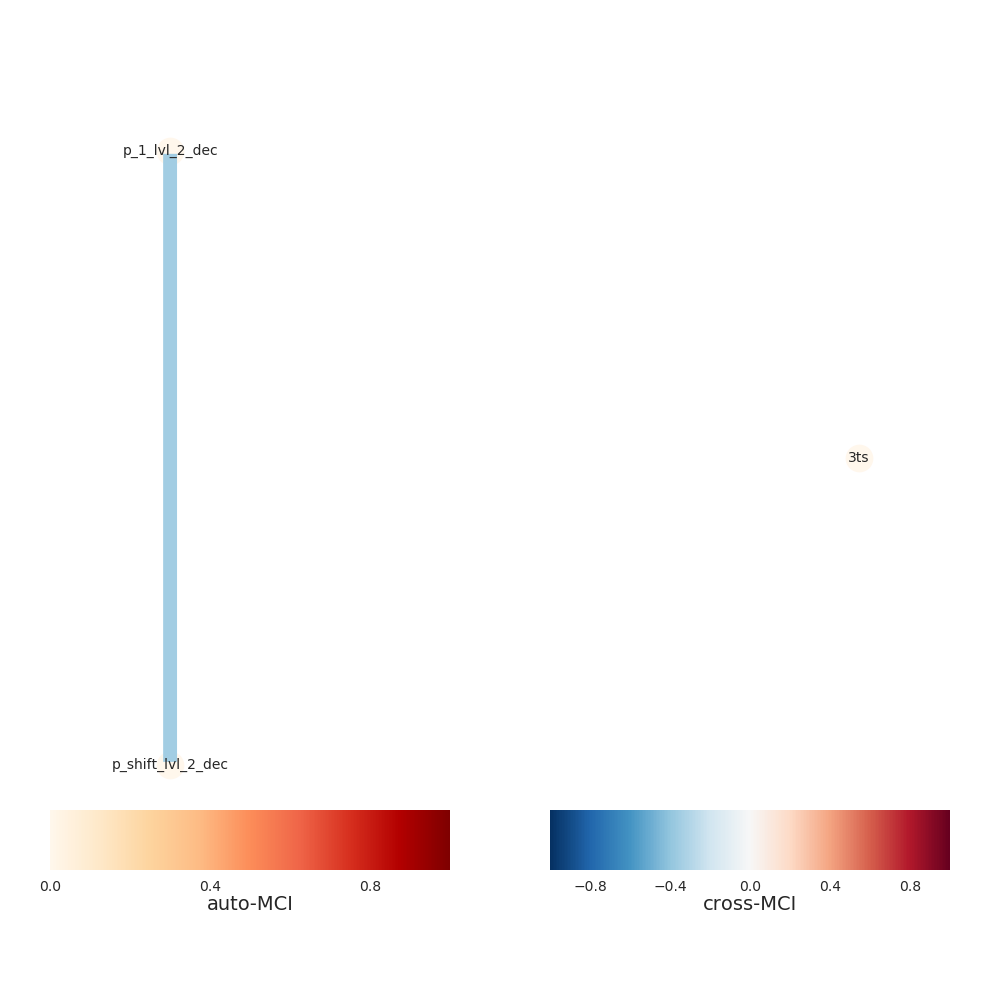

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


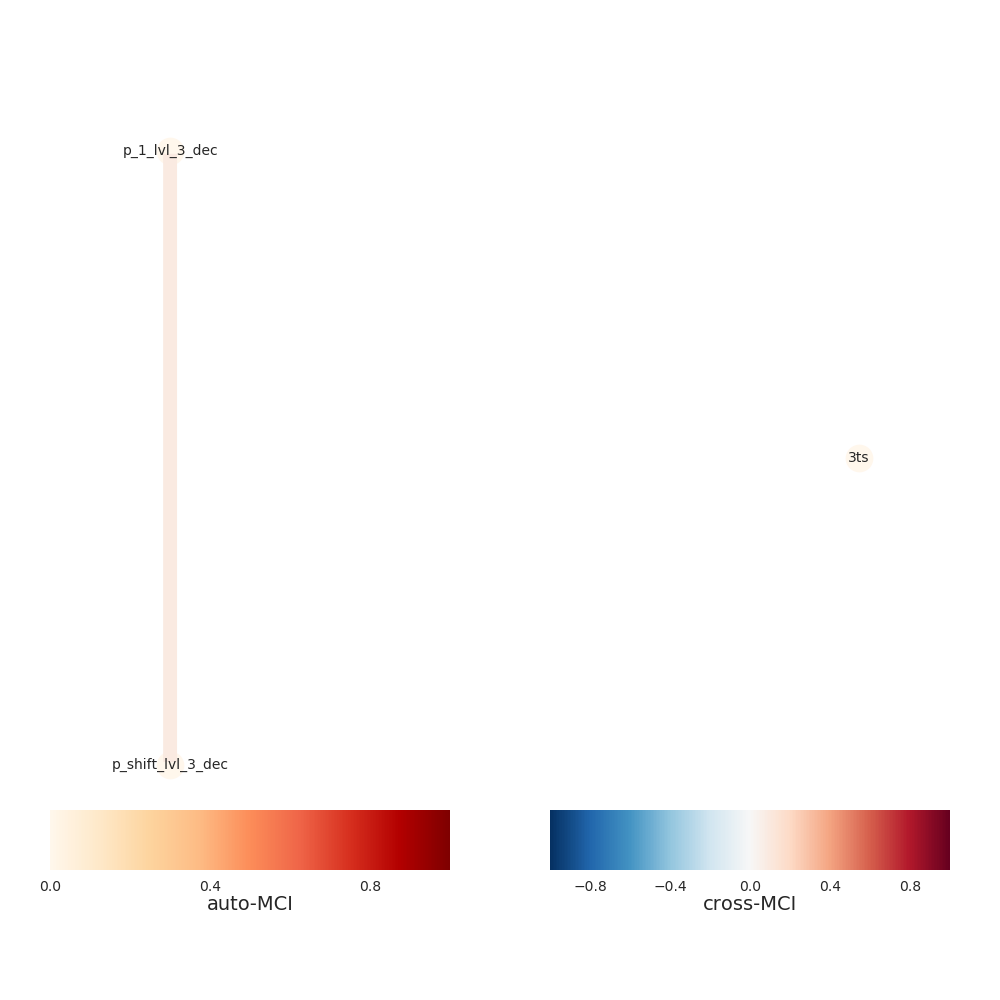

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


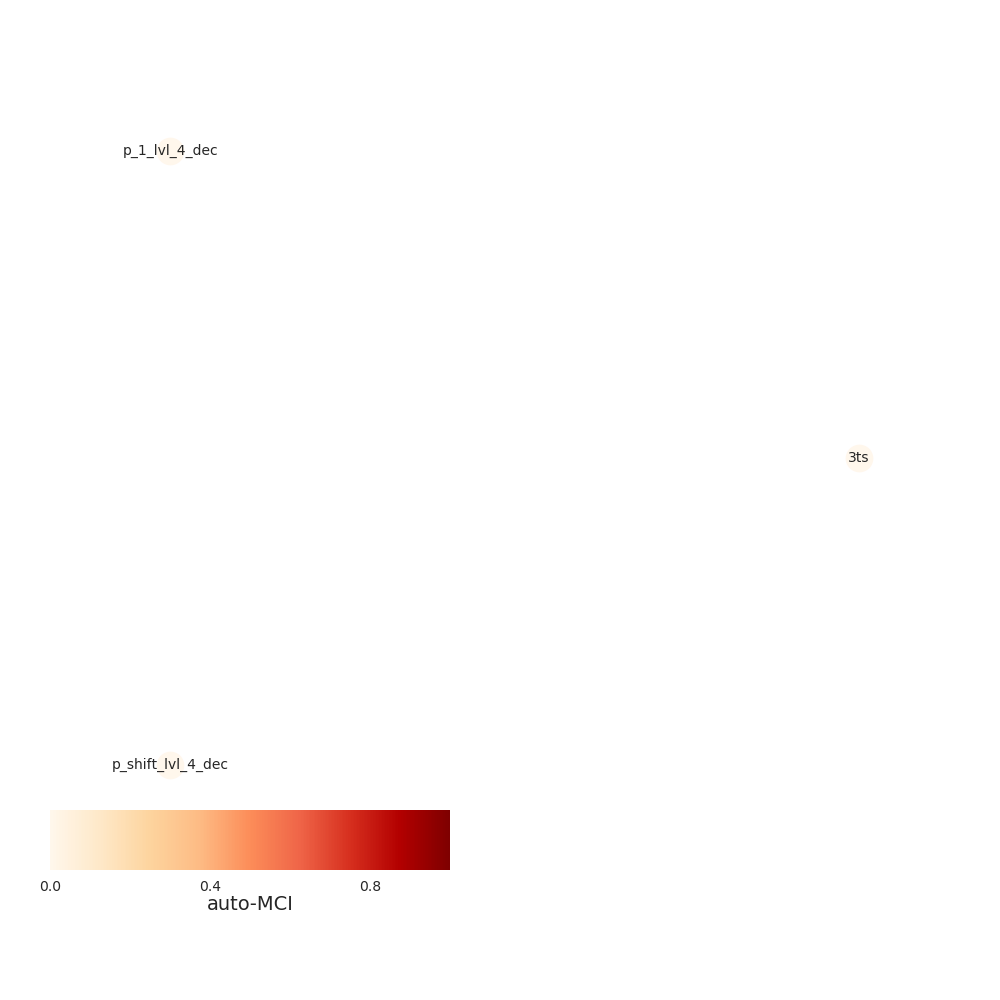

Progress causal inference - traintest set 100%
[INFO] Extracting level 11
Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


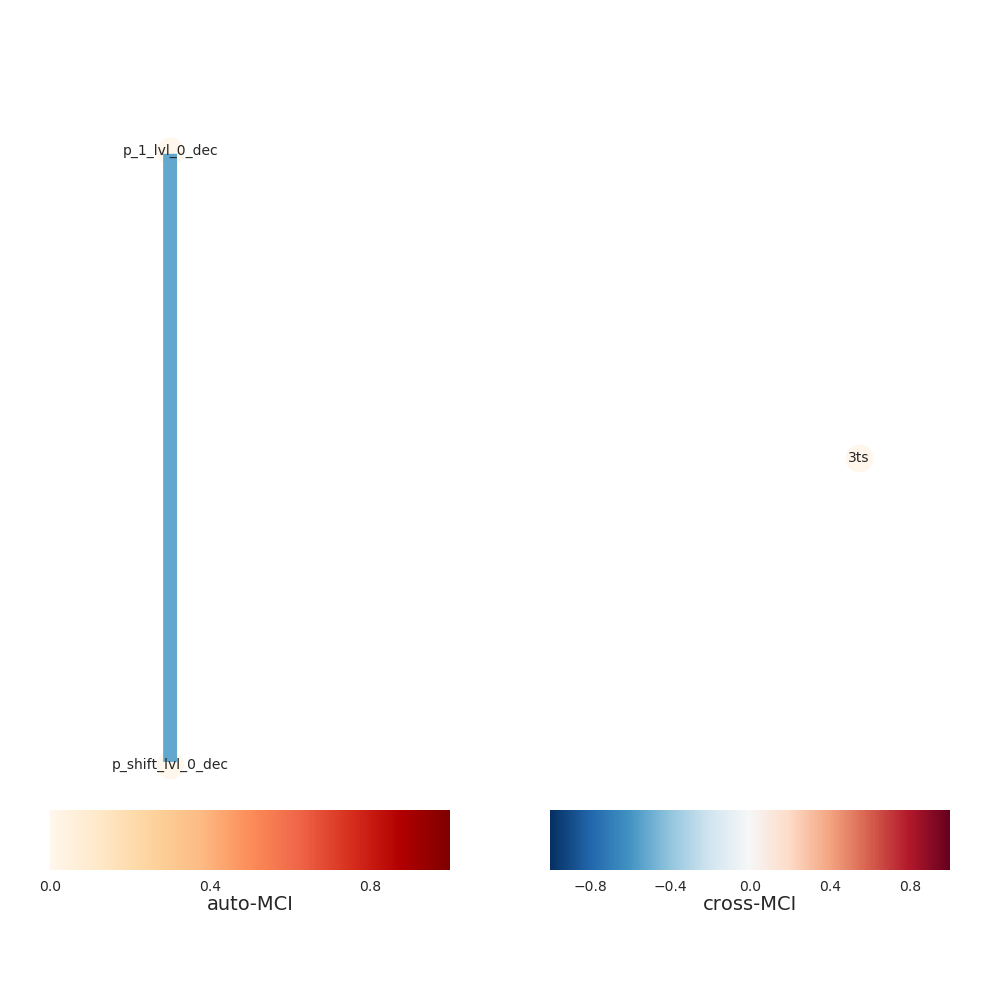

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


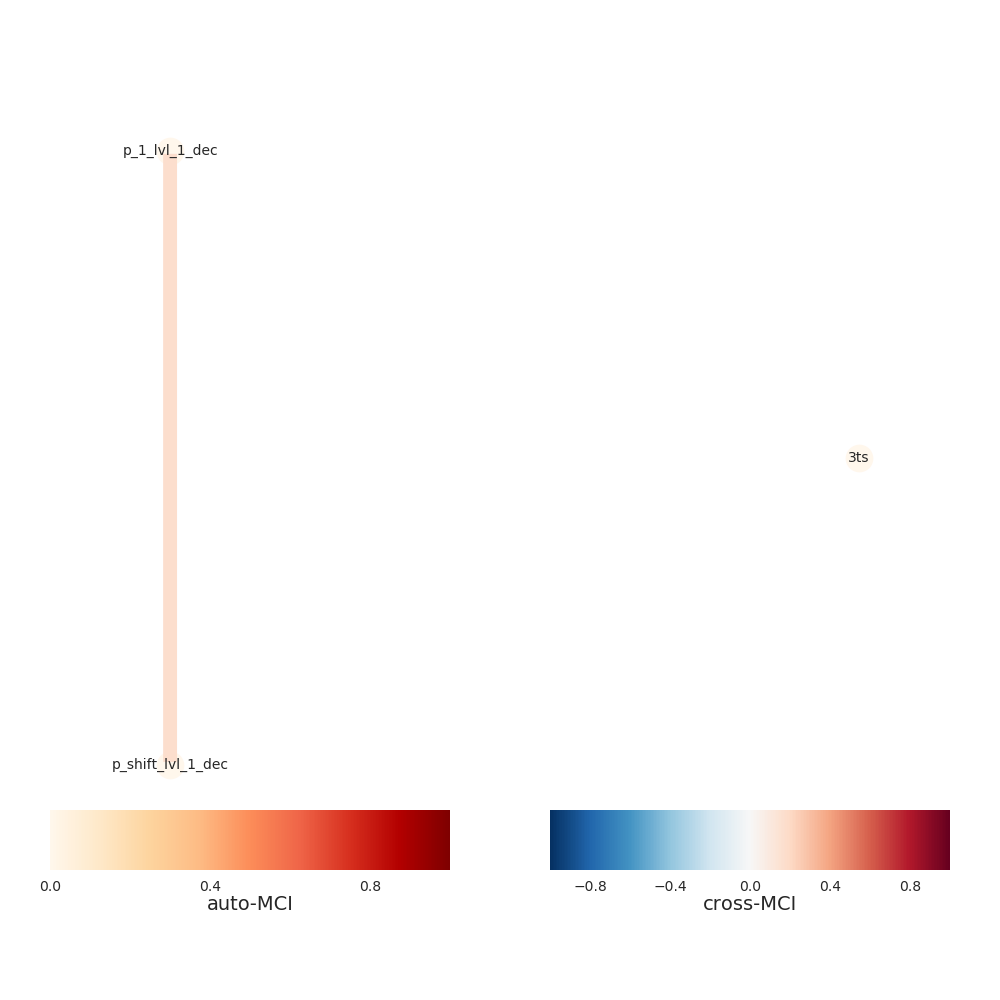

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


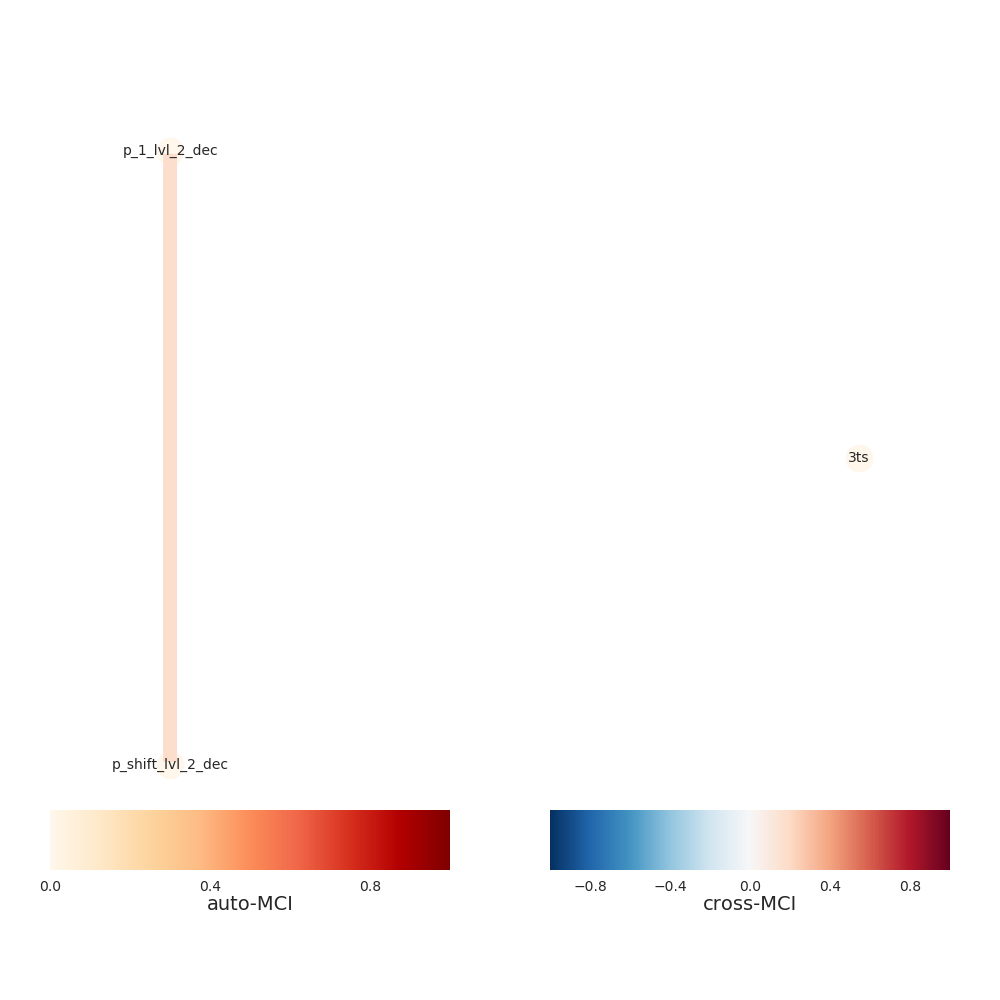

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


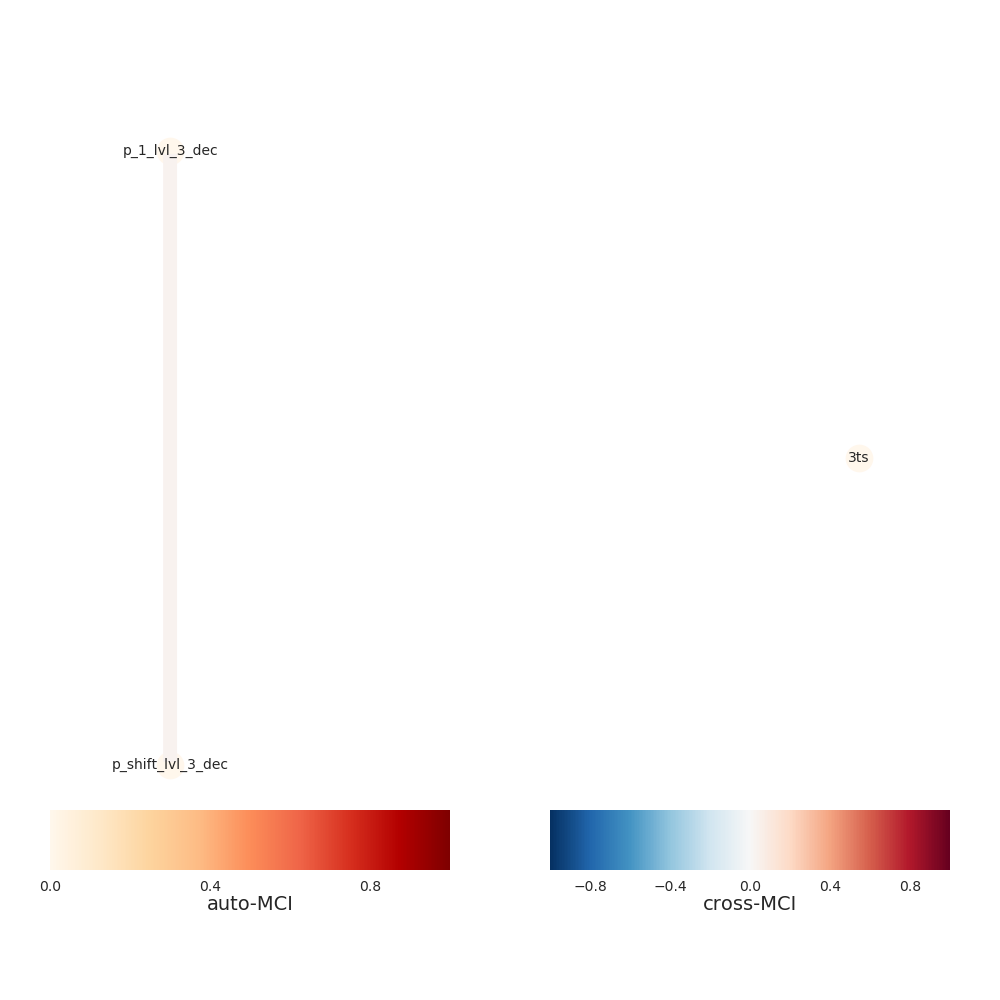

Progress causal inference - traintest set 100%

<IPython.core.display.Javascript object>


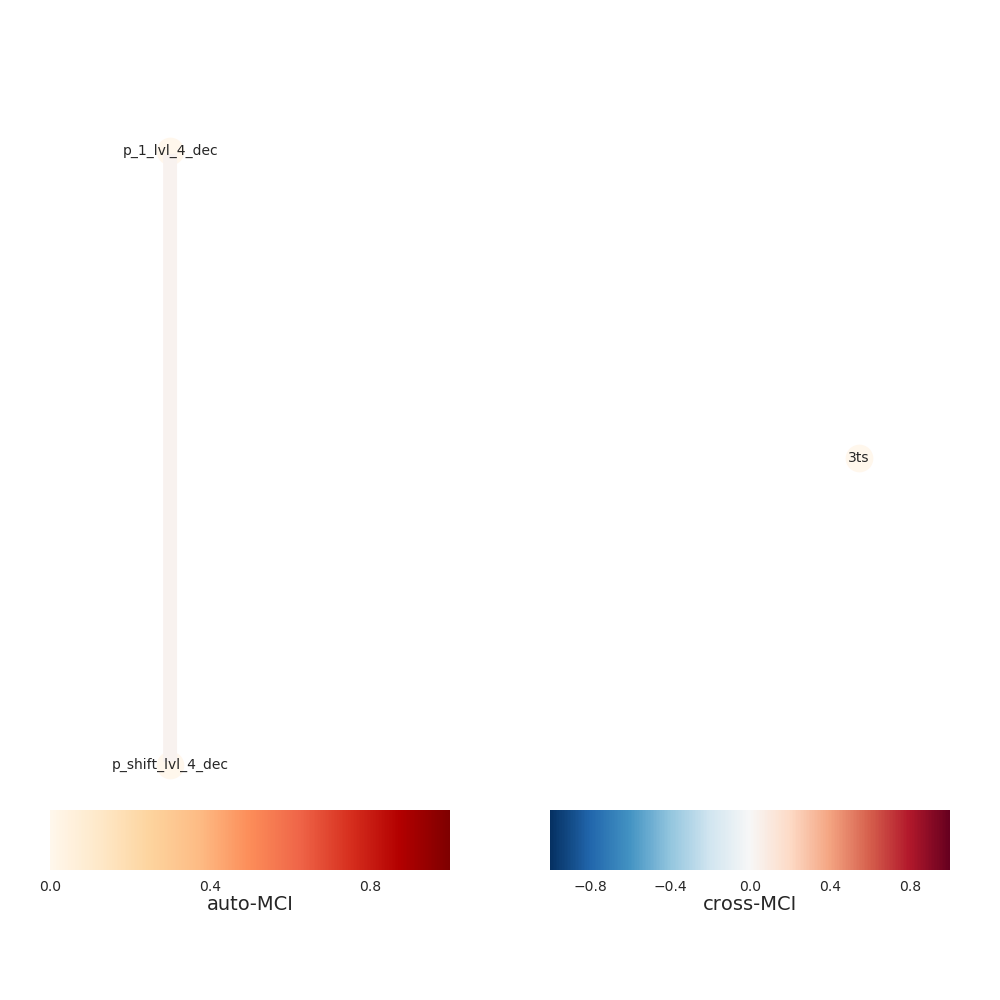

Progress causal inference - traintest set 100%

In [77]:
result_full = run_experiment_levels_full_lag(prepro_target, target_arr,rg, rg_index, peak_test=True,total_levels=levels)

In [78]:
mc_full, _ = result_full

In [79]:
[len(i) for i in mc_full]

[12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12]

<IPython.core.display.Javascript object>


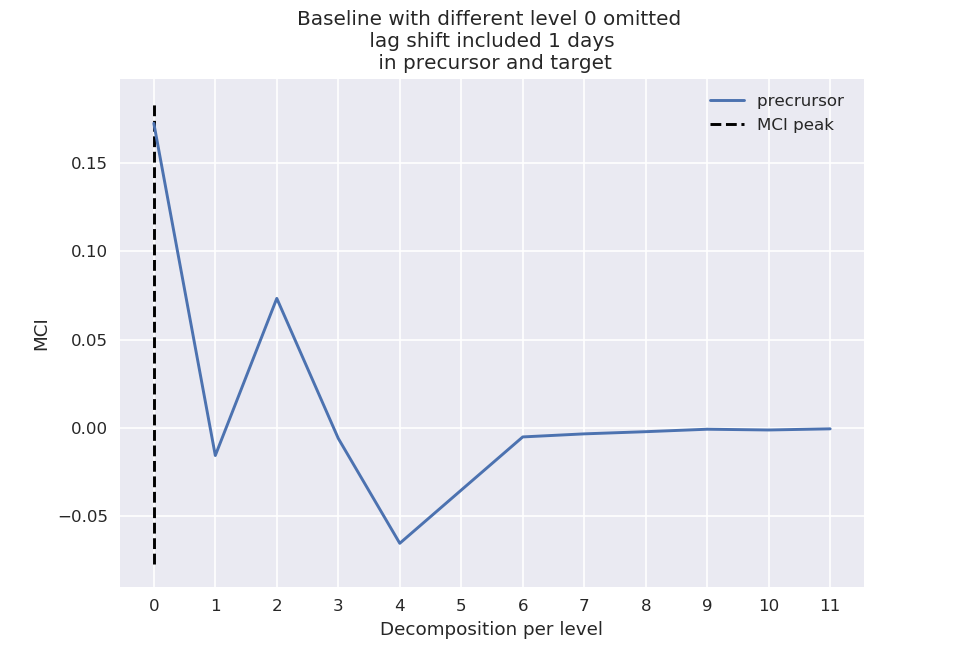

<IPython.core.display.Javascript object>


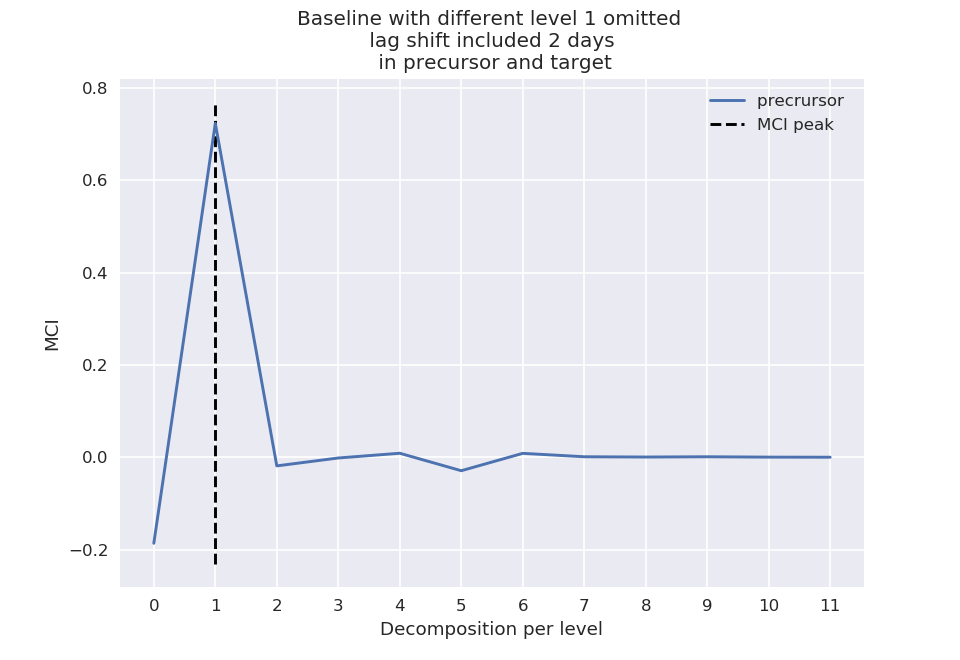

<IPython.core.display.Javascript object>


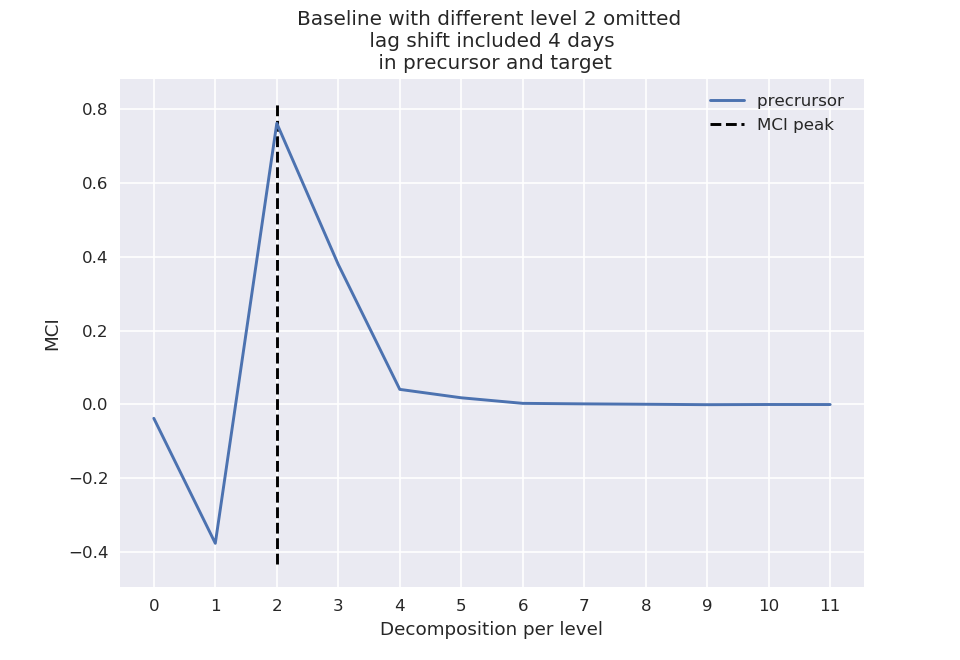

<IPython.core.display.Javascript object>


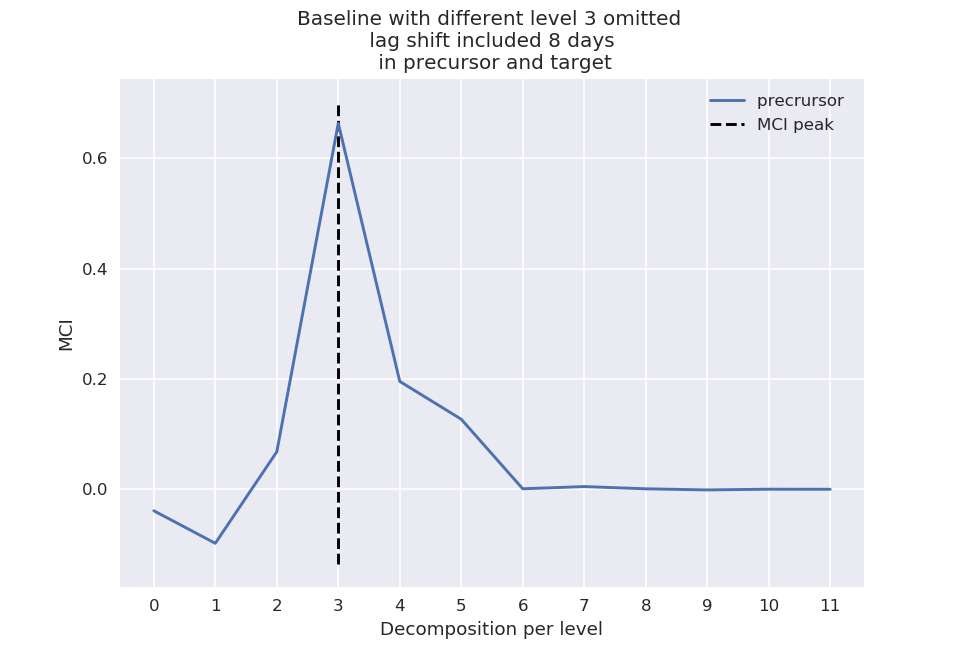

<IPython.core.display.Javascript object>


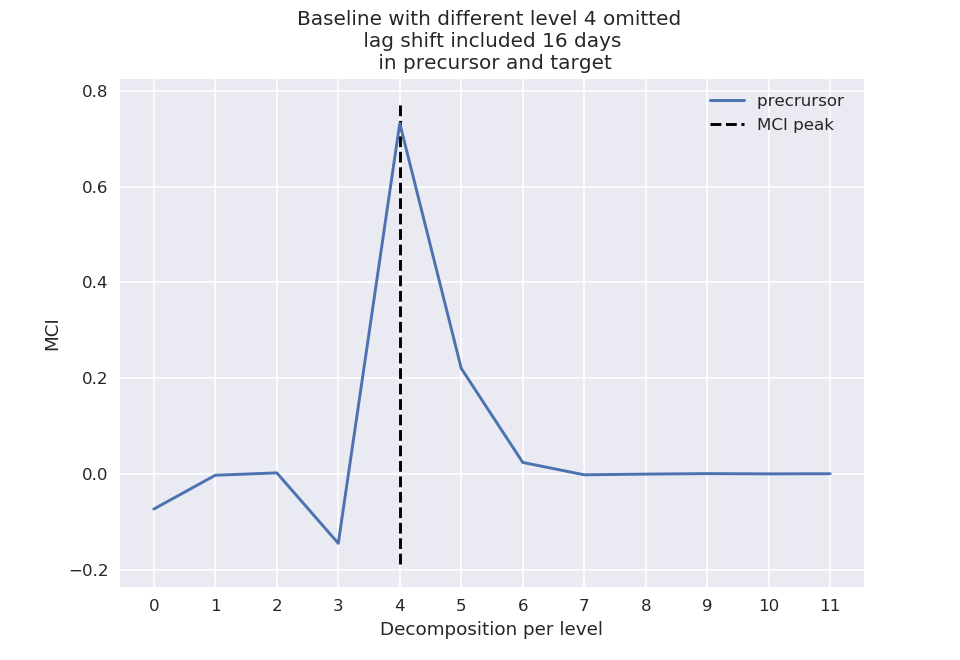

<IPython.core.display.Javascript object>


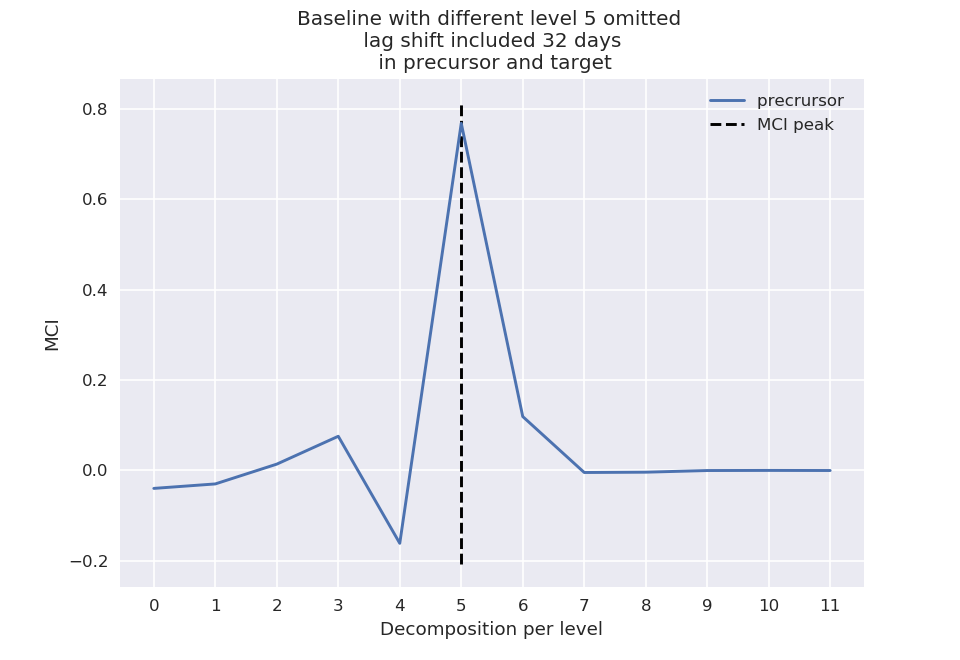

<IPython.core.display.Javascript object>


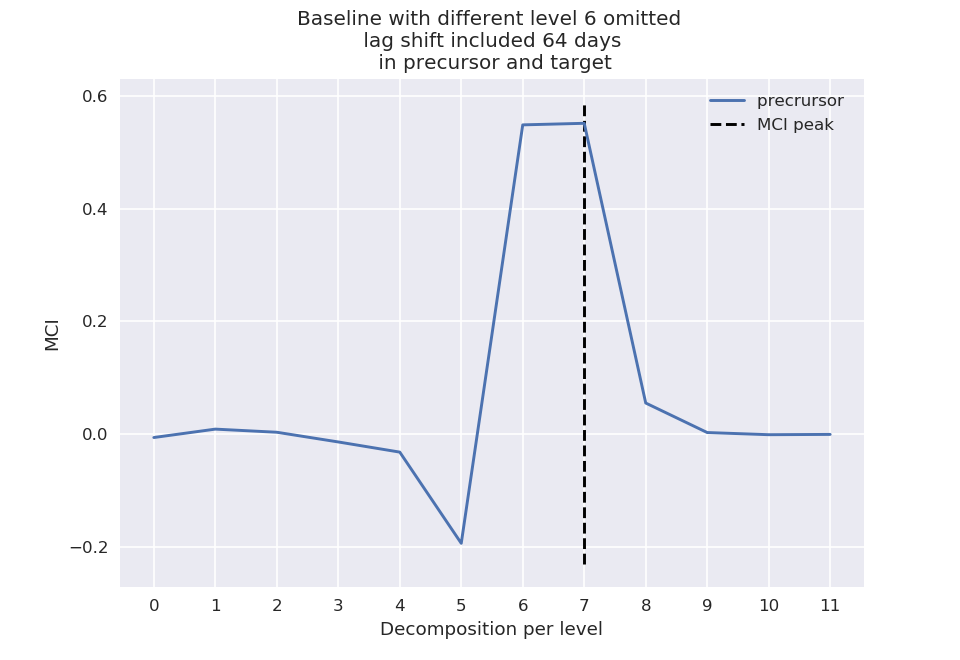

<IPython.core.display.Javascript object>


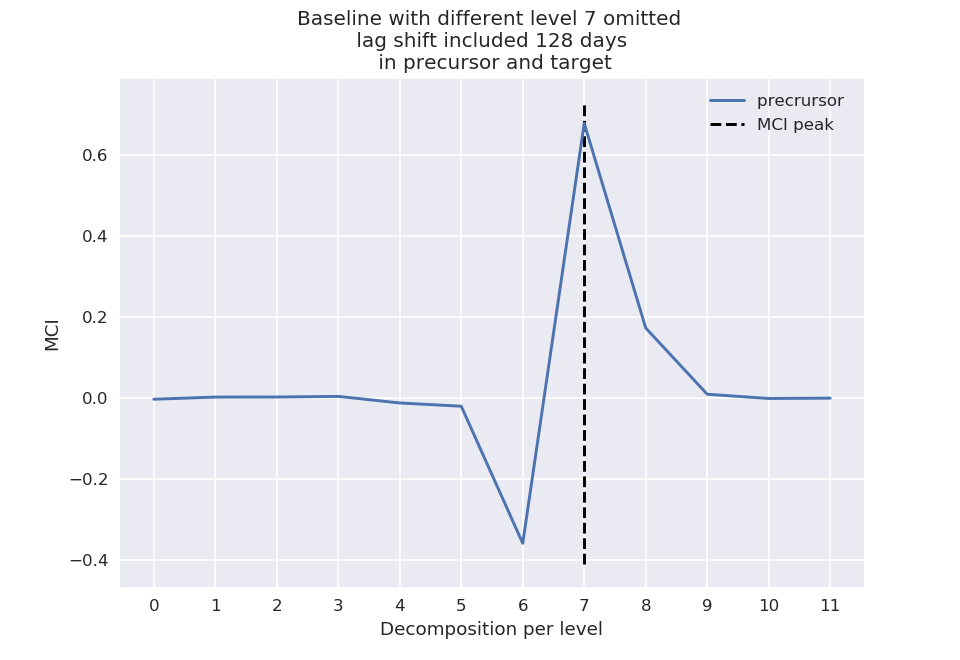

<IPython.core.display.Javascript object>


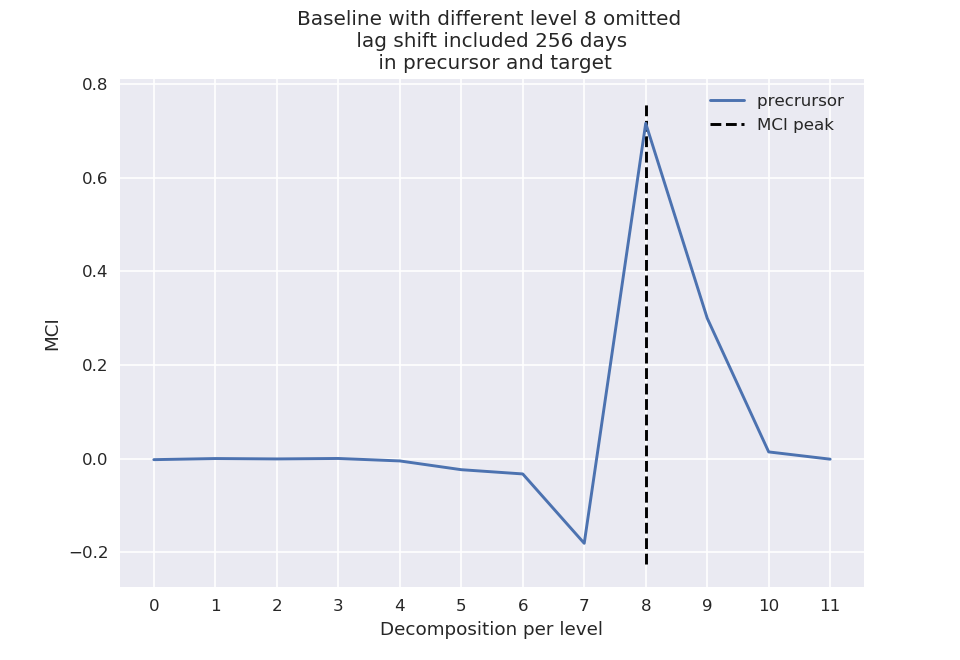

<IPython.core.display.Javascript object>


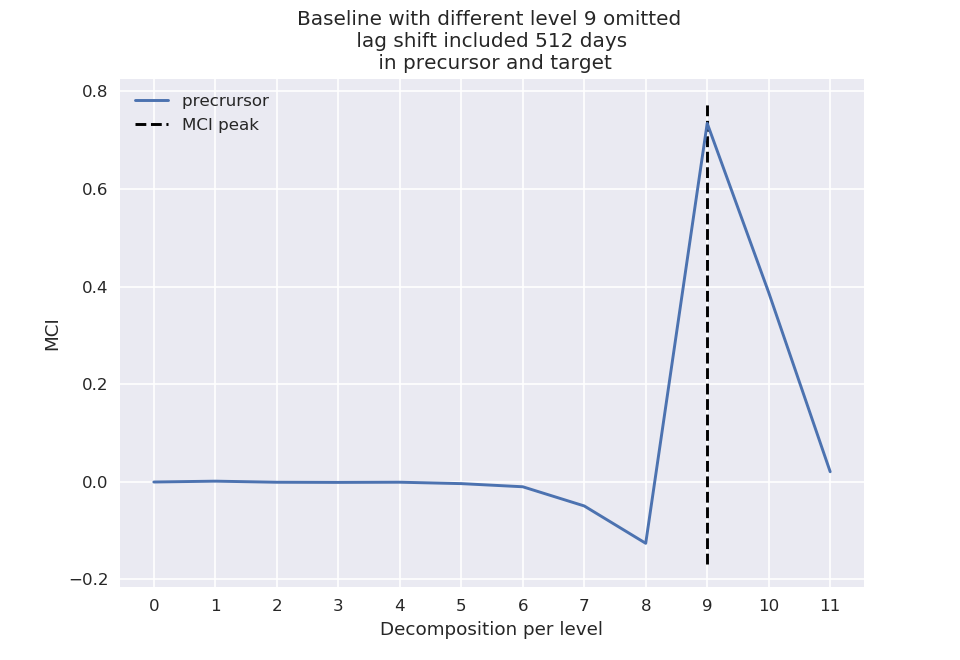

<IPython.core.display.Javascript object>


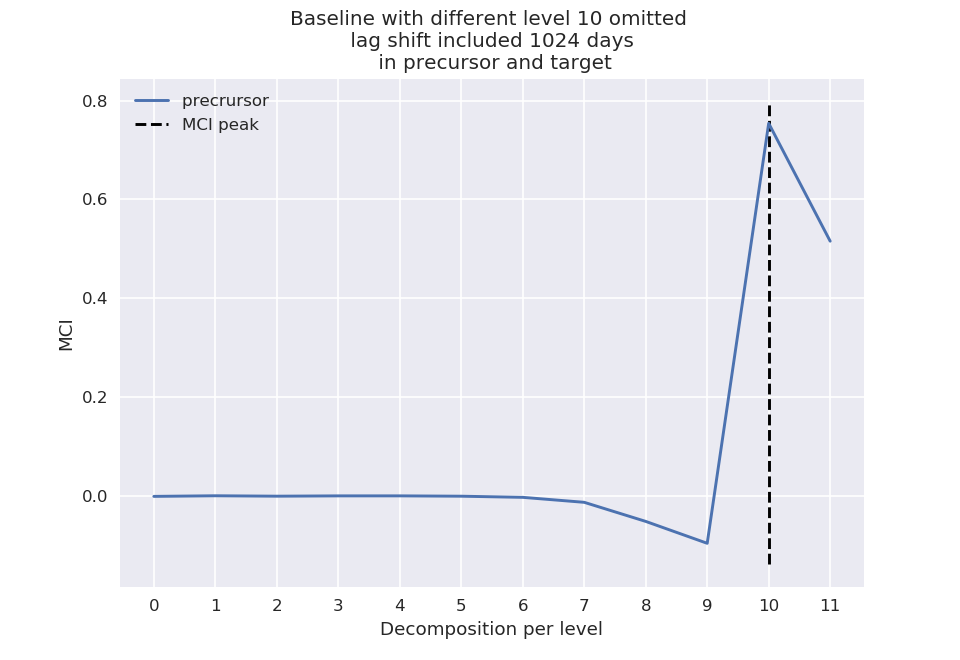

<IPython.core.display.Javascript object>


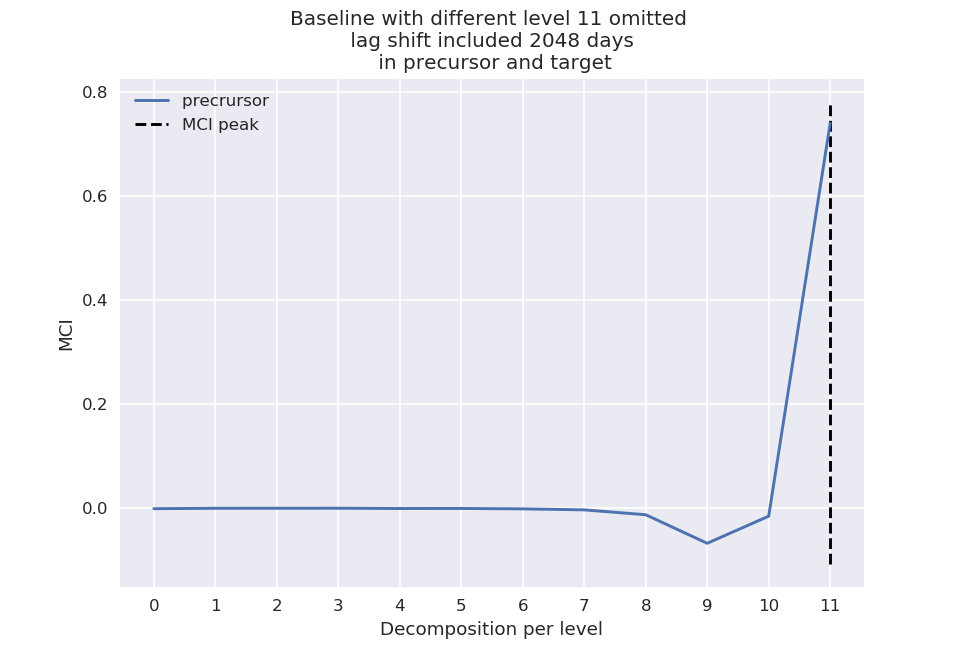

In [81]:
for i, peak in enumerate(mcs):
    if abs(len(mc_full) - len(peak)) == 1:
        plot_mci_pred_relation(cA=range(len(mcs)), prec_lag=peak, path=' ', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days \n in precursor and target', show_level=True, savefig=False)
    else:
        plot_mci_pred_relation(cA=range(len(mcs)), prec_lag=peak, path=' ', title=f'Baseline with different level {str(levels[i])} omitted \n lag shift included {str(2**(levels[i]))} days \n in precursor and target', show_level=True, savefig=False)

### Run with noise strength

In [83]:
# np.random.seed(42)
result_noise = run_experiment_levels_noise(prepro_target, target_arr,rg, rg_index, w=la8, peak_test=True, modwt=True, mode=wv.Modes.periodic, total_levels=levels[:8], iterations=8, thetas=theta[:8])


[INFO] Extracting level 0

[INFO] Running with noise 0.1
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.2
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.30000000000000004
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.4
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.5
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.6
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.7000000000000001
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.8
Progress causal inference - traintest set 100%
[INFO] Extracting level 1

[INFO] Running with noise 0.1
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.2
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.30000000000000004
Progress causal inference - traintest set 100%
[INFO] Running with noise 0.4
Progress causal infer

<IPython.core.display.Javascript object>


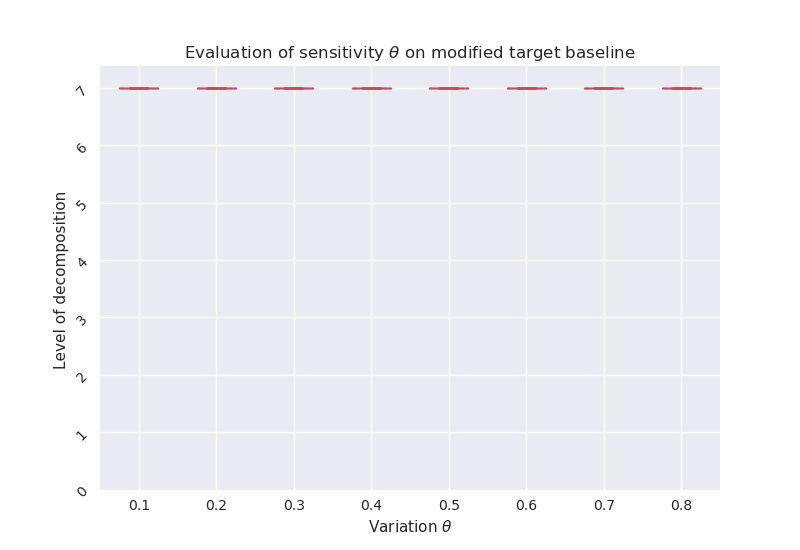

In [120]:
%matplotlib notebook
box_plot_reesult_experiments(result_noise, level=levels[:8], theta=theta[:8], all_levels=False,depth=7)

In [124]:
help(rg.quick_view_labels)

Help on method quick_view_labels in module class_RGCPD:

quick_view_labels(var=None, map_proj=None, median=True) method of class_RGCPD.RGCPD instance



<IPython.core.display.Javascript object>


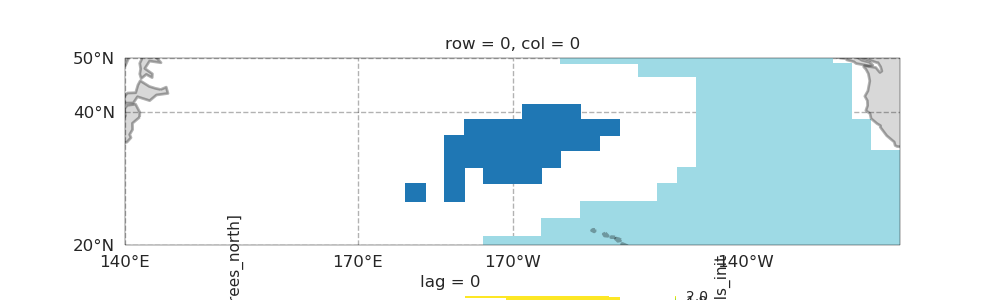

Plotting Corr maps sst_labels_init, split 0, lag 0

In [125]:
rg.quick_view_labels(median=False)

<IPython.core.display.Javascript object>


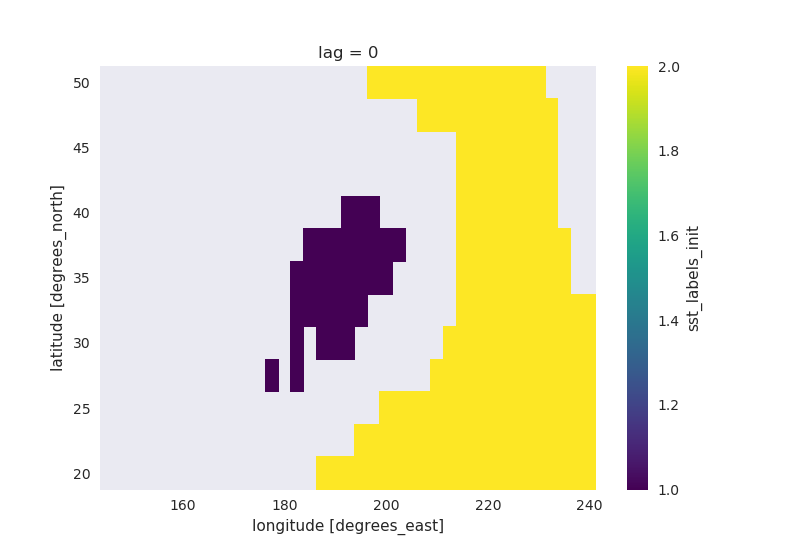

In [129]:
%matplotlib notebook
rg.list_for_MI[0].prec_labels.mean(dim='split').plot()